<a href="https://colab.research.google.com/github/AndreiAf02/Transfer_Learning_Extension/blob/main/Adult_Transductive_TL_Extension.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

##STAT 561 Project Extension - Adult

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from time import perf_counter



from sklearn.preprocessing import StandardScaler, MinMaxScaler
from imblearn.over_sampling import SMOTE
from imblearn.combine import SMOTETomek
from imblearn.under_sampling import RandomUnderSampler
from imblearn.over_sampling import RandomOverSampler
from sklearn.model_selection import train_test_split
from sklearn.metrics import precision_recall_curve
from sklearn.metrics import roc_curve, roc_auc_score, confusion_matrix, ConfusionMatrixDisplay, classification_report
import matplotlib.pyplot as plt
# !pip install pytorch-tabnet

# from pytorch_tabnet.tab_model import TabNetClassifier
import tensorflow as tf
from tensorflow.keras import layers, models
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay



## Data taken from the UCI Machine Learning repository [here](https://doi.org/10.24432/C5XW20):

In [2]:
pip install ucimlrepo

In [3]:
from ucimlrepo import fetch_ucirepo

# fetch dataset
adult = fetch_ucirepo(id=2)

# data (as pandas dataframes)
X = adult.data.features
y = adult.data.targets

# metadata
print(adult.metadata)

# variable information
print(adult.variables)



{'uci_id': 2, 'name': 'Adult', 'repository_url': 'https://archive.ics.uci.edu/dataset/2/adult', 'data_url': 'https://archive.ics.uci.edu/static/public/2/data.csv', 'abstract': 'Predict whether annual income of an individual exceeds $50K/yr based on census data. Also known as "Census Income" dataset. ', 'area': 'Social Science', 'tasks': ['Classification'], 'characteristics': ['Multivariate'], 'num_instances': 48842, 'num_features': 14, 'feature_types': ['Categorical', 'Integer'], 'demographics': ['Age', 'Income', 'Education Level', 'Other', 'Race', 'Sex'], 'target_col': ['income'], 'index_col': None, 'has_missing_values': 'yes', 'missing_values_symbol': 'NaN', 'year_of_dataset_creation': 1996, 'last_updated': 'Tue Sep 24 2024', 'dataset_doi': '10.24432/C5XW20', 'creators': ['Barry Becker', 'Ronny Kohavi'], 'intro_paper': None, 'additional_info': {'summary': "Extraction was done by Barry Becker from the 1994 Census database.  A set of reasonably clean records was extracted using the fol

In [4]:
X

,age,workclass,fnlwgt,education,education-num,marital-status,occupation,relationship,race,sex,capital-gain,capital-loss,hours-per-week,native-country
0,39,State-gov,77516,Bachelors,13,Never-married,Adm-clerical,Not-in-family,White,Male,2174,0,40,United-States
1,50,Self-emp-not-inc,83311,Bachelors,13,Married-civ-spouse,Exec-managerial,Husband,White,Male,0,0,13,United-States
2,38,Private,215646,HS-grad,9,Divorced,Handlers-cleaners,Not-in-family,White,Male,0,0,40,United-States
3,53,Private,234721,11th,7,Married-civ-spouse,Handlers-cleaners,Husband,Black,Male,0,0,40,United-States
4,28,Private,338409,Bachelors,13,Married-civ-spouse,Prof-specialty,Wife,Black,Female,0,0,40,Cuba
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48837,39,Private,215419,Bachelors,13,Divorced,Prof-specialty,Not-in-family,White,Female,0,0,36,United-States
48838,64,NaN,321403,HS-grad,9,Widowed,NaN,Other-relative,Black,Male,0,0,40,United-States
48839,38,Private,374983,Bachelors,13,Married-civ-spouse,Prof-specialty,Husband,White,Male,0,0,50,United-States
48840,44,Private,83891,Bachelors,13,Divorced,Adm-clerical,Own-child,Asian-Pac-Islander,Male,5455,0,40,United-States


In [5]:
y['income'].unique()

array(['<=50K', '>50K', '<=50K.', '>50K.'], dtype=object)

In [6]:
for i in range(len(X.columns)):
  print(X.columns[i])
  print(X.iloc[:, i].unique())
  print('------------------')

age
[39 50 38 53 28 37 49 52 31 42 30 23 32 40 34 25 43 54 35 59 56 19 20 45
 22 48 21 24 57 44 41 29 18 47 46 36 79 27 67 33 76 17 55 61 70 64 71 68
 66 51 58 26 60 90 75 65 77 62 63 80 72 74 69 73 81 78 88 82 83 84 85 86
 87 89]
------------------
workclass
['State-gov' 'Self-emp-not-inc' 'Private' 'Federal-gov' 'Local-gov' '?'
 'Self-emp-inc' 'Without-pay' 'Never-worked' nan]
------------------
fnlwgt
[ 77516  83311 215646 ... 173449  89686 350977]
------------------
education
['Bachelors' 'HS-grad' '11th' 'Masters' '9th' 'Some-college' 'Assoc-acdm'
 'Assoc-voc' '7th-8th' 'Doctorate' 'Prof-school' '5th-6th' '10th'
 '1st-4th' 'Preschool' '12th']
------------------
education-num
[13  9  7 14  5 10 12 11  4 16 15  3  6  2  1  8]
------------------
marital-status
['Never-married' 'Married-civ-spouse' 'Divorced' 'Married-spouse-absent'
 'Separated' 'Married-AF-spouse' 'Widowed']
------------------
occupation
['Adm-clerical' 'Exec-managerial' 'Handlers-cleaners' 'Prof-specialty'
 'Other-s

In [7]:
X_numeric = pd.DataFrame()

## Age:
X_numeric['age'] = X['age']

## Working class:
X_numeric['workclass'] = X['workclass']
X_numeric['workclass'].replace(['State-gov', 'Self-emp-not-inc', 'Private', 'Federal-gov', 'Local-gov', '?',
                                'Self-emp-inc', 'Without-pay', 'Never-worked'],
                                [0, 1, 2, 3, 4, 5, 6, 7, 8], inplace=True)

## Fnlwgt:

X_numeric['fnlwgt'] = X['fnlwgt']

## Education:
X_numeric['education_num'] = X['education-num']

## Marital Status:
X_numeric['marital_status'] = X['marital-status']
X_numeric['marital_status'].replace(['Never-married', 'Married-civ-spouse', 'Divorced', 'Married-spouse-absent',
                                     'Separated', 'Married-AF-spouse', 'Widowed'],
                                    [0, 1, 2, 3, 4, 5, 6], inplace=True)

## Occupation:
X_numeric['occupation'] = X['occupation']
X_numeric['occupation'].replace(['Adm-clerical', 'Exec-managerial', 'Handlers-cleaners', 'Prof-specialty',
                                 'Other-service', 'Sales', 'Craft-repair', 'Transport-moving',
                                 'Farming-fishing', 'Machine-op-inspct', 'Tech-support', '?',
                                 'Protective-serv', 'Armed-Forces', 'Priv-house-serv'],
                                    [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14], inplace=True)

## Relationship:
X_numeric['relationship'] = X['relationship']
X_numeric['relationship'].replace(['Not-in-family', 'Husband', 'Wife', 'Own-child', 'Unmarried', 'Other-relative'],
                                    [0, 1, 2, 3, 4, 5], inplace=True)

## Race:
X_numeric['race'] = X['race']
X_numeric['race'].replace(['White', 'Black', 'Asian-Pac-Islander', 'Amer-Indian-Eskimo', 'Other'],
                          [0, 1, 2, 3, 4], inplace=True)

## Sex:
X_numeric['sex'] = X['sex']
X_numeric['sex'].replace(['Male', 'Female'],
                          [0, 1], inplace=True)

## Capital Gain/Loss:
X_numeric['capital_gain'] = X['capital-gain']
X_numeric['capital_loss'] = X['capital-loss']


## Hours worked:
X_numeric['hours_per_week'] = X['hours-per-week']


## Nationality:
X_numeric['native_country'] = X['native-country']
X_numeric['native_country'].replace(['United-States', 'Cuba', 'Jamaica', 'India', '?', 'Mexico', 'South',
                                     'Puerto-Rico', 'Honduras', 'England', 'Canada', 'Germany', 'Iran',
                                     'Philippines', 'Italy', 'Poland', 'Columbia', 'Cambodia', 'Thailand', 'Ecuador',
                                     'Laos', 'Taiwan', 'Haiti', 'Portugal', 'Dominican-Republic', 'El-Salvador',
                                     'France', 'Guatemala', 'China', 'Japan', 'Yugoslavia', 'Peru',
                                     'Outlying-US(Guam-USVI-etc)', 'Scotland', 'Trinadad&Tobago', 'Greece',
                                     'Nicaragua', 'Vietnam', 'Hong', 'Ireland', 'Hungary', 'Holand-Netherlands'],
                                     [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23,
                                      24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41], inplace=True)



## Income:
y_numeric = pd.DataFrame()
y_numeric['Y'] = y['income']
y_numeric['Y'].replace(['<=50K', '<=50K.', '>50K', '>50K.'],
                          [0, 0, 1, 1], inplace=True)

X_numeric





<ipython-input-7-a0113e57739f>:8: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  X_numeric['workclass'].replace(['State-gov', 'Self-emp-not-inc', 'Private', 'Federal-gov', 'Local-gov', '?',
<ipython-input-7-a0113e57739f>:8: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  X_numeric['workclass'].replace(

,age,workclass,fnlwgt,education_num,marital_status,occupation,relationship,race,sex,capital_gain,capital_loss,hours_per_week,native_country
0,39,0.0,77516,13,0,0.0,0,0,0,2174,0,40,0.0
1,50,1.0,83311,13,1,1.0,1,0,0,0,0,13,0.0
2,38,2.0,215646,9,2,2.0,0,0,0,0,0,40,0.0
3,53,2.0,234721,7,1,2.0,1,1,0,0,0,40,0.0
4,28,2.0,338409,13,1,3.0,2,1,1,0,0,40,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
48837,39,2.0,215419,13,2,3.0,0,0,1,0,0,36,0.0
48838,64,NaN,321403,9,6,NaN,5,1,0,0,0,40,0.0
48839,38,2.0,374983,13,1,3.0,1,0,0,0,0,50,0.0
48840,44,2.0,83891,13,2,0.0,3,2,0,5455,0,40,0.0


In [8]:
y_numeric

,Y
0,0
1,0
2,0
3,0
4,0
...,...
48837,0
48838,0
48839,0
48840,0


In [9]:
y_numeric['Y'].value_counts()

,count
Y,
0,37155
1,11687


In [10]:
data_total = pd.concat([X_numeric, y_numeric], axis=1)

data_total = data_total.dropna().reset_index(drop=True)


data_total

,age,workclass,fnlwgt,education_num,marital_status,occupation,relationship,race,sex,capital_gain,capital_loss,hours_per_week,native_country,Y
0,39,0.0,77516,13,0,0.0,0,0,0,2174,0,40,0.0,0
1,50,1.0,83311,13,1,1.0,1,0,0,0,0,13,0.0,0
2,38,2.0,215646,9,2,2.0,0,0,0,0,0,40,0.0,0
3,53,2.0,234721,7,1,2.0,1,1,0,0,0,40,0.0,0
4,28,2.0,338409,13,1,3.0,2,1,1,0,0,40,1.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
47616,33,2.0,245211,13,0,3.0,3,0,0,0,0,40,0.0,0
47617,39,2.0,215419,13,2,3.0,0,0,1,0,0,36,0.0,0
47618,38,2.0,374983,13,1,3.0,1,0,0,0,0,50,0.0,0
47619,44,2.0,83891,13,2,0.0,3,2,0,5455,0,40,0.0,0


In [11]:
X = data_total.iloc[:, :-1]
y = data_total.iloc[:,-1]
y

,Y
0,0
1,0
2,0
3,0
4,0
...,...
47616,0
47617,0
47618,0
47619,0


In [12]:
## Scaling the predictive data

scaler = MinMaxScaler()
scaler.fit(X)
X_scaled = scaler.transform(X)
X_scaled = pd.DataFrame(X_scaled)

In [13]:
data2 = pd.concat([X_scaled, y], axis=1)
data2

,0,1,2,3,4,5,6,7,8,9,10,11,12,Y
0,0.301370,0.000,0.044131,0.800000,0.000000,0.000000,0.0,0.00,0.0,0.021740,0.0,0.397959,0.00000,0
1,0.452055,0.125,0.048052,0.800000,0.166667,0.071429,0.2,0.00,0.0,0.000000,0.0,0.122449,0.00000,0
2,0.287671,0.250,0.137581,0.533333,0.333333,0.142857,0.0,0.00,0.0,0.000000,0.0,0.397959,0.00000,0
3,0.493151,0.250,0.150486,0.400000,0.166667,0.142857,0.2,0.25,0.0,0.000000,0.0,0.397959,0.00000,0
4,0.150685,0.250,0.220635,0.800000,0.166667,0.214286,0.4,0.25,1.0,0.000000,0.0,0.397959,0.02439,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
47616,0.219178,0.250,0.157583,0.800000,0.000000,0.214286,0.6,0.00,0.0,0.000000,0.0,0.397959,0.00000,0
47617,0.301370,0.250,0.137428,0.800000,0.333333,0.214286,0.0,0.00,1.0,0.000000,0.0,0.357143,0.00000,0
47618,0.287671,0.250,0.245379,0.800000,0.166667,0.214286,0.2,0.00,0.0,0.000000,0.0,0.500000,0.00000,0
47619,0.369863,0.250,0.048444,0.800000,0.333333,0.000000,0.6,0.50,0.0,0.054551,0.0,0.397959,0.00000,0


In [14]:
y.value_counts()

,count
Y,
0,36080
1,11541


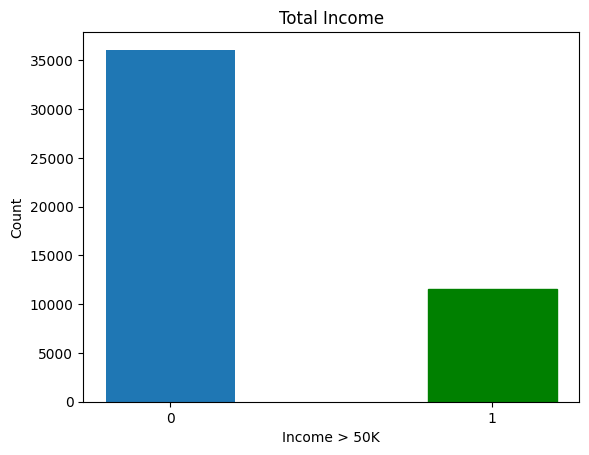

In [15]:
barlist = plt.bar([str(0),str(1)], y.value_counts(), width = 0.4)
barlist[1].set_color('g')

plt.xlabel("Income > 50K")
plt.ylabel("Count")
plt.title("Total Income")
plt.show()

In [16]:
data_total

,age,workclass,fnlwgt,education_num,marital_status,occupation,relationship,race,sex,capital_gain,capital_loss,hours_per_week,native_country,Y
0,39,0.0,77516,13,0,0.0,0,0,0,2174,0,40,0.0,0
1,50,1.0,83311,13,1,1.0,1,0,0,0,0,13,0.0,0
2,38,2.0,215646,9,2,2.0,0,0,0,0,0,40,0.0,0
3,53,2.0,234721,7,1,2.0,1,1,0,0,0,40,0.0,0
4,28,2.0,338409,13,1,3.0,2,1,1,0,0,40,1.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
47616,33,2.0,245211,13,0,3.0,3,0,0,0,0,40,0.0,0
47617,39,2.0,215419,13,2,3.0,0,0,1,0,0,36,0.0,0
47618,38,2.0,374983,13,1,3.0,1,0,0,0,0,50,0.0,0
47619,44,2.0,83891,13,2,0.0,3,2,0,5455,0,40,0.0,0


In [17]:
data_total.iloc[:, 8].value_counts()

,count
sex,
0,31937
1,15684


In [18]:
data2.iloc[:, 8].value_counts()

,count
8,
0.0,31937
1.0,15684


# Splitting for Source and Target Domains:


# Full Dataset:

Grouping by gender: Men are 0, Women are 1

In [19]:
data_S = data2[data2.iloc[:,8] <= 0.5].reset_index(drop=True)  ## Source domain and classification - Male
data_T = data2[data2.iloc[:,8] > 0.5].reset_index(drop=True)  ## Target domain and classification - Female

In [20]:
data_S

,0,1,2,3,4,5,6,7,8,9,10,11,12,Y
0,0.301370,0.000,0.044131,0.800000,0.000000,0.000000,0.0,0.00,0.0,0.021740,0.0,0.397959,0.0,0
1,0.452055,0.125,0.048052,0.800000,0.166667,0.071429,0.2,0.00,0.0,0.000000,0.0,0.122449,0.0,0
2,0.287671,0.250,0.137581,0.533333,0.333333,0.142857,0.0,0.00,0.0,0.000000,0.0,0.397959,0.0,0
3,0.493151,0.250,0.150486,0.400000,0.166667,0.142857,0.2,0.25,0.0,0.000000,0.0,0.397959,0.0,0
4,0.479452,0.125,0.133519,0.533333,0.166667,0.071429,0.2,0.00,0.0,0.000000,0.0,0.448980,0.0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
31932,0.424658,0.500,0.227956,0.866667,0.333333,0.285714,0.0,0.00,0.0,0.000000,0.0,0.397959,0.0,0
31933,0.219178,0.250,0.157583,0.800000,0.000000,0.214286,0.6,0.00,0.0,0.000000,0.0,0.397959,0.0,0
31934,0.287671,0.250,0.245379,0.800000,0.166667,0.214286,0.2,0.00,0.0,0.000000,0.0,0.500000,0.0,0
31935,0.369863,0.250,0.048444,0.800000,0.333333,0.000000,0.6,0.50,0.0,0.054551,0.0,0.397959,0.0,0


In [21]:
data_T

,0,1,2,3,4,5,6,7,8,9,10,11,12,Y
0,0.150685,0.25,0.220635,0.800000,0.166667,0.214286,0.4,0.25,1.0,0.000000,0.0,0.397959,0.02439,0
1,0.273973,0.25,0.184219,0.866667,0.166667,0.071429,0.4,0.00,1.0,0.000000,0.0,0.397959,0.00000,0
2,0.438356,0.25,0.100061,0.266667,0.500000,0.285714,0.0,0.25,1.0,0.000000,0.0,0.153061,0.04878,0
3,0.191781,0.25,0.022661,0.866667,0.000000,0.214286,0.0,0.00,1.0,0.140841,0.0,0.500000,0.00000,1
4,0.082192,0.25,0.074410,0.800000,0.000000,0.000000,0.6,0.00,1.0,0.000000,0.0,0.295918,0.00000,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15679,0.136986,0.25,0.282830,0.600000,0.000000,0.357143,0.0,0.00,1.0,0.000000,0.0,0.448980,0.00000,0
15680,0.520548,0.25,0.143676,0.533333,0.666667,1.000000,0.0,0.00,1.0,0.000000,0.0,0.316327,0.00000,0
15681,0.287671,0.25,0.159164,0.666667,0.000000,0.000000,0.8,0.25,1.0,0.000000,0.0,0.397959,0.00000,0
15682,0.109589,0.25,0.229138,0.533333,0.000000,0.285714,0.6,0.00,1.0,0.000000,0.0,0.397959,0.00000,0


## Source domain and task labels:

In [22]:
X_S_full = data_S.iloc[:, :-1]
X_S_full       ## Source domain


y_S_full = data_S.iloc[:, -1]
y_S_full       ## Source classification (response)

,Y
0,0
1,0
2,0
3,0
4,1
...,...
31932,0
31933,0
31934,0
31935,0


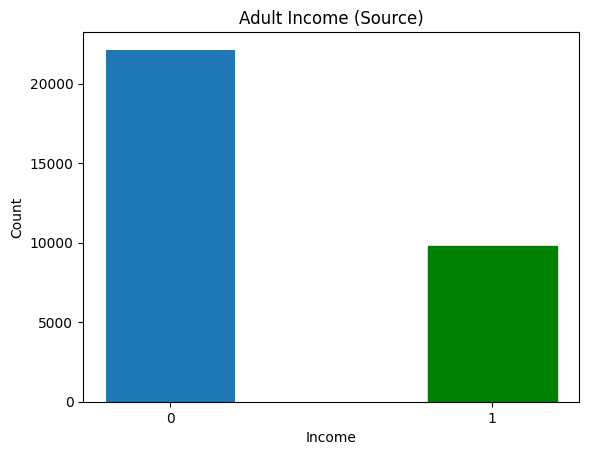

In [23]:
barlist_S = plt.bar([str(0),str(1)], y_S_full.value_counts(), width = 0.4)
barlist_S[1].set_color('g')

plt.xlabel("Income")
plt.ylabel("Count")
plt.title("Adult Income (Source)")
plt.show()

## Target domain and task labels:

In [24]:
X_T_full = data_T.iloc[:, :-1]
X_T_full       ## Target domain


y_T_full = data_T.iloc[:, -1]
y_T_full       ## Target classification (response)

,Y
0,0
1,0
2,0
3,1
4,0
...,...
15679,0
15680,0
15681,0
15682,0


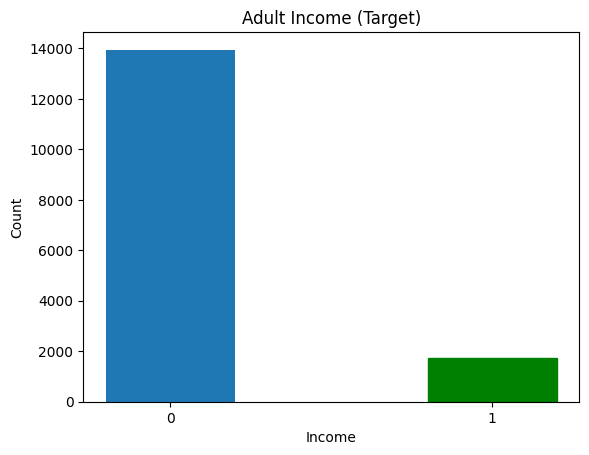

In [25]:
barlist_T = plt.bar([str(0),str(1)], y_T_full.value_counts(), width = 0.4)
barlist_T[1].set_color('g')

plt.xlabel("Income")
plt.ylabel("Count")
plt.title("Adult Income (Target)")
plt.show()

## Updated Code (Modified from Shreya's code):

In [26]:
def create_dnn_model(input_shape):
  model = models.Sequential([layers.Dense(64, activation='relu', input_dim=input_shape),
        layers.Dense(32, activation='relu'),
        layers.Dense(1, activation='sigmoid')  # For binary classification (yes/no diabetes)
    ])

  model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['AUC'])

  return model



def train_and_evaluate(model, X_train, X_test, y_train, y_test, domain):

    time_start = perf_counter()

    # Training and validation
    model.fit(X_train, y_train, epochs=10, batch_size=32, validation_split=0.2)

    # Predict probabilities and calculate AUC
    y_pred_prob = model.predict(X_test).ravel()
    auc = roc_auc_score(y_test, y_pred_prob)
    print(f"AUC-ROC: {auc}")

    # Compute ROC curve
    fpr, tpr, _ = roc_curve(y_test, y_pred_prob)

    # Convert probabilities to binary predictions for confusion matrix
    y_pred_class = (y_pred_prob >= 0.5).astype(int)

    # Compute and print classification report
    class_report = classification_report(y_test, y_pred_class)
    print("Classification Report:")
    print(class_report)

    # Compute confusion matrix
    conf_matrix = confusion_matrix(y_test, y_pred_class)
    # conf_disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix)

    # Plot ROC curve and Confusion Matrix side by side
    # fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))

    # # ROC Curve
    # ax1.plot(fpr, tpr, color='blue', label=f'AUC-ROC = {auc:.2f}')
    # ax1.plot([0, 1], [0, 1], color='gray', linestyle='--')
    # ax1.set_xlabel('False Positive Rate')
    # ax1.set_ylabel('True Positive Rate')
    # ax1.set_title('Receiver Operating Characteristic (ROC) Curve')
    # ax1.legend(loc='lower right')
    # ax1.grid()

    # # Confusion Matrix
    # conf_disp.plot(ax=ax2, cmap='Blues')
    # ax2.set_title('Confusion Matrix')
    # plt.tight_layout()
    # plt.show()

    # Calculate precision and recall for different thresholds
    precision, recall, thresholds = precision_recall_curve(y_test, y_pred_prob)

    # Find the threshold where precision and recall are balanced
    f1_scores = 2 * (precision * recall) / (precision + recall)
    best_threshold = thresholds[f1_scores.argmax()]

    print(f"Best threshold based on F1-score: {best_threshold}")

    time_stop = perf_counter()

    time_elapsed = time_stop-time_start

    print('Time elapsed (performance):', time_elapsed)
    return time_elapsed


In [27]:
def Transductive_TL(model, X_test, y_test, domain):

    time_start = perf_counter()

    # Predict probabilities and calculate AUC
    y_pred_prob = model.predict(X_test).ravel()
    auc = roc_auc_score(y_test, y_pred_prob)
    print(f"AUC-ROC: {auc}")

    # Compute ROC curve
    fpr, tpr, _ = roc_curve(y_test, y_pred_prob)

    # Convert probabilities to binary predictions for confusion matrix
    y_pred_class = (y_pred_prob >= 0.5).astype(int)

    # Compute and print classification report
    class_report = classification_report(y_test, y_pred_class)
    print("Classification Report:")
    print(class_report)

    # Compute confusion matrix
    conf_matrix = confusion_matrix(y_test, y_pred_class)
    conf_disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix)

    # Plot ROC curve and Confusion Matrix side by side
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))

    # ROC Curve
    ax1.plot(fpr, tpr, color='blue', label=f'AUC-ROC = {auc:.2f}')
    ax1.plot([0, 1], [0, 1], color='gray', linestyle='--')
    ax1.set_xlabel('False Positive Rate')
    ax1.set_ylabel('True Positive Rate')
    ax1.set_title('Receiver Operating Characteristic (ROC) Curve')
    ax1.legend(loc='lower right')
    ax1.grid()

    # Confusion Matrix
    # print('Confusion matrix:', conf_matrix)
    fpr = conf_matrix[0][1]/(conf_matrix[0][0]+conf_matrix[0][1])
    tnr = 1-fpr

    fnr = conf_matrix[1][0]/(conf_matrix[1][0] + conf_matrix[1][1])
    tpr = 1 - fnr
    print('FPR', fpr, 'TPR:', tpr, 'FNR:', fnr, 'TNR:', tnr)
    conf_disp.plot(ax=ax2, cmap='Blues')
    ax2.set_title('Confusion Matrix')
    plt.tight_layout()
    plt.show()

    # Calculate precision and recall for different thresholds
    precision, recall, thresholds = precision_recall_curve(y_test, y_pred_prob)

    # Find the threshold where precision and recall are balanced
    f1_scores = 2 * (precision * recall) / (precision + recall)
    best_threshold = thresholds[f1_scores.argmax()]

    print(f"Best threshold based on F1-score: {best_threshold}")
    print('False Negative Rate:', fnr)

    time_stop = perf_counter()

    time_elapsed = time_stop-time_start

    print('Time elapsed (performance):', time_elapsed)

    return fpr, tnr, fnr, tpr, time_elapsed

In [28]:
X_S_train, X_S_test, y_S_train, y_S_test = train_test_split(X_S_full, y_S_full, test_size=0.20, random_state=0)

In [29]:
print('X_S_train:',np.shape(X_S_train))
print('y_S_train:',np.shape(y_S_train))
print('X_S_test:',np.shape(X_S_test))
print('y_S_test:',np.shape(y_S_test))

X_S_train: (25549, 13)
y_S_train: (25549,)
X_S_test: (6388, 13)
y_S_test: (6388,)


In [30]:
model_source = create_dnn_model(X_S_train.shape[1])

/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.6789 - loss: 0.5618 - val_AUC: 0.8708 - val_loss: 0.4114
Epoch 2/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8662 - loss: 0.4083 - val_AUC: 0.8777 - val_loss: 0.3986
Epoch 3/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8710 - loss: 0.4009 - val_AUC: 0.8790 - val_loss: 0.4029
Epoch 4/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8713 - loss: 0.3988 - val_AUC: 0.8795 - val_loss: 0.4032
Epoch 5/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8765 - loss: 0.3942 - val_AUC: 0.8799 - val_loss: 0.3941
Epoch 6/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8761 - loss: 0.3906 - val_AUC: 0.8798 - val_loss: 0.4004
Epoch 7/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8768 - loss: 0.3947 - val_AUC: 0.8798 - val_loss: 0.3937
Epoch 8/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8779 - loss: 0.3917 - val_AUC: 0.8803 - val_loss: 0.3965
Epoch 9/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AU

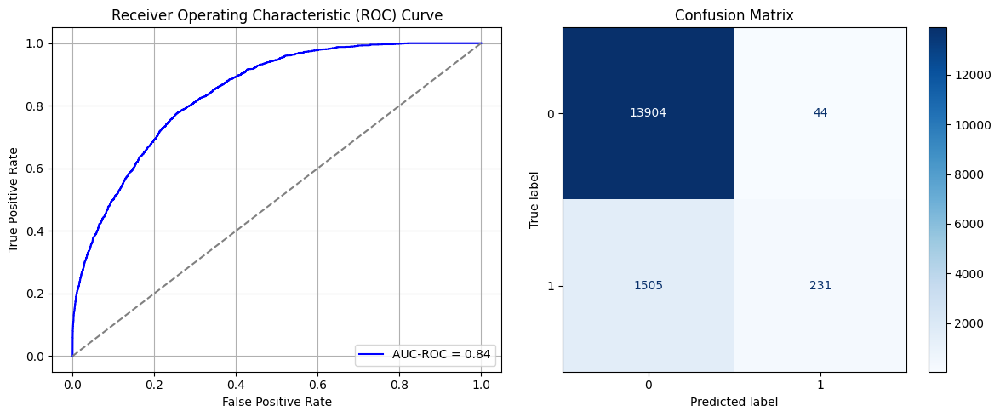

Best threshold based on F1-score: 0.07643900066614151
False Negative Rate: 0.8669354838709677
Time elapsed (performance): 3.2352918679999902
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


639/639 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.6996 - loss: 0.5448 - val_AUC: 0.8708 - val_loss: 0.4133
Epoch 2/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8578 - loss: 0.4216 - val_AUC: 0.8769 - val_loss: 0.4068
Epoch 3/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8708 - loss: 0.4035 - val_AUC: 0.8777 - val_loss: 0.3973
Epoch 4/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8722 - loss: 0.3991 - val_AUC: 0.8781 - val_loss: 0.3987
Epoch 5/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8756 - loss: 0.3953 - val_AUC: 0.8771 - val_loss: 0.4019
Epoch 6/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8742 - loss: 0.3980 - val_AUC: 0.8794 - val_loss: 0.3940
Epoch 7/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8732 - loss: 0.3979 - val_AUC: 0.8794 - val_loss: 0.3939
Epoch 8/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8831 - loss: 0.3868 - val_AUC: 0.8786 - val_loss: 0.3975
Epoch 9/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8731 -

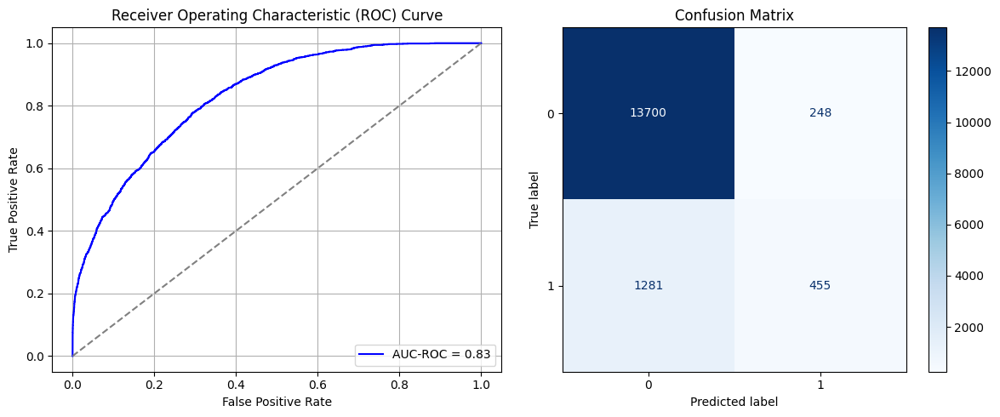

Best threshold based on F1-score: 0.26400813460350037
False Negative Rate: 0.7379032258064516
Time elapsed (performance): 1.9524687919999906
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.7051 - loss: 0.5467 - val_AUC: 0.8725 - val_loss: 0.4195
Epoch 2/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8701 - loss: 0.4061 - val_AUC: 0.8770 - val_loss: 0.4048
Epoch 3/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8716 - loss: 0.3992 - val_AUC: 0.8774 - val_loss: 0.4008
Epoch 4/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8747 - loss: 0.3996 - val_AUC: 0.8786 - val_loss: 0.3975
Epoch 5/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8752 - loss: 0.3953 - val_AUC: 0.8787 - val_loss: 0.3965
Epoch 6/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8810 - loss: 0.3868 - val_AUC: 0.8790 - val_loss: 0.3979
Epoch 7/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8770 - loss: 0.3919 - val_AUC: 0.8800 - val_loss: 0.3938
Epoch 8/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8789 - loss: 0.3861 - val_AUC: 0.8790 - val_loss: 0.3952
Epoch 9/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8771 -

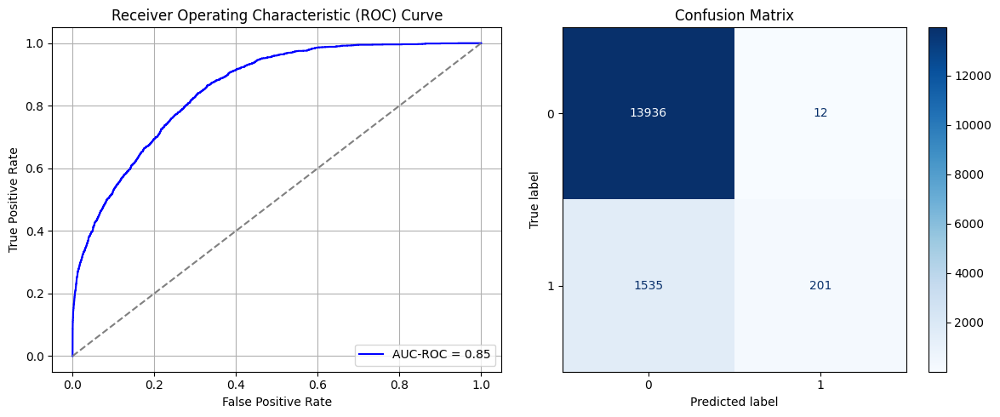

Best threshold based on F1-score: 0.0420566163957119
False Negative Rate: 0.8842165898617511
Time elapsed (performance): 1.2958036919999927
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


639/639 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.6839 - loss: 0.5602 - val_AUC: 0.8705 - val_loss: 0.4133
Epoch 2/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8675 - loss: 0.4083 - val_AUC: 0.8758 - val_loss: 0.4119
Epoch 3/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8753 - loss: 0.3957 - val_AUC: 0.8766 - val_loss: 0.4164
Epoch 4/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8717 - loss: 0.3999 - val_AUC: 0.8780 - val_loss: 0.3968
Epoch 5/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8719 - loss: 0.4009 - val_AUC: 0.8775 - val_loss: 0.3973
Epoch 6/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8750 - loss: 0.3958 - val_AUC: 0.8785 - val_loss: 0.4045
Epoch 7/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8758 - loss: 0.3929 - val_AUC: 0.8778 - val_loss: 0.3996
Epoch 8/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8768 - loss: 0.3936 - val_AUC: 0.8798 - val_loss: 0.3957
Epoch 9/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8761 -

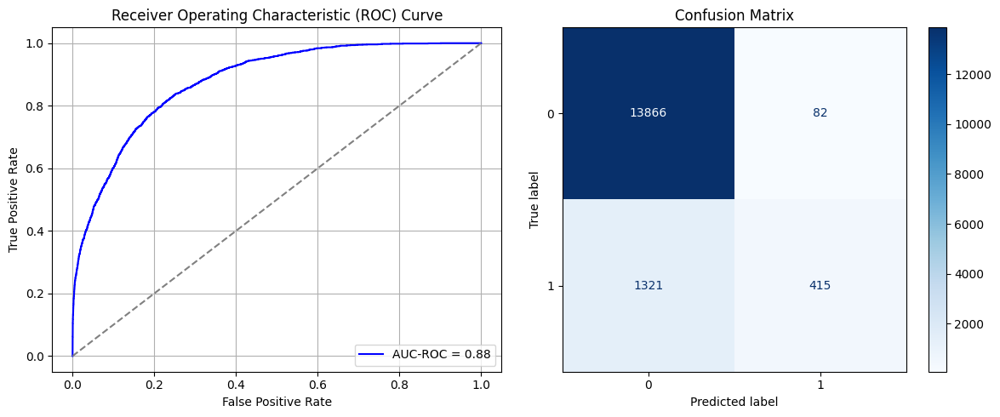

Best threshold based on F1-score: 0.1840185523033142
False Negative Rate: 0.7609447004608295
Time elapsed (performance): 1.718157817999952
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


639/639 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7105 - loss: 0.5422 - val_AUC: 0.8716 - val_loss: 0.4217
Epoch 2/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8688 - loss: 0.4071 - val_AUC: 0.8777 - val_loss: 0.3977
Epoch 3/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8749 - loss: 0.3959 - val_AUC: 0.8787 - val_loss: 0.3970
Epoch 4/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8733 - loss: 0.3988 - val_AUC: 0.8790 - val_loss: 0.3954
Epoch 5/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8733 - loss: 0.3963 - val_AUC: 0.8780 - val_loss: 0.3956
Epoch 6/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8748 - loss: 0.3958 - val_AUC: 0.8789 - val_loss: 0.3969
Epoch 7/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8749 - loss: 0.3974 - val_AUC: 0.8797 - val_loss: 0.3931
Epoch 8/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8809 - loss: 0.3862 - val_AUC: 0.8806 - val_loss: 0.3949
Epoch 9/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8771 -

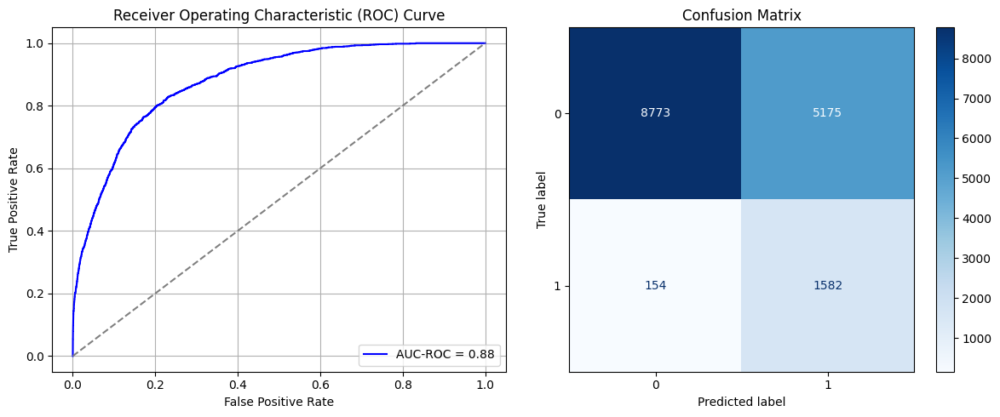

Best threshold based on F1-score: 0.7734152674674988
False Negative Rate: 0.08870967741935484
Time elapsed (performance): 1.2656641500000205
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


639/639 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.7049 - loss: 0.5489 - val_AUC: 0.8705 - val_loss: 0.4145
Epoch 2/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8677 - loss: 0.4090 - val_AUC: 0.8779 - val_loss: 0.3979
Epoch 3/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8671 - loss: 0.4056 - val_AUC: 0.8787 - val_loss: 0.3972
Epoch 4/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8765 - loss: 0.3934 - val_AUC: 0.8782 - val_loss: 0.3996
Epoch 5/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8721 - loss: 0.4010 - val_AUC: 0.8793 - val_loss: 0.3964
Epoch 6/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8762 - loss: 0.3933 - val_AUC: 0.8793 - val_loss: 0.4071
Epoch 7/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8739 - loss: 0.3997 - val_AUC: 0.8796 - val_loss: 0.3938
Epoch 8/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8756 - loss: 0.3968 - val_AUC: 0.8785 - val_loss: 0.3966
Epoch 9/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8732 -

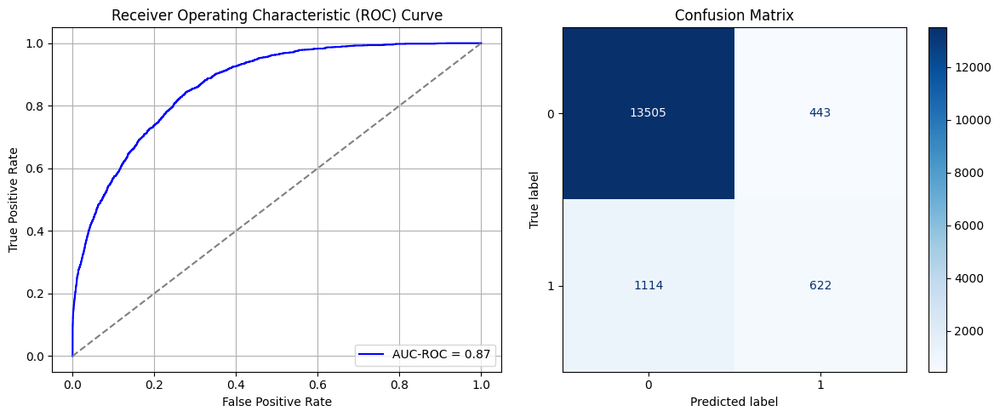

Best threshold based on F1-score: 0.3944598138332367
False Negative Rate: 0.6417050691244239
Time elapsed (performance): 1.2289912350000236
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


639/639 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.7007 - loss: 0.5489 - val_AUC: 0.8724 - val_loss: 0.4181
Epoch 2/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8656 - loss: 0.4116 - val_AUC: 0.8763 - val_loss: 0.4002
Epoch 3/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8753 - loss: 0.3954 - val_AUC: 0.8781 - val_loss: 0.3980
Epoch 4/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8720 - loss: 0.3984 - val_AUC: 0.8780 - val_loss: 0.4080
Epoch 5/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8717 - loss: 0.3997 - val_AUC: 0.8785 - val_loss: 0.3956
Epoch 6/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8756 - loss: 0.3934 - val_AUC: 0.8792 - val_loss: 0.3948
Epoch 7/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8807 - loss: 0.3889 - val_AUC: 0.8775 - val_loss: 0.4096
Epoch 8/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8776 - loss: 0.3871 - val_AUC: 0.8800 - val_loss: 0.3943
Epoch 9/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8755 -

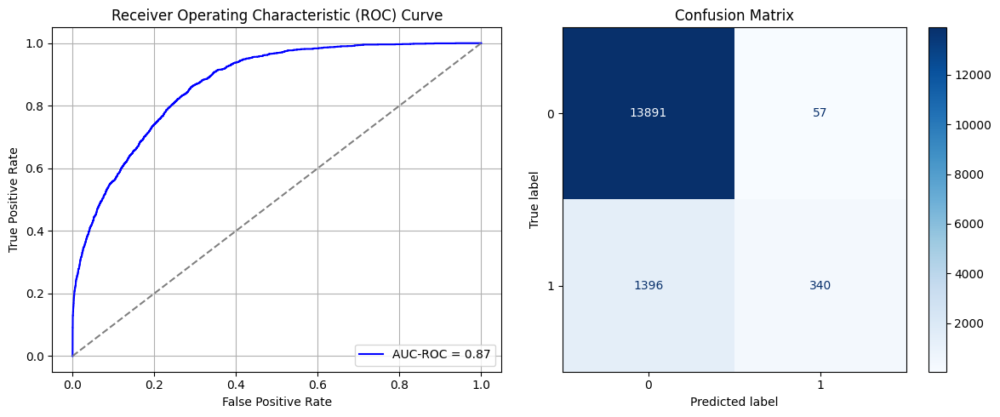

Best threshold based on F1-score: 0.13191011548042297
False Negative Rate: 0.804147465437788
Time elapsed (performance): 1.2425496140000405
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


639/639 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7122 - loss: 0.5463 - val_AUC: 0.8708 - val_loss: 0.4195
Epoch 2/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8651 - loss: 0.4101 - val_AUC: 0.8749 - val_loss: 0.4029
Epoch 3/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8684 - loss: 0.4059 - val_AUC: 0.8772 - val_loss: 0.4181
Epoch 4/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8706 - loss: 0.3997 - val_AUC: 0.8785 - val_loss: 0.4035
Epoch 5/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8675 - loss: 0.4079 - val_AUC: 0.8782 - val_loss: 0.4085
Epoch 6/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8758 - loss: 0.3948 - val_AUC: 0.8785 - val_loss: 0.3978
Epoch 7/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8754 - loss: 0.3940 - val_AUC: 0.8780 - val_loss: 0.3987
Epoch 8/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8763 - loss: 0.3957 - val_AUC: 0.8779 - val_loss: 0.3961
Epoch 9/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8768 -

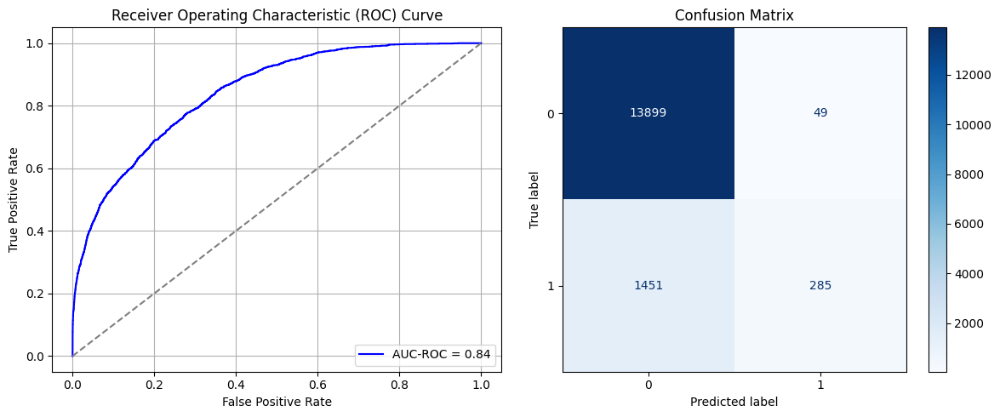

Best threshold based on F1-score: 0.10769358277320862
False Negative Rate: 0.8358294930875576
Time elapsed (performance): 1.7098165129999643
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


639/639 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.7251 - loss: 0.5364 - val_AUC: 0.8714 - val_loss: 0.4211
Epoch 2/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8673 - loss: 0.4094 - val_AUC: 0.8768 - val_loss: 0.4054
Epoch 3/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8714 - loss: 0.4000 - val_AUC: 0.8770 - val_loss: 0.4018
Epoch 4/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8756 - loss: 0.3958 - val_AUC: 0.8785 - val_loss: 0.3980
Epoch 5/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8740 - loss: 0.3982 - val_AUC: 0.8791 - val_loss: 0.3953
Epoch 6/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8750 - loss: 0.3955 - val_AUC: 0.8777 - val_loss: 0.3983
Epoch 7/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8761 - loss: 0.3922 - val_AUC: 0.8790 - val_loss: 0.3949
Epoch 8/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8733 - loss: 0.3968 - val_AUC: 0.8789 - val_loss: 0.3948
Epoch 9/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8750 -

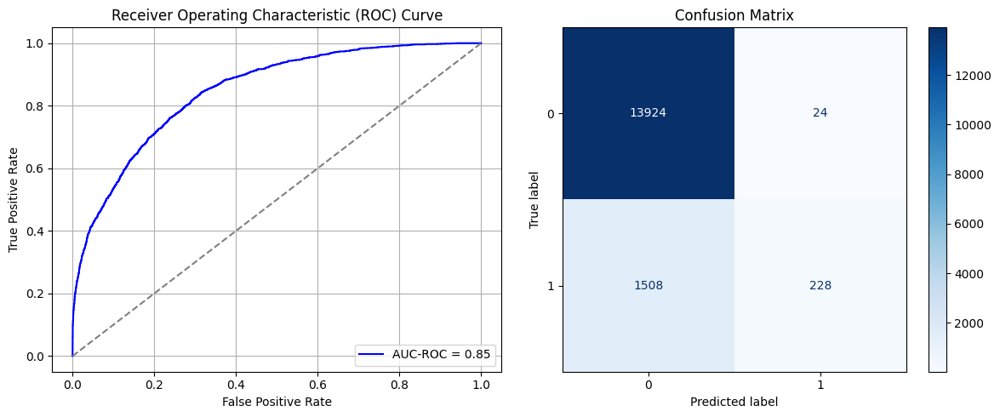

Best threshold based on F1-score: 0.11740896850824356
False Negative Rate: 0.868663594470046
Time elapsed (performance): 1.2255873230000134
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.7121 - loss: 0.5476 - val_AUC: 0.8721 - val_loss: 0.4121
Epoch 2/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8675 - loss: 0.4089 - val_AUC: 0.8777 - val_loss: 0.4003
Epoch 3/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8735 - loss: 0.3967 - val_AUC: 0.8772 - val_loss: 0.3983
Epoch 4/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8682 - loss: 0.4002 - val_AUC: 0.8787 - val_loss: 0.3977
Epoch 5/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8752 - loss: 0.3932 - val_AUC: 0.8785 - val_loss: 0.3965
Epoch 6/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8760 - loss: 0.3947 - val_AUC: 0.8795 - val_loss: 0.3944
Epoch 7/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8723 - loss: 0.3975 - val_AUC: 0.8798 - val_loss: 0.3939
Epoch 8/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8762 - loss: 0.3920 - val_AUC: 0.8794 - val_loss: 0.3946
Epoch 9/10
639/639 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8749 -

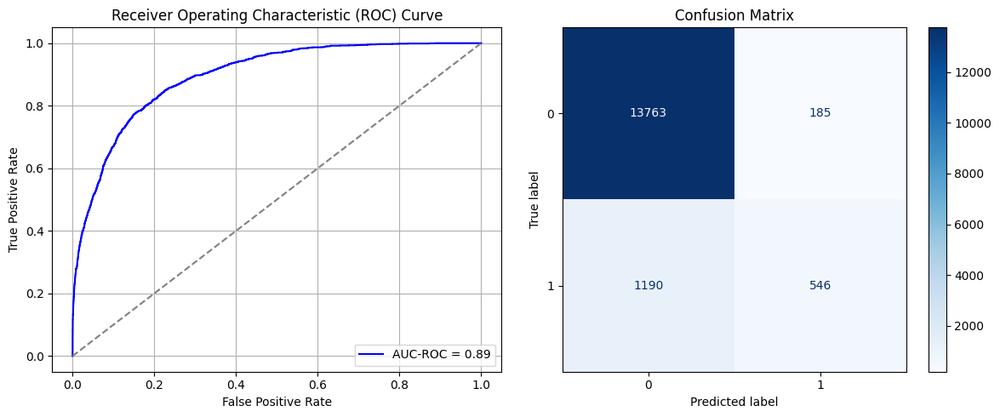

Best threshold based on F1-score: 0.24794220924377441
False Negative Rate: 0.6854838709677419
Time elapsed (performance): 1.71290021599998


In [31]:
times = 10

Training_time = []
FPR = []
TPR = []
FNR = []
TNR = []
TL_time = []


for i in range(times):
    X_S_train, X_S_test, y_S_train, y_S_test = train_test_split(X_S_full, y_S_full, test_size=0.20, random_state=0)
    model_source = create_dnn_model(X_S_train.shape[1])
    result_imbalanced = train_and_evaluate(model_source, X_S_train, X_S_test, y_S_train, y_S_test, "Source")
    result_TL_imbalanced = Transductive_TL(model_source, X_T_full, y_T_full, "Target")

    Training_time.append(result_imbalanced)
    FPR.append(result_TL_imbalanced[0])
    TNR.append(result_TL_imbalanced[1])
    FNR.append(result_TL_imbalanced[2])
    TPR.append(result_TL_imbalanced[3])
    TL_time.append(result_TL_imbalanced[4])

ParamFit = pd.DataFrame([Training_time, FPR, TPR, FNR, TNR, TL_time]).T
ParamFit.columns=['Source time', 'FPR', 'TPR', 'FNR', 'TNR', 'Target time']
# print(ParamFit)

In [32]:
print(ParamFit)
ParamFit.to_csv('Imbalanced.csv')

## Remember that TPR is actually TNR and TNR is actually TPR!!!

   Source time       FPR       TPR       FNR       TNR  Target time
0    27.268815  0.003155  0.133065  0.866935  0.996845     3.235292
1    27.943293  0.017780  0.262097  0.737903  0.982220     1.952469
2    28.494943  0.000860  0.115783  0.884217  0.999140     1.295804
3    28.823852  0.005879  0.239055  0.760945  0.994121     1.718158
4    31.533957  0.371021  0.911290  0.088710  0.628979     1.265664
5    26.761393  0.031761  0.358295  0.641705  0.968239     1.228991
6    26.214202  0.004087  0.195853  0.804147  0.995913     1.242550
7    30.481468  0.003513  0.164171  0.835829  0.996487     1.709817
8    25.764450  0.001721  0.131336  0.868664  0.998279     1.225587
9    26.962656  0.013264  0.314516  0.685484  0.986736     1.712900


In [33]:
ParamFit['FNR'].mean()

np.float64(0.7174539170506913)

In [35]:
ParamFit['Source time'].mean()

np.float64(28.024902825899993)

# Random Undersampling (RUS) to balance Dataset:

## SRS Sample without Replacement:

In [36]:
data_S

,0,1,2,3,4,5,6,7,8,9,10,11,12,Y
0,0.301370,0.000,0.044131,0.800000,0.000000,0.000000,0.0,0.00,0.0,0.021740,0.0,0.397959,0.0,0
1,0.452055,0.125,0.048052,0.800000,0.166667,0.071429,0.2,0.00,0.0,0.000000,0.0,0.122449,0.0,0
2,0.287671,0.250,0.137581,0.533333,0.333333,0.142857,0.0,0.00,0.0,0.000000,0.0,0.397959,0.0,0
3,0.493151,0.250,0.150486,0.400000,0.166667,0.142857,0.2,0.25,0.0,0.000000,0.0,0.397959,0.0,0
4,0.479452,0.125,0.133519,0.533333,0.166667,0.071429,0.2,0.00,0.0,0.000000,0.0,0.448980,0.0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
31932,0.424658,0.500,0.227956,0.866667,0.333333,0.285714,0.0,0.00,0.0,0.000000,0.0,0.397959,0.0,0
31933,0.219178,0.250,0.157583,0.800000,0.000000,0.214286,0.6,0.00,0.0,0.000000,0.0,0.397959,0.0,0
31934,0.287671,0.250,0.245379,0.800000,0.166667,0.214286,0.2,0.00,0.0,0.000000,0.0,0.500000,0.0,0
31935,0.369863,0.250,0.048444,0.800000,0.333333,0.000000,0.6,0.50,0.0,0.054551,0.0,0.397959,0.0,0


In [37]:
data_S
data_S_majority = data_S[data_S['Y'].isin([0])]
data_S_minority = data_S[data_S['Y'].isin([1])]

undersample_size = data_S_minority['Y'].size
oversample_size = data_S_majority['Y'].size

print(undersample_size)
print(oversample_size)

9805
22132


Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7043 - loss: 0.6292 - val_AUC: 0.8532 - val_loss: 0.4813
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8573 - loss: 0.4696 - val_AUC: 0.8709 - val_loss: 0.4448
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8724 - loss: 0.4400 - val_AUC: 0.8738 - val_loss: 0.4403
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8753 - loss: 0.4365 - val_AUC: 0.8722 - val_loss: 0.4426
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8724 - loss: 0.4391 - val_AUC: 0.8752 - val_loss: 0.4403
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - AUC: 0.8754 - loss: 0.4358 - val_AUC: 0.8763 - val_loss: 0.4375
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8746 - loss: 0.4365 - val_AUC: 0.8765 - val_loss: 0.4355
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8748 - loss: 0.4346 - val_AUC: 0.8765 - val_loss: 0.4350
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8758 -

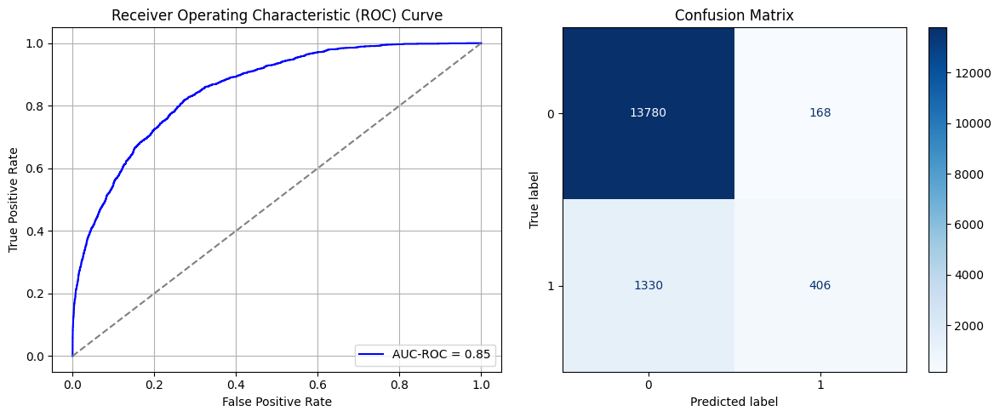

Best threshold based on F1-score: 0.16696439683437347
False Negative Rate: 0.7661290322580645
Time elapsed (performance): 1.641035396999996
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7270 - loss: 0.6205 - val_AUC: 0.8616 - val_loss: 0.4688
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8552 - loss: 0.4708 - val_AUC: 0.8728 - val_loss: 0.4494
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8705 - loss: 0.4453 - val_AUC: 0.8730 - val_loss: 0.4412
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8731 - loss: 0.4402 - val_AUC: 0.8753 - val_loss: 0.4398
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8766 - loss: 0.4327 - val_AUC: 0.8752 - val_loss: 0.4373
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8703 - loss: 0.4437 - val_AUC: 0.8749 - val_loss: 0.4373
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8731 - loss: 0.4397 - val_AUC: 0.8752 - val_loss: 0.4452
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8794 - loss: 0.4284 - val_AUC: 0.8769 - val_loss: 0.4354
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8818 -

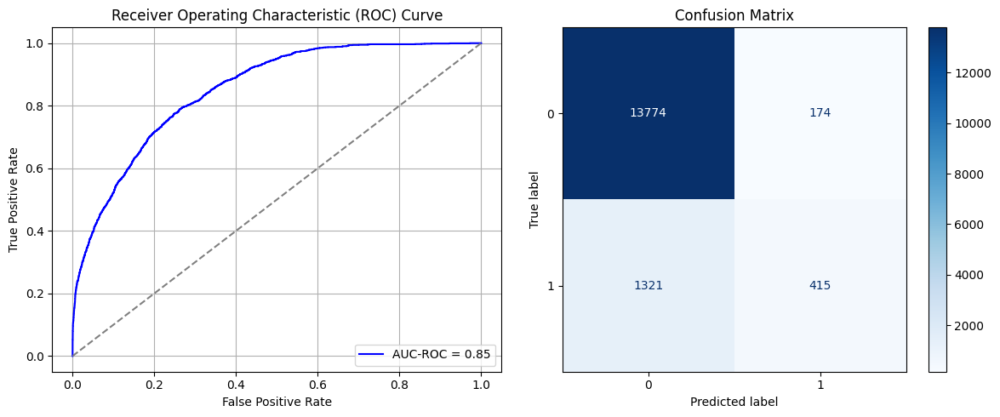

Best threshold based on F1-score: 0.20816418528556824
False Negative Rate: 0.7609447004608295
Time elapsed (performance): 1.615469965000102
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7353 - loss: 0.6209 - val_AUC: 0.8530 - val_loss: 0.4851
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8656 - loss: 0.4579 - val_AUC: 0.8734 - val_loss: 0.4431
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8700 - loss: 0.4440 - val_AUC: 0.8757 - val_loss: 0.4381
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8796 - loss: 0.4311 - val_AUC: 0.8743 - val_loss: 0.4404
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8716 - loss: 0.4414 - val_AUC: 0.8756 - val_loss: 0.4395
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8728 - loss: 0.4402 - val_AUC: 0.8738 - val_loss: 0.4457
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8767 - loss: 0.4335 - val_AUC: 0.8759 - val_loss: 0.4382
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8805 - loss: 0.4279 - val_AUC: 0.8745 - val_loss: 0.4390
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8771 -

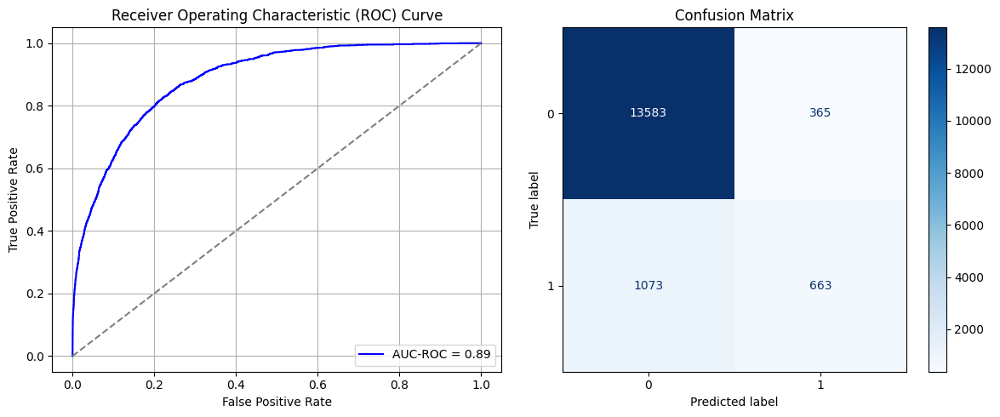

Best threshold based on F1-score: 0.28786104917526245
False Negative Rate: 0.6180875576036866
Time elapsed (performance): 1.7970670739998695
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.7091 - loss: 0.6187 - val_AUC: 0.8552 - val_loss: 0.4835
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8604 - loss: 0.4630 - val_AUC: 0.8741 - val_loss: 0.4718
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8702 - loss: 0.4461 - val_AUC: 0.8761 - val_loss: 0.4399
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - AUC: 0.8761 - loss: 0.4360 - val_AUC: 0.8757 - val_loss: 0.4397
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8749 - loss: 0.4380 - val_AUC: 0.8771 - val_loss: 0.4420
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8789 - loss: 0.4322 - val_AUC: 0.8783 - val_loss: 0.4397
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8774 - loss: 0.4335 - val_AUC: 0.8791 - val_loss: 0.4395
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8772 - loss: 0.4335 - val_AUC: 0.8786 - val_loss: 0.4426
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8784 -

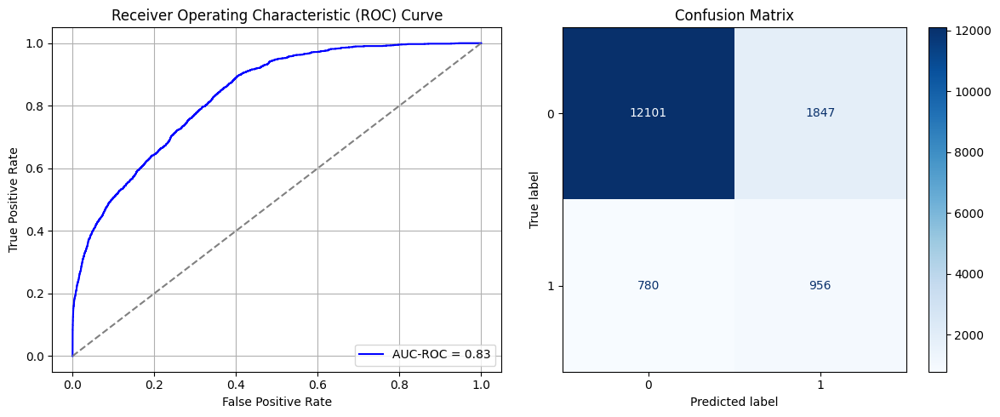

Best threshold based on F1-score: 0.6763814687728882
False Negative Rate: 0.44930875576036866
Time elapsed (performance): 1.3048061829999824
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7489 - loss: 0.6081 - val_AUC: 0.8578 - val_loss: 0.4914
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8559 - loss: 0.4676 - val_AUC: 0.8702 - val_loss: 0.4469
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8724 - loss: 0.4403 - val_AUC: 0.8720 - val_loss: 0.4428
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8778 - loss: 0.4325 - val_AUC: 0.8715 - val_loss: 0.4604
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8778 - loss: 0.4318 - val_AUC: 0.8735 - val_loss: 0.4400
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8757 - loss: 0.4355 - val_AUC: 0.8742 - val_loss: 0.4520
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8751 - loss: 0.4353 - val_AUC: 0.8730 - val_loss: 0.4442
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8765 - loss: 0.4333 - val_AUC: 0.8737 - val_loss: 0.4426
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8810 -

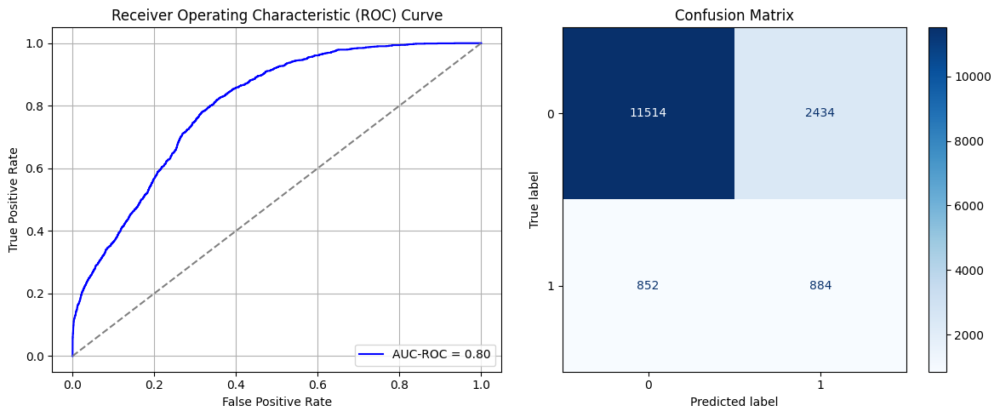

Best threshold based on F1-score: 0.33218228816986084
False Negative Rate: 0.49078341013824883
Time elapsed (performance): 1.6919185050001033
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7346 - loss: 0.6135 - val_AUC: 0.8611 - val_loss: 0.4721
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8611 - loss: 0.4636 - val_AUC: 0.8713 - val_loss: 0.4447
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8719 - loss: 0.4439 - val_AUC: 0.8725 - val_loss: 0.4426
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8686 - loss: 0.4484 - val_AUC: 0.8746 - val_loss: 0.4408
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8716 - loss: 0.4424 - val_AUC: 0.8738 - val_loss: 0.4412
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8759 - loss: 0.4337 - val_AUC: 0.8738 - val_loss: 0.4461
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8743 - loss: 0.4377 - val_AUC: 0.8742 - val_loss: 0.4385
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8704 - loss: 0.4452 - val_AUC: 0.8757 - val_loss: 0.4370
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8727 -

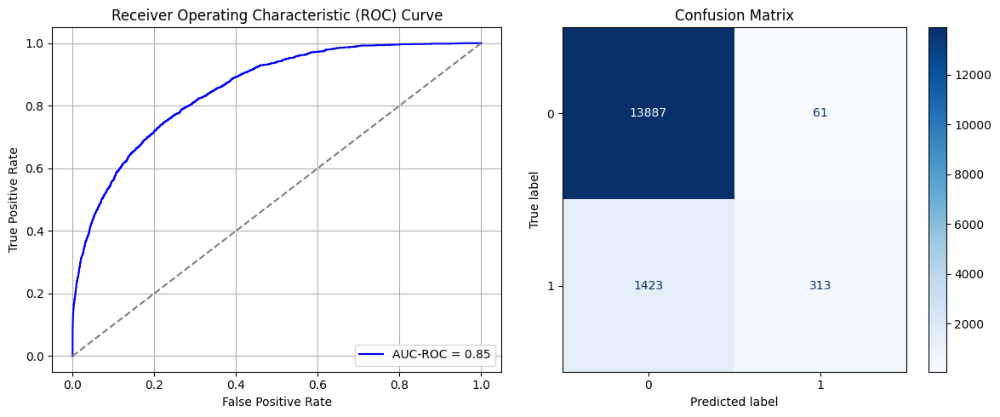

Best threshold based on F1-score: 0.12584556639194489
False Negative Rate: 0.8197004608294931
Time elapsed (performance): 1.7208649619999505
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7411 - loss: 0.6061 - val_AUC: 0.8544 - val_loss: 0.4855
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8584 - loss: 0.4680 - val_AUC: 0.8674 - val_loss: 0.4553
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8705 - loss: 0.4453 - val_AUC: 0.8709 - val_loss: 0.4436
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8710 - loss: 0.4455 - val_AUC: 0.8723 - val_loss: 0.4448
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8726 - loss: 0.4407 - val_AUC: 0.8729 - val_loss: 0.4405
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8709 - loss: 0.4438 - val_AUC: 0.8723 - val_loss: 0.4412
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8748 - loss: 0.4373 - val_AUC: 0.8725 - val_loss: 0.4398
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8705 - loss: 0.4434 - val_AUC: 0.8735 - val_loss: 0.4390
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8785 -

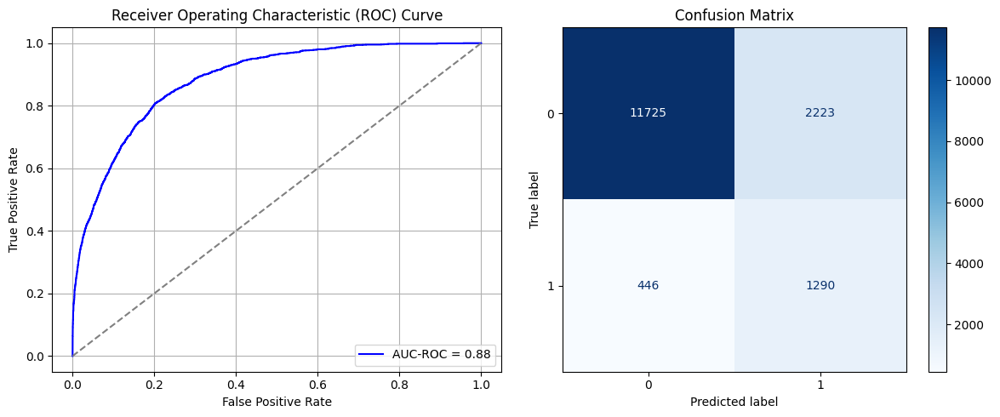

Best threshold based on F1-score: 0.6490663886070251
False Negative Rate: 0.2569124423963134
Time elapsed (performance): 1.906960227999889
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7359 - loss: 0.6138 - val_AUC: 0.8621 - val_loss: 0.4697
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8625 - loss: 0.4608 - val_AUC: 0.8726 - val_loss: 0.4428
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8674 - loss: 0.4479 - val_AUC: 0.8776 - val_loss: 0.4348
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8691 - loss: 0.4440 - val_AUC: 0.8779 - val_loss: 0.4349
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8756 - loss: 0.4379 - val_AUC: 0.8785 - val_loss: 0.4329
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8718 - loss: 0.4413 - val_AUC: 0.8792 - val_loss: 0.4310
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8744 - loss: 0.4374 - val_AUC: 0.8788 - val_loss: 0.4376
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8687 - loss: 0.4445 - val_AUC: 0.8794 - val_loss: 0.4311
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8772 -

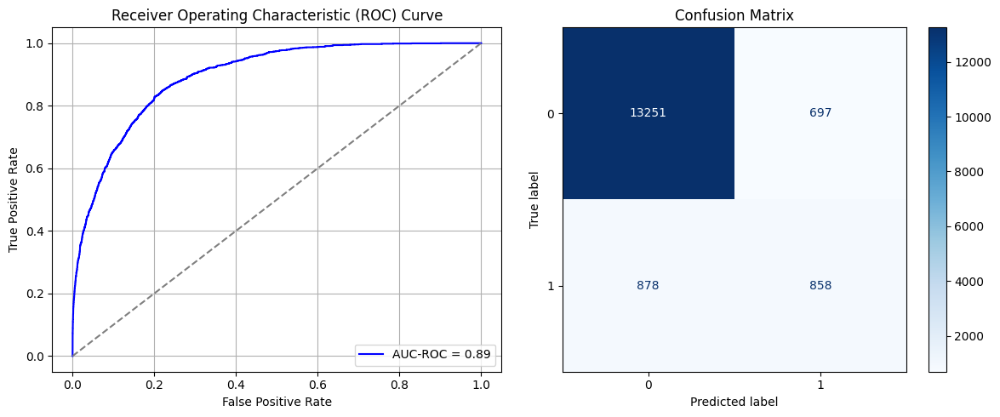

Best threshold based on F1-score: 0.40864452719688416
False Negative Rate: 0.5057603686635944
Time elapsed (performance): 1.2702524489998268
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7276 - loss: 0.6113 - val_AUC: 0.8571 - val_loss: 0.4746
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8606 - loss: 0.4644 - val_AUC: 0.8744 - val_loss: 0.4501
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8618 - loss: 0.4574 - val_AUC: 0.8732 - val_loss: 0.4425
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8705 - loss: 0.4452 - val_AUC: 0.8746 - val_loss: 0.4492
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8713 - loss: 0.4440 - val_AUC: 0.8749 - val_loss: 0.4415
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8706 - loss: 0.4455 - val_AUC: 0.8749 - val_loss: 0.4416
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8778 - loss: 0.4321 - val_AUC: 0.8755 - val_loss: 0.4393
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8789 - loss: 0.4319 - val_AUC: 0.8765 - val_loss: 0.4363
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8763 -

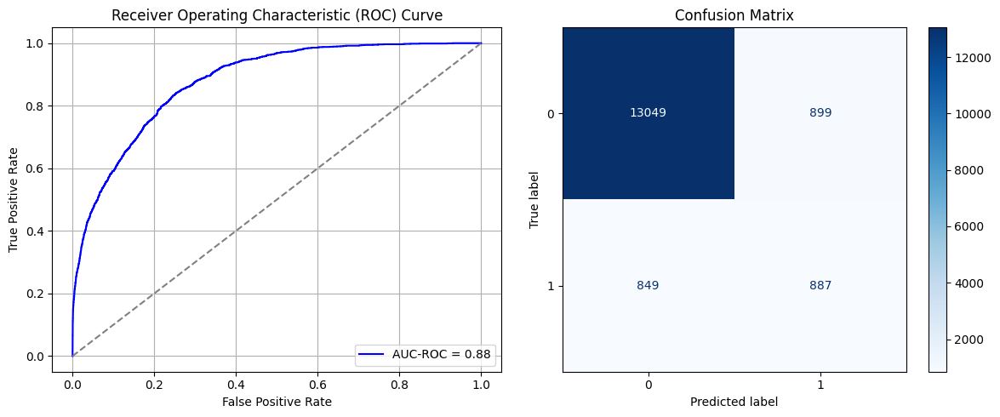

Best threshold based on F1-score: 0.49350517988204956
False Negative Rate: 0.4890552995391705
Time elapsed (performance): 1.9562724559998514
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.7505 - loss: 0.6075 - val_AUC: 0.8561 - val_loss: 0.4732
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8612 - loss: 0.4604 - val_AUC: 0.8766 - val_loss: 0.4462
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8704 - loss: 0.4447 - val_AUC: 0.8763 - val_loss: 0.4392
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8714 - loss: 0.4399 - val_AUC: 0.8800 - val_loss: 0.4320
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8773 - loss: 0.4322 - val_AUC: 0.8799 - val_loss: 0.4329
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8752 - loss: 0.4351 - val_AUC: 0.8792 - val_loss: 0.4361
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8789 - loss: 0.4288 - val_AUC: 0.8791 - val_loss: 0.4330
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8747 - loss: 0.4356 - val_AUC: 0.8801 - val_loss: 0.4322
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8801 -

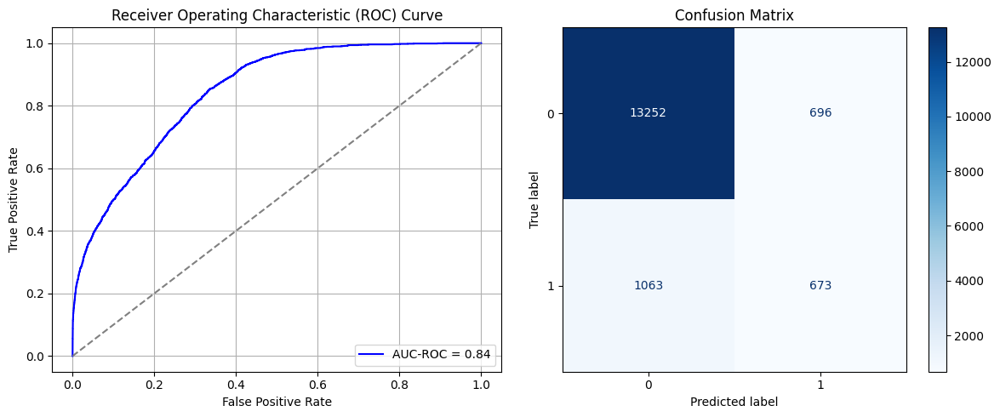

Best threshold based on F1-score: 0.4761680066585541
False Negative Rate: 0.6123271889400922
Time elapsed (performance): 1.443618946000015
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.7543 - loss: 0.6095 - val_AUC: 0.8569 - val_loss: 0.4785
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8628 - loss: 0.4590 - val_AUC: 0.8688 - val_loss: 0.4548
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8709 - loss: 0.4444 - val_AUC: 0.8709 - val_loss: 0.4522
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8682 - loss: 0.4454 - val_AUC: 0.8727 - val_loss: 0.4431
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8754 - loss: 0.4360 - val_AUC: 0.8737 - val_loss: 0.4419
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8773 - loss: 0.4332 - val_AUC: 0.8742 - val_loss: 0.4699
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8770 - loss: 0.4339 - val_AUC: 0.8743 - val_loss: 0.4456
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8807 - loss: 0.4274 - val_AUC: 0.8732 - val_loss: 0.4438
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8756 -

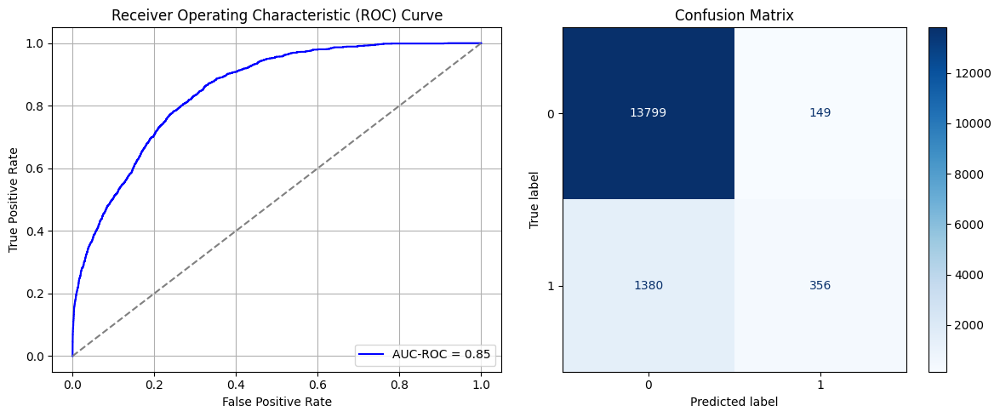

Best threshold based on F1-score: 0.16400833427906036
False Negative Rate: 0.7949308755760369
Time elapsed (performance): 1.7060977959999946
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7101 - loss: 0.6281 - val_AUC: 0.8462 - val_loss: 0.4897
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8431 - loss: 0.4881 - val_AUC: 0.8803 - val_loss: 0.4347
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8669 - loss: 0.4507 - val_AUC: 0.8819 - val_loss: 0.4552
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8693 - loss: 0.4481 - val_AUC: 0.8816 - val_loss: 0.4284
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8719 - loss: 0.4414 - val_AUC: 0.8837 - val_loss: 0.4257
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8694 - loss: 0.4429 - val_AUC: 0.8837 - val_loss: 0.4248
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8778 - loss: 0.4329 - val_AUC: 0.8835 - val_loss: 0.4278
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8750 - loss: 0.4372 - val_AUC: 0.8844 - val_loss: 0.4264
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8730 -

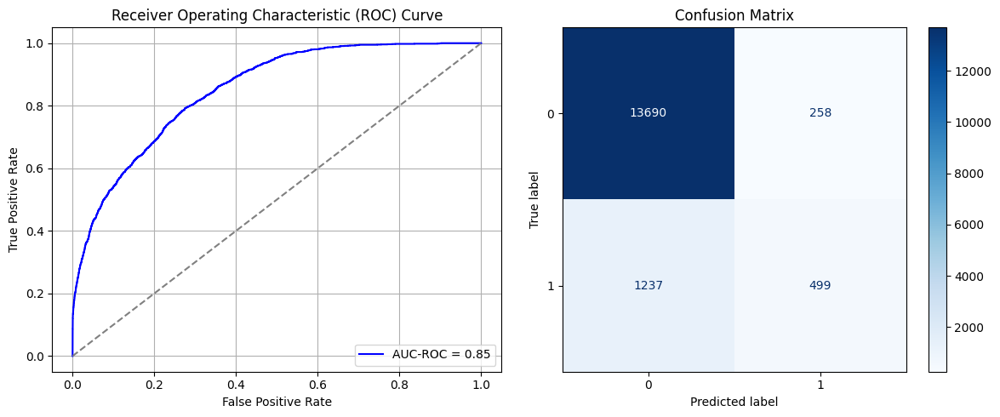

Best threshold based on F1-score: 0.25517538189888
False Negative Rate: 0.7125576036866359
Time elapsed (performance): 1.7512793230000625
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7464 - loss: 0.6130 - val_AUC: 0.8568 - val_loss: 0.4805
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8561 - loss: 0.4718 - val_AUC: 0.8730 - val_loss: 0.4427
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8682 - loss: 0.4483 - val_AUC: 0.8741 - val_loss: 0.4417
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8705 - loss: 0.4454 - val_AUC: 0.8757 - val_loss: 0.4379
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8723 - loss: 0.4417 - val_AUC: 0.8745 - val_loss: 0.4389
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8681 - loss: 0.4487 - val_AUC: 0.8760 - val_loss: 0.4494
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8729 - loss: 0.4395 - val_AUC: 0.8766 - val_loss: 0.4364
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8725 - loss: 0.4416 - val_AUC: 0.8751 - val_loss: 0.4383
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8758 -

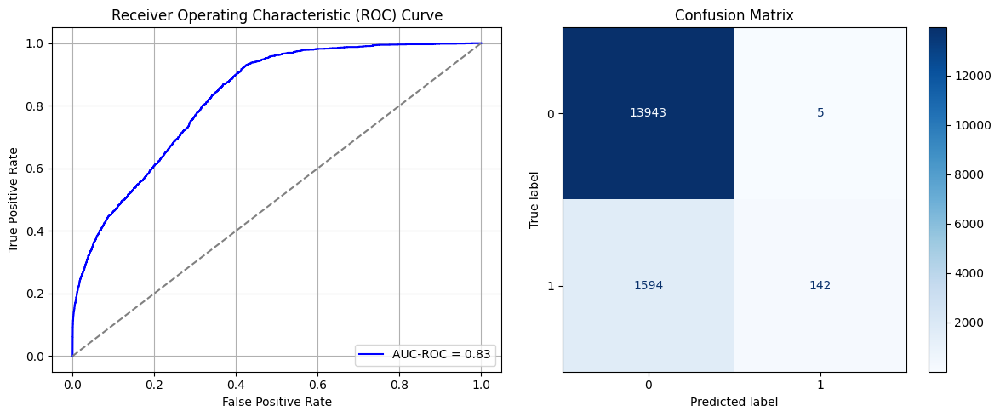

Best threshold based on F1-score: 0.02536298707127571
False Negative Rate: 0.9182027649769585
Time elapsed (performance): 1.39290417899997
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7404 - loss: 0.6129 - val_AUC: 0.8633 - val_loss: 0.4663
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8651 - loss: 0.4594 - val_AUC: 0.8764 - val_loss: 0.4373
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8711 - loss: 0.4442 - val_AUC: 0.8796 - val_loss: 0.4449
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8760 - loss: 0.4339 - val_AUC: 0.8810 - val_loss: 0.4316
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8787 - loss: 0.4310 - val_AUC: 0.8812 - val_loss: 0.4386
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8730 - loss: 0.4389 - val_AUC: 0.8815 - val_loss: 0.4304
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8782 - loss: 0.4314 - val_AUC: 0.8820 - val_loss: 0.4272
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8750 - loss: 0.4354 - val_AUC: 0.8822 - val_loss: 0.4324
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8742 -

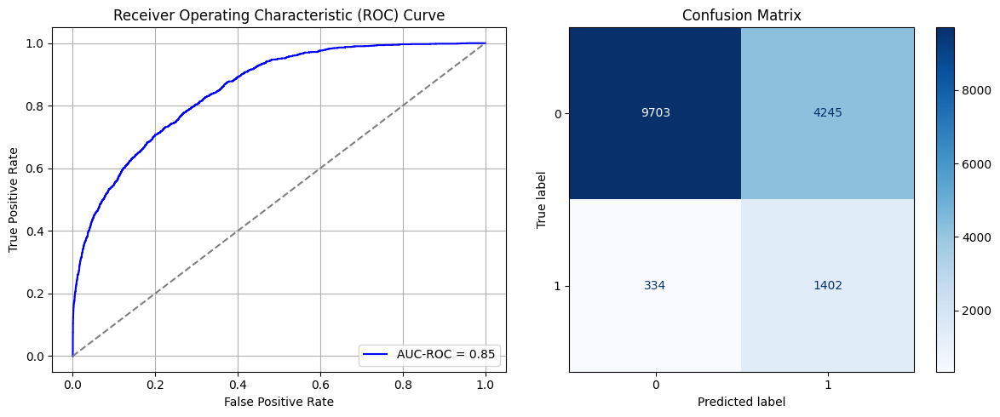

Best threshold based on F1-score: 0.8016840815544128
False Negative Rate: 0.1923963133640553
Time elapsed (performance): 1.3014545999999427
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7537 - loss: 0.6086 - val_AUC: 0.8551 - val_loss: 0.4745
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8629 - loss: 0.4600 - val_AUC: 0.8755 - val_loss: 0.4402
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8716 - loss: 0.4417 - val_AUC: 0.8771 - val_loss: 0.4461
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8719 - loss: 0.4403 - val_AUC: 0.8794 - val_loss: 0.4358
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8757 - loss: 0.4354 - val_AUC: 0.8823 - val_loss: 0.4330
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8751 - loss: 0.4354 - val_AUC: 0.8801 - val_loss: 0.4339
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8732 - loss: 0.4375 - val_AUC: 0.8816 - val_loss: 0.4653
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8794 - loss: 0.4288 - val_AUC: 0.8819 - val_loss: 0.4285
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8786 -

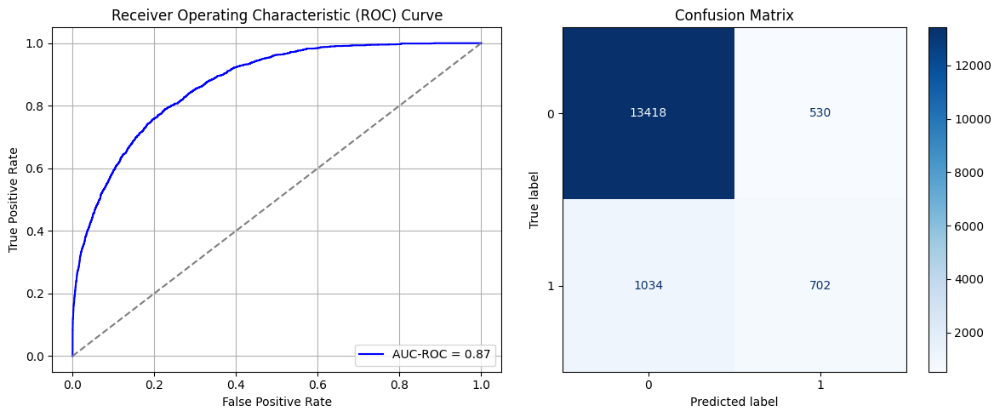

Best threshold based on F1-score: 0.36744943261146545
False Negative Rate: 0.5956221198156681
Time elapsed (performance): 1.3998854320000191
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7225 - loss: 0.6262 - val_AUC: 0.8476 - val_loss: 0.4896
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8506 - loss: 0.4789 - val_AUC: 0.8760 - val_loss: 0.4388
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8690 - loss: 0.4476 - val_AUC: 0.8789 - val_loss: 0.4318
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8721 - loss: 0.4425 - val_AUC: 0.8803 - val_loss: 0.4348
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8773 - loss: 0.4335 - val_AUC: 0.8801 - val_loss: 0.4355
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8714 - loss: 0.4422 - val_AUC: 0.8784 - val_loss: 0.4314
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8676 - loss: 0.4460 - val_AUC: 0.8805 - val_loss: 0.4365
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8745 - loss: 0.4370 - val_AUC: 0.8802 - val_loss: 0.4286
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8738 -

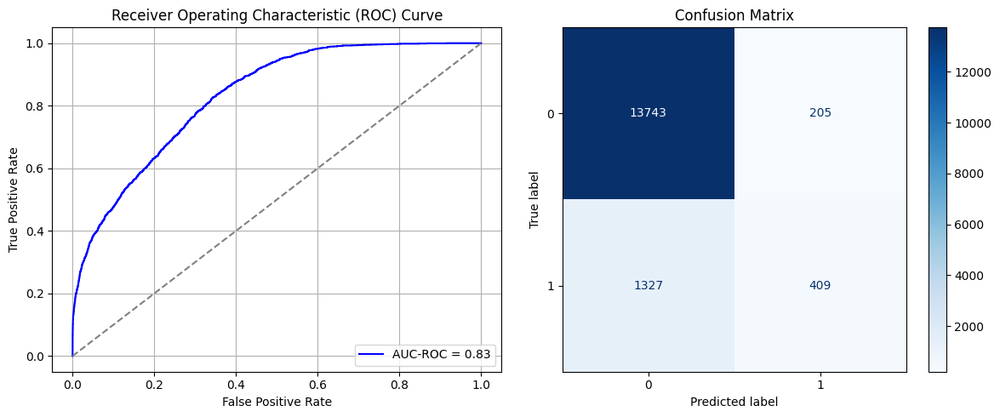

Best threshold based on F1-score: 0.28345662355422974
False Negative Rate: 0.7644009216589862
Time elapsed (performance): 1.7312764139999217
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7320 - loss: 0.6158 - val_AUC: 0.8600 - val_loss: 0.4993
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8561 - loss: 0.4697 - val_AUC: 0.8745 - val_loss: 0.4588
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8761 - loss: 0.4383 - val_AUC: 0.8764 - val_loss: 0.4373
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8738 - loss: 0.4387 - val_AUC: 0.8753 - val_loss: 0.4445
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8764 - loss: 0.4351 - val_AUC: 0.8775 - val_loss: 0.4421
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8749 - loss: 0.4352 - val_AUC: 0.8784 - val_loss: 0.4330
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8799 - loss: 0.4295 - val_AUC: 0.8792 - val_loss: 0.4327
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8800 - loss: 0.4285 - val_AUC: 0.8793 - val_loss: 0.4335
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8791 -

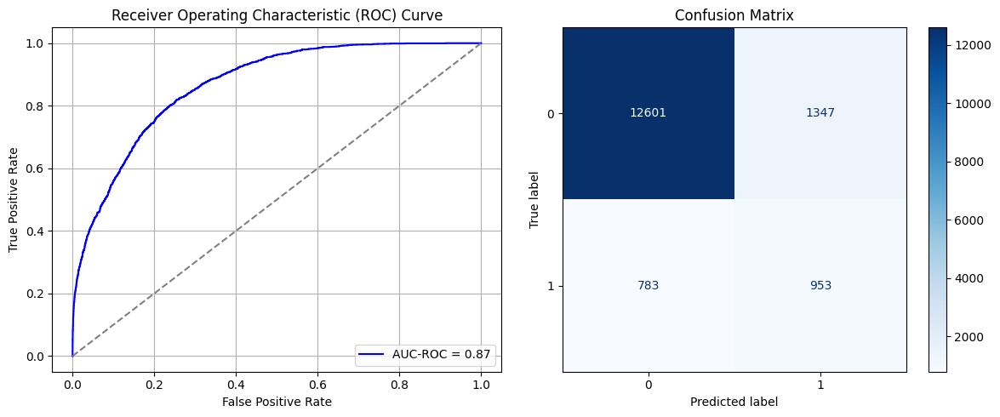

Best threshold based on F1-score: 0.5026077032089233
False Negative Rate: 0.451036866359447
Time elapsed (performance): 1.3585459230000652
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.7118 - loss: 0.6173 - val_AUC: 0.8554 - val_loss: 0.4823
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8517 - loss: 0.4746 - val_AUC: 0.8727 - val_loss: 0.4452
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8672 - loss: 0.4499 - val_AUC: 0.8765 - val_loss: 0.4389
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8617 - loss: 0.4550 - val_AUC: 0.8770 - val_loss: 0.4367
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8683 - loss: 0.4456 - val_AUC: 0.8764 - val_loss: 0.4393
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8673 - loss: 0.4455 - val_AUC: 0.8787 - val_loss: 0.4462
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8764 - loss: 0.4332 - val_AUC: 0.8780 - val_loss: 0.4373
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8707 - loss: 0.4416 - val_AUC: 0.8781 - val_loss: 0.4369
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8740 -

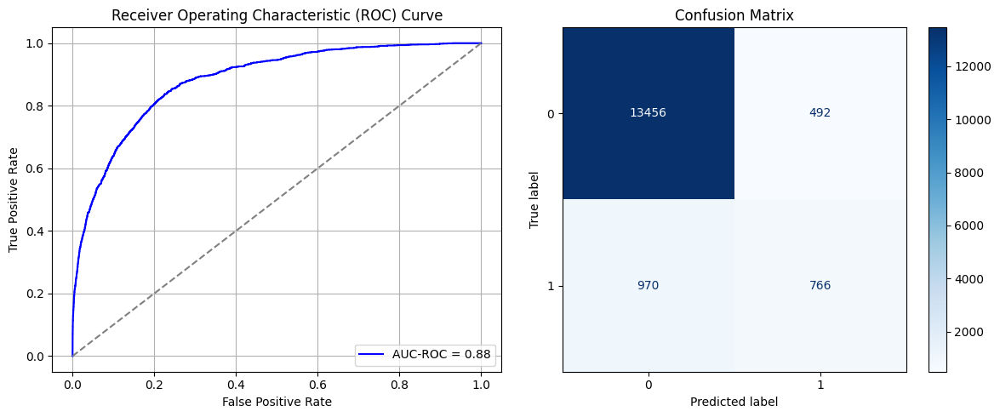

Best threshold based on F1-score: 0.4201866388320923
False Negative Rate: 0.5587557603686636
Time elapsed (performance): 1.725313776999883
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7422 - loss: 0.6063 - val_AUC: 0.8598 - val_loss: 0.4725
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8566 - loss: 0.4686 - val_AUC: 0.8748 - val_loss: 0.4437
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8767 - loss: 0.4347 - val_AUC: 0.8749 - val_loss: 0.4482
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8729 - loss: 0.4390 - val_AUC: 0.8786 - val_loss: 0.4332
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8746 - loss: 0.4378 - val_AUC: 0.8784 - val_loss: 0.4375
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8791 - loss: 0.4293 - val_AUC: 0.8790 - val_loss: 0.4380
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8802 - loss: 0.4280 - val_AUC: 0.8786 - val_loss: 0.4345
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8776 - loss: 0.4335 - val_AUC: 0.8792 - val_loss: 0.4344
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8808 -

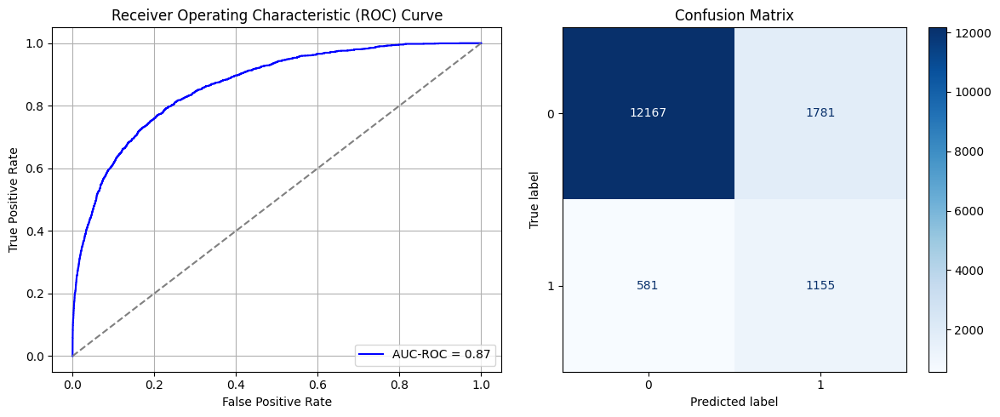

Best threshold based on F1-score: 0.604083240032196
False Negative Rate: 0.3346774193548387
Time elapsed (performance): 1.7299260949998825
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7303 - loss: 0.6151 - val_AUC: 0.8601 - val_loss: 0.4792
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8585 - loss: 0.4678 - val_AUC: 0.8766 - val_loss: 0.4396
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8701 - loss: 0.4445 - val_AUC: 0.8790 - val_loss: 0.4575
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8681 - loss: 0.4472 - val_AUC: 0.8800 - val_loss: 0.4434
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8727 - loss: 0.4409 - val_AUC: 0.8790 - val_loss: 0.4330
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8731 - loss: 0.4398 - val_AUC: 0.8789 - val_loss: 0.4385
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8748 - loss: 0.4393 - val_AUC: 0.8812 - val_loss: 0.4330
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8742 - loss: 0.4382 - val_AUC: 0.8814 - val_loss: 0.4304
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8770 -

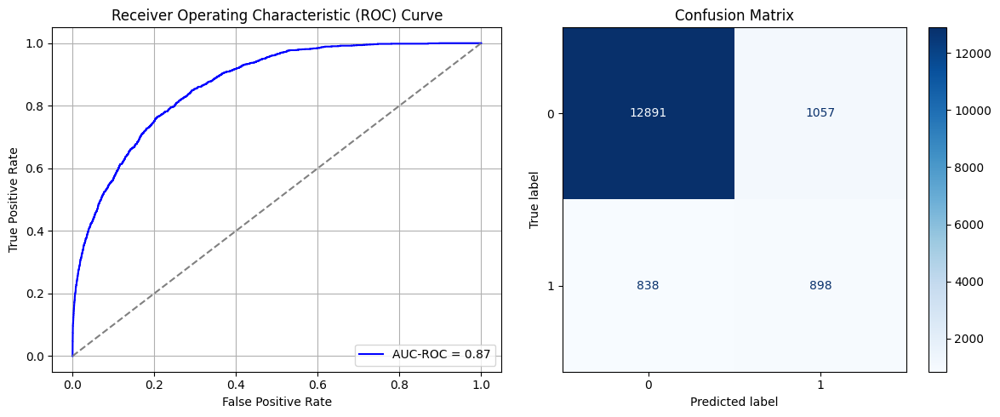

Best threshold based on F1-score: 0.4939553141593933
False Negative Rate: 0.4827188940092166
Time elapsed (performance): 1.35262196199983
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7346 - loss: 0.6190 - val_AUC: 0.8552 - val_loss: 0.4904
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8607 - loss: 0.4656 - val_AUC: 0.8740 - val_loss: 0.4493
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8668 - loss: 0.4512 - val_AUC: 0.8752 - val_loss: 0.4475
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8709 - loss: 0.4425 - val_AUC: 0.8760 - val_loss: 0.4365
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8761 - loss: 0.4347 - val_AUC: 0.8771 - val_loss: 0.4336
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8764 - loss: 0.4347 - val_AUC: 0.8766 - val_loss: 0.4358
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8764 - loss: 0.4345 - val_AUC: 0.8775 - val_loss: 0.4334
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8794 - loss: 0.4310 - val_AUC: 0.8771 - val_loss: 0.4412
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8807 -

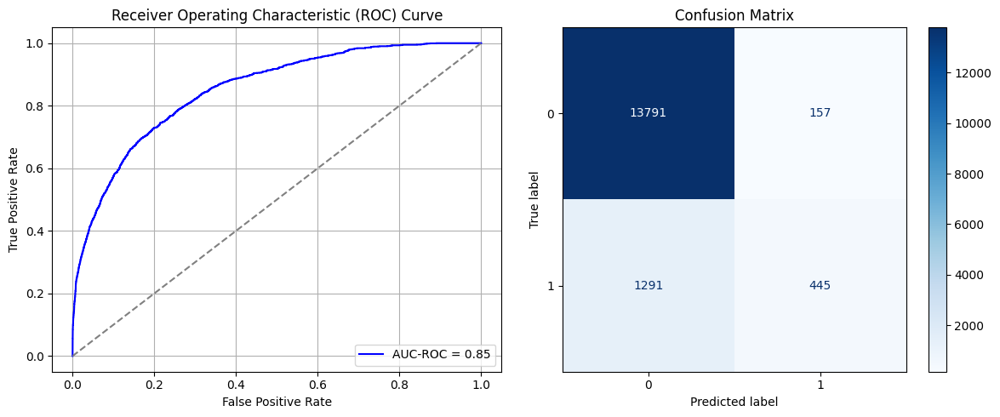

Best threshold based on F1-score: 0.23527570068836212
False Negative Rate: 0.743663594470046
Time elapsed (performance): 1.3616533809999964
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7159 - loss: 0.6225 - val_AUC: 0.8544 - val_loss: 0.4773
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8656 - loss: 0.4553 - val_AUC: 0.8689 - val_loss: 0.4481
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8731 - loss: 0.4409 - val_AUC: 0.8701 - val_loss: 0.4652
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8725 - loss: 0.4414 - val_AUC: 0.8714 - val_loss: 0.4495
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8706 - loss: 0.4427 - val_AUC: 0.8705 - val_loss: 0.4454
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8775 - loss: 0.4313 - val_AUC: 0.8706 - val_loss: 0.4496
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8754 - loss: 0.4345 - val_AUC: 0.8718 - val_loss: 0.4460
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8738 - loss: 0.4373 - val_AUC: 0.8733 - val_loss: 0.4411
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8823 -

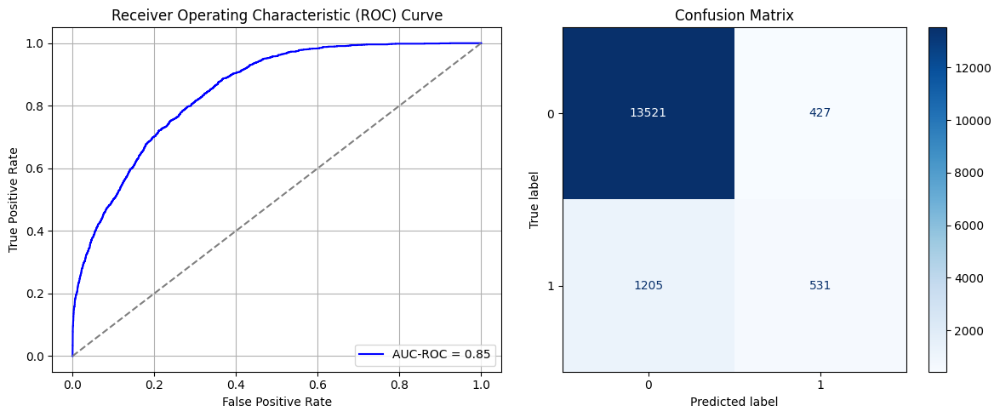

Best threshold based on F1-score: 0.3057078719139099
False Negative Rate: 0.6941244239631337
Time elapsed (performance): 1.6944753899999796
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7175 - loss: 0.6223 - val_AUC: 0.8591 - val_loss: 0.4925
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8596 - loss: 0.4651 - val_AUC: 0.8764 - val_loss: 0.4388
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8752 - loss: 0.4383 - val_AUC: 0.8782 - val_loss: 0.4332
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8769 - loss: 0.4357 - val_AUC: 0.8811 - val_loss: 0.4312
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8761 - loss: 0.4359 - val_AUC: 0.8806 - val_loss: 0.4388
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8762 - loss: 0.4367 - val_AUC: 0.8818 - val_loss: 0.4277
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8810 - loss: 0.4269 - val_AUC: 0.8814 - val_loss: 0.4267
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8785 - loss: 0.4320 - val_AUC: 0.8817 - val_loss: 0.4263
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8792 -

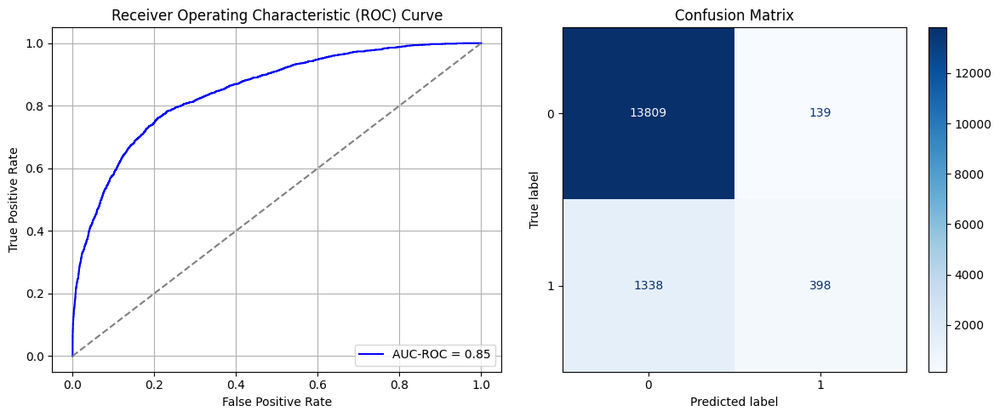

Best threshold based on F1-score: 0.1740664392709732
False Negative Rate: 0.7707373271889401
Time elapsed (performance): 1.380291034000038
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7114 - loss: 0.6220 - val_AUC: 0.8619 - val_loss: 0.4674
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8613 - loss: 0.4647 - val_AUC: 0.8769 - val_loss: 0.4448
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8681 - loss: 0.4463 - val_AUC: 0.8804 - val_loss: 0.4332
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8754 - loss: 0.4361 - val_AUC: 0.8813 - val_loss: 0.4287
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8742 - loss: 0.4372 - val_AUC: 0.8815 - val_loss: 0.4283
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8726 - loss: 0.4392 - val_AUC: 0.8820 - val_loss: 0.4274
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8766 - loss: 0.4337 - val_AUC: 0.8819 - val_loss: 0.4305
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8720 - loss: 0.4403 - val_AUC: 0.8821 - val_loss: 0.4288
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8781 -

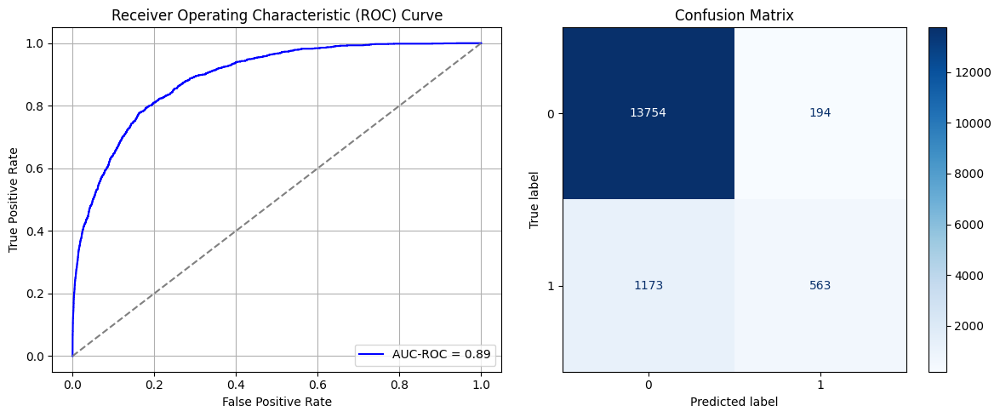

Best threshold based on F1-score: 0.21679805219173431
False Negative Rate: 0.6756912442396313
Time elapsed (performance): 1.340889156000003
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7203 - loss: 0.6211 - val_AUC: 0.8454 - val_loss: 0.4880
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8479 - loss: 0.4799 - val_AUC: 0.8740 - val_loss: 0.4460
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8696 - loss: 0.4450 - val_AUC: 0.8761 - val_loss: 0.4379
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8720 - loss: 0.4411 - val_AUC: 0.8770 - val_loss: 0.4353
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8741 - loss: 0.4372 - val_AUC: 0.8771 - val_loss: 0.4334
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8723 - loss: 0.4405 - val_AUC: 0.8776 - val_loss: 0.4345
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8741 - loss: 0.4373 - val_AUC: 0.8782 - val_loss: 0.4316
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8727 - loss: 0.4391 - val_AUC: 0.8792 - val_loss: 0.4307
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8763 -

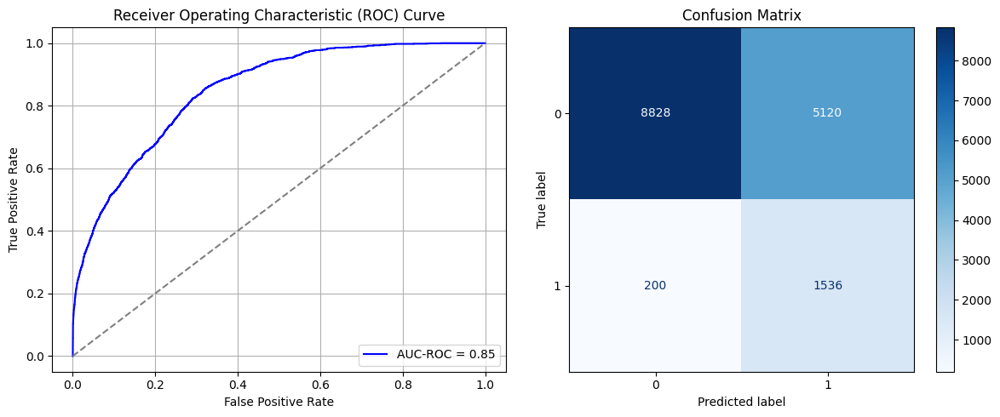

Best threshold based on F1-score: 0.8132420778274536
False Negative Rate: 0.1152073732718894
Time elapsed (performance): 1.4638859439999123
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7495 - loss: 0.5961 - val_AUC: 0.8631 - val_loss: 0.4858
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8634 - loss: 0.4615 - val_AUC: 0.8682 - val_loss: 0.4608
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8772 - loss: 0.4361 - val_AUC: 0.8748 - val_loss: 0.4391
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8685 - loss: 0.4462 - val_AUC: 0.8764 - val_loss: 0.4398
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8682 - loss: 0.4461 - val_AUC: 0.8777 - val_loss: 0.4384
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8733 - loss: 0.4394 - val_AUC: 0.8767 - val_loss: 0.4347
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8696 - loss: 0.4444 - val_AUC: 0.8781 - val_loss: 0.4378
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8799 - loss: 0.4313 - val_AUC: 0.8792 - val_loss: 0.4397
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8732 -

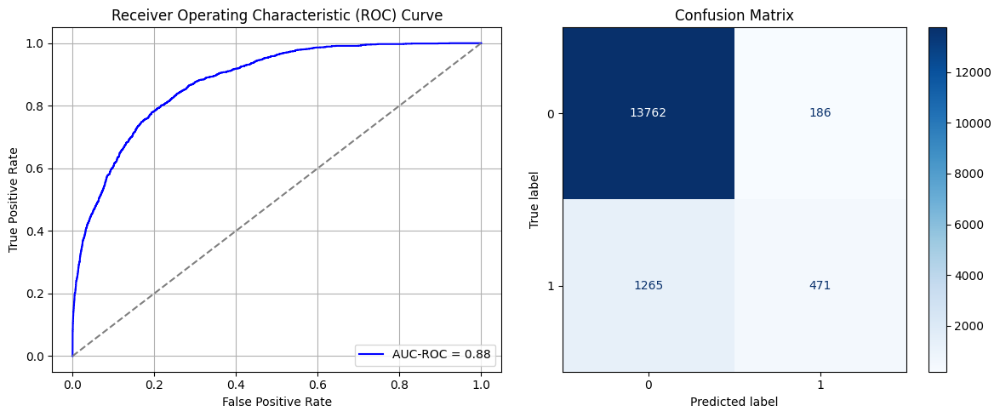

Best threshold based on F1-score: 0.2114158272743225
False Negative Rate: 0.7286866359447005
Time elapsed (performance): 2.631024328999956
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.7389 - loss: 0.6118 - val_AUC: 0.8606 - val_loss: 0.4844
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8594 - loss: 0.4647 - val_AUC: 0.8752 - val_loss: 0.4592
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8676 - loss: 0.4488 - val_AUC: 0.8769 - val_loss: 0.4398
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8692 - loss: 0.4460 - val_AUC: 0.8788 - val_loss: 0.4351
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8683 - loss: 0.4455 - val_AUC: 0.8783 - val_loss: 0.4354
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8723 - loss: 0.4402 - val_AUC: 0.8800 - val_loss: 0.4294
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8729 - loss: 0.4379 - val_AUC: 0.8796 - val_loss: 0.4305
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8717 - loss: 0.4395 - val_AUC: 0.8808 - val_loss: 0.4315
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8762 -

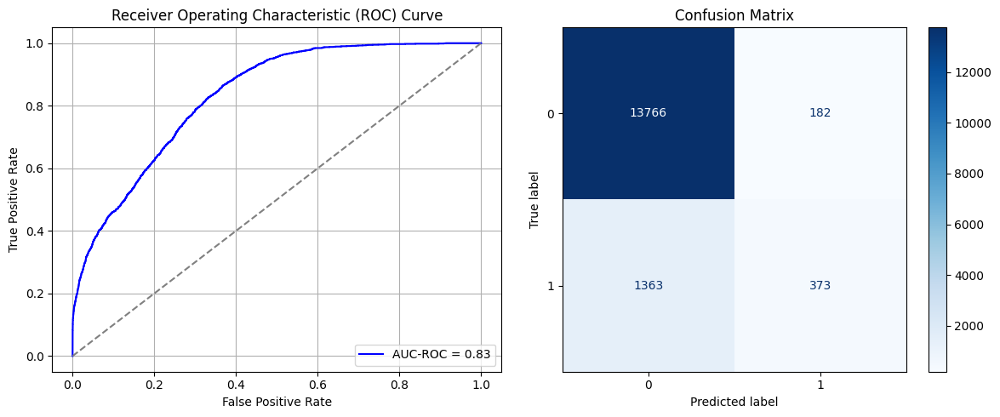

Best threshold based on F1-score: 0.2576006352901459
False Negative Rate: 0.7851382488479263
Time elapsed (performance): 1.7191940430000159
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7261 - loss: 0.6160 - val_AUC: 0.8604 - val_loss: 0.4685
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8597 - loss: 0.4645 - val_AUC: 0.8731 - val_loss: 0.4417
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8679 - loss: 0.4492 - val_AUC: 0.8753 - val_loss: 0.4381
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8788 - loss: 0.4318 - val_AUC: 0.8774 - val_loss: 0.4340
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8734 - loss: 0.4384 - val_AUC: 0.8792 - val_loss: 0.4395
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8762 - loss: 0.4347 - val_AUC: 0.8789 - val_loss: 0.4330
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8751 - loss: 0.4355 - val_AUC: 0.8801 - val_loss: 0.4299
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8726 - loss: 0.4394 - val_AUC: 0.8802 - val_loss: 0.4302
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8754 -

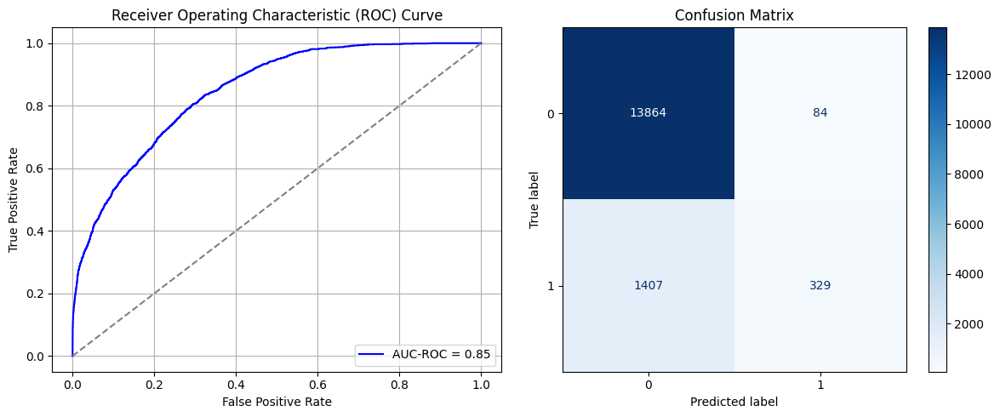

Best threshold based on F1-score: 0.11897142231464386
False Negative Rate: 0.8104838709677419
Time elapsed (performance): 1.3667880570001216
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - AUC: 0.7054 - loss: 0.6226 - val_AUC: 0.8578 - val_loss: 0.4879
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8631 - loss: 0.4621 - val_AUC: 0.8690 - val_loss: 0.4594
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8739 - loss: 0.4420 - val_AUC: 0.8730 - val_loss: 0.4429
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8787 - loss: 0.4311 - val_AUC: 0.8729 - val_loss: 0.4476
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8760 - loss: 0.4351 - val_AUC: 0.8743 - val_loss: 0.4404
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8778 - loss: 0.4336 - val_AUC: 0.8740 - val_loss: 0.4489
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8795 - loss: 0.4309 - val_AUC: 0.8748 - val_loss: 0.4413
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8781 - loss: 0.4324 - val_AUC: 0.8733 - val_loss: 0.4497
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8766 -

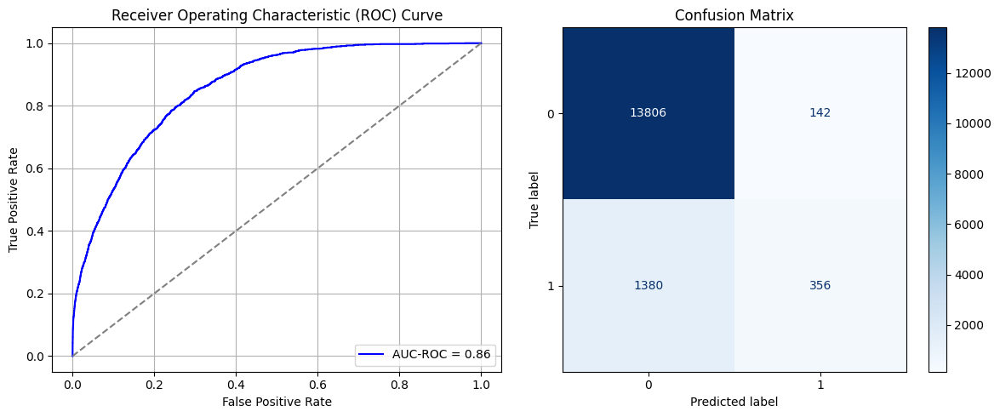

Best threshold based on F1-score: 0.1649312824010849
False Negative Rate: 0.7949308755760369
Time elapsed (performance): 1.7286005180001212
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - AUC: 0.7424 - loss: 0.6105 - val_AUC: 0.8617 - val_loss: 0.4686
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8608 - loss: 0.4640 - val_AUC: 0.8774 - val_loss: 0.4383
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8749 - loss: 0.4374 - val_AUC: 0.8784 - val_loss: 0.4380
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8734 - loss: 0.4379 - val_AUC: 0.8803 - val_loss: 0.4304
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8691 - loss: 0.4455 - val_AUC: 0.8808 - val_loss: 0.4319
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8744 - loss: 0.4358 - val_AUC: 0.8817 - val_loss: 0.4464
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8786 - loss: 0.4320 - val_AUC: 0.8824 - val_loss: 0.4295
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8773 - loss: 0.4335 - val_AUC: 0.8828 - val_loss: 0.4335
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8777 -

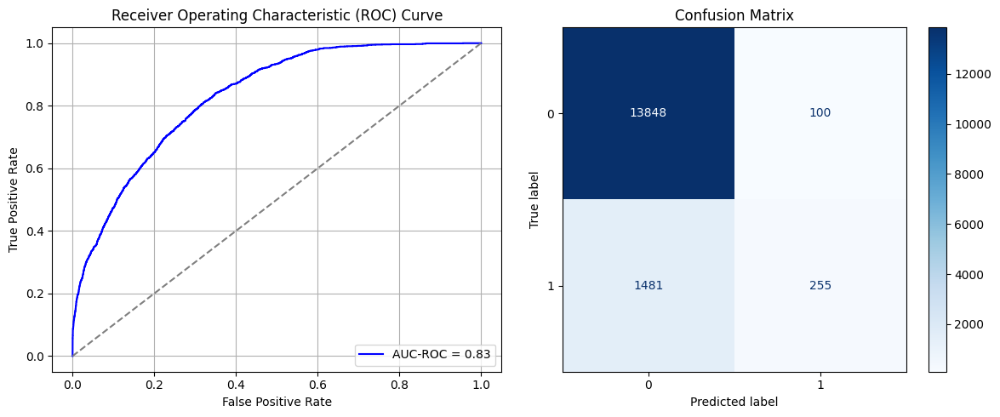

Best threshold based on F1-score: 0.11017691344022751
False Negative Rate: 0.853110599078341
Time elapsed (performance): 1.4071668059998501
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7430 - loss: 0.6135 - val_AUC: 0.8510 - val_loss: 0.4961
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8570 - loss: 0.4693 - val_AUC: 0.8669 - val_loss: 0.4756
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8723 - loss: 0.4422 - val_AUC: 0.8693 - val_loss: 0.4494
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8804 - loss: 0.4277 - val_AUC: 0.8699 - val_loss: 0.4474
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8723 - loss: 0.4402 - val_AUC: 0.8717 - val_loss: 0.4439
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8756 - loss: 0.4356 - val_AUC: 0.8720 - val_loss: 0.4466
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8753 - loss: 0.4352 - val_AUC: 0.8706 - val_loss: 0.4586
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8769 - loss: 0.4324 - val_AUC: 0.8724 - val_loss: 0.4459
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8791 -

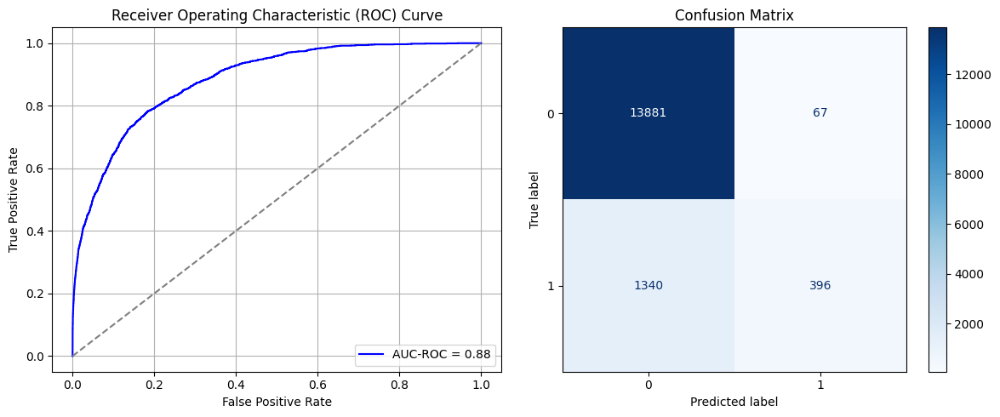

Best threshold based on F1-score: 0.1479320228099823
False Negative Rate: 0.771889400921659
Time elapsed (performance): 1.42568272099993
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7166 - loss: 0.6159 - val_AUC: 0.8490 - val_loss: 0.4882
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8561 - loss: 0.4741 - val_AUC: 0.8740 - val_loss: 0.4424
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8705 - loss: 0.4438 - val_AUC: 0.8762 - val_loss: 0.4529
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8683 - loss: 0.4469 - val_AUC: 0.8768 - val_loss: 0.4358
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8798 - loss: 0.4287 - val_AUC: 0.8776 - val_loss: 0.4387
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8751 - loss: 0.4347 - val_AUC: 0.8788 - val_loss: 0.4326
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8752 - loss: 0.4355 - val_AUC: 0.8790 - val_loss: 0.4322
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8800 - loss: 0.4279 - val_AUC: 0.8798 - val_loss: 0.4455
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8752 -

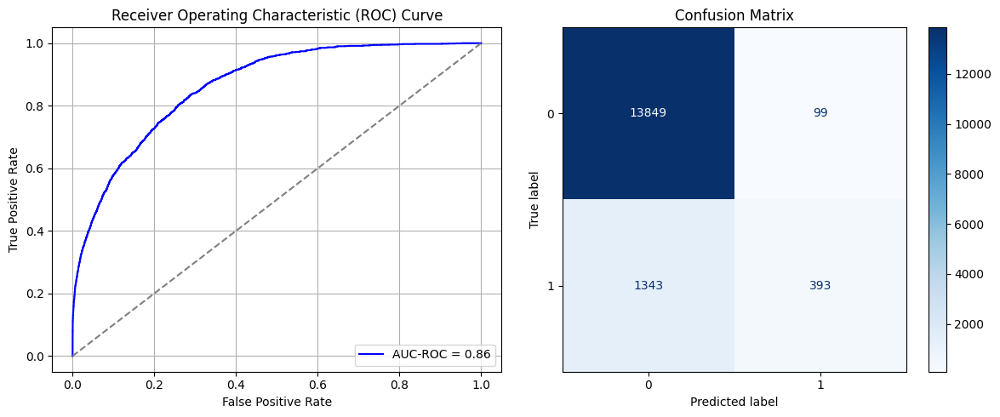

Best threshold based on F1-score: 0.16915570199489594
False Negative Rate: 0.7736175115207373
Time elapsed (performance): 1.4721743370000695
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7346 - loss: 0.6151 - val_AUC: 0.8567 - val_loss: 0.4825
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8595 - loss: 0.4682 - val_AUC: 0.8739 - val_loss: 0.4437
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8664 - loss: 0.4506 - val_AUC: 0.8765 - val_loss: 0.4359
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8702 - loss: 0.4450 - val_AUC: 0.8780 - val_loss: 0.4410
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8754 - loss: 0.4367 - val_AUC: 0.8768 - val_loss: 0.4433
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8722 - loss: 0.4418 - val_AUC: 0.8780 - val_loss: 0.4337
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8685 - loss: 0.4479 - val_AUC: 0.8786 - val_loss: 0.4313
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8700 - loss: 0.4441 - val_AUC: 0.8787 - val_loss: 0.4351
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8802 -

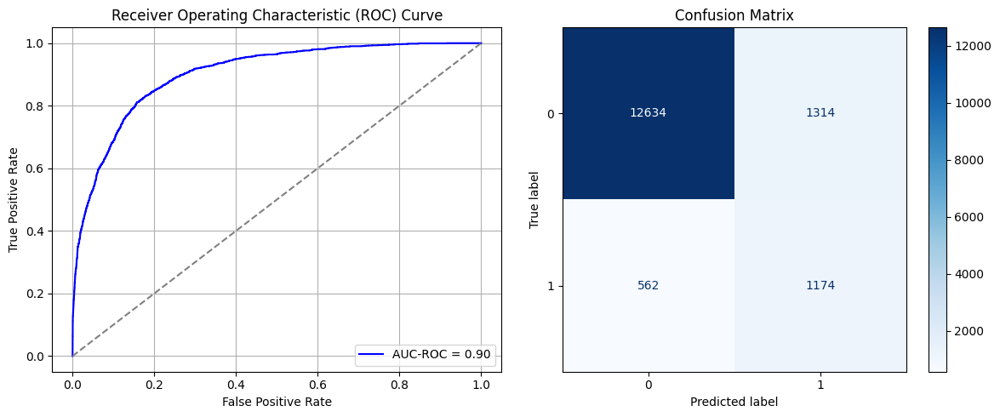

Best threshold based on F1-score: 0.575068473815918
False Negative Rate: 0.32373271889400923
Time elapsed (performance): 1.884910588999901
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7410 - loss: 0.6106 - val_AUC: 0.8570 - val_loss: 0.4724
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8615 - loss: 0.4615 - val_AUC: 0.8663 - val_loss: 0.4506
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8726 - loss: 0.4406 - val_AUC: 0.8697 - val_loss: 0.4494
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8755 - loss: 0.4340 - val_AUC: 0.8719 - val_loss: 0.4416
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8710 - loss: 0.4410 - val_AUC: 0.8733 - val_loss: 0.4461
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8758 - loss: 0.4353 - val_AUC: 0.8741 - val_loss: 0.4385
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8772 - loss: 0.4340 - val_AUC: 0.8746 - val_loss: 0.4378
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8804 - loss: 0.4282 - val_AUC: 0.8724 - val_loss: 0.4408
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8804 -

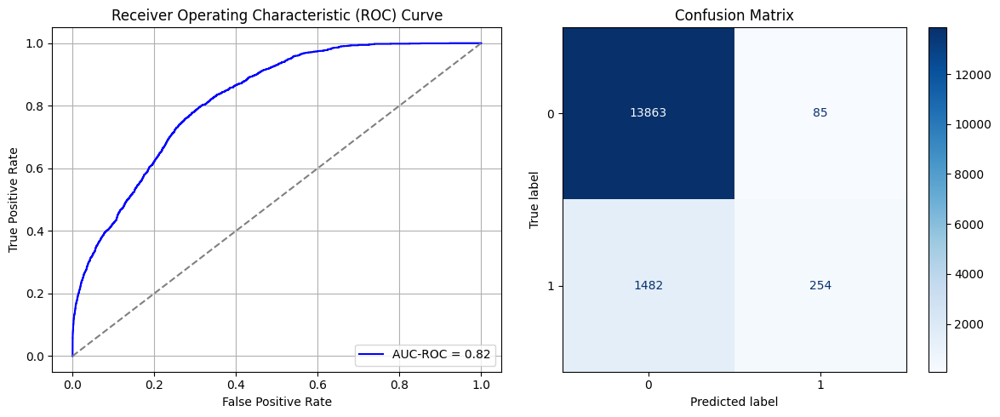

Best threshold based on F1-score: 0.09792260080575943
False Negative Rate: 0.8536866359447005
Time elapsed (performance): 2.0260978940000314
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.7450 - loss: 0.6142 - val_AUC: 0.8593 - val_loss: 0.4861
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8606 - loss: 0.4631 - val_AUC: 0.8702 - val_loss: 0.4472
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8660 - loss: 0.4522 - val_AUC: 0.8739 - val_loss: 0.4408
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8706 - loss: 0.4443 - val_AUC: 0.8741 - val_loss: 0.4473
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8735 - loss: 0.4390 - val_AUC: 0.8748 - val_loss: 0.4492
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8727 - loss: 0.4406 - val_AUC: 0.8756 - val_loss: 0.4385
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8755 - loss: 0.4356 - val_AUC: 0.8755 - val_loss: 0.4371
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8767 - loss: 0.4329 - val_AUC: 0.8757 - val_loss: 0.4475
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8771 -

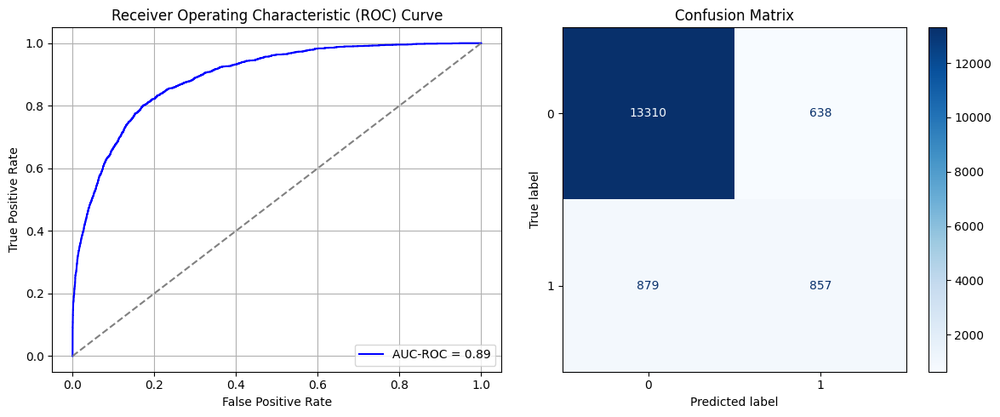

Best threshold based on F1-score: 0.4141799807548523
False Negative Rate: 0.506336405529954
Time elapsed (performance): 1.4247594369999206
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.7348 - loss: 0.6177 - val_AUC: 0.8571 - val_loss: 0.4817
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8485 - loss: 0.4801 - val_AUC: 0.8843 - val_loss: 0.4283
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8649 - loss: 0.4512 - val_AUC: 0.8843 - val_loss: 0.4287
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8694 - loss: 0.4435 - val_AUC: 0.8873 - val_loss: 0.4229
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - AUC: 0.8664 - loss: 0.4474 - val_AUC: 0.8874 - val_loss: 0.4200
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8689 - loss: 0.4450 - val_AUC: 0.8888 - val_loss: 0.4260
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8828 - loss: 0.4240 - val_AUC: 0.8895 - val_loss: 0.4192
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8777 - loss: 0.4319 - val_AUC: 0.8893 - val_loss: 0.4184
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8706 -

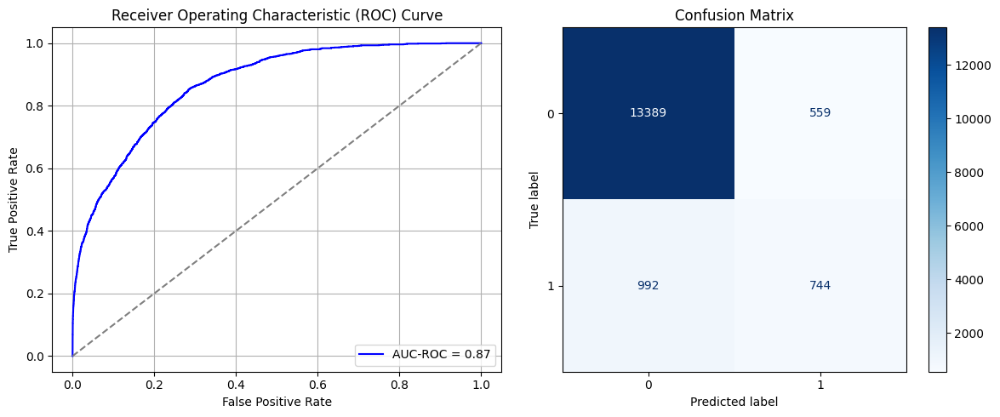

Best threshold based on F1-score: 0.43925386667251587
False Negative Rate: 0.5714285714285714
Time elapsed (performance): 1.4709387389998483
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 5s 10ms/step - AUC: 0.7357 - loss: 0.6148 - val_AUC: 0.8536 - val_loss: 0.4992
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8512 - loss: 0.4774 - val_AUC: 0.8720 - val_loss: 0.4429
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8709 - loss: 0.4431 - val_AUC: 0.8749 - val_loss: 0.4413
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8782 - loss: 0.4319 - val_AUC: 0.8748 - val_loss: 0.4378
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8784 - loss: 0.4306 - val_AUC: 0.8772 - val_loss: 0.4335
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8757 - loss: 0.4355 - val_AUC: 0.8771 - val_loss: 0.4376
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8810 - loss: 0.4279 - val_AUC: 0.8779 - val_loss: 0.4321
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8788 - loss: 0.4315 - val_AUC: 0.8779 - val_loss: 0.4320
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8776 

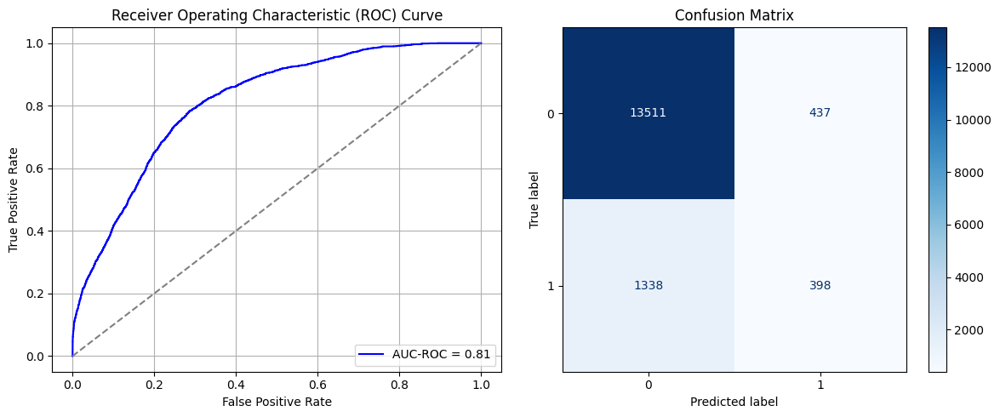

Best threshold based on F1-score: 0.1073462963104248
False Negative Rate: 0.7707373271889401
Time elapsed (performance): 1.5591896619998806
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - AUC: 0.7326 - loss: 0.6182 - val_AUC: 0.8644 - val_loss: 0.4645
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8608 - loss: 0.4644 - val_AUC: 0.8750 - val_loss: 0.4396
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8750 - loss: 0.4371 - val_AUC: 0.8766 - val_loss: 0.4367
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - AUC: 0.8751 - loss: 0.4367 - val_AUC: 0.8753 - val_loss: 0.4388
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8721 - loss: 0.4424 - val_AUC: 0.8780 - val_loss: 0.4349
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8776 - loss: 0.4334 - val_AUC: 0.8786 - val_loss: 0.4331
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8737 - loss: 0.4403 - val_AUC: 0.8778 - val_loss: 0.4371
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8776 - loss: 0.4343 - val_AUC: 0.8782 - val_loss: 0.4347
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8788 -

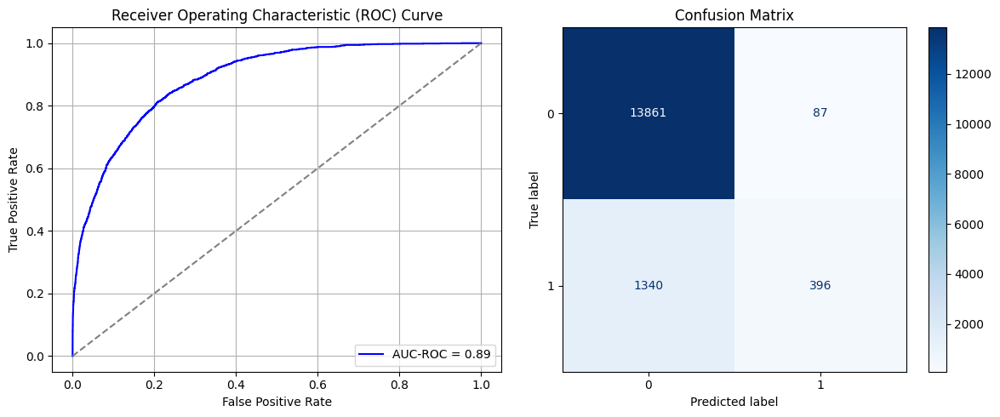

Best threshold based on F1-score: 0.17131464183330536
False Negative Rate: 0.771889400921659
Time elapsed (performance): 1.6019881939996594
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.7546 - loss: 0.6067 - val_AUC: 0.8479 - val_loss: 0.4824
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8538 - loss: 0.4694 - val_AUC: 0.8724 - val_loss: 0.4430
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8729 - loss: 0.4405 - val_AUC: 0.8768 - val_loss: 0.4373
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8728 - loss: 0.4397 - val_AUC: 0.8790 - val_loss: 0.4373
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8678 - loss: 0.4469 - val_AUC: 0.8794 - val_loss: 0.4353
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8726 - loss: 0.4397 - val_AUC: 0.8794 - val_loss: 0.4323
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8729 - loss: 0.4385 - val_AUC: 0.8802 - val_loss: 0.4298
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8777 - loss: 0.4309 - val_AUC: 0.8807 - val_loss: 0.4327
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8782 -

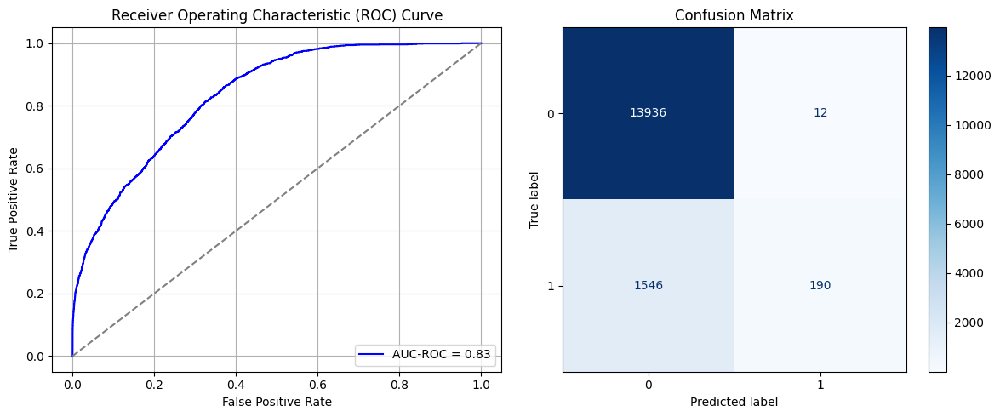

Best threshold based on F1-score: 0.03804956376552582
False Negative Rate: 0.8905529953917051
Time elapsed (performance): 1.7825618659999236
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.7177 - loss: 0.6227 - val_AUC: 0.8517 - val_loss: 0.4997
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8542 - loss: 0.4735 - val_AUC: 0.8666 - val_loss: 0.4588
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8720 - loss: 0.4414 - val_AUC: 0.8690 - val_loss: 0.4667
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8728 - loss: 0.4406 - val_AUC: 0.8707 - val_loss: 0.4480
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8704 - loss: 0.4420 - val_AUC: 0.8714 - val_loss: 0.4443
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8818 - loss: 0.4261 - val_AUC: 0.8709 - val_loss: 0.4443
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8790 - loss: 0.4278 - val_AUC: 0.8716 - val_loss: 0.4534
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8785 - loss: 0.4313 - val_AUC: 0.8727 - val_loss: 0.4501
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8742 -

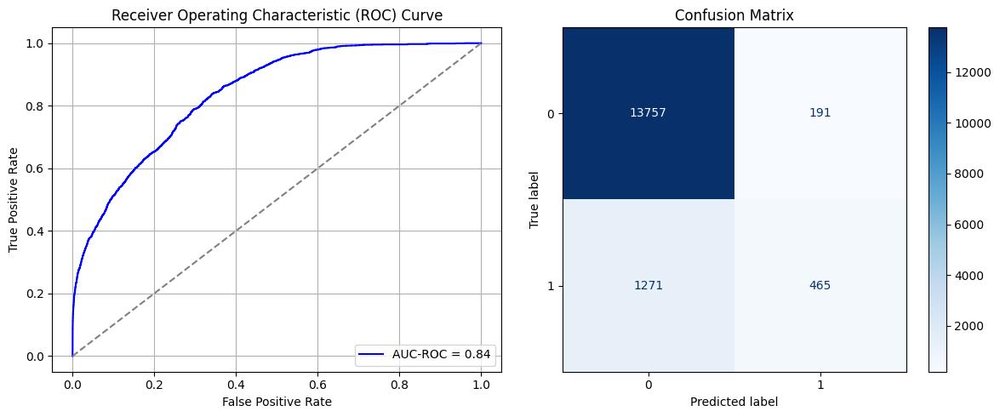

Best threshold based on F1-score: 0.2844703793525696
False Negative Rate: 0.7321428571428571
Time elapsed (performance): 1.7303160179999395
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - AUC: 0.7432 - loss: 0.6103 - val_AUC: 0.8504 - val_loss: 0.5040
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - AUC: 0.8520 - loss: 0.4744 - val_AUC: 0.8708 - val_loss: 0.4473
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8729 - loss: 0.4413 - val_AUC: 0.8739 - val_loss: 0.4428
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8713 - loss: 0.4425 - val_AUC: 0.8754 - val_loss: 0.4401
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8796 - loss: 0.4310 - val_AUC: 0.8750 - val_loss: 0.4444
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8782 - loss: 0.4301 - val_AUC: 0.8769 - val_loss: 0.4347
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - AUC: 0.8747 - loss: 0.4348 - val_AUC: 0.8777 - val_loss: 0.4334
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8776 - loss: 0.4319 - val_AUC: 0.8779 - val_loss: 0.4420
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8772 -

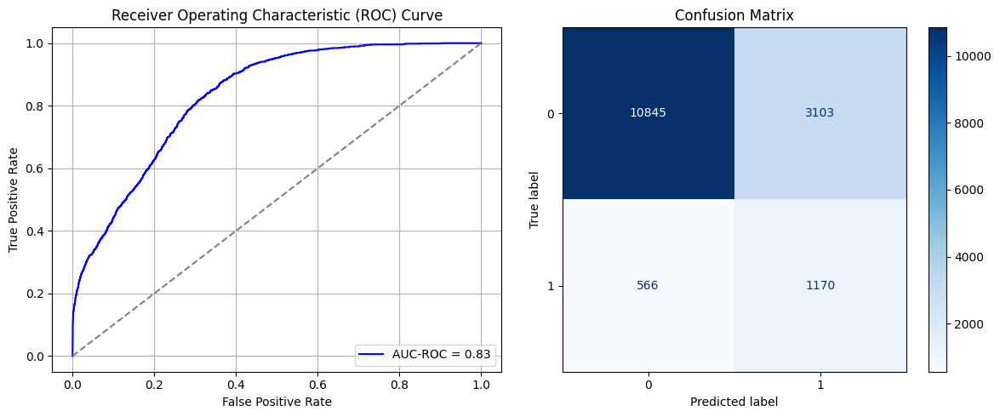

Best threshold based on F1-score: 0.7199140191078186
False Negative Rate: 0.326036866359447
Time elapsed (performance): 2.047810985000069
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - AUC: 0.7151 - loss: 0.6127 - val_AUC: 0.8582 - val_loss: 0.4698
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8646 - loss: 0.4576 - val_AUC: 0.8687 - val_loss: 0.4691
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8712 - loss: 0.4432 - val_AUC: 0.8735 - val_loss: 0.4484
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8728 - loss: 0.4402 - val_AUC: 0.8739 - val_loss: 0.4402
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8786 - loss: 0.4314 - val_AUC: 0.8743 - val_loss: 0.4389
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - AUC: 0.8752 - loss: 0.4365 - val_AUC: 0.8740 - val_loss: 0.4412
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8776 - loss: 0.4304 - val_AUC: 0.8763 - val_loss: 0.4376
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8799 - loss: 0.4295 - val_AUC: 0.8745 - val_loss: 0.4444
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8736 -

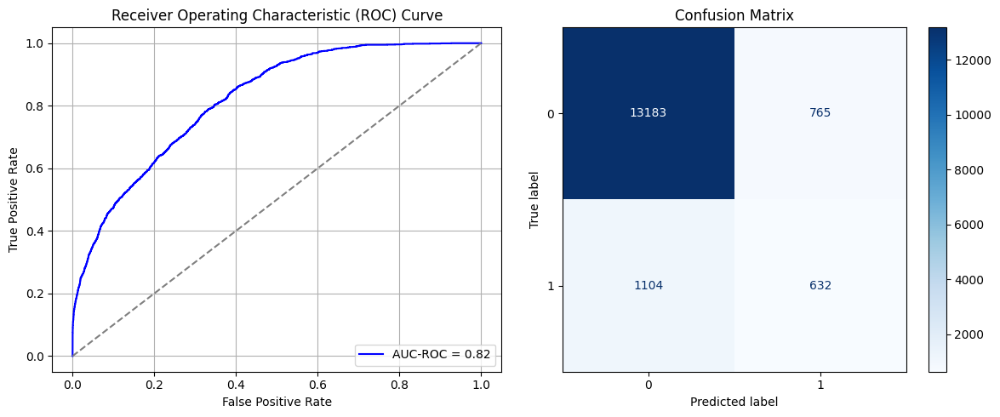

Best threshold based on F1-score: 0.40911316871643066
False Negative Rate: 0.6359447004608295
Time elapsed (performance): 1.966944422999859
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.7071 - loss: 0.6324 - val_AUC: 0.8369 - val_loss: 0.4980
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8445 - loss: 0.4867 - val_AUC: 0.8782 - val_loss: 0.4381
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8672 - loss: 0.4490 - val_AUC: 0.8817 - val_loss: 0.4288
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8693 - loss: 0.4456 - val_AUC: 0.8829 - val_loss: 0.4282
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8779 - loss: 0.4305 - val_AUC: 0.8834 - val_loss: 0.4246
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8765 - loss: 0.4334 - val_AUC: 0.8840 - val_loss: 0.4234
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8779 - loss: 0.4311 - val_AUC: 0.8851 - val_loss: 0.4220
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8794 - loss: 0.4284 - val_AUC: 0.8833 - val_loss: 0.4356
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8767 -

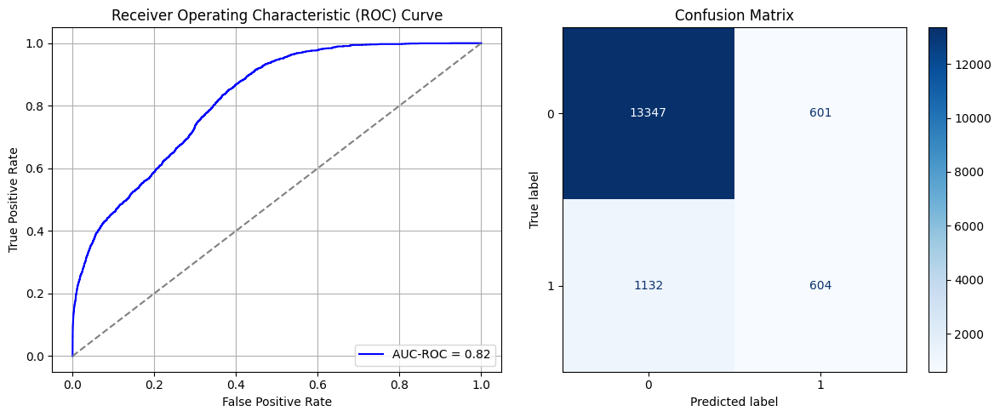

Best threshold based on F1-score: 0.4522259533405304
False Negative Rate: 0.652073732718894
Time elapsed (performance): 1.4390215250000438
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - AUC: 0.7356 - loss: 0.6125 - val_AUC: 0.8544 - val_loss: 0.4863
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8554 - loss: 0.4697 - val_AUC: 0.8721 - val_loss: 0.4455
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8706 - loss: 0.4414 - val_AUC: 0.8745 - val_loss: 0.4582
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8693 - loss: 0.4430 - val_AUC: 0.8745 - val_loss: 0.4378
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8690 - loss: 0.4449 - val_AUC: 0.8751 - val_loss: 0.4557
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8723 - loss: 0.4408 - val_AUC: 0.8764 - val_loss: 0.4452
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8725 - loss: 0.4373 - val_AUC: 0.8760 - val_loss: 0.4379
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8768 - loss: 0.4321 - val_AUC: 0.8770 - val_loss: 0.4333
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8792 -

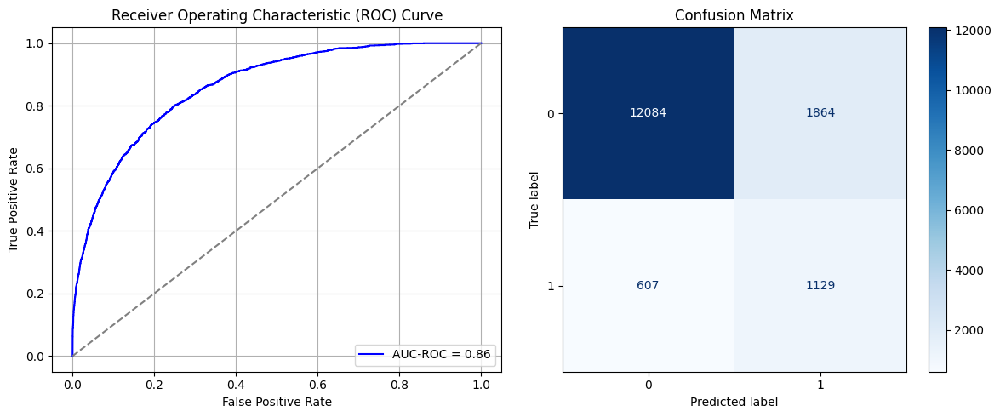

Best threshold based on F1-score: 0.6073800325393677
False Negative Rate: 0.34965437788018433
Time elapsed (performance): 1.9635506889999306
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.7075 - loss: 0.6242 - val_AUC: 0.8588 - val_loss: 0.4775
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8613 - loss: 0.4653 - val_AUC: 0.8710 - val_loss: 0.4466
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8748 - loss: 0.4393 - val_AUC: 0.8718 - val_loss: 0.4415
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8703 - loss: 0.4451 - val_AUC: 0.8729 - val_loss: 0.4414
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8736 - loss: 0.4386 - val_AUC: 0.8740 - val_loss: 0.4406
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8804 - loss: 0.4281 - val_AUC: 0.8742 - val_loss: 0.4375
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8769 - loss: 0.4346 - val_AUC: 0.8734 - val_loss: 0.4574
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8771 - loss: 0.4357 - val_AUC: 0.8738 - val_loss: 0.4394
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8795 -

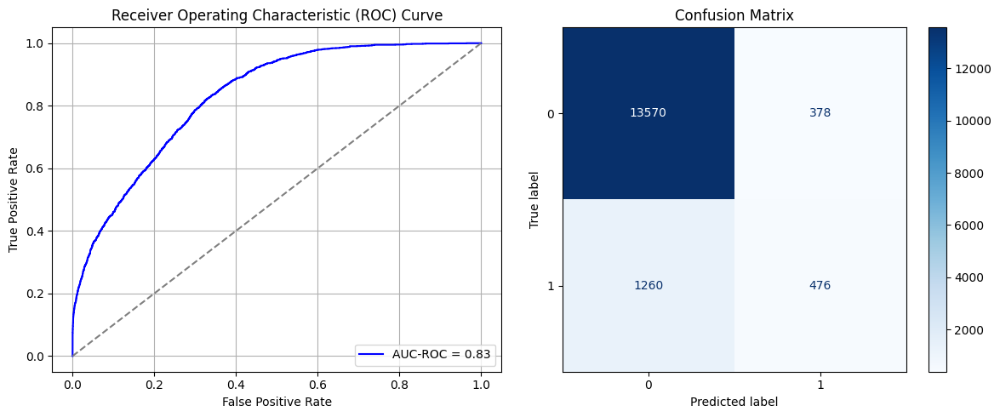

Best threshold based on F1-score: 0.30326563119888306
False Negative Rate: 0.7258064516129032
Time elapsed (performance): 1.9657094879999022
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - AUC: 0.7258 - loss: 0.6170 - val_AUC: 0.8503 - val_loss: 0.4928
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8575 - loss: 0.4699 - val_AUC: 0.8745 - val_loss: 0.4421
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8633 - loss: 0.4537 - val_AUC: 0.8744 - val_loss: 0.4408
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8731 - loss: 0.4394 - val_AUC: 0.8768 - val_loss: 0.4342
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8763 - loss: 0.4342 - val_AUC: 0.8764 - val_loss: 0.4374
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8770 - loss: 0.4341 - val_AUC: 0.8790 - val_loss: 0.4409
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8740 - loss: 0.4368 - val_AUC: 0.8787 - val_loss: 0.4337
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8776 - loss: 0.4305 - val_AUC: 0.8787 - val_loss: 0.4307
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8734 -

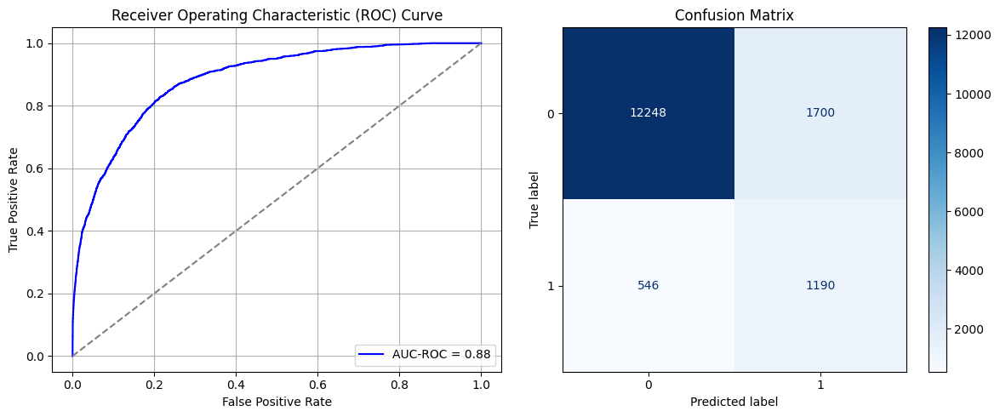

Best threshold based on F1-score: 0.5981925129890442
False Negative Rate: 0.31451612903225806
Time elapsed (performance): 1.9350040720000834
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 5s 6ms/step - AUC: 0.7473 - loss: 0.6101 - val_AUC: 0.8517 - val_loss: 0.4884
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8598 - loss: 0.4640 - val_AUC: 0.8694 - val_loss: 0.4479
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8700 - loss: 0.4449 - val_AUC: 0.8757 - val_loss: 0.4400
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8747 - loss: 0.4387 - val_AUC: 0.8749 - val_loss: 0.4386
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8748 - loss: 0.4379 - val_AUC: 0.8748 - val_loss: 0.4417
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8762 - loss: 0.4367 - val_AUC: 0.8756 - val_loss: 0.4373
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8789 - loss: 0.4307 - val_AUC: 0.8759 - val_loss: 0.4368
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8847 - loss: 0.4220 - val_AUC: 0.8758 - val_loss: 0.4363
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8758 -

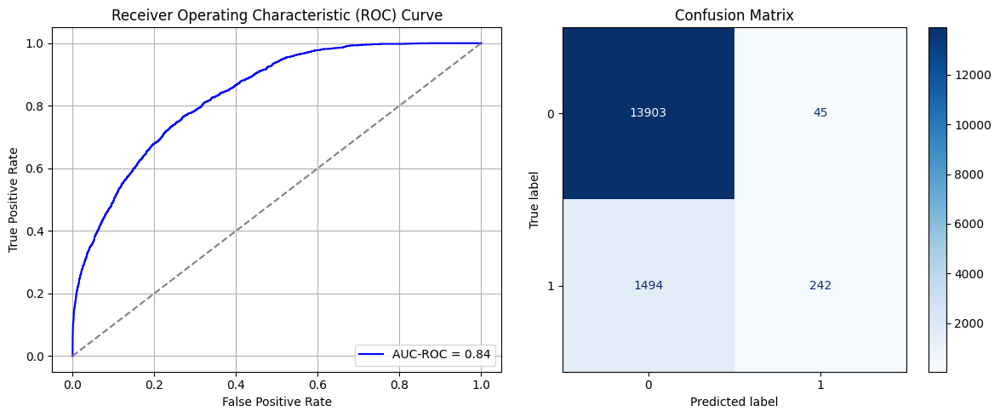

Best threshold based on F1-score: 0.07289865612983704
False Negative Rate: 0.8605990783410138
Time elapsed (performance): 1.7497993599999973
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - AUC: 0.7515 - loss: 0.6085 - val_AUC: 0.8621 - val_loss: 0.4667
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.8653 - loss: 0.4593 - val_AUC: 0.8756 - val_loss: 0.4403
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8730 - loss: 0.4402 - val_AUC: 0.8782 - val_loss: 0.4335
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8681 - loss: 0.4492 - val_AUC: 0.8792 - val_loss: 0.4366
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8741 - loss: 0.4383 - val_AUC: 0.8795 - val_loss: 0.4314
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8699 - loss: 0.4439 - val_AUC: 0.8802 - val_loss: 0.4325
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8830 - loss: 0.4231 - val_AUC: 0.8793 - val_loss: 0.4391
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8811 - loss: 0.4246 - val_AUC: 0.8816 - val_loss: 0.4269
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8759 -

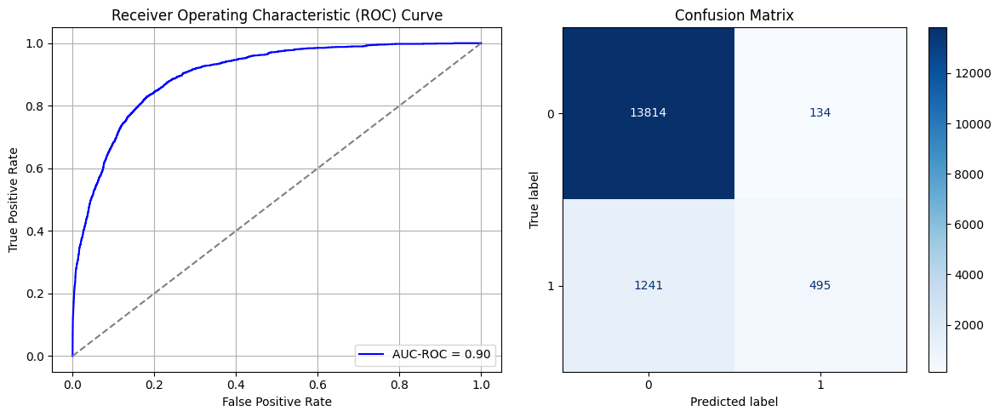

Best threshold based on F1-score: 0.18709029257297516
False Negative Rate: 0.7148617511520737
Time elapsed (performance): 2.137029169000016
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - AUC: 0.7436 - loss: 0.6118 - val_AUC: 0.8609 - val_loss: 0.4807
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8577 - loss: 0.4674 - val_AUC: 0.8788 - val_loss: 0.4383
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8672 - loss: 0.4500 - val_AUC: 0.8802 - val_loss: 0.4316
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8677 - loss: 0.4504 - val_AUC: 0.8795 - val_loss: 0.4322
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8724 - loss: 0.4417 - val_AUC: 0.8808 - val_loss: 0.4281
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8697 - loss: 0.4433 - val_AUC: 0.8824 - val_loss: 0.4361
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8732 - loss: 0.4391 - val_AUC: 0.8827 - val_loss: 0.4270
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8725 - loss: 0.4396 - val_AUC: 0.8844 - val_loss: 0.4225
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8741 -

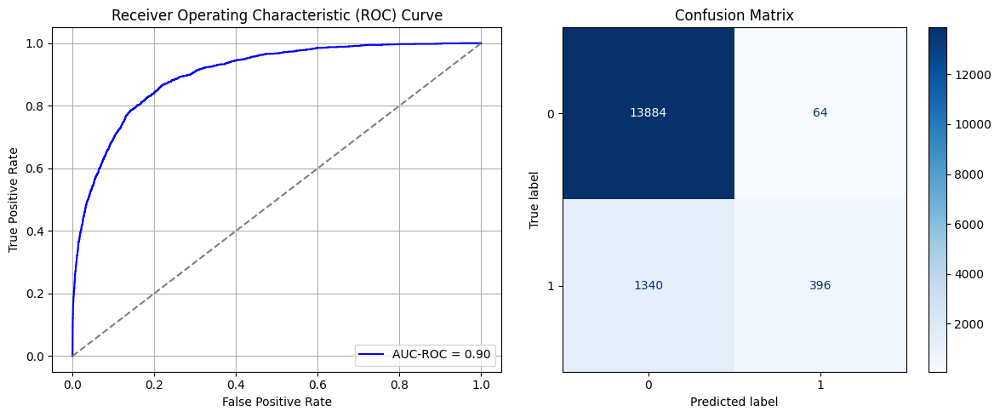

Best threshold based on F1-score: 0.1718059480190277
False Negative Rate: 0.771889400921659
Time elapsed (performance): 2.217737857999964
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - AUC: 0.7323 - loss: 0.6165 - val_AUC: 0.8678 - val_loss: 0.4778
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8594 - loss: 0.4653 - val_AUC: 0.8803 - val_loss: 0.4329
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8785 - loss: 0.4342 - val_AUC: 0.8806 - val_loss: 0.4307
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8788 - loss: 0.4314 - val_AUC: 0.8808 - val_loss: 0.4397
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8772 - loss: 0.4349 - val_AUC: 0.8816 - val_loss: 0.4316
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8757 - loss: 0.4356 - val_AUC: 0.8833 - val_loss: 0.4264
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8791 - loss: 0.4309 - val_AUC: 0.8821 - val_loss: 0.4271
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8753 - loss: 0.4345 - val_AUC: 0.8823 - val_loss: 0.4268
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8843 -

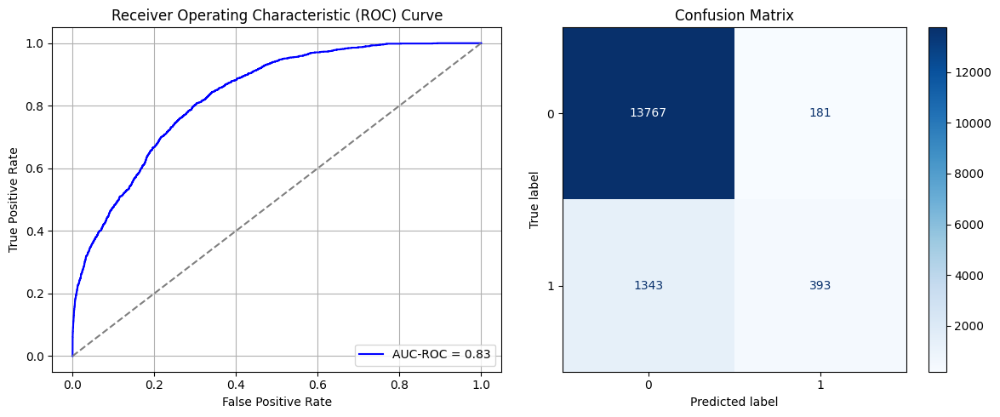

Best threshold based on F1-score: 0.18072278797626495
False Negative Rate: 0.7736175115207373
Time elapsed (performance): 1.878141757999856


In [38]:
times = 50

Training_time = []
FPR = []
TPR = []
FNR = []
TNR = []
TL_time = []


for i in range(times):
    data_S_maj_rus = data_S_majority.sample(n=undersample_size, replace=False)
    data_S_SRS_RUS = pd.concat([data_S_maj_rus, data_S_minority])
    X_S_SRS = data_S_SRS_RUS.iloc[:, :-1]
    y_S_SRS = data_S_SRS_RUS.iloc[:, -1]
    X_S_train, X_S_test, y_S_train, y_S_test = train_test_split(X_S_SRS, y_S_SRS, test_size=0.20, random_state=0)
    model_SRS = create_dnn_model(X_S_train.shape[1])
    result_SRS = train_and_evaluate(model_SRS, X_S_train, X_S_test, y_S_train, y_S_test, "Source")
    result_TL_SRS = Transductive_TL(model_SRS, X_T_full, y_T_full, "Target")

    Training_time.append(result_SRS)
    FPR.append(result_TL_SRS[0])
    TNR.append(result_TL_SRS[1])
    FNR.append(result_TL_SRS[2])
    TPR.append(result_TL_SRS[3])
    TL_time.append(result_TL_SRS[4])

ParamFit = pd.DataFrame([Training_time, FPR, TPR, FNR, TNR, TL_time]).T
ParamFit.columns=['Source time', 'FPR', 'TPR', 'FNR', 'TNR', 'Target time']
# print(ParamFit)

In [42]:
print(ParamFit)
ParamFit.to_csv('SRS_RUS.csv')

    Source time       FPR       TPR       FNR       TNR  Target time
0     26.856188  0.012045  0.233871  0.766129  0.987955     1.641035
1     22.768158  0.012475  0.239055  0.760945  0.987525     1.615470
2     26.614392  0.026169  0.381912  0.618088  0.973831     1.797067
3     24.520457  0.132420  0.550691  0.449309  0.867580     1.304806
4     23.922836  0.174505  0.509217  0.490783  0.825495     1.691919
5     21.802015  0.004373  0.180300  0.819700  0.995627     1.720865
6     20.873020  0.159378  0.743088  0.256912  0.840622     1.906960
7     25.389431  0.049971  0.494240  0.505760  0.950029     1.270252
8     22.039885  0.064454  0.510945  0.489055  0.935546     1.956272
9     27.155546  0.049900  0.387673  0.612327  0.950100     1.443619
10    23.346789  0.010683  0.205069  0.794931  0.989317     1.706098
11    23.367256  0.018497  0.287442  0.712558  0.981503     1.751279
12    25.607897  0.000358  0.081797  0.918203  0.999642     1.392904
13    23.467691  0.304345  0.80760

In [40]:
ParamFit['FNR'].mean()

np.float64(0.6327419354838709)

In [41]:
ParamFit['Source time'].mean()

np.float64(25.529446012179996)

## Simple Random Sampling with Replacement:

In [43]:
data_S
data_S_majority = data_S[data_S['Y'].isin([0])]
data_S_minority = data_S[data_S['Y'].isin([1])]

undersample_size = data_S_minority['Y'].size
oversample_size = data_S_majority['Y'].size

print(undersample_size)
print(oversample_size)

9805
22132


Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.7521 - loss: 0.6047 - val_AUC: 0.8687 - val_loss: 0.4656
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8661 - loss: 0.4570 - val_AUC: 0.8829 - val_loss: 0.4327
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8718 - loss: 0.4422 - val_AUC: 0.8855 - val_loss: 0.4241
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8733 - loss: 0.4391 - val_AUC: 0.8845 - val_loss: 0.4240
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8785 - loss: 0.4308 - val_AUC: 0.8849 - val_loss: 0.4255
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8811 - loss: 0.4277 - val_AUC: 0.8869 - val_loss: 0.4216
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8800 - loss: 0.4287 - val_AUC: 0.8858 - val_loss: 0.4242
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8819 - loss: 0.4256 - val_AUC: 0.8868 - val_loss: 0.4206
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8772 -

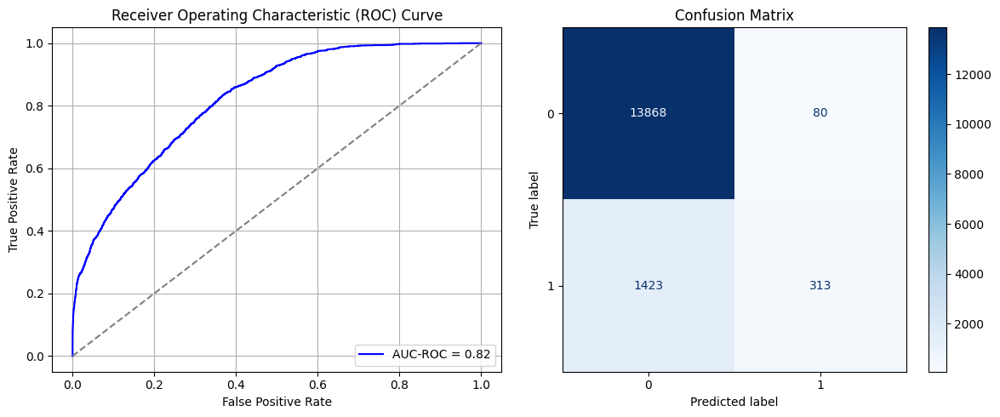

Best threshold based on F1-score: 0.14504151046276093
False Negative Rate: 0.8197004608294931
Time elapsed (performance): 1.879813588000161
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7283 - loss: 0.6218 - val_AUC: 0.8461 - val_loss: 0.4893
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8534 - loss: 0.4760 - val_AUC: 0.8708 - val_loss: 0.4465
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8698 - loss: 0.4462 - val_AUC: 0.8720 - val_loss: 0.4406
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8694 - loss: 0.4451 - val_AUC: 0.8723 - val_loss: 0.4414
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8692 - loss: 0.4457 - val_AUC: 0.8724 - val_loss: 0.4745
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8739 - loss: 0.4361 - val_AUC: 0.8744 - val_loss: 0.4380
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8765 - loss: 0.4359 - val_AUC: 0.8741 - val_loss: 0.4557
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8740 - loss: 0.4376 - val_AUC: 0.8750 - val_loss: 0.4493
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8743 -

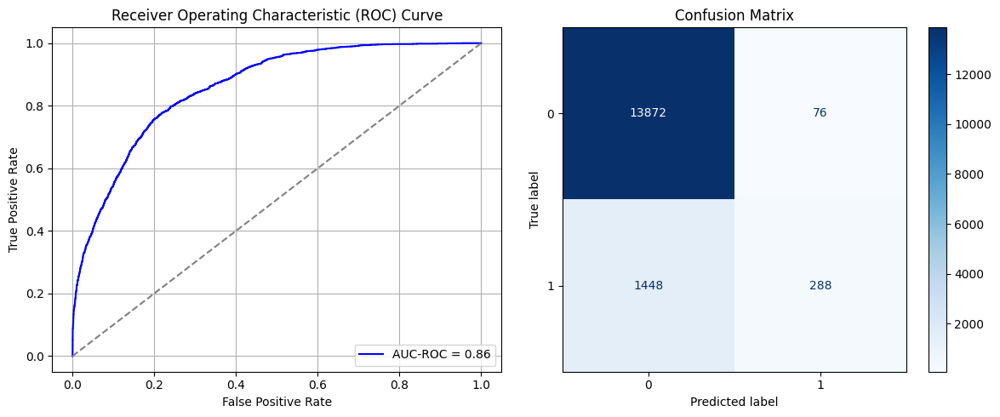

Best threshold based on F1-score: 0.10375408828258514
False Negative Rate: 0.8341013824884793
Time elapsed (performance): 1.174201751000055
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.7530 - loss: 0.6066 - val_AUC: 0.8586 - val_loss: 0.4694
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8634 - loss: 0.4587 - val_AUC: 0.8700 - val_loss: 0.4461
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8787 - loss: 0.4332 - val_AUC: 0.8724 - val_loss: 0.4512
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8721 - loss: 0.4419 - val_AUC: 0.8731 - val_loss: 0.4452
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8786 - loss: 0.4315 - val_AUC: 0.8730 - val_loss: 0.4558
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8785 - loss: 0.4331 - val_AUC: 0.8724 - val_loss: 0.4464
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8789 - loss: 0.4310 - val_AUC: 0.8724 - val_loss: 0.4447
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8828 - loss: 0.4247 - val_AUC: 0.8727 - val_loss: 0.4400
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8777 -

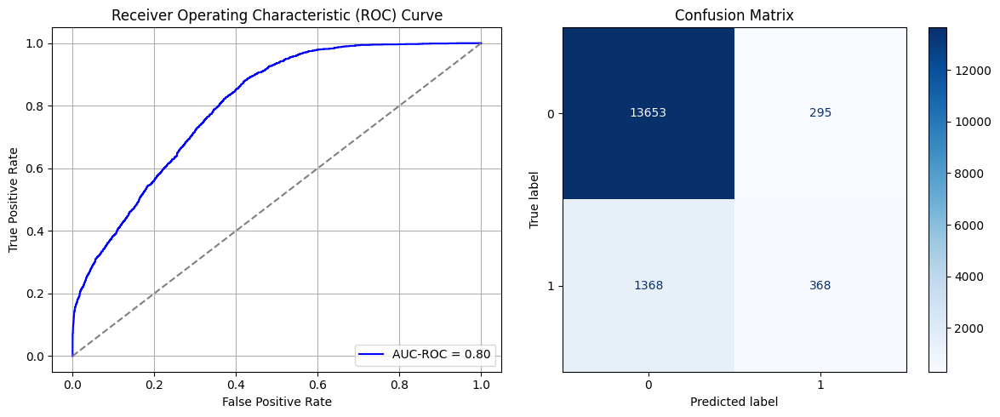

Best threshold based on F1-score: 0.1211811900138855
False Negative Rate: 0.7880184331797235
Time elapsed (performance): 1.6926666559998012
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7340 - loss: 0.6204 - val_AUC: 0.8614 - val_loss: 0.4715
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8650 - loss: 0.4589 - val_AUC: 0.8763 - val_loss: 0.4388
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8787 - loss: 0.4323 - val_AUC: 0.8812 - val_loss: 0.4337
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8821 - loss: 0.4248 - val_AUC: 0.8817 - val_loss: 0.4290
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8760 - loss: 0.4345 - val_AUC: 0.8801 - val_loss: 0.4322
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8808 - loss: 0.4280 - val_AUC: 0.8821 - val_loss: 0.4286
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8801 - loss: 0.4285 - val_AUC: 0.8809 - val_loss: 0.4378
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8824 - loss: 0.4242 - val_AUC: 0.8816 - val_loss: 0.4446
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8823 -

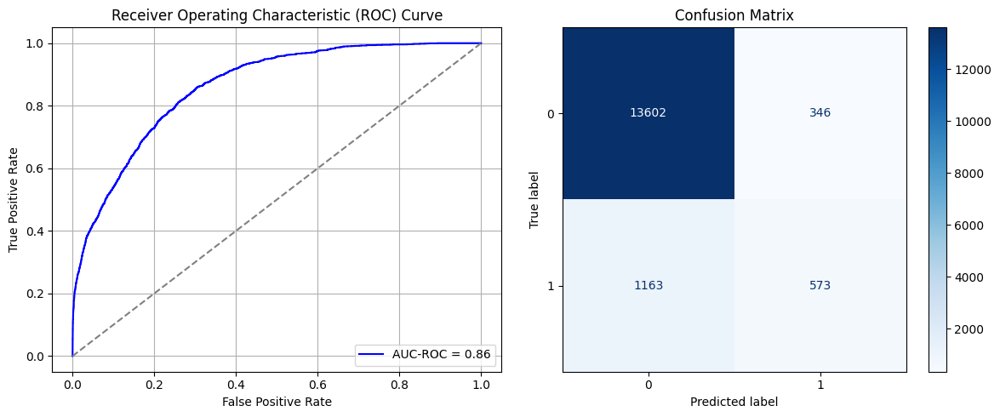

Best threshold based on F1-score: 0.2950166165828705
False Negative Rate: 0.6699308755760369
Time elapsed (performance): 1.689803822000158
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7368 - loss: 0.6188 - val_AUC: 0.8649 - val_loss: 0.4713
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8677 - loss: 0.4535 - val_AUC: 0.8729 - val_loss: 0.4457
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8706 - loss: 0.4424 - val_AUC: 0.8742 - val_loss: 0.4401
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8777 - loss: 0.4311 - val_AUC: 0.8747 - val_loss: 0.4560
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8787 - loss: 0.4309 - val_AUC: 0.8752 - val_loss: 0.4383
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8797 - loss: 0.4303 - val_AUC: 0.8750 - val_loss: 0.4460
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8743 - loss: 0.4402 - val_AUC: 0.8741 - val_loss: 0.4482
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8817 - loss: 0.4270 - val_AUC: 0.8758 - val_loss: 0.4361
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8772 -

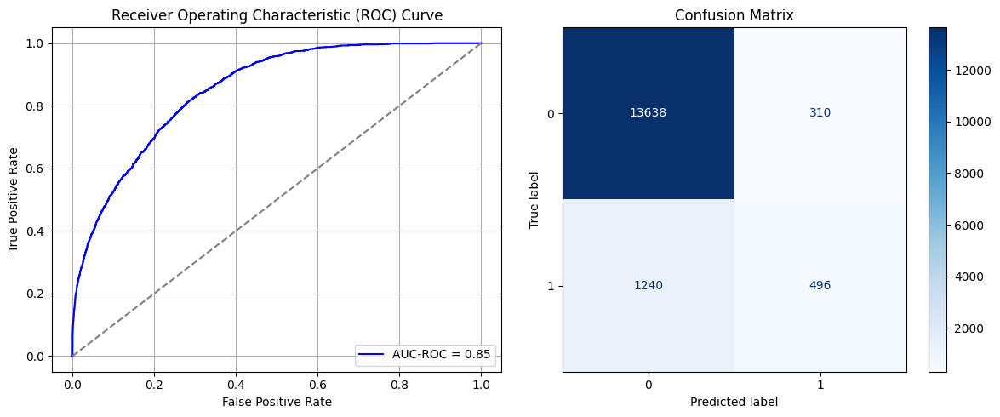

Best threshold based on F1-score: 0.25062546133995056
False Negative Rate: 0.7142857142857143
Time elapsed (performance): 1.8549628199998551
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7245 - loss: 0.6154 - val_AUC: 0.8649 - val_loss: 0.4736
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8583 - loss: 0.4686 - val_AUC: 0.8802 - val_loss: 0.4437
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8745 - loss: 0.4392 - val_AUC: 0.8828 - val_loss: 0.4291
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8741 - loss: 0.4405 - val_AUC: 0.8836 - val_loss: 0.4285
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8819 - loss: 0.4272 - val_AUC: 0.8843 - val_loss: 0.4252
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8757 - loss: 0.4371 - val_AUC: 0.8839 - val_loss: 0.4284
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8728 - loss: 0.4391 - val_AUC: 0.8840 - val_loss: 0.4267
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8784 - loss: 0.4338 - val_AUC: 0.8821 - val_loss: 0.4319
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8789 -

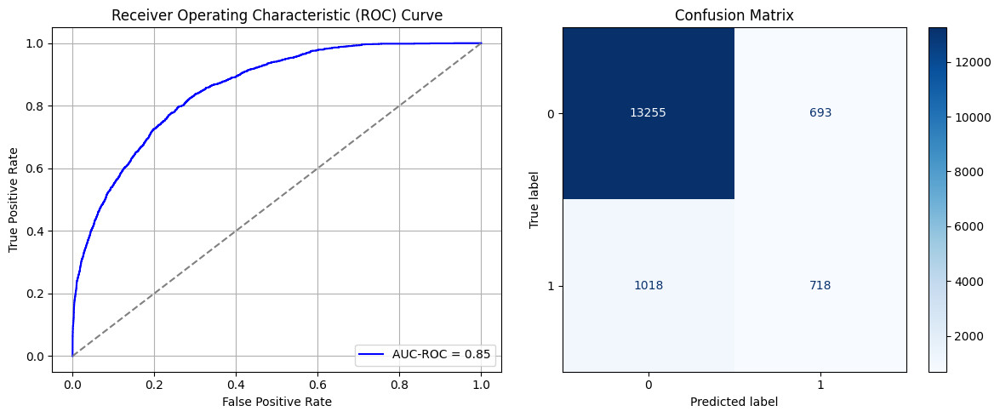

Best threshold based on F1-score: 0.37226611375808716
False Negative Rate: 0.586405529953917
Time elapsed (performance): 1.6990115479998167
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7357 - loss: 0.6206 - val_AUC: 0.8524 - val_loss: 0.4776
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8547 - loss: 0.4729 - val_AUC: 0.8705 - val_loss: 0.4453
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8697 - loss: 0.4446 - val_AUC: 0.8740 - val_loss: 0.4433
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8728 - loss: 0.4391 - val_AUC: 0.8752 - val_loss: 0.4368
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8691 - loss: 0.4443 - val_AUC: 0.8756 - val_loss: 0.4373
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8751 - loss: 0.4348 - val_AUC: 0.8755 - val_loss: 0.4367
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8778 - loss: 0.4313 - val_AUC: 0.8769 - val_loss: 0.4333
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8788 - loss: 0.4306 - val_AUC: 0.8755 - val_loss: 0.4363
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8780 -

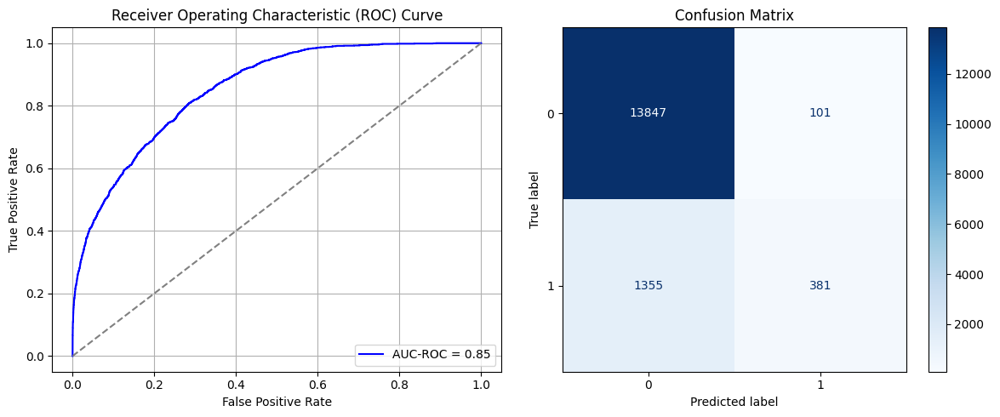

Best threshold based on F1-score: 0.19193461537361145
False Negative Rate: 0.7805299539170507
Time elapsed (performance): 1.2348135520001051
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7428 - loss: 0.6116 - val_AUC: 0.8631 - val_loss: 0.4642
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8694 - loss: 0.4502 - val_AUC: 0.8733 - val_loss: 0.4494
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8783 - loss: 0.4323 - val_AUC: 0.8750 - val_loss: 0.4414
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8820 - loss: 0.4280 - val_AUC: 0.8761 - val_loss: 0.4463
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8837 - loss: 0.4231 - val_AUC: 0.8754 - val_loss: 0.4402
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8764 - loss: 0.4335 - val_AUC: 0.8754 - val_loss: 0.4421
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8854 - loss: 0.4193 - val_AUC: 0.8763 - val_loss: 0.4365
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8868 - loss: 0.4186 - val_AUC: 0.8760 - val_loss: 0.4354
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8788 -

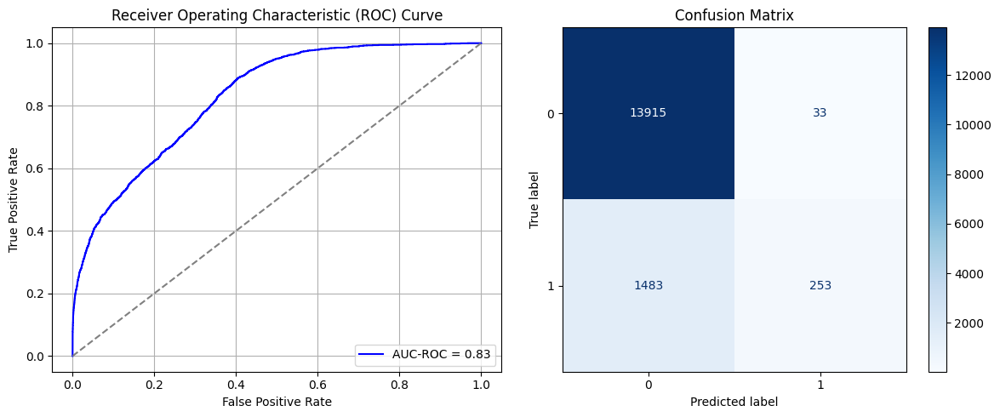

Best threshold based on F1-score: 0.07765515148639679
False Negative Rate: 0.8542626728110599
Time elapsed (performance): 3.031849457000135
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7323 - loss: 0.6099 - val_AUC: 0.8504 - val_loss: 0.4811
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8641 - loss: 0.4587 - val_AUC: 0.8676 - val_loss: 0.4531
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8642 - loss: 0.4550 - val_AUC: 0.8683 - val_loss: 0.4532
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8656 - loss: 0.4526 - val_AUC: 0.8691 - val_loss: 0.4486
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8799 - loss: 0.4305 - val_AUC: 0.8703 - val_loss: 0.4476
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8759 - loss: 0.4347 - val_AUC: 0.8724 - val_loss: 0.4426
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8717 - loss: 0.4413 - val_AUC: 0.8711 - val_loss: 0.4457
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8792 - loss: 0.4313 - val_AUC: 0.8728 - val_loss: 0.4426
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8779 -

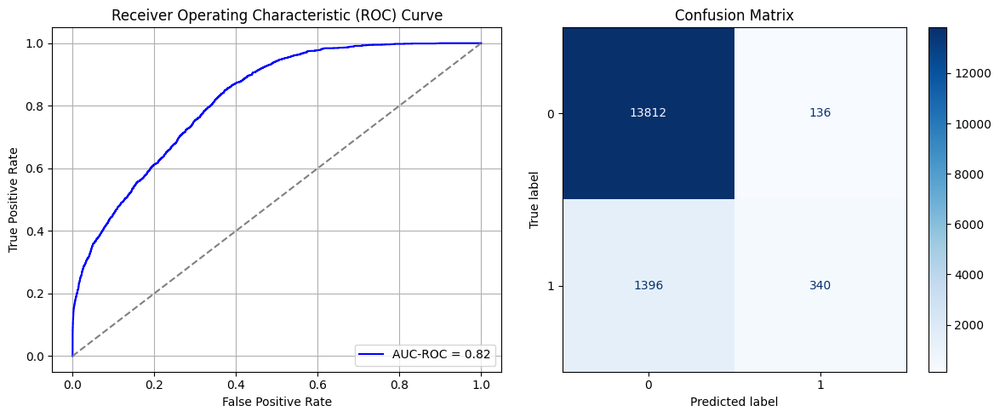

Best threshold based on F1-score: 0.23200750350952148
False Negative Rate: 0.804147465437788
Time elapsed (performance): 1.7130277760002173
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7061 - loss: 0.6264 - val_AUC: 0.8431 - val_loss: 0.4917
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8559 - loss: 0.4708 - val_AUC: 0.8695 - val_loss: 0.4523
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8721 - loss: 0.4418 - val_AUC: 0.8712 - val_loss: 0.4475
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8728 - loss: 0.4402 - val_AUC: 0.8723 - val_loss: 0.4489
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8709 - loss: 0.4425 - val_AUC: 0.8721 - val_loss: 0.4438
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8729 - loss: 0.4396 - val_AUC: 0.8739 - val_loss: 0.4408
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8759 - loss: 0.4346 - val_AUC: 0.8742 - val_loss: 0.4422
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8763 - loss: 0.4329 - val_AUC: 0.8731 - val_loss: 0.4410
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8808 -

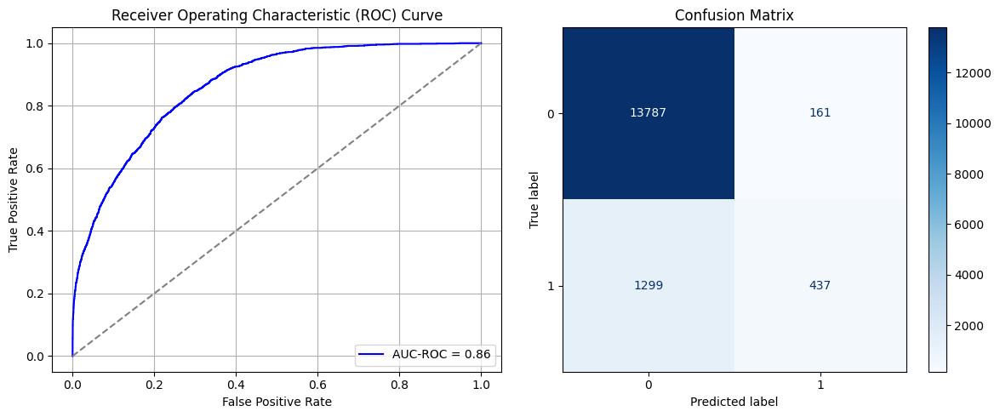

Best threshold based on F1-score: 0.22569997608661652
False Negative Rate: 0.7482718894009217
Time elapsed (performance): 1.2971131939998486
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7594 - loss: 0.6011 - val_AUC: 0.8551 - val_loss: 0.4794
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8622 - loss: 0.4635 - val_AUC: 0.8704 - val_loss: 0.4453
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8757 - loss: 0.4377 - val_AUC: 0.8733 - val_loss: 0.4443
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8695 - loss: 0.4452 - val_AUC: 0.8739 - val_loss: 0.4399
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8785 - loss: 0.4316 - val_AUC: 0.8743 - val_loss: 0.4373
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8809 - loss: 0.4281 - val_AUC: 0.8753 - val_loss: 0.4394
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8789 - loss: 0.4313 - val_AUC: 0.8759 - val_loss: 0.4336
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8768 - loss: 0.4356 - val_AUC: 0.8759 - val_loss: 0.4380
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8830 -

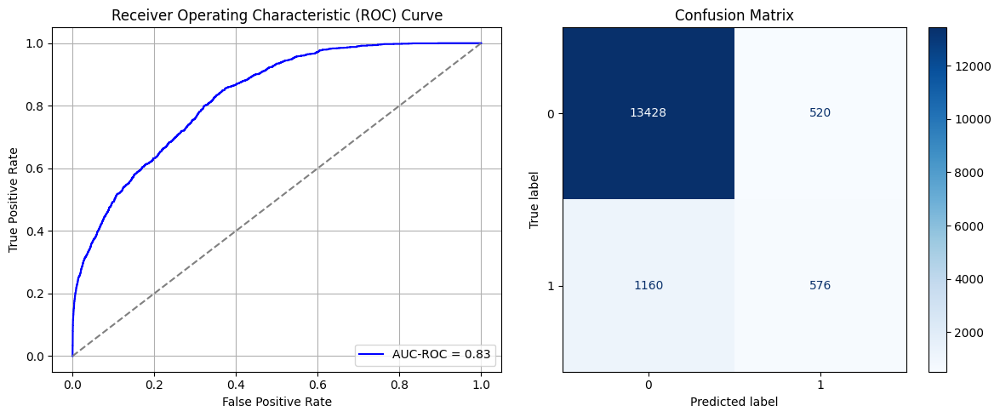

Best threshold based on F1-score: 0.29729023575782776
False Negative Rate: 0.6682027649769585
Time elapsed (performance): 1.886851403000037
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7473 - loss: 0.6081 - val_AUC: 0.8563 - val_loss: 0.4764
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8522 - loss: 0.4771 - val_AUC: 0.8727 - val_loss: 0.4613
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8737 - loss: 0.4421 - val_AUC: 0.8742 - val_loss: 0.4477
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8700 - loss: 0.4430 - val_AUC: 0.8773 - val_loss: 0.4360
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8714 - loss: 0.4414 - val_AUC: 0.8783 - val_loss: 0.4394
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8781 - loss: 0.4305 - val_AUC: 0.8790 - val_loss: 0.4326
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8723 - loss: 0.4391 - val_AUC: 0.8794 - val_loss: 0.4324
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8760 - loss: 0.4351 - val_AUC: 0.8775 - val_loss: 0.4372
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8733 -

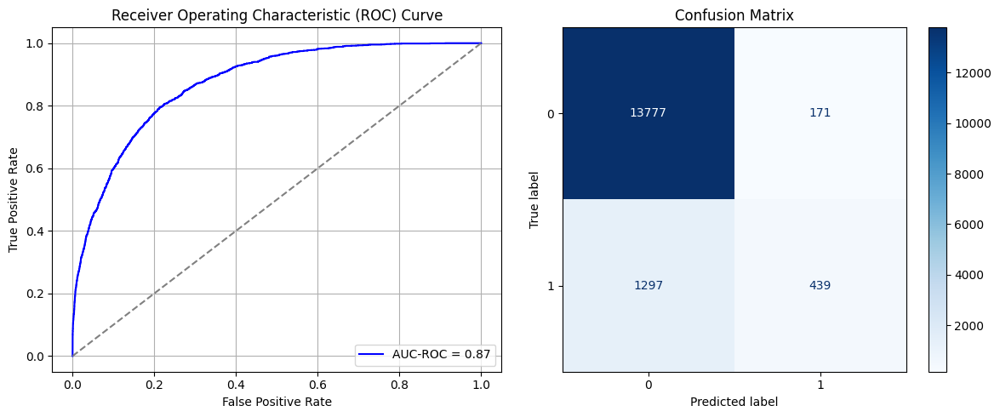

Best threshold based on F1-score: 0.17116405069828033
False Negative Rate: 0.7471198156682027
Time elapsed (performance): 2.00817079799981
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7367 - loss: 0.6131 - val_AUC: 0.8499 - val_loss: 0.4983
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8525 - loss: 0.4759 - val_AUC: 0.8688 - val_loss: 0.4536
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8723 - loss: 0.4408 - val_AUC: 0.8689 - val_loss: 0.4499
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8659 - loss: 0.4495 - val_AUC: 0.8699 - val_loss: 0.4471
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8718 - loss: 0.4405 - val_AUC: 0.8725 - val_loss: 0.4495
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8708 - loss: 0.4413 - val_AUC: 0.8715 - val_loss: 0.4590
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8730 - loss: 0.4383 - val_AUC: 0.8712 - val_loss: 0.4691
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8727 - loss: 0.4390 - val_AUC: 0.8743 - val_loss: 0.4394
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8724 -

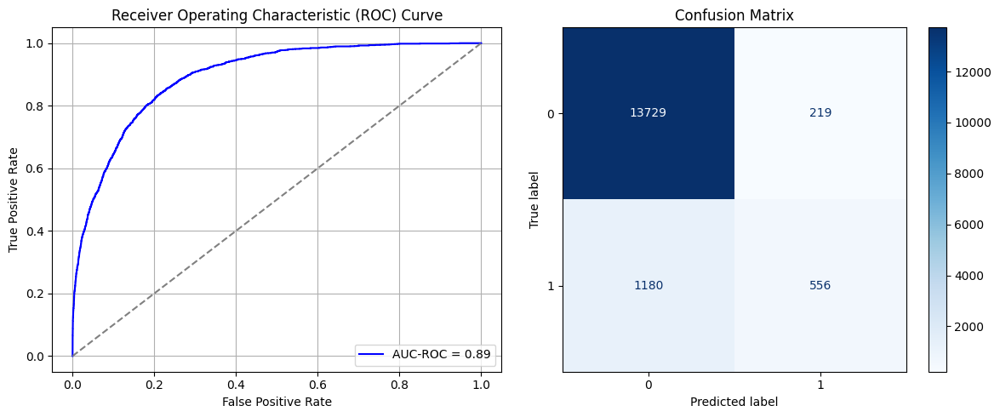

Best threshold based on F1-score: 0.21658459305763245
False Negative Rate: 0.6797235023041475
Time elapsed (performance): 3.0490575740000168
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7403 - loss: 0.6121 - val_AUC: 0.8656 - val_loss: 0.4651
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8658 - loss: 0.4550 - val_AUC: 0.8756 - val_loss: 0.4508
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8717 - loss: 0.4433 - val_AUC: 0.8791 - val_loss: 0.4319
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8750 - loss: 0.4385 - val_AUC: 0.8790 - val_loss: 0.4321
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8804 - loss: 0.4270 - val_AUC: 0.8783 - val_loss: 0.4488
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8762 - loss: 0.4332 - val_AUC: 0.8798 - val_loss: 0.4339
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8750 - loss: 0.4359 - val_AUC: 0.8798 - val_loss: 0.4372
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8785 - loss: 0.4305 - val_AUC: 0.8793 - val_loss: 0.4349
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8798 -

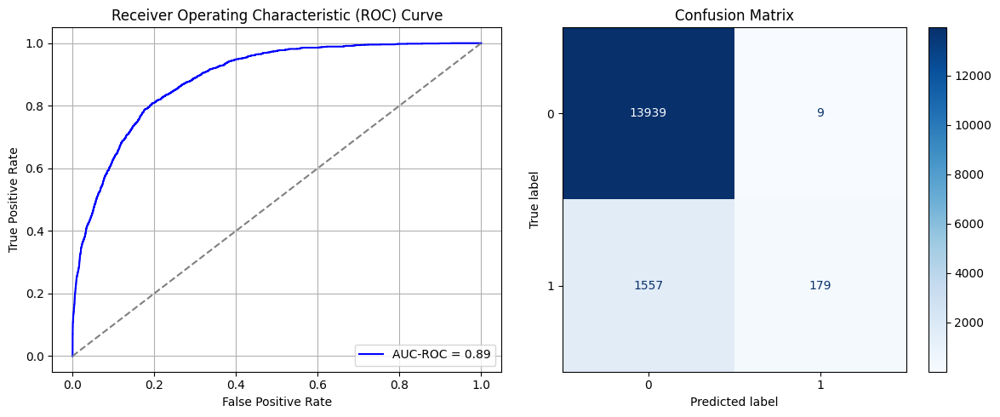

Best threshold based on F1-score: 0.028651446104049683
False Negative Rate: 0.896889400921659
Time elapsed (performance): 1.2830604689997926
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7287 - loss: 0.6170 - val_AUC: 0.8615 - val_loss: 0.4798
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8558 - loss: 0.4701 - val_AUC: 0.8789 - val_loss: 0.4654
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8712 - loss: 0.4436 - val_AUC: 0.8833 - val_loss: 0.4326
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8733 - loss: 0.4394 - val_AUC: 0.8837 - val_loss: 0.4291
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8783 - loss: 0.4303 - val_AUC: 0.8853 - val_loss: 0.4275
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8732 - loss: 0.4391 - val_AUC: 0.8850 - val_loss: 0.4324
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8732 - loss: 0.4376 - val_AUC: 0.8854 - val_loss: 0.4255
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8743 - loss: 0.4374 - val_AUC: 0.8831 - val_loss: 0.4312
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8762 -

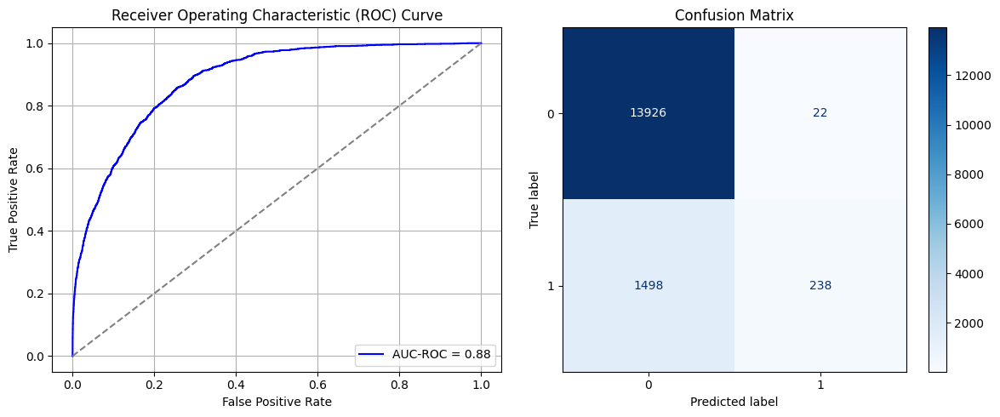

Best threshold based on F1-score: 0.08309167623519897
False Negative Rate: 0.8629032258064516
Time elapsed (performance): 1.8876027320002322
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7574 - loss: 0.6029 - val_AUC: 0.8548 - val_loss: 0.4751
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8585 - loss: 0.4652 - val_AUC: 0.8675 - val_loss: 0.4529
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8737 - loss: 0.4379 - val_AUC: 0.8687 - val_loss: 0.4517
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8786 - loss: 0.4319 - val_AUC: 0.8697 - val_loss: 0.4465
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8785 - loss: 0.4322 - val_AUC: 0.8712 - val_loss: 0.4476
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8758 - loss: 0.4352 - val_AUC: 0.8712 - val_loss: 0.4473
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8732 - loss: 0.4378 - val_AUC: 0.8734 - val_loss: 0.4402
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8869 - loss: 0.4182 - val_AUC: 0.8709 - val_loss: 0.4559
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8795 -

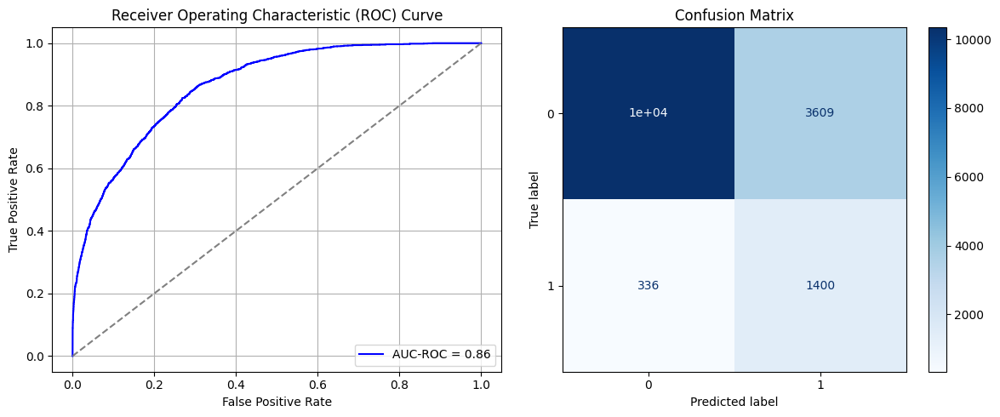

Best threshold based on F1-score: 0.7442479729652405
False Negative Rate: 0.1935483870967742
Time elapsed (performance): 1.8817176769998696
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7485 - loss: 0.6136 - val_AUC: 0.8569 - val_loss: 0.4747
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8579 - loss: 0.4671 - val_AUC: 0.8783 - val_loss: 0.4357
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8743 - loss: 0.4386 - val_AUC: 0.8810 - val_loss: 0.4447
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8740 - loss: 0.4383 - val_AUC: 0.8818 - val_loss: 0.4360
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8797 - loss: 0.4315 - val_AUC: 0.8824 - val_loss: 0.4373
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8792 - loss: 0.4299 - val_AUC: 0.8818 - val_loss: 0.4302
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8798 - loss: 0.4284 - val_AUC: 0.8826 - val_loss: 0.4313
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8826 - loss: 0.4252 - val_AUC: 0.8845 - val_loss: 0.4244
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8826 -

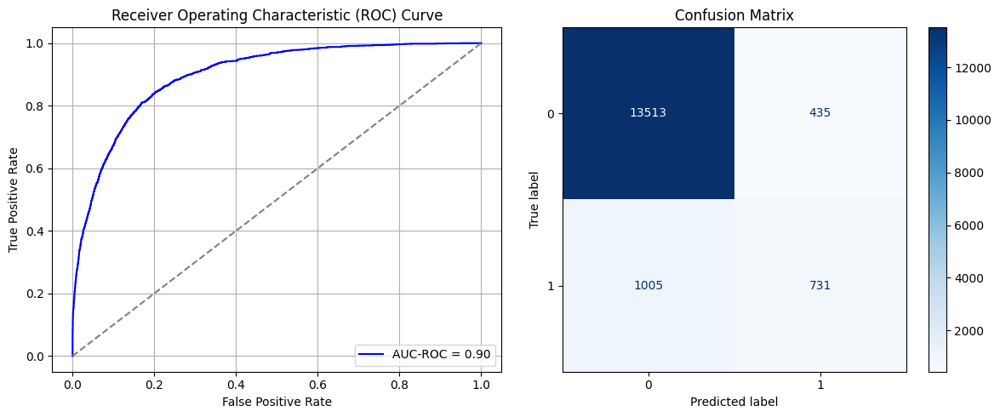

Best threshold based on F1-score: 0.3579927086830139
False Negative Rate: 0.5789170506912442
Time elapsed (performance): 1.2909486870003093
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7459 - loss: 0.6069 - val_AUC: 0.8566 - val_loss: 0.4728
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8616 - loss: 0.4615 - val_AUC: 0.8717 - val_loss: 0.4435
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8714 - loss: 0.4446 - val_AUC: 0.8740 - val_loss: 0.4408
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8747 - loss: 0.4369 - val_AUC: 0.8743 - val_loss: 0.4386
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8709 - loss: 0.4412 - val_AUC: 0.8747 - val_loss: 0.4380
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8804 - loss: 0.4286 - val_AUC: 0.8753 - val_loss: 0.4370
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8772 - loss: 0.4336 - val_AUC: 0.8768 - val_loss: 0.4339
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8756 - loss: 0.4353 - val_AUC: 0.8773 - val_loss: 0.4325
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8788 -

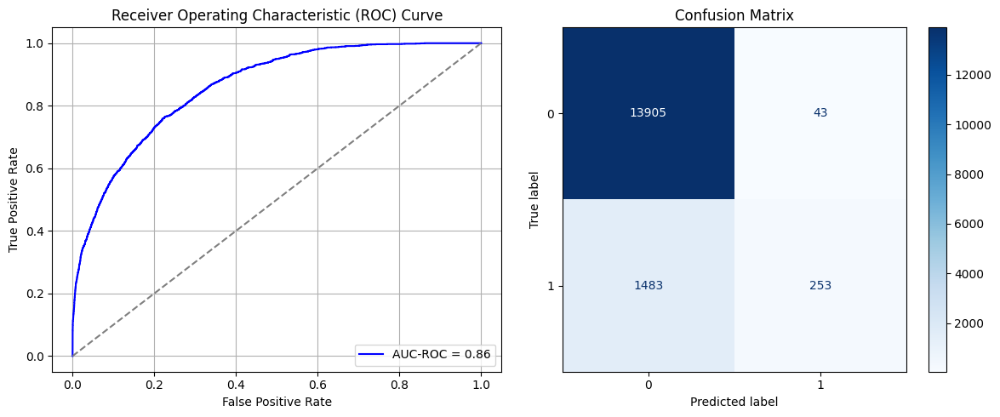

Best threshold based on F1-score: 0.08231108635663986
False Negative Rate: 0.8542626728110599
Time elapsed (performance): 1.302802676000283
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - AUC: 0.7212 - loss: 0.6191 - val_AUC: 0.8526 - val_loss: 0.4824
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8480 - loss: 0.4801 - val_AUC: 0.8713 - val_loss: 0.4483
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8670 - loss: 0.4497 - val_AUC: 0.8737 - val_loss: 0.4623
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8677 - loss: 0.4480 - val_AUC: 0.8743 - val_loss: 0.4382
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8708 - loss: 0.4413 - val_AUC: 0.8749 - val_loss: 0.4380
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8714 - loss: 0.4424 - val_AUC: 0.8751 - val_loss: 0.4382
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8720 - loss: 0.4419 - val_AUC: 0.8758 - val_loss: 0.4345
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8738 - loss: 0.4378 - val_AUC: 0.8757 - val_loss: 0.4372
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8699 -

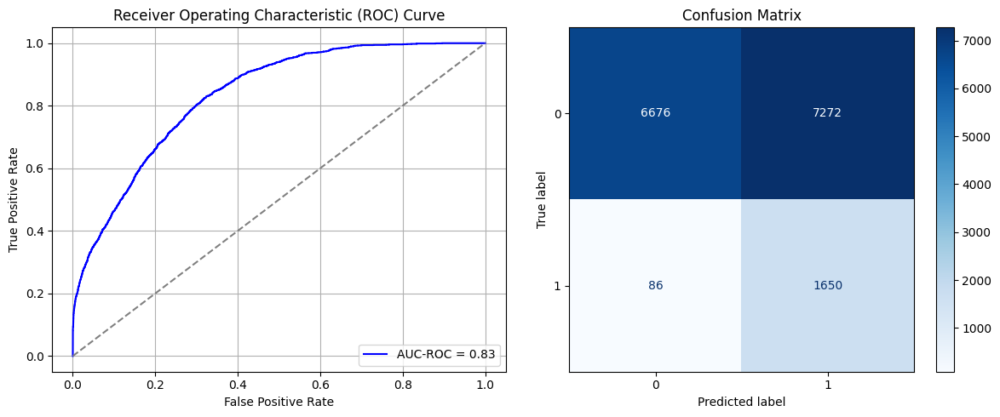

Best threshold based on F1-score: 0.8129618167877197
False Negative Rate: 0.04953917050691244
Time elapsed (performance): 1.319981543999802
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7231 - loss: 0.6202 - val_AUC: 0.8567 - val_loss: 0.4767
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8560 - loss: 0.4707 - val_AUC: 0.8721 - val_loss: 0.4461
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8703 - loss: 0.4457 - val_AUC: 0.8729 - val_loss: 0.4425
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8707 - loss: 0.4430 - val_AUC: 0.8737 - val_loss: 0.4419
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8793 - loss: 0.4307 - val_AUC: 0.8752 - val_loss: 0.4508
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8793 - loss: 0.4320 - val_AUC: 0.8759 - val_loss: 0.4389
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8723 - loss: 0.4400 - val_AUC: 0.8763 - val_loss: 0.4384
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8815 - loss: 0.4271 - val_AUC: 0.8747 - val_loss: 0.4384
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8804 -

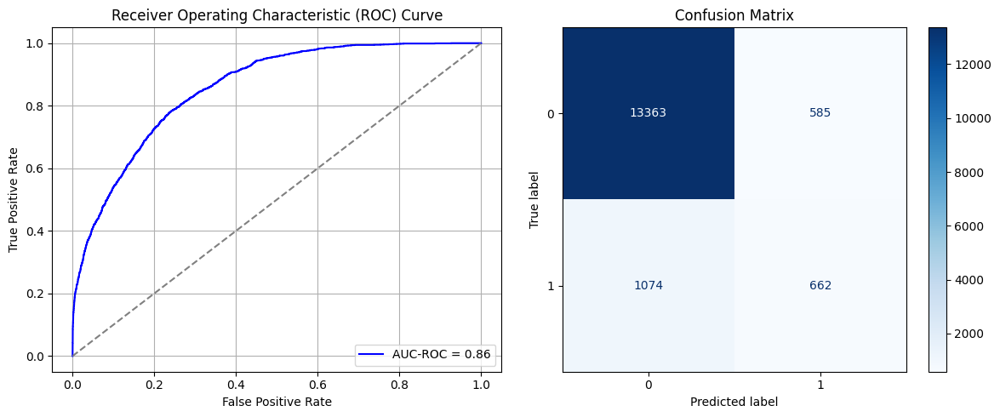

Best threshold based on F1-score: 0.39543846249580383
False Negative Rate: 0.618663594470046
Time elapsed (performance): 1.2930571890001374
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7397 - loss: 0.6183 - val_AUC: 0.8430 - val_loss: 0.4883
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8584 - loss: 0.4674 - val_AUC: 0.8689 - val_loss: 0.4501
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8721 - loss: 0.4438 - val_AUC: 0.8718 - val_loss: 0.4428
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8769 - loss: 0.4344 - val_AUC: 0.8730 - val_loss: 0.4415
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8780 - loss: 0.4323 - val_AUC: 0.8752 - val_loss: 0.4382
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8797 - loss: 0.4303 - val_AUC: 0.8742 - val_loss: 0.4440
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8758 - loss: 0.4353 - val_AUC: 0.8730 - val_loss: 0.4432
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8815 - loss: 0.4276 - val_AUC: 0.8754 - val_loss: 0.4410
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8769 -

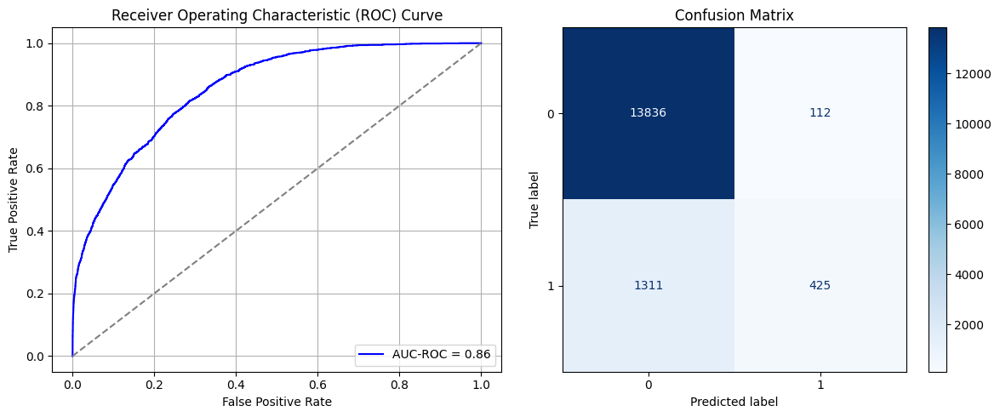

Best threshold based on F1-score: 0.2381536215543747
False Negative Rate: 0.755184331797235
Time elapsed (performance): 1.3492267780002294
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - AUC: 0.7400 - loss: 0.6187 - val_AUC: 0.8593 - val_loss: 0.4777
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8588 - loss: 0.4673 - val_AUC: 0.8746 - val_loss: 0.4572
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8669 - loss: 0.4492 - val_AUC: 0.8772 - val_loss: 0.4358
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8764 - loss: 0.4371 - val_AUC: 0.8766 - val_loss: 0.4361
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8780 - loss: 0.4332 - val_AUC: 0.8783 - val_loss: 0.4332
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8755 - loss: 0.4350 - val_AUC: 0.8793 - val_loss: 0.4356
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8732 - loss: 0.4401 - val_AUC: 0.8788 - val_loss: 0.4318
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8802 - loss: 0.4278 - val_AUC: 0.8790 - val_loss: 0.4430
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8694 -

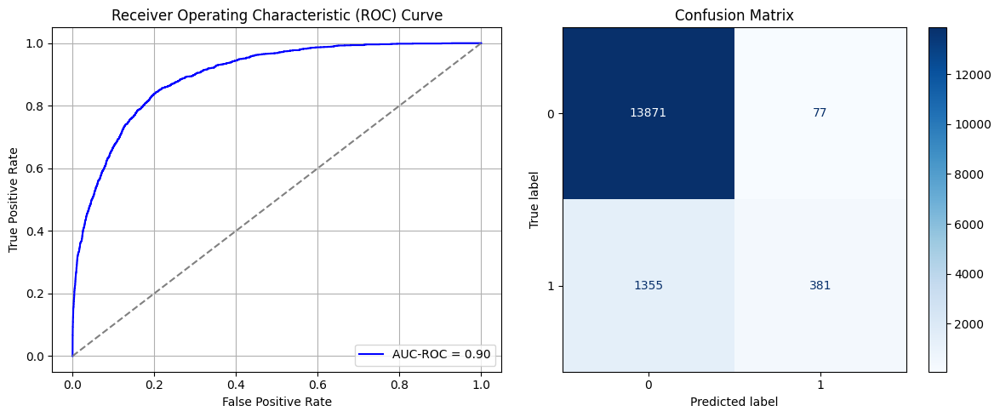

Best threshold based on F1-score: 0.12058193236589432
False Negative Rate: 0.7805299539170507
Time elapsed (performance): 1.743736280000121
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - AUC: 0.7248 - loss: 0.6234 - val_AUC: 0.8484 - val_loss: 0.4826
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8550 - loss: 0.4722 - val_AUC: 0.8773 - val_loss: 0.4363
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8692 - loss: 0.4470 - val_AUC: 0.8777 - val_loss: 0.4336
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8789 - loss: 0.4302 - val_AUC: 0.8813 - val_loss: 0.4355
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8698 - loss: 0.4450 - val_AUC: 0.8817 - val_loss: 0.4264
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8753 - loss: 0.4372 - val_AUC: 0.8807 - val_loss: 0.4272
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8719 - loss: 0.4418 - val_AUC: 0.8824 - val_loss: 0.4277
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8778 - loss: 0.4319 - val_AUC: 0.8831 - val_loss: 0.4233
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8777 -

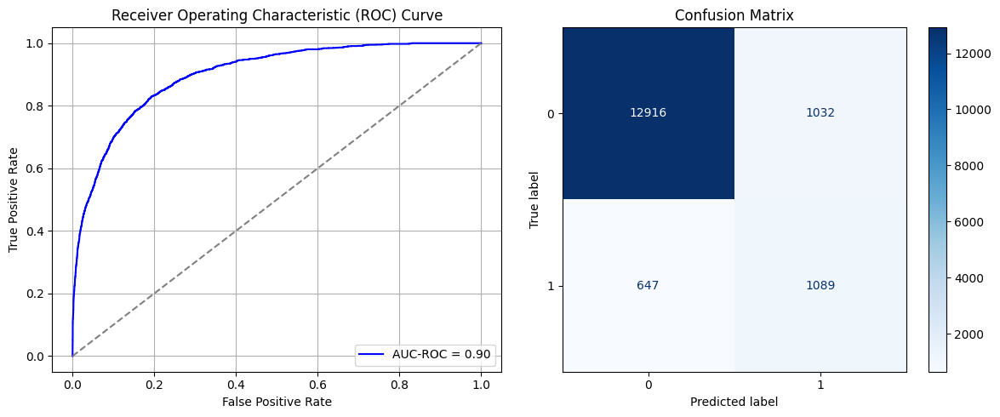

Best threshold based on F1-score: 0.5075175762176514
False Negative Rate: 0.3726958525345622
Time elapsed (performance): 1.3987827880000623
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7379 - loss: 0.6146 - val_AUC: 0.8647 - val_loss: 0.4695
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8646 - loss: 0.4584 - val_AUC: 0.8753 - val_loss: 0.4384
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8757 - loss: 0.4354 - val_AUC: 0.8754 - val_loss: 0.4372
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8763 - loss: 0.4340 - val_AUC: 0.8776 - val_loss: 0.4349
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8785 - loss: 0.4301 - val_AUC: 0.8780 - val_loss: 0.4348
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8751 - loss: 0.4352 - val_AUC: 0.8771 - val_loss: 0.4371
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8846 - loss: 0.4206 - val_AUC: 0.8782 - val_loss: 0.4325
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8802 - loss: 0.4279 - val_AUC: 0.8775 - val_loss: 0.4354
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8788 -

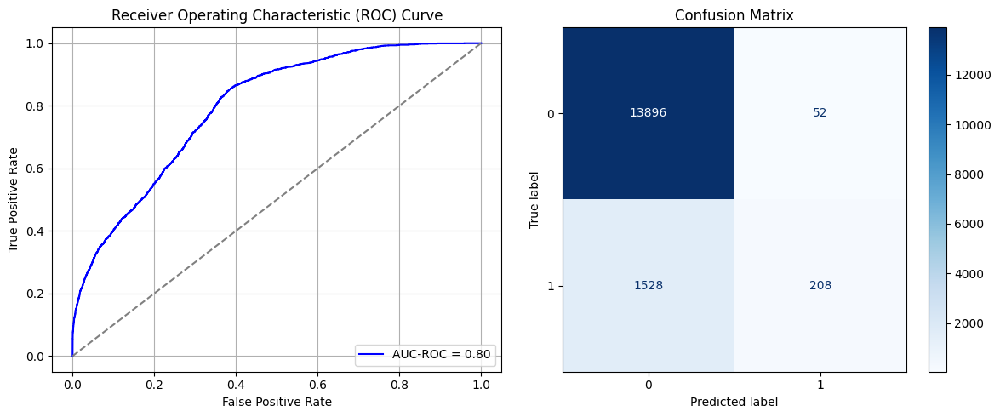

Best threshold based on F1-score: 0.10168793052434921
False Negative Rate: 0.880184331797235
Time elapsed (performance): 1.7255583589999333
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7443 - loss: 0.6184 - val_AUC: 0.8485 - val_loss: 0.4814
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8627 - loss: 0.4619 - val_AUC: 0.8685 - val_loss: 0.4564
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8736 - loss: 0.4409 - val_AUC: 0.8711 - val_loss: 0.4478
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8686 - loss: 0.4470 - val_AUC: 0.8729 - val_loss: 0.4432
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8728 - loss: 0.4416 - val_AUC: 0.8736 - val_loss: 0.4417
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8726 - loss: 0.4403 - val_AUC: 0.8743 - val_loss: 0.4453
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8731 - loss: 0.4394 - val_AUC: 0.8754 - val_loss: 0.4406
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8705 - loss: 0.4445 - val_AUC: 0.8749 - val_loss: 0.4384
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8735 -

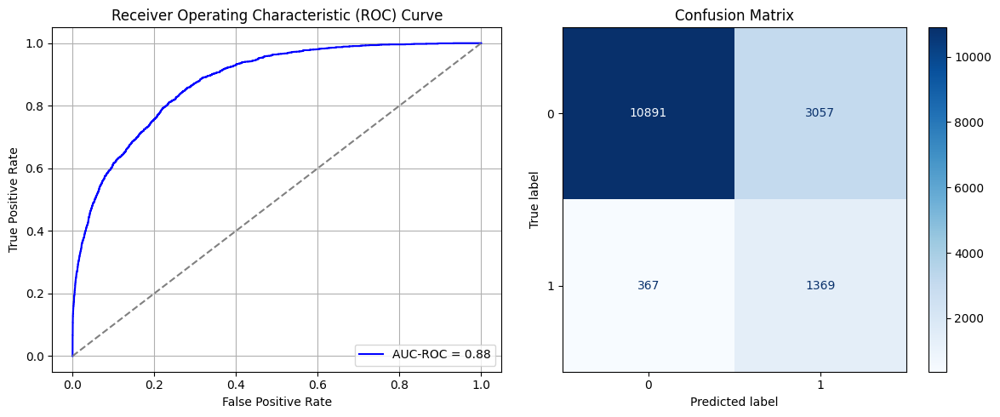

Best threshold based on F1-score: 0.7173487544059753
False Negative Rate: 0.21140552995391704
Time elapsed (performance): 1.7112586610001017
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7460 - loss: 0.6143 - val_AUC: 0.8512 - val_loss: 0.4815
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8548 - loss: 0.4712 - val_AUC: 0.8703 - val_loss: 0.4451
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8684 - loss: 0.4468 - val_AUC: 0.8743 - val_loss: 0.4393
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8679 - loss: 0.4469 - val_AUC: 0.8756 - val_loss: 0.4372
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8727 - loss: 0.4413 - val_AUC: 0.8765 - val_loss: 0.4393
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8828 - loss: 0.4249 - val_AUC: 0.8774 - val_loss: 0.4340
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8723 - loss: 0.4417 - val_AUC: 0.8784 - val_loss: 0.4409
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8752 - loss: 0.4353 - val_AUC: 0.8765 - val_loss: 0.4357
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8756 -

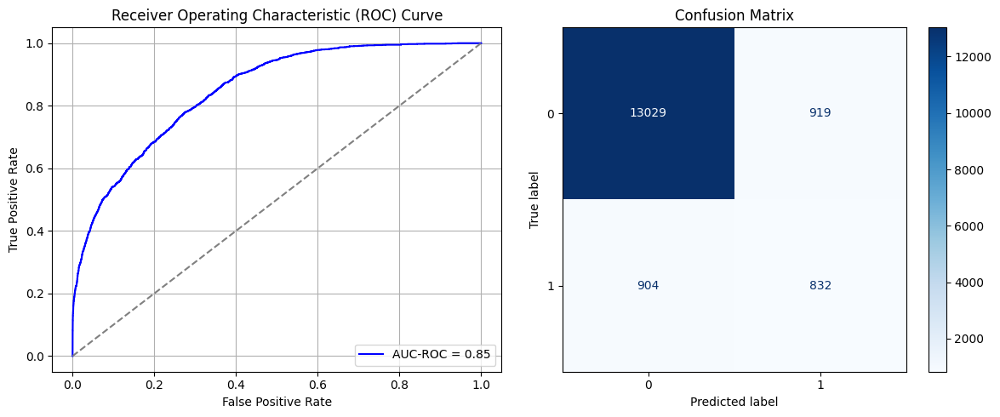

Best threshold based on F1-score: 0.4805848300457001
False Negative Rate: 0.5207373271889401
Time elapsed (performance): 1.3601935199999389
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7263 - loss: 0.6155 - val_AUC: 0.8522 - val_loss: 0.4838
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8606 - loss: 0.4646 - val_AUC: 0.8691 - val_loss: 0.4496
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8719 - loss: 0.4431 - val_AUC: 0.8724 - val_loss: 0.4431
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8760 - loss: 0.4361 - val_AUC: 0.8731 - val_loss: 0.4416
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8764 - loss: 0.4350 - val_AUC: 0.8732 - val_loss: 0.4480
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8768 - loss: 0.4335 - val_AUC: 0.8732 - val_loss: 0.4465
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8790 - loss: 0.4303 - val_AUC: 0.8723 - val_loss: 0.4429
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8824 - loss: 0.4244 - val_AUC: 0.8739 - val_loss: 0.4470
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8884 -

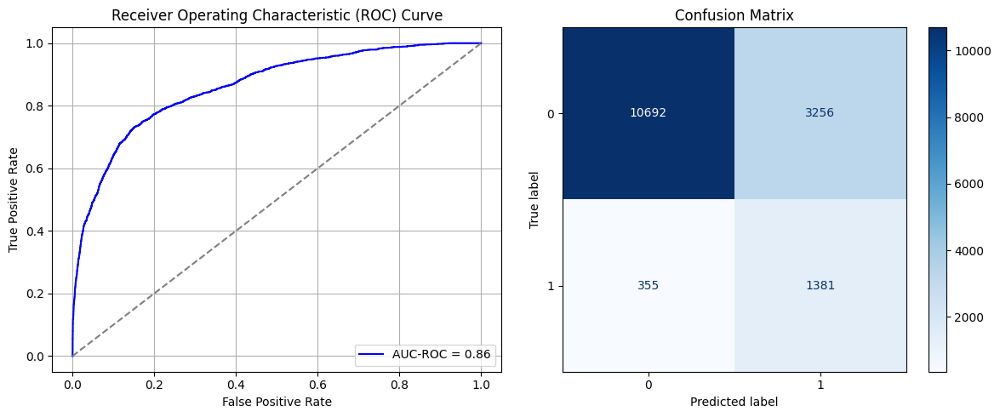

Best threshold based on F1-score: 0.7142621278762817
False Negative Rate: 0.20449308755760368
Time elapsed (performance): 1.7139220549997845
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7281 - loss: 0.6180 - val_AUC: 0.8599 - val_loss: 0.4791
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8570 - loss: 0.4700 - val_AUC: 0.8778 - val_loss: 0.4429
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8684 - loss: 0.4477 - val_AUC: 0.8795 - val_loss: 0.4477
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8742 - loss: 0.4365 - val_AUC: 0.8818 - val_loss: 0.4270
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8707 - loss: 0.4412 - val_AUC: 0.8827 - val_loss: 0.4250
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8765 - loss: 0.4331 - val_AUC: 0.8836 - val_loss: 0.4236
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8770 - loss: 0.4338 - val_AUC: 0.8815 - val_loss: 0.4277
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8796 - loss: 0.4305 - val_AUC: 0.8848 - val_loss: 0.4247
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8793 -

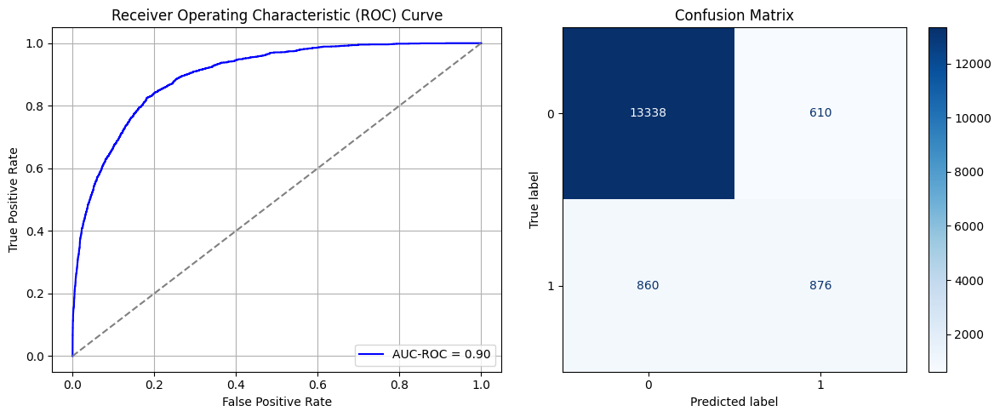

Best threshold based on F1-score: 0.4528995454311371
False Negative Rate: 0.49539170506912444
Time elapsed (performance): 1.727750415999708
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7415 - loss: 0.6154 - val_AUC: 0.8594 - val_loss: 0.4707
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8609 - loss: 0.4644 - val_AUC: 0.8769 - val_loss: 0.4385
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8694 - loss: 0.4461 - val_AUC: 0.8796 - val_loss: 0.4333
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8774 - loss: 0.4322 - val_AUC: 0.8802 - val_loss: 0.4319
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8764 - loss: 0.4361 - val_AUC: 0.8817 - val_loss: 0.4344
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8767 - loss: 0.4338 - val_AUC: 0.8809 - val_loss: 0.4362
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8752 - loss: 0.4381 - val_AUC: 0.8821 - val_loss: 0.4362
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8779 - loss: 0.4328 - val_AUC: 0.8814 - val_loss: 0.4354
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8764 -

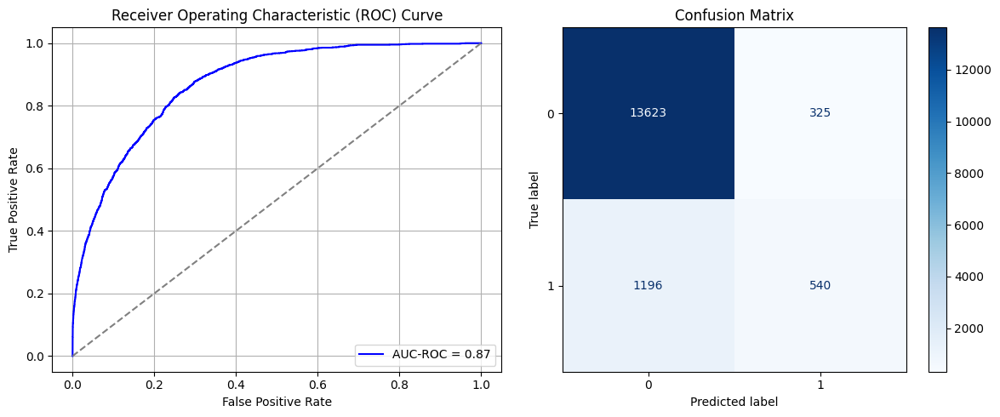

Best threshold based on F1-score: 0.3275015652179718
False Negative Rate: 0.6889400921658986
Time elapsed (performance): 1.3813442390001
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7228 - loss: 0.6191 - val_AUC: 0.8562 - val_loss: 0.4942
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8593 - loss: 0.4668 - val_AUC: 0.8719 - val_loss: 0.4452
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8700 - loss: 0.4424 - val_AUC: 0.8765 - val_loss: 0.4380
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8763 - loss: 0.4361 - val_AUC: 0.8764 - val_loss: 0.4368
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8758 - loss: 0.4364 - val_AUC: 0.8763 - val_loss: 0.4456
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8805 - loss: 0.4274 - val_AUC: 0.8772 - val_loss: 0.4359
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8792 - loss: 0.4299 - val_AUC: 0.8761 - val_loss: 0.4413
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8827 - loss: 0.4231 - val_AUC: 0.8777 - val_loss: 0.4365
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8829 -

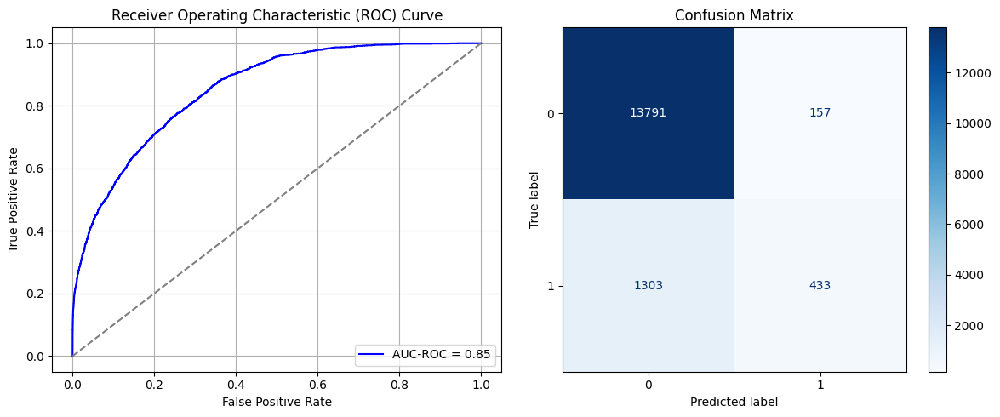

Best threshold based on F1-score: 0.24817462265491486
False Negative Rate: 0.7505760368663594
Time elapsed (performance): 1.403218671999639
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7448 - loss: 0.6094 - val_AUC: 0.8682 - val_loss: 0.4665
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8635 - loss: 0.4569 - val_AUC: 0.8744 - val_loss: 0.4390
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8701 - loss: 0.4421 - val_AUC: 0.8775 - val_loss: 0.4347
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8811 - loss: 0.4279 - val_AUC: 0.8788 - val_loss: 0.4339
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8781 - loss: 0.4321 - val_AUC: 0.8784 - val_loss: 0.4335
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8761 - loss: 0.4348 - val_AUC: 0.8797 - val_loss: 0.4354
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8778 - loss: 0.4322 - val_AUC: 0.8795 - val_loss: 0.4311
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8814 - loss: 0.4260 - val_AUC: 0.8788 - val_loss: 0.4342
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8800 -

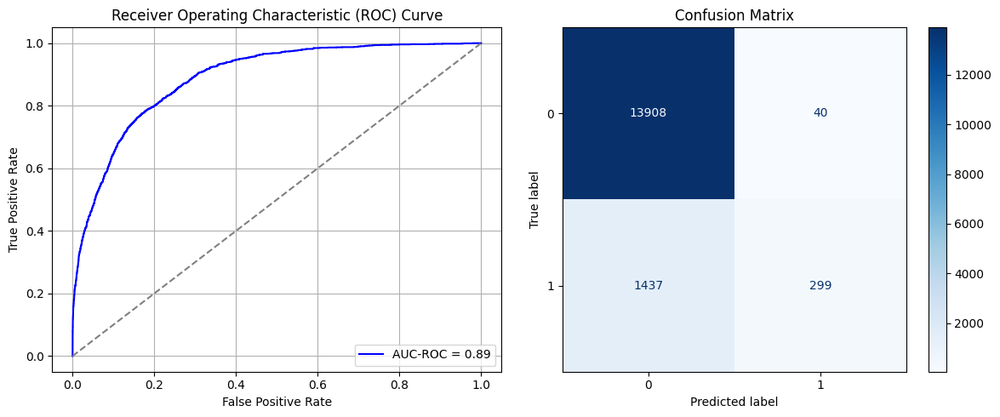

Best threshold based on F1-score: 0.10365042835474014
False Negative Rate: 0.8277649769585254
Time elapsed (performance): 1.6866298820000338
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7530 - loss: 0.6057 - val_AUC: 0.8628 - val_loss: 0.4729
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8607 - loss: 0.4638 - val_AUC: 0.8741 - val_loss: 0.4435
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8669 - loss: 0.4492 - val_AUC: 0.8767 - val_loss: 0.4381
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8726 - loss: 0.4391 - val_AUC: 0.8776 - val_loss: 0.4388
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8810 - loss: 0.4273 - val_AUC: 0.8756 - val_loss: 0.4424
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8710 - loss: 0.4414 - val_AUC: 0.8773 - val_loss: 0.4359
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8668 - loss: 0.4478 - val_AUC: 0.8769 - val_loss: 0.4354
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8759 - loss: 0.4343 - val_AUC: 0.8764 - val_loss: 0.4391
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8713 -

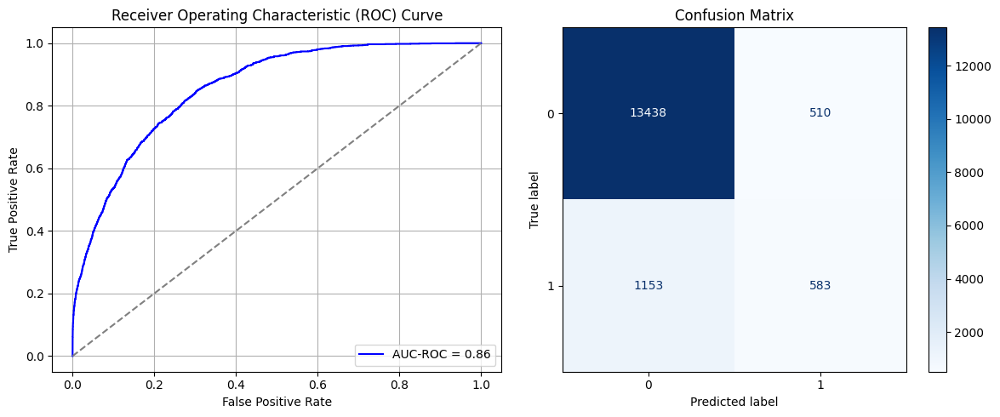

Best threshold based on F1-score: 0.2627878785133362
False Negative Rate: 0.6641705069124424
Time elapsed (performance): 1.4071823630001745
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7175 - loss: 0.6192 - val_AUC: 0.8563 - val_loss: 0.4774
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8550 - loss: 0.4705 - val_AUC: 0.8727 - val_loss: 0.4497
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8748 - loss: 0.4369 - val_AUC: 0.8771 - val_loss: 0.4382
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8714 - loss: 0.4429 - val_AUC: 0.8771 - val_loss: 0.4370
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8755 - loss: 0.4358 - val_AUC: 0.8789 - val_loss: 0.4326
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8806 - loss: 0.4262 - val_AUC: 0.8796 - val_loss: 0.4464
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8818 - loss: 0.4247 - val_AUC: 0.8794 - val_loss: 0.4314
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8780 - loss: 0.4298 - val_AUC: 0.8786 - val_loss: 0.4480
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8838 -

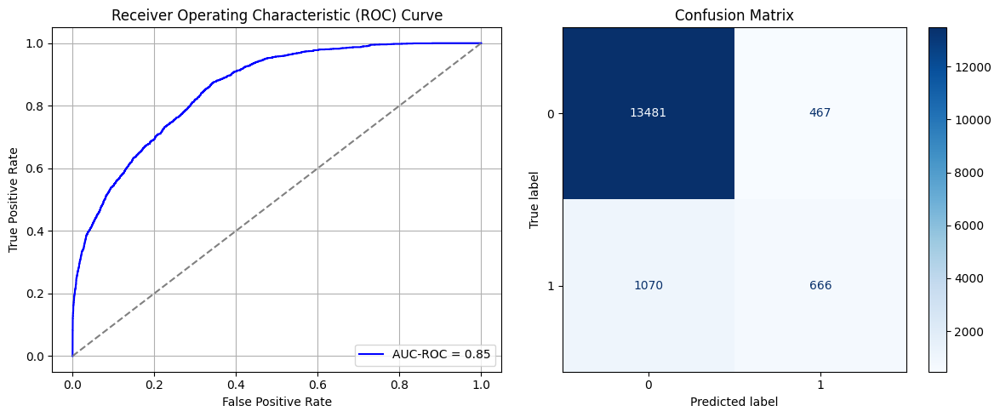

Best threshold based on F1-score: 0.35683876276016235
False Negative Rate: 0.6163594470046083
Time elapsed (performance): 1.7573298760003127
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7387 - loss: 0.6106 - val_AUC: 0.8611 - val_loss: 0.4668
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8602 - loss: 0.4617 - val_AUC: 0.8744 - val_loss: 0.4436
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8716 - loss: 0.4440 - val_AUC: 0.8776 - val_loss: 0.4334
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8753 - loss: 0.4368 - val_AUC: 0.8792 - val_loss: 0.4513
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8802 - loss: 0.4326 - val_AUC: 0.8788 - val_loss: 0.4320
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8770 - loss: 0.4336 - val_AUC: 0.8797 - val_loss: 0.4530
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8779 - loss: 0.4341 - val_AUC: 0.8799 - val_loss: 0.4363
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8853 - loss: 0.4210 - val_AUC: 0.8805 - val_loss: 0.4303
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8793 -

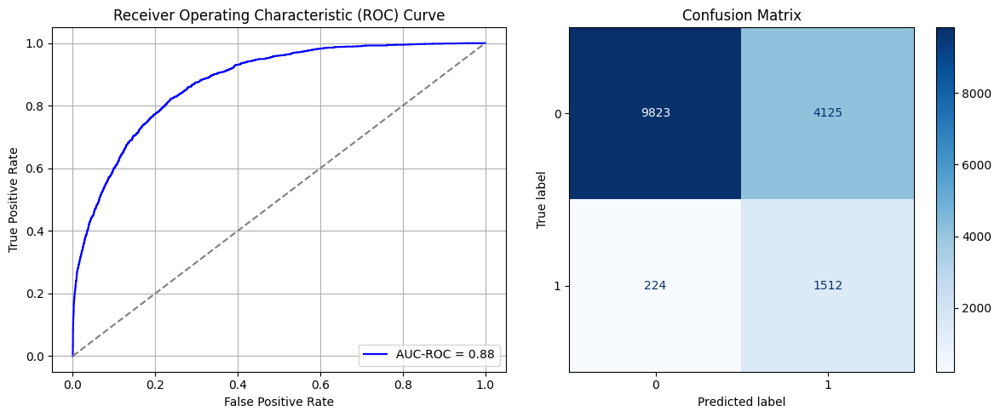

Best threshold based on F1-score: 0.7454653382301331
False Negative Rate: 0.12903225806451613
Time elapsed (performance): 1.880746987999828
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.7250 - loss: 0.6191 - val_AUC: 0.8485 - val_loss: 0.4961
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8534 - loss: 0.4731 - val_AUC: 0.8712 - val_loss: 0.4540
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8627 - loss: 0.4558 - val_AUC: 0.8719 - val_loss: 0.4545
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8718 - loss: 0.4400 - val_AUC: 0.8745 - val_loss: 0.4416
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8751 - loss: 0.4343 - val_AUC: 0.8748 - val_loss: 0.4703
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8733 - loss: 0.4402 - val_AUC: 0.8755 - val_loss: 0.4403
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8783 - loss: 0.4303 - val_AUC: 0.8747 - val_loss: 0.4470
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8771 - loss: 0.4332 - val_AUC: 0.8773 - val_loss: 0.4350
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8794 -

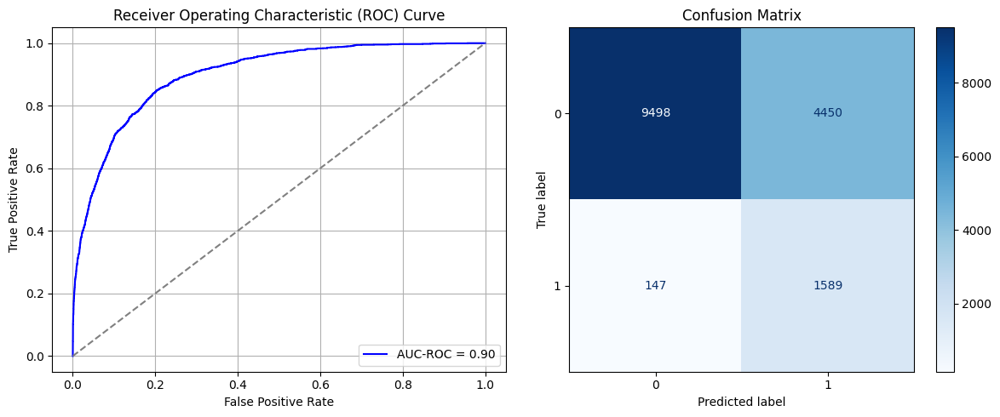

Best threshold based on F1-score: 0.7062788605690002
False Negative Rate: 0.0846774193548387
Time elapsed (performance): 1.911501398999917
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 5s 9ms/step - AUC: 0.7321 - loss: 0.6166 - val_AUC: 0.8594 - val_loss: 0.4759
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8519 - loss: 0.4760 - val_AUC: 0.8726 - val_loss: 0.4462
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8758 - loss: 0.4356 - val_AUC: 0.8751 - val_loss: 0.4388
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8757 - loss: 0.4355 - val_AUC: 0.8769 - val_loss: 0.4361
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - AUC: 0.8706 - loss: 0.4442 - val_AUC: 0.8767 - val_loss: 0.4367
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8794 - loss: 0.4314 - val_AUC: 0.8761 - val_loss: 0.4368
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8780 - loss: 0.4313 - val_AUC: 0.8765 - val_loss: 0.4608
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8762 - loss: 0.4339 - val_AUC: 0.8787 - val_loss: 0.4365
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8793 -

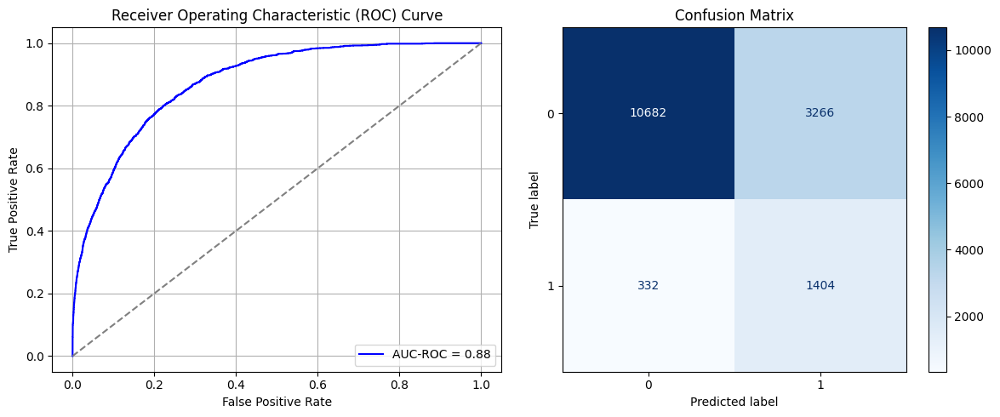

Best threshold based on F1-score: 0.6462582349777222
False Negative Rate: 0.1912442396313364
Time elapsed (performance): 3.0613382400001683
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7476 - loss: 0.6108 - val_AUC: 0.8463 - val_loss: 0.4928
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8567 - loss: 0.4700 - val_AUC: 0.8694 - val_loss: 0.4686
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8693 - loss: 0.4434 - val_AUC: 0.8709 - val_loss: 0.4474
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8778 - loss: 0.4308 - val_AUC: 0.8738 - val_loss: 0.4434
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8715 - loss: 0.4396 - val_AUC: 0.8744 - val_loss: 0.4449
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8735 - loss: 0.4360 - val_AUC: 0.8736 - val_loss: 0.4566
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8805 - loss: 0.4261 - val_AUC: 0.8752 - val_loss: 0.4437
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8795 - loss: 0.4273 - val_AUC: 0.8749 - val_loss: 0.4414
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8796 -

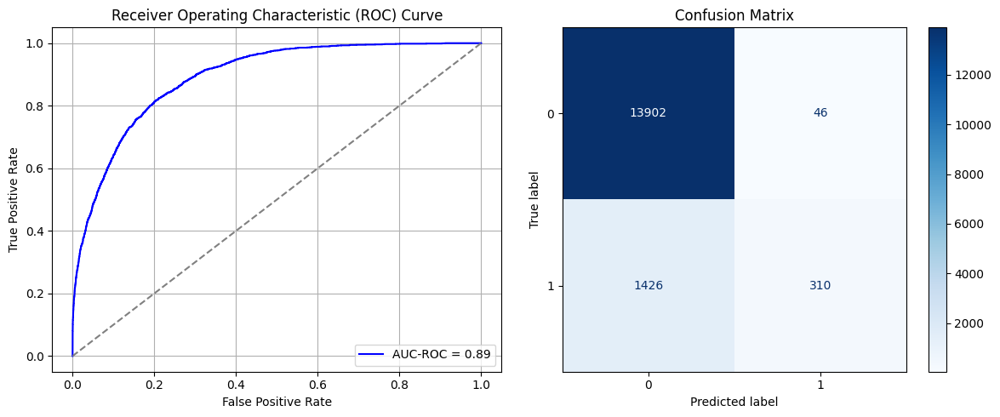

Best threshold based on F1-score: 0.06686120480298996
False Negative Rate: 0.8214285714285714
Time elapsed (performance): 1.725793375000194
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.7165 - loss: 0.6186 - val_AUC: 0.8502 - val_loss: 0.4807
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8533 - loss: 0.4737 - val_AUC: 0.8742 - val_loss: 0.4419
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8735 - loss: 0.4412 - val_AUC: 0.8792 - val_loss: 0.4429
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - AUC: 0.8748 - loss: 0.4386 - val_AUC: 0.8796 - val_loss: 0.4314
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8724 - loss: 0.4419 - val_AUC: 0.8803 - val_loss: 0.4312
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8739 - loss: 0.4380 - val_AUC: 0.8801 - val_loss: 0.4327
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8759 - loss: 0.4339 - val_AUC: 0.8797 - val_loss: 0.4296
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8815 - loss: 0.4264 - val_AUC: 0.8801 - val_loss: 0.4297
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8747 -

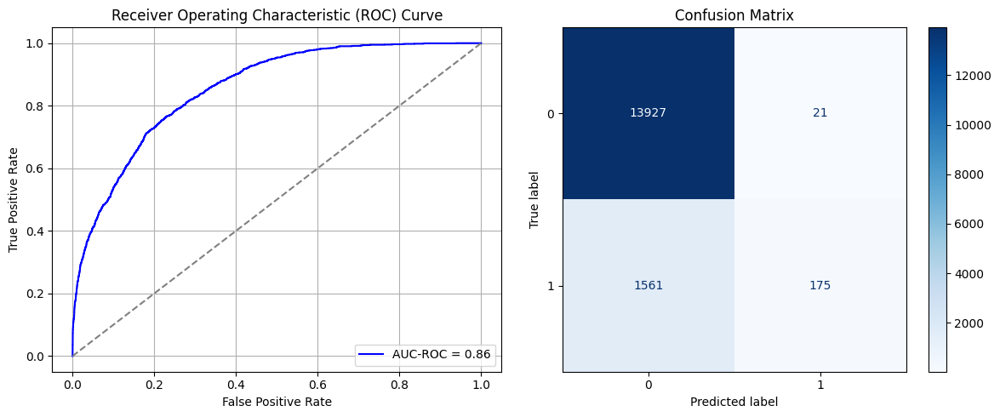

Best threshold based on F1-score: 0.0815541222691536
False Negative Rate: 0.8991935483870968
Time elapsed (performance): 1.7402422410000327
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.7401 - loss: 0.6181 - val_AUC: 0.8578 - val_loss: 0.4774
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8545 - loss: 0.4730 - val_AUC: 0.8740 - val_loss: 0.4410
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8690 - loss: 0.4463 - val_AUC: 0.8758 - val_loss: 0.4374
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8742 - loss: 0.4384 - val_AUC: 0.8770 - val_loss: 0.4352
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8708 - loss: 0.4412 - val_AUC: 0.8771 - val_loss: 0.4350
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8767 - loss: 0.4315 - val_AUC: 0.8784 - val_loss: 0.4385
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8766 - loss: 0.4332 - val_AUC: 0.8769 - val_loss: 0.4426
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8749 - loss: 0.4373 - val_AUC: 0.8784 - val_loss: 0.4360
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8788 -

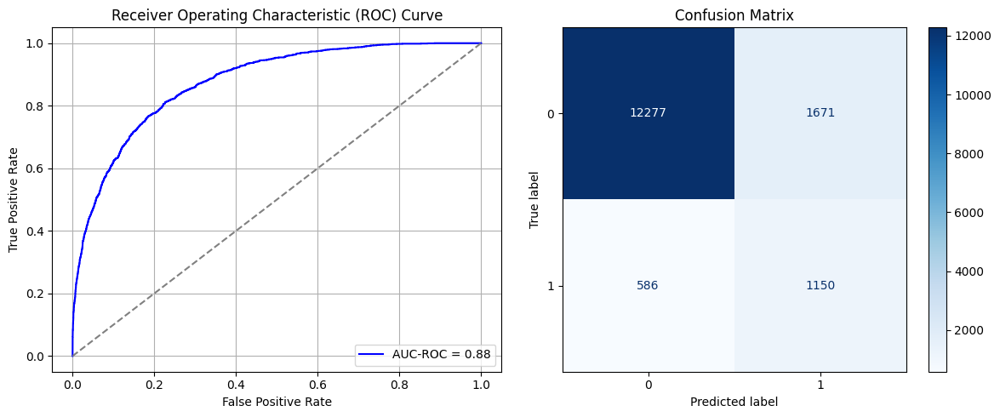

Best threshold based on F1-score: 0.5714026093482971
False Negative Rate: 0.33755760368663595
Time elapsed (performance): 1.7212159720002091
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.6937 - loss: 0.6302 - val_AUC: 0.8472 - val_loss: 0.4860
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8542 - loss: 0.4740 - val_AUC: 0.8730 - val_loss: 0.4438
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8682 - loss: 0.4494 - val_AUC: 0.8737 - val_loss: 0.4402
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8728 - loss: 0.4420 - val_AUC: 0.8744 - val_loss: 0.4406
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8720 - loss: 0.4404 - val_AUC: 0.8791 - val_loss: 0.4463
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8683 - loss: 0.4499 - val_AUC: 0.8781 - val_loss: 0.4341
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8720 - loss: 0.4433 - val_AUC: 0.8786 - val_loss: 0.4316
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8768 - loss: 0.4363 - val_AUC: 0.8789 - val_loss: 0.4342
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8691 -

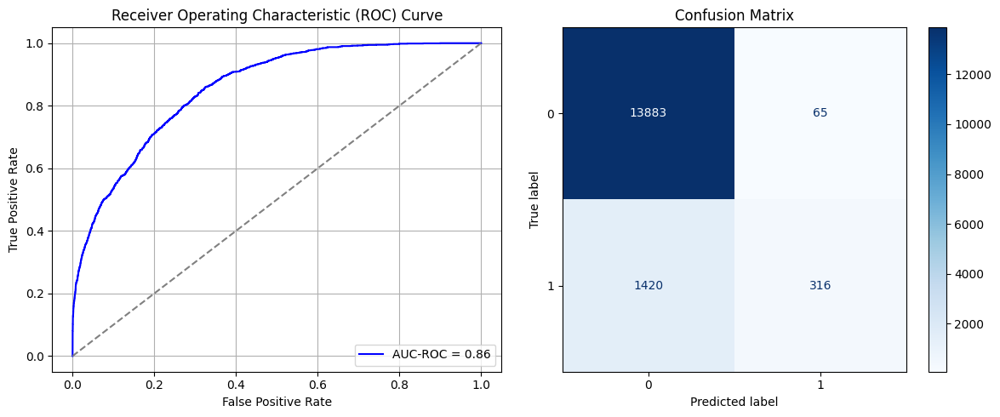

Best threshold based on F1-score: 0.1578054130077362
False Negative Rate: 0.8179723502304147
Time elapsed (performance): 1.7657642139997733
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7522 - loss: 0.6093 - val_AUC: 0.8680 - val_loss: 0.4626
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8542 - loss: 0.4718 - val_AUC: 0.8820 - val_loss: 0.4356
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8720 - loss: 0.4419 - val_AUC: 0.8843 - val_loss: 0.4421
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8686 - loss: 0.4467 - val_AUC: 0.8832 - val_loss: 0.4310
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8730 - loss: 0.4381 - val_AUC: 0.8842 - val_loss: 0.4254
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8793 - loss: 0.4284 - val_AUC: 0.8837 - val_loss: 0.4265
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8716 - loss: 0.4393 - val_AUC: 0.8851 - val_loss: 0.4250
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8772 - loss: 0.4316 - val_AUC: 0.8851 - val_loss: 0.4267
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8772 -

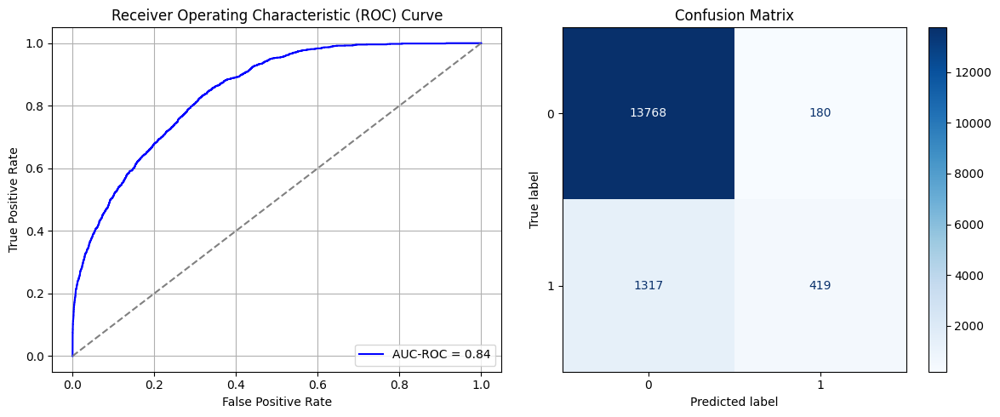

Best threshold based on F1-score: 0.1702435463666916
False Negative Rate: 0.7586405529953917
Time elapsed (performance): 1.7057675070000187
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7129 - loss: 0.6232 - val_AUC: 0.8514 - val_loss: 0.4853
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8576 - loss: 0.4671 - val_AUC: 0.8690 - val_loss: 0.4548
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8725 - loss: 0.4426 - val_AUC: 0.8722 - val_loss: 0.4445
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8810 - loss: 0.4281 - val_AUC: 0.8737 - val_loss: 0.4401
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8792 - loss: 0.4297 - val_AUC: 0.8740 - val_loss: 0.4421
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8789 - loss: 0.4319 - val_AUC: 0.8743 - val_loss: 0.4565
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8778 - loss: 0.4309 - val_AUC: 0.8725 - val_loss: 0.4482
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8837 - loss: 0.4224 - val_AUC: 0.8737 - val_loss: 0.4399
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8768 -

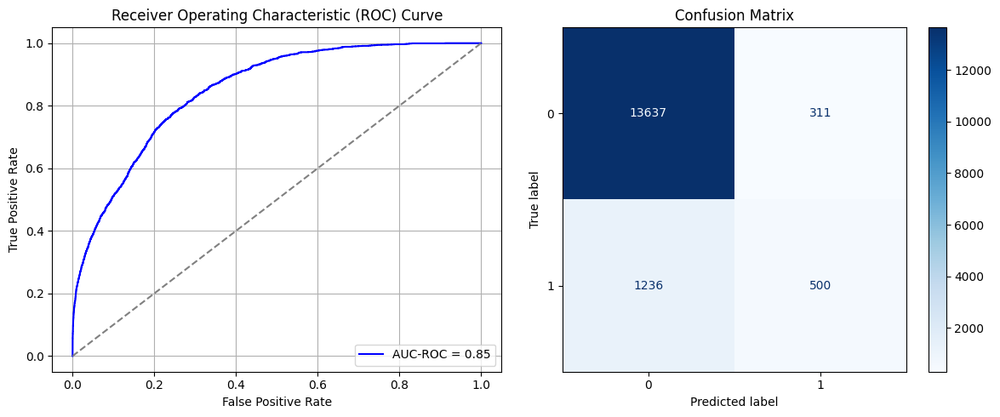

Best threshold based on F1-score: 0.2629961371421814
False Negative Rate: 0.7119815668202765
Time elapsed (performance): 1.5059451279998939
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7288 - loss: 0.6230 - val_AUC: 0.8450 - val_loss: 0.4951
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8492 - loss: 0.4809 - val_AUC: 0.8682 - val_loss: 0.4606
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8639 - loss: 0.4543 - val_AUC: 0.8709 - val_loss: 0.4435
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8727 - loss: 0.4365 - val_AUC: 0.8716 - val_loss: 0.4438
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8703 - loss: 0.4433 - val_AUC: 0.8765 - val_loss: 0.4338
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8678 - loss: 0.4477 - val_AUC: 0.8748 - val_loss: 0.4357
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8747 - loss: 0.4366 - val_AUC: 0.8752 - val_loss: 0.4460
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8719 - loss: 0.4402 - val_AUC: 0.8755 - val_loss: 0.4346
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8770 -

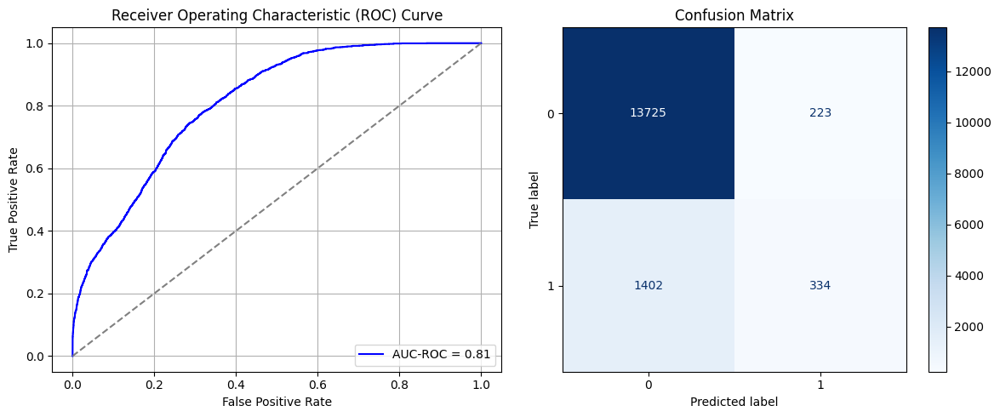

Best threshold based on F1-score: 0.06551879644393921
False Negative Rate: 0.8076036866359447
Time elapsed (performance): 1.5617732709997654
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7320 - loss: 0.6118 - val_AUC: 0.8630 - val_loss: 0.4798
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8542 - loss: 0.4699 - val_AUC: 0.8762 - val_loss: 0.4461
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8707 - loss: 0.4429 - val_AUC: 0.8772 - val_loss: 0.4402
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8777 - loss: 0.4319 - val_AUC: 0.8783 - val_loss: 0.4343
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8717 - loss: 0.4393 - val_AUC: 0.8790 - val_loss: 0.4385
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8750 - loss: 0.4368 - val_AUC: 0.8784 - val_loss: 0.4560
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8729 - loss: 0.4410 - val_AUC: 0.8805 - val_loss: 0.4301
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8750 - loss: 0.4340 - val_AUC: 0.8799 - val_loss: 0.4299
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8812 -

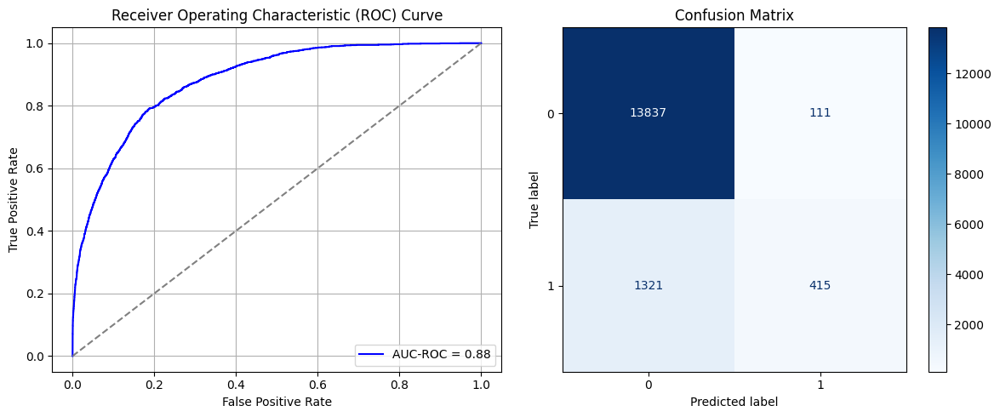

Best threshold based on F1-score: 0.1562533676624298
False Negative Rate: 0.7609447004608295
Time elapsed (performance): 1.985085490000074
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.7253 - loss: 0.6118 - val_AUC: 0.8618 - val_loss: 0.4699
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8631 - loss: 0.4625 - val_AUC: 0.8758 - val_loss: 0.4417
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8662 - loss: 0.4515 - val_AUC: 0.8777 - val_loss: 0.4366
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8689 - loss: 0.4461 - val_AUC: 0.8786 - val_loss: 0.4342
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8758 - loss: 0.4331 - val_AUC: 0.8784 - val_loss: 0.4370
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8721 - loss: 0.4414 - val_AUC: 0.8794 - val_loss: 0.4334
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8709 - loss: 0.4425 - val_AUC: 0.8800 - val_loss: 0.4284
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8803 - loss: 0.4274 - val_AUC: 0.8807 - val_loss: 0.4279
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8735 -

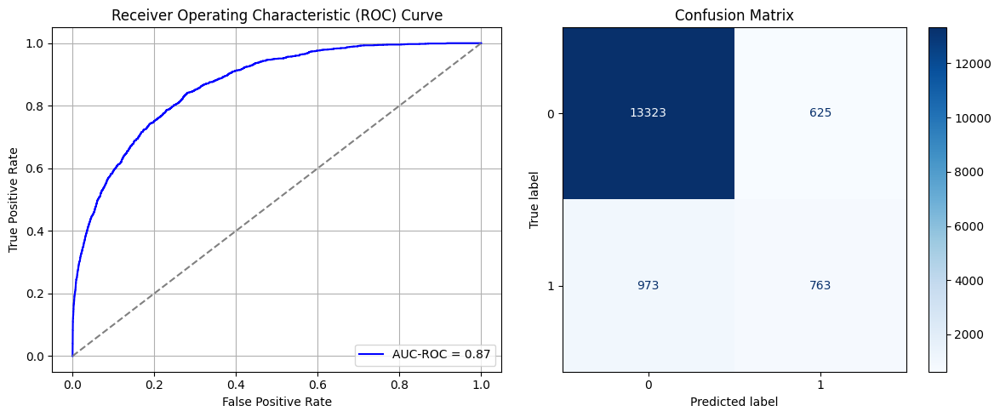

Best threshold based on F1-score: 0.4115554392337799
False Negative Rate: 0.5604838709677419
Time elapsed (performance): 1.7197129590003897
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7294 - loss: 0.6125 - val_AUC: 0.8678 - val_loss: 0.4607
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8677 - loss: 0.4516 - val_AUC: 0.8798 - val_loss: 0.4330
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8693 - loss: 0.4455 - val_AUC: 0.8798 - val_loss: 0.4333
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8736 - loss: 0.4378 - val_AUC: 0.8824 - val_loss: 0.4317
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8712 - loss: 0.4413 - val_AUC: 0.8828 - val_loss: 0.4341
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8762 - loss: 0.4340 - val_AUC: 0.8798 - val_loss: 0.4358
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8845 - loss: 0.4205 - val_AUC: 0.8822 - val_loss: 0.4284
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8777 - loss: 0.4302 - val_AUC: 0.8826 - val_loss: 0.4280
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8836 -

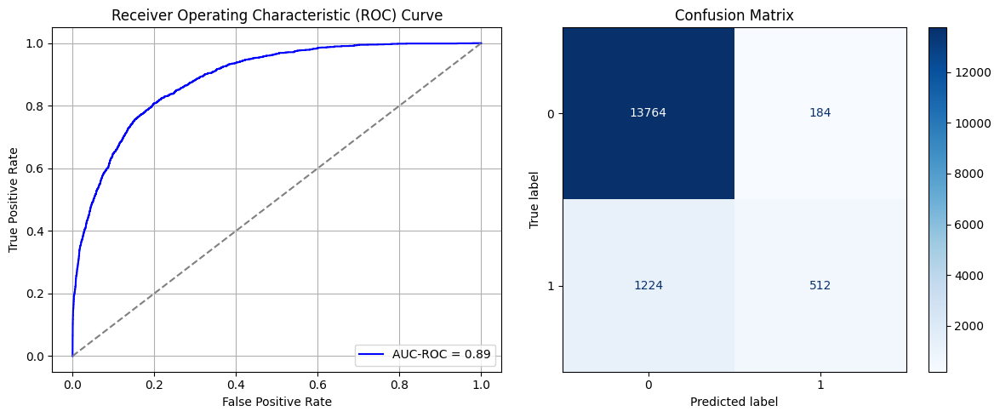

Best threshold based on F1-score: 0.21302801370620728
False Negative Rate: 0.7050691244239631
Time elapsed (performance): 1.7015529939999396
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7365 - loss: 0.6213 - val_AUC: 0.8689 - val_loss: 0.4687
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8655 - loss: 0.4586 - val_AUC: 0.8795 - val_loss: 0.4303
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8726 - loss: 0.4420 - val_AUC: 0.8821 - val_loss: 0.4261
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8766 - loss: 0.4344 - val_AUC: 0.8819 - val_loss: 0.4281
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8804 - loss: 0.4294 - val_AUC: 0.8831 - val_loss: 0.4248
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8801 - loss: 0.4298 - val_AUC: 0.8829 - val_loss: 0.4258
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8793 - loss: 0.4309 - val_AUC: 0.8839 - val_loss: 0.4277
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8723 - loss: 0.4397 - val_AUC: 0.8823 - val_loss: 0.4257
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8830 -

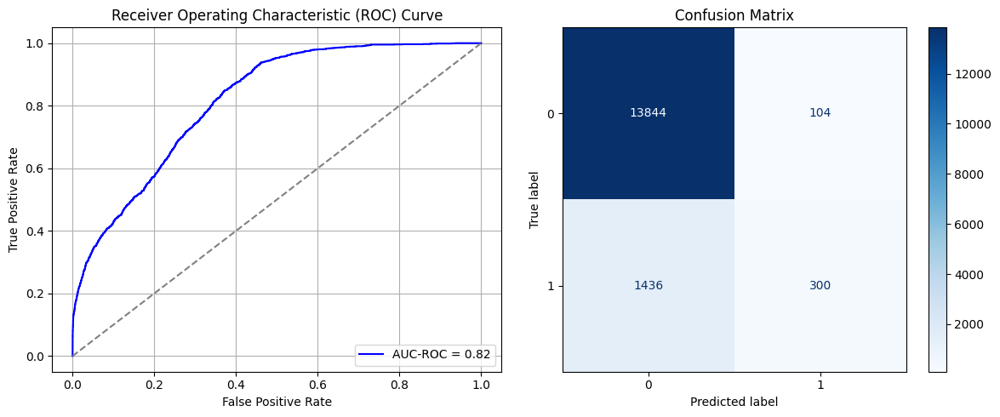

Best threshold based on F1-score: 0.199629008769989
False Negative Rate: 0.8271889400921659
Time elapsed (performance): 1.5029698919997827
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7454 - loss: 0.6030 - val_AUC: 0.8610 - val_loss: 0.4705
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8645 - loss: 0.4592 - val_AUC: 0.8798 - val_loss: 0.4336
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8755 - loss: 0.4375 - val_AUC: 0.8811 - val_loss: 0.4288
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8765 - loss: 0.4356 - val_AUC: 0.8826 - val_loss: 0.4275
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8814 - loss: 0.4268 - val_AUC: 0.8822 - val_loss: 0.4278
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8703 - loss: 0.4433 - val_AUC: 0.8838 - val_loss: 0.4279
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8788 - loss: 0.4314 - val_AUC: 0.8838 - val_loss: 0.4233
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8800 - loss: 0.4295 - val_AUC: 0.8852 - val_loss: 0.4269
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8793 -

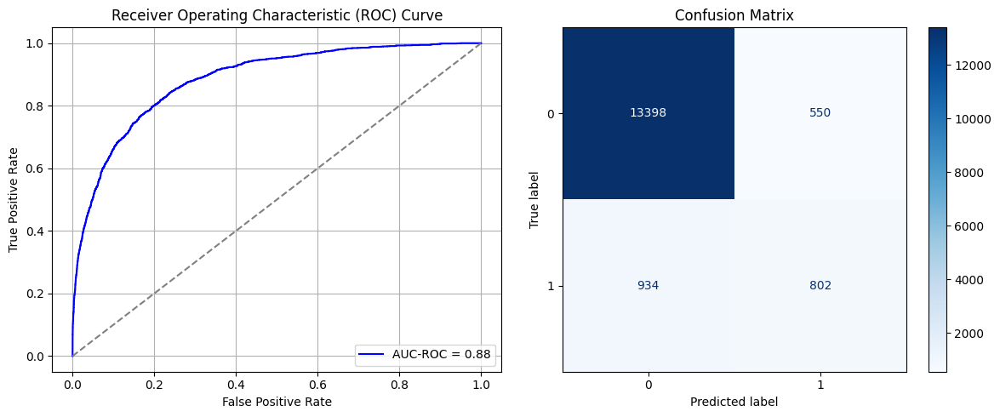

Best threshold based on F1-score: 0.3685292899608612
False Negative Rate: 0.5380184331797235
Time elapsed (performance): 1.5140859830003137
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.7278 - loss: 0.6124 - val_AUC: 0.8523 - val_loss: 0.4791
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8652 - loss: 0.4584 - val_AUC: 0.8680 - val_loss: 0.4513
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8744 - loss: 0.4394 - val_AUC: 0.8735 - val_loss: 0.4408
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8767 - loss: 0.4340 - val_AUC: 0.8750 - val_loss: 0.4397
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8754 - loss: 0.4372 - val_AUC: 0.8743 - val_loss: 0.4391
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8800 - loss: 0.4304 - val_AUC: 0.8738 - val_loss: 0.4458
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8813 - loss: 0.4264 - val_AUC: 0.8751 - val_loss: 0.4437
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8797 - loss: 0.4300 - val_AUC: 0.8772 - val_loss: 0.4340
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8819 -

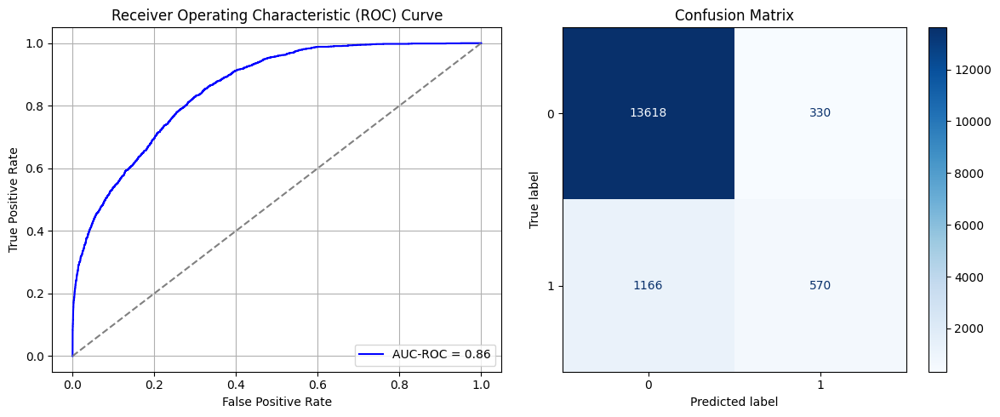

Best threshold based on F1-score: 0.353009968996048
False Negative Rate: 0.6716589861751152
Time elapsed (performance): 1.552134001000013
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.6987 - loss: 0.6233 - val_AUC: 0.8462 - val_loss: 0.4879
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8528 - loss: 0.4766 - val_AUC: 0.8678 - val_loss: 0.4507
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8734 - loss: 0.4390 - val_AUC: 0.8697 - val_loss: 0.4449
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8703 - loss: 0.4447 - val_AUC: 0.8702 - val_loss: 0.4452
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8717 - loss: 0.4419 - val_AUC: 0.8713 - val_loss: 0.4421
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8759 - loss: 0.4362 - val_AUC: 0.8723 - val_loss: 0.4426
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8718 - loss: 0.4427 - val_AUC: 0.8736 - val_loss: 0.4401
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8793 - loss: 0.4290 - val_AUC: 0.8720 - val_loss: 0.4432
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8730 -

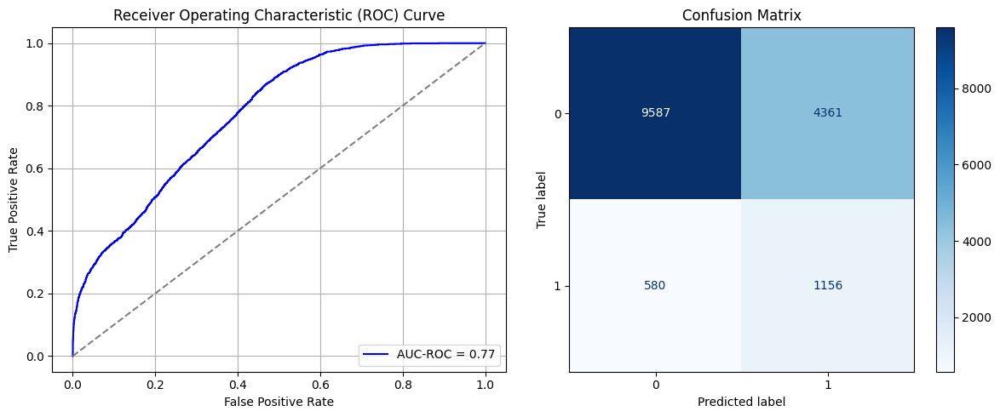

Best threshold based on F1-score: 0.8303465843200684
False Negative Rate: 0.33410138248847926
Time elapsed (performance): 1.694971343999896


In [44]:
times = 50

Training_time = []
FPR = []
TPR = []
FNR = []
TNR = []
TL_time = []


for i in range(times):
    data_S_maj_rus = data_S_majority.sample(n=undersample_size, replace=True)
    data_S_SRSwR_RUS = pd.concat([data_S_maj_rus, data_S_minority])
    X_S_SRSwR = data_S_SRSwR_RUS.iloc[:, :-1]
    y_S_SRSwR = data_S_SRSwR_RUS.iloc[:, -1]
    X_S_train, X_S_test, y_S_train, y_S_test = train_test_split(X_S_SRSwR, y_S_SRSwR, test_size=0.20, random_state=0)
    model_SRSwR = create_dnn_model(X_S_train.shape[1])
    result_SRSwR = train_and_evaluate(model_SRSwR, X_S_train, X_S_test, y_S_train, y_S_test, "Source")
    result_TL_SRSwR = Transductive_TL(model_SRSwR, X_T_full, y_T_full, "Target")

    Training_time.append(result_SRSwR)
    FPR.append(result_TL_SRSwR[0])
    TNR.append(result_TL_SRSwR[1])
    FNR.append(result_TL_SRSwR[2])
    TPR.append(result_TL_SRSwR[3])
    TL_time.append(result_TL_SRSwR[4])

ParamFit = pd.DataFrame([Training_time, FPR, TNR, FNR, TPR, TL_time]).T
ParamFit.columns=['Source time', 'FPR', 'TNR', 'FNR', 'TPR', 'Target time']
# print(ParamFit)

In [48]:
print(ParamFit)
ParamFit.to_csv('SRSwR_RUS.csv')

    Source time       FPR       TNR       FNR       TPR  Target time
0     17.621765  0.005736  0.994264  0.819700  0.180300     1.879814
1     16.988914  0.005449  0.994551  0.834101  0.165899     1.174202
2     17.220804  0.021150  0.978850  0.788018  0.211982     1.692667
3     16.041767  0.024806  0.975194  0.669931  0.330069     1.689804
4     17.284752  0.022225  0.977775  0.714286  0.285714     1.854963
5     18.866489  0.049685  0.950315  0.586406  0.413594     1.699012
6     21.096348  0.007241  0.992759  0.780530  0.219470     1.234814
7     21.415444  0.002366  0.997634  0.854263  0.145737     3.031849
8     21.150668  0.009751  0.990249  0.804147  0.195853     1.713028
9     23.431797  0.011543  0.988457  0.748272  0.251728     1.297113
10    20.660745  0.037281  0.962719  0.668203  0.331797     1.886851
11    23.942449  0.012260  0.987740  0.747120  0.252880     2.008171
12    24.434000  0.015701  0.984299  0.679724  0.320276     3.049058
13    24.265964  0.000645  0.99935

In [46]:
ParamFit['FNR'].mean()

np.float64(0.6294930875576037)

In [47]:
ParamFit['Source time'].mean()

np.float64(23.725617199239977)

## Systematic Sampling:

First, we select a single systematic sample from the majority class, in which $k = \frac{N_0}{N_1}$, where $N_0$ is the majority class size in the source domain and $N_1$ is the minority class in the source domain.

2.25721570627231
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 5s 7ms/step - AUC: 0.7261 - loss: 0.6189 - val_AUC: 0.8553 - val_loss: 0.4810
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8539 - loss: 0.4751 - val_AUC: 0.8756 - val_loss: 0.4398
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8742 - loss: 0.4404 - val_AUC: 0.8783 - val_loss: 0.4322
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8701 - loss: 0.4440 - val_AUC: 0.8778 - val_loss: 0.4381
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8725 - loss: 0.4403 - val_AUC: 0.8785 - val_loss: 0.4393
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8744 - loss: 0.4377 - val_AUC: 0.8787 - val_loss: 0.4367
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8729 - loss: 0.4389 - val_AUC: 0.8793 - val_loss: 0.4308
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - AUC: 0.8791 - loss: 0.4314 - val_AUC: 0.8783 - val_loss: 0.4311
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step - AUC: 0.8800 -

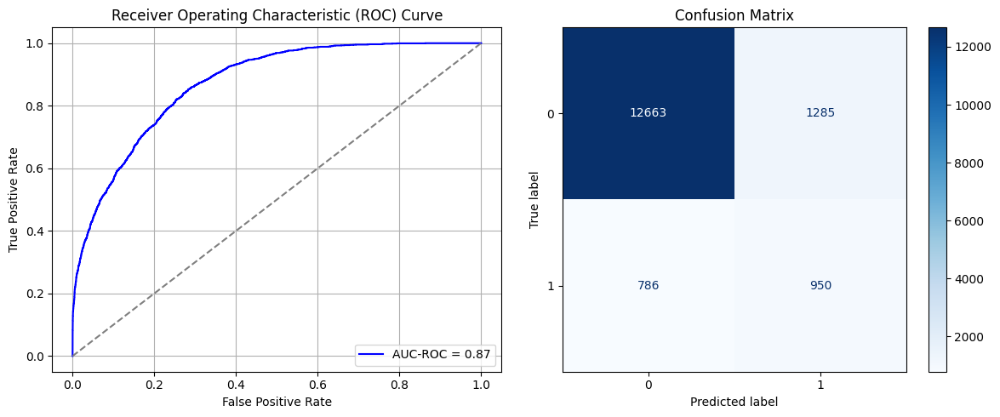

Best threshold based on F1-score: 0.5579286813735962
False Negative Rate: 0.45276497695852536
Time elapsed (performance): 1.200681860000259
(np.float64(0.09212790364209923), np.float64(0.9078720963579008))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7560 - loss: 0.6124 - val_AUC: 0.8652 - val_loss: 0.4640
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8566 - loss: 0.4675 - val_AUC: 0.8760 - val_loss: 0.4365
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8675 - loss: 0.4491 - val_AUC: 0.8776 - val_loss: 0.4400
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8694 - loss: 0.4470 - val_AUC: 0.8773 - val_loss: 0.4604
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8731 - loss: 0.4404 - val_AUC: 0.8780 - val_loss: 0.4354
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8735 - loss: 0.4390 - val_AUC: 0.8790 - val_loss: 0.4687
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8722 - loss: 0.4440 - val_AUC: 0.8787 - val_loss: 0.4327
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8694 - loss: 0.4460 - val_AUC: 0.8786 - val_loss: 0.4312
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8781 -

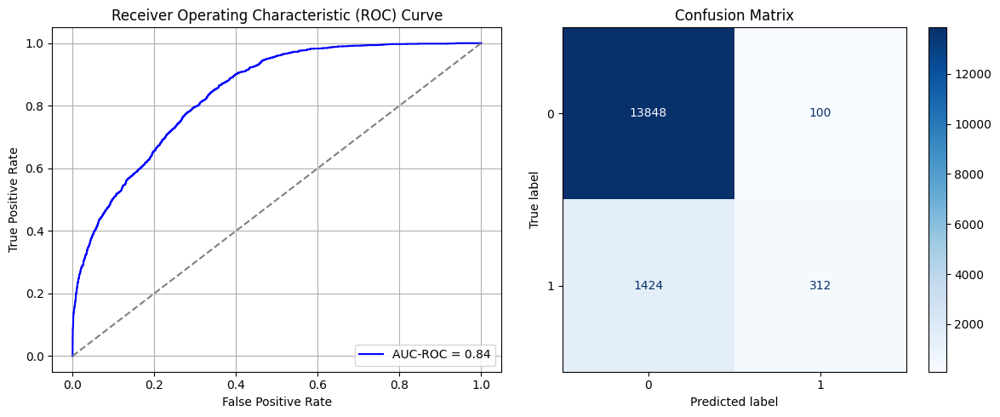

Best threshold based on F1-score: 0.1856175661087036
False Negative Rate: 0.8202764976958525
Time elapsed (performance): 3.100859498999853
(np.float64(0.007169486664754803), np.float64(0.9928305133352452))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7484 - loss: 0.6063 - val_AUC: 0.8502 - val_loss: 0.4849
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8647 - loss: 0.4613 - val_AUC: 0.8661 - val_loss: 0.4520
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8701 - loss: 0.4451 - val_AUC: 0.8685 - val_loss: 0.4640
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8749 - loss: 0.4375 - val_AUC: 0.8720 - val_loss: 0.4449
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8745 - loss: 0.4372 - val_AUC: 0.8704 - val_loss: 0.4430
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8719 - loss: 0.4403 - val_AUC: 0.8727 - val_loss: 0.4427
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8731 - loss: 0.4389 - val_AUC: 0.8703 - val_loss: 0.4446
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8818 - loss: 0.4249 - val_AUC: 0.8698 - val_loss: 0.4443
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8780 -

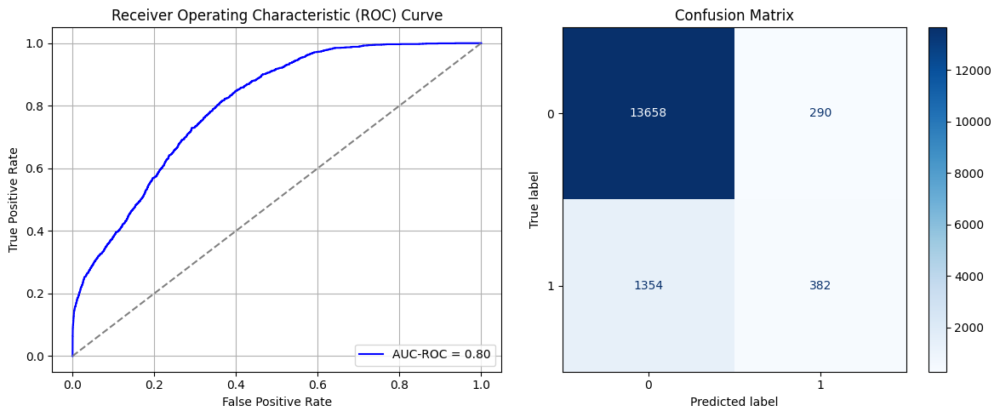

Best threshold based on F1-score: 0.09130234271287918
False Negative Rate: 0.7799539170506913
Time elapsed (performance): 1.7304500099999132
(np.float64(0.02079151132778893), np.float64(0.9792084886722111))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7266 - loss: 0.6184 - val_AUC: 0.8548 - val_loss: 0.4723
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8690 - loss: 0.4531 - val_AUC: 0.8695 - val_loss: 0.4524
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8725 - loss: 0.4433 - val_AUC: 0.8702 - val_loss: 0.4440
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8735 - loss: 0.4401 - val_AUC: 0.8697 - val_loss: 0.4467
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8750 - loss: 0.4356 - val_AUC: 0.8729 - val_loss: 0.4403
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8792 - loss: 0.4317 - val_AUC: 0.8724 - val_loss: 0.4602
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8811 - loss: 0.4294 - val_AUC: 0.8701 - val_loss: 0.4447
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8852 - loss: 0.4219 - val_AUC: 0.8732 - val_loss: 0.4387
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8784 -

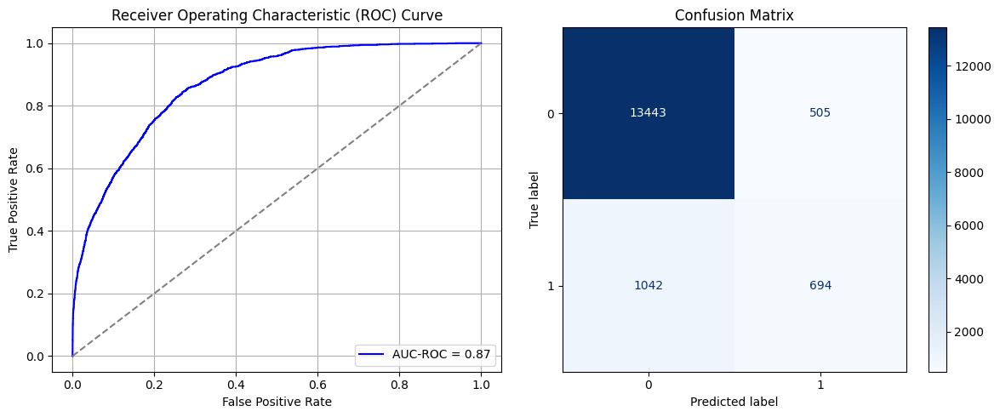

Best threshold based on F1-score: 0.34559503197669983
False Negative Rate: 0.6002304147465438
Time elapsed (performance): 1.7012040310000884
(np.float64(0.03620590765701176), np.float64(0.9637940923429882))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7311 - loss: 0.6195 - val_AUC: 0.8619 - val_loss: 0.4739
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8538 - loss: 0.4729 - val_AUC: 0.8748 - val_loss: 0.4380
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8701 - loss: 0.4447 - val_AUC: 0.8772 - val_loss: 0.4474
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8699 - loss: 0.4450 - val_AUC: 0.8786 - val_loss: 0.4347
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8760 - loss: 0.4367 - val_AUC: 0.8787 - val_loss: 0.4304
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8743 - loss: 0.4376 - val_AUC: 0.8788 - val_loss: 0.4304
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8795 - loss: 0.4311 - val_AUC: 0.8786 - val_loss: 0.4327
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8713 - loss: 0.4428 - val_AUC: 0.8800 - val_loss: 0.4281
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8741 -

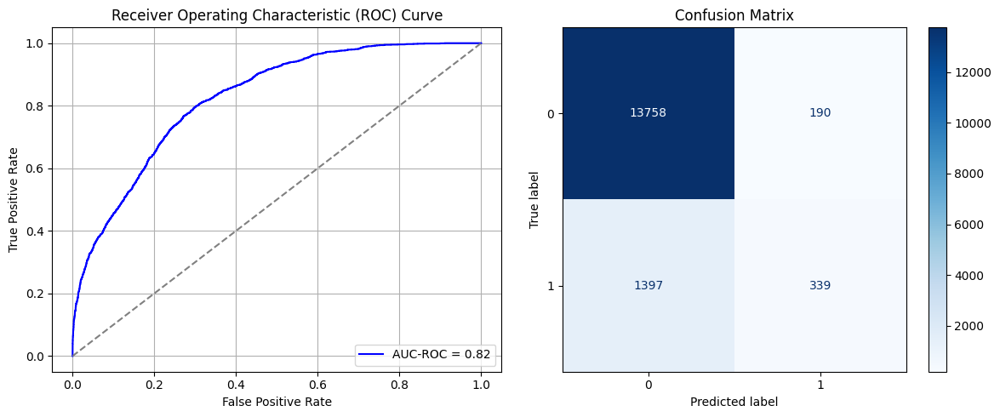

Best threshold based on F1-score: 0.2159554660320282
False Negative Rate: 0.8047235023041475
Time elapsed (performance): 1.3023363519996565
(np.float64(0.013622024663034128), np.float64(0.9863779753369659))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.7496 - loss: 0.6091 - val_AUC: 0.8597 - val_loss: 0.4673
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8670 - loss: 0.4555 - val_AUC: 0.8696 - val_loss: 0.4461
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8778 - loss: 0.4343 - val_AUC: 0.8697 - val_loss: 0.4466
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8749 - loss: 0.4382 - val_AUC: 0.8702 - val_loss: 0.4452
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8725 - loss: 0.4402 - val_AUC: 0.8739 - val_loss: 0.4382
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8758 - loss: 0.4366 - val_AUC: 0.8736 - val_loss: 0.4381
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8772 - loss: 0.4327 - val_AUC: 0.8725 - val_loss: 0.4402
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8779 - loss: 0.4335 - val_AUC: 0.8749 - val_loss: 0.4357
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8737 -

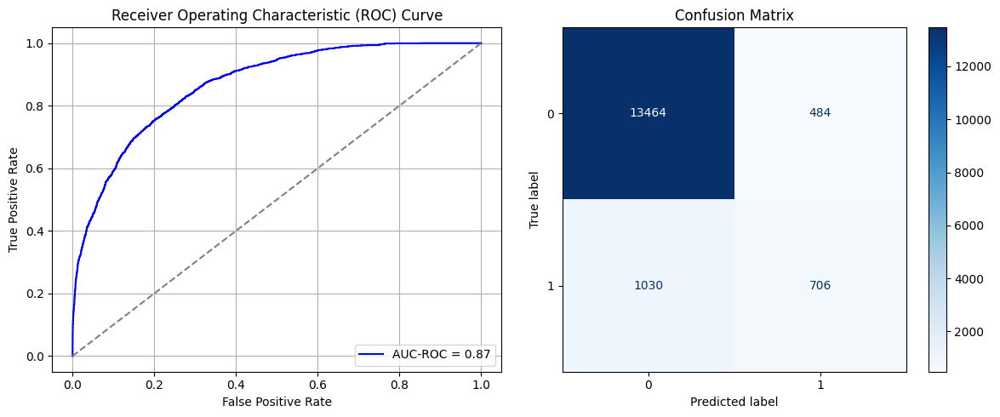

Best threshold based on F1-score: 0.33200234174728394
False Negative Rate: 0.5933179723502304
Time elapsed (performance): 1.8141252870000244
(np.float64(0.03470031545741325), np.float64(0.9652996845425867))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7157 - loss: 0.6240 - val_AUC: 0.8495 - val_loss: 0.4785
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8616 - loss: 0.4623 - val_AUC: 0.8669 - val_loss: 0.4555
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8709 - loss: 0.4442 - val_AUC: 0.8684 - val_loss: 0.4512
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8750 - loss: 0.4384 - val_AUC: 0.8698 - val_loss: 0.4589
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8757 - loss: 0.4361 - val_AUC: 0.8712 - val_loss: 0.4622
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8741 - loss: 0.4363 - val_AUC: 0.8720 - val_loss: 0.4486
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8787 - loss: 0.4313 - val_AUC: 0.8724 - val_loss: 0.4399
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8808 - loss: 0.4287 - val_AUC: 0.8734 - val_loss: 0.4471
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8785 -

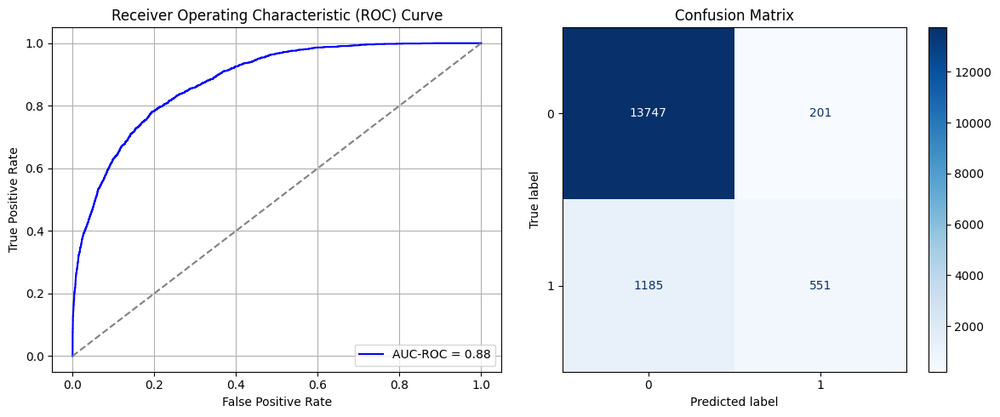

Best threshold based on F1-score: 0.28433704376220703
False Negative Rate: 0.6826036866359447
Time elapsed (performance): 1.7126439499998014
(np.float64(0.014410668196157154), np.float64(0.9855893318038429))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.7388 - loss: 0.6195 - val_AUC: 0.8608 - val_loss: 0.4755
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8594 - loss: 0.4639 - val_AUC: 0.8689 - val_loss: 0.4619
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8736 - loss: 0.4414 - val_AUC: 0.8702 - val_loss: 0.4428
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8735 - loss: 0.4387 - val_AUC: 0.8711 - val_loss: 0.4469
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8798 - loss: 0.4293 - val_AUC: 0.8711 - val_loss: 0.4448
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8813 - loss: 0.4257 - val_AUC: 0.8696 - val_loss: 0.4450
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8823 - loss: 0.4253 - val_AUC: 0.8733 - val_loss: 0.4404
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8801 - loss: 0.4291 - val_AUC: 0.8728 - val_loss: 0.4397
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8764 -

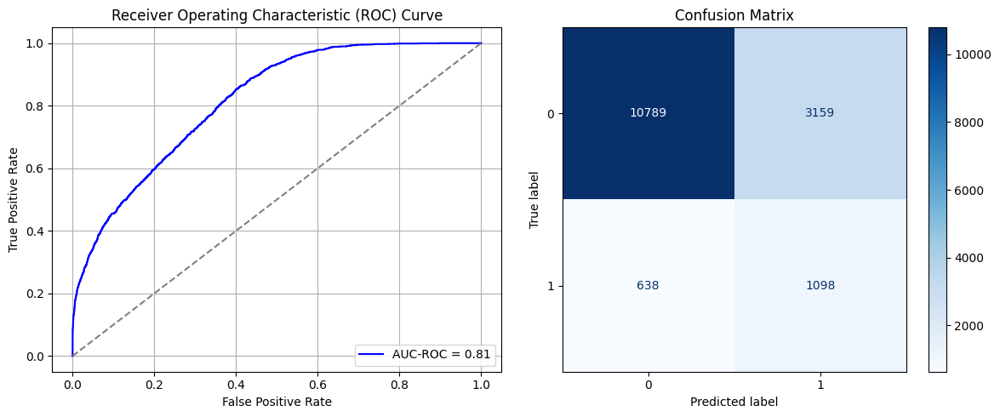

Best threshold based on F1-score: 0.7305265665054321
False Negative Rate: 0.3675115207373272
Time elapsed (performance): 1.265865852999923
(np.float64(0.22648408373960424), np.float64(0.7735159162603957))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7308 - loss: 0.6139 - val_AUC: 0.8483 - val_loss: 0.4793
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8598 - loss: 0.4652 - val_AUC: 0.8687 - val_loss: 0.4455
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8717 - loss: 0.4411 - val_AUC: 0.8715 - val_loss: 0.4451
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8769 - loss: 0.4351 - val_AUC: 0.8720 - val_loss: 0.4410
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8768 - loss: 0.4343 - val_AUC: 0.8706 - val_loss: 0.4449
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8803 - loss: 0.4278 - val_AUC: 0.8732 - val_loss: 0.4382
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8838 - loss: 0.4231 - val_AUC: 0.8738 - val_loss: 0.4392
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8810 - loss: 0.4275 - val_AUC: 0.8730 - val_loss: 0.4393
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8799 -

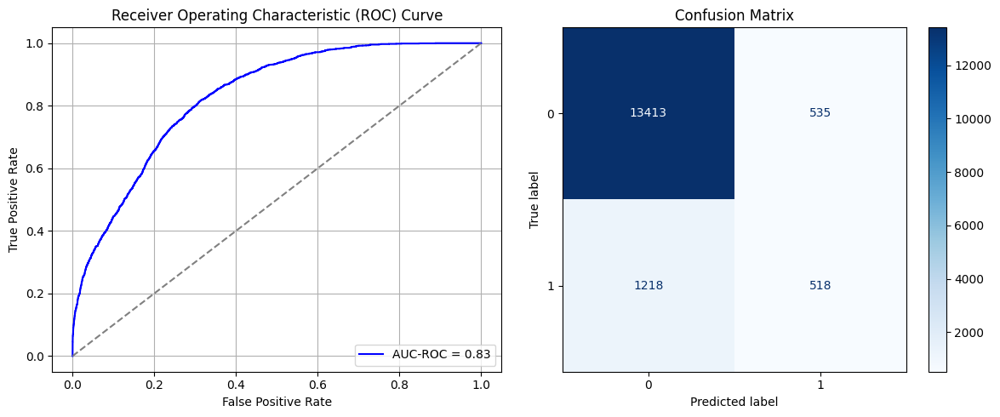

Best threshold based on F1-score: 0.18793386220932007
False Negative Rate: 0.7016129032258065
Time elapsed (performance): 1.2893821880006726
(np.float64(0.038356753656438196), np.float64(0.9616432463435618))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7405 - loss: 0.6048 - val_AUC: 0.8664 - val_loss: 0.4679
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8596 - loss: 0.4635 - val_AUC: 0.8751 - val_loss: 0.4524
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8683 - loss: 0.4474 - val_AUC: 0.8777 - val_loss: 0.4341
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8718 - loss: 0.4419 - val_AUC: 0.8771 - val_loss: 0.4337
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8778 - loss: 0.4312 - val_AUC: 0.8795 - val_loss: 0.4305
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8779 - loss: 0.4318 - val_AUC: 0.8794 - val_loss: 0.4320
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8734 - loss: 0.4380 - val_AUC: 0.8794 - val_loss: 0.4329
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8807 - loss: 0.4283 - val_AUC: 0.8792 - val_loss: 0.4381
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8799 -

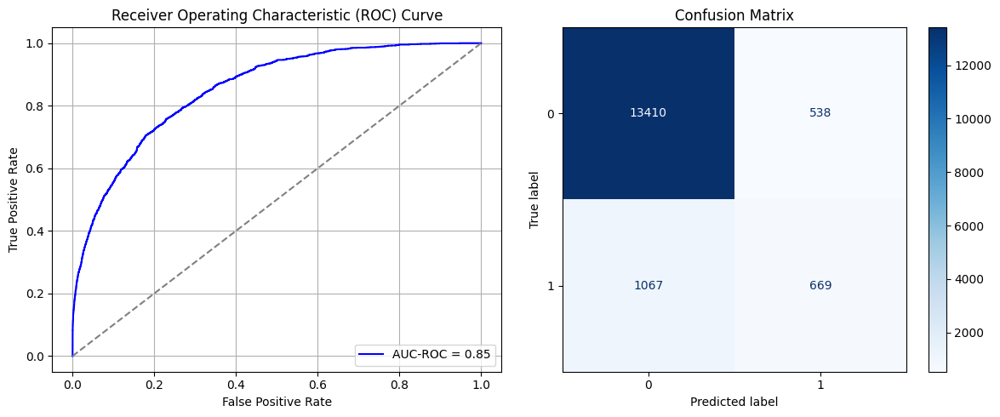

Best threshold based on F1-score: 0.3767090141773224
False Negative Rate: 0.6146313364055299
Time elapsed (performance): 1.270152634000624
(np.float64(0.038571838256380844), np.float64(0.9614281617436191))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7491 - loss: 0.6076 - val_AUC: 0.8493 - val_loss: 0.4767
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8646 - loss: 0.4578 - val_AUC: 0.8681 - val_loss: 0.4470
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8765 - loss: 0.4347 - val_AUC: 0.8698 - val_loss: 0.4477
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8757 - loss: 0.4367 - val_AUC: 0.8719 - val_loss: 0.4789
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8774 - loss: 0.4339 - val_AUC: 0.8743 - val_loss: 0.4377
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8796 - loss: 0.4297 - val_AUC: 0.8742 - val_loss: 0.4366
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8825 - loss: 0.4231 - val_AUC: 0.8742 - val_loss: 0.4476
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8786 - loss: 0.4329 - val_AUC: 0.8742 - val_loss: 0.4378
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8850 -

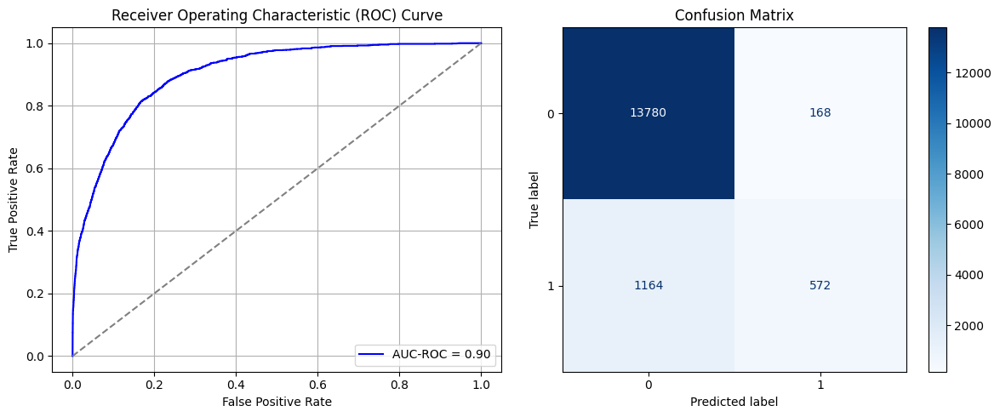

Best threshold based on F1-score: 0.23620298504829407
False Negative Rate: 0.6705069124423964
Time elapsed (performance): 1.288949965000029
(np.float64(0.01204473759678807), np.float64(0.987955262403212))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7559 - loss: 0.6089 - val_AUC: 0.8569 - val_loss: 0.4752
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8650 - loss: 0.4594 - val_AUC: 0.8686 - val_loss: 0.4461
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8752 - loss: 0.4387 - val_AUC: 0.8712 - val_loss: 0.4431
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8751 - loss: 0.4368 - val_AUC: 0.8717 - val_loss: 0.4414
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8709 - loss: 0.4455 - val_AUC: 0.8723 - val_loss: 0.4546
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8766 - loss: 0.4342 - val_AUC: 0.8727 - val_loss: 0.4460
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8763 - loss: 0.4348 - val_AUC: 0.8713 - val_loss: 0.4504
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8789 - loss: 0.4298 - val_AUC: 0.8715 - val_loss: 0.4410
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8749 -

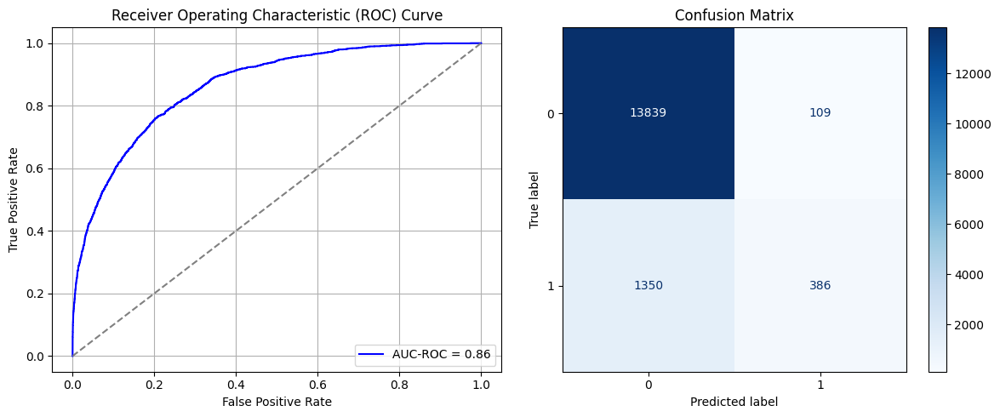

Best threshold based on F1-score: 0.13959155976772308
False Negative Rate: 0.7776497695852534
Time elapsed (performance): 1.2766148199998497
(np.float64(0.007814740464582736), np.float64(0.9921852595354173))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7615 - loss: 0.6049 - val_AUC: 0.8630 - val_loss: 0.4721
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8615 - loss: 0.4640 - val_AUC: 0.8759 - val_loss: 0.4363
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8696 - loss: 0.4464 - val_AUC: 0.8772 - val_loss: 0.4356
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8719 - loss: 0.4402 - val_AUC: 0.8789 - val_loss: 0.4400
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8682 - loss: 0.4477 - val_AUC: 0.8785 - val_loss: 0.4347
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8718 - loss: 0.4422 - val_AUC: 0.8793 - val_loss: 0.4303
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8768 - loss: 0.4349 - val_AUC: 0.8792 - val_loss: 0.4296
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8800 - loss: 0.4284 - val_AUC: 0.8786 - val_loss: 0.4432
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8761 -

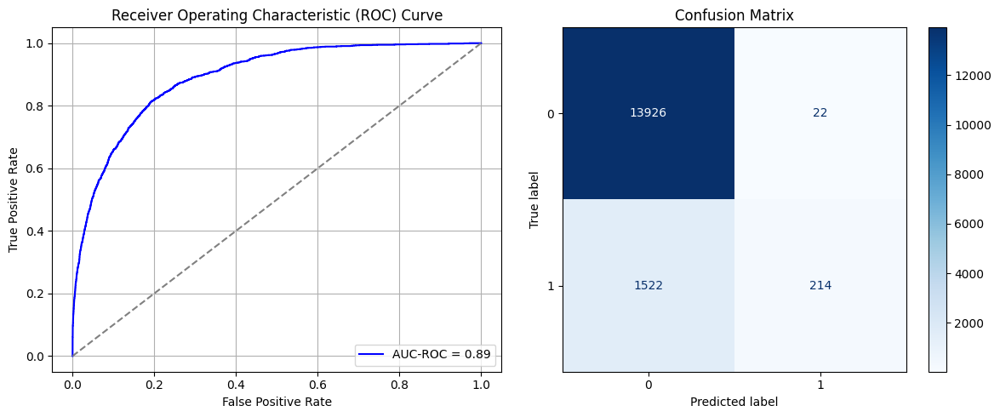

Best threshold based on F1-score: 0.09669008105993271
False Negative Rate: 0.8767281105990783
Time elapsed (performance): 1.5342496250004842
(np.float64(0.0015772870662460567), np.float64(0.998422712933754))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.7174 - loss: 0.6213 - val_AUC: 0.8454 - val_loss: 0.4982
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8567 - loss: 0.4696 - val_AUC: 0.8669 - val_loss: 0.4529
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8722 - loss: 0.4420 - val_AUC: 0.8715 - val_loss: 0.4420
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8708 - loss: 0.4432 - val_AUC: 0.8722 - val_loss: 0.4461
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8828 - loss: 0.4234 - val_AUC: 0.8731 - val_loss: 0.4430
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8826 - loss: 0.4239 - val_AUC: 0.8738 - val_loss: 0.4456
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8794 - loss: 0.4301 - val_AUC: 0.8732 - val_loss: 0.4446
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8791 - loss: 0.4295 - val_AUC: 0.8722 - val_loss: 0.4403
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8775 -

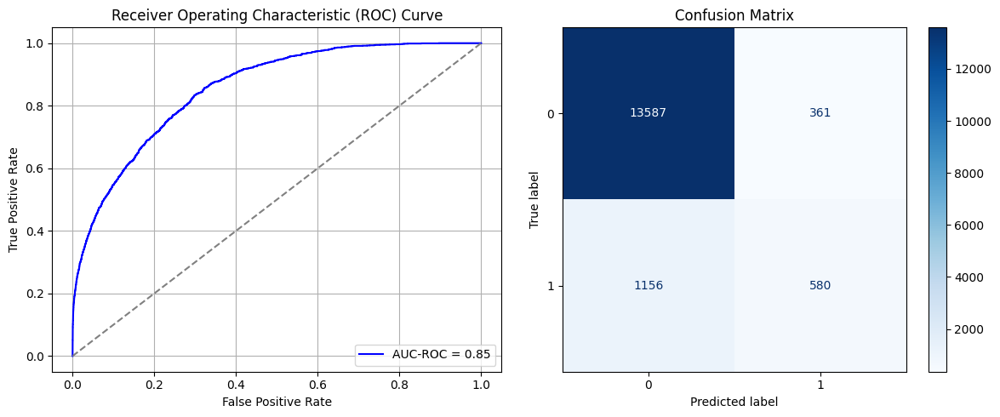

Best threshold based on F1-score: 0.3463364243507385
False Negative Rate: 0.6658986175115207
Time elapsed (performance): 1.2564272509998773
(np.float64(0.02588184685976484), np.float64(0.9741181531402352))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7431 - loss: 0.6194 - val_AUC: 0.8633 - val_loss: 0.4665
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8565 - loss: 0.4690 - val_AUC: 0.8773 - val_loss: 0.4343
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8712 - loss: 0.4429 - val_AUC: 0.8772 - val_loss: 0.4490
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8740 - loss: 0.4396 - val_AUC: 0.8799 - val_loss: 0.4309
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8710 - loss: 0.4431 - val_AUC: 0.8787 - val_loss: 0.4328
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8771 - loss: 0.4334 - val_AUC: 0.8798 - val_loss: 0.4289
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8721 - loss: 0.4402 - val_AUC: 0.8795 - val_loss: 0.4402
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8774 - loss: 0.4325 - val_AUC: 0.8779 - val_loss: 0.4318
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8753 -

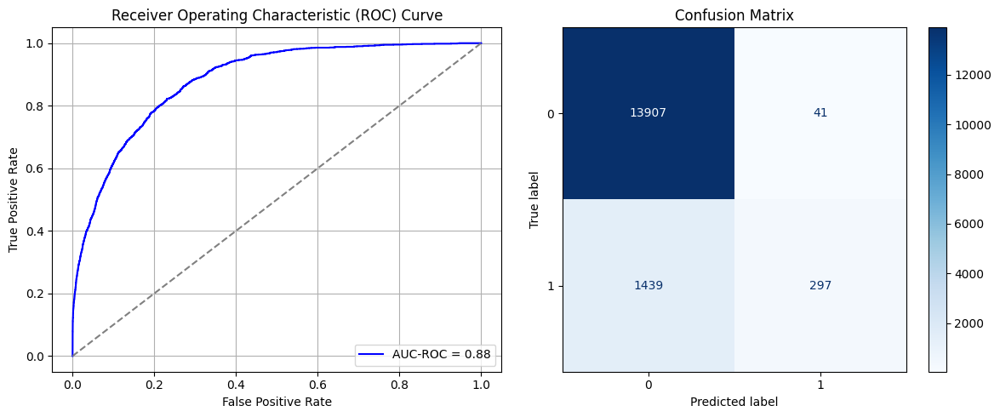

Best threshold based on F1-score: 0.10206940770149231
False Negative Rate: 0.8289170506912442
Time elapsed (performance): 1.6931064880000122
(np.float64(0.0029394895325494694), np.float64(0.9970605104674505))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7400 - loss: 0.6132 - val_AUC: 0.8639 - val_loss: 0.4642
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8596 - loss: 0.4636 - val_AUC: 0.8778 - val_loss: 0.4379
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8666 - loss: 0.4506 - val_AUC: 0.8782 - val_loss: 0.4368
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8745 - loss: 0.4382 - val_AUC: 0.8769 - val_loss: 0.4329
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8719 - loss: 0.4408 - val_AUC: 0.8791 - val_loss: 0.4309
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8746 - loss: 0.4369 - val_AUC: 0.8773 - val_loss: 0.4405
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8745 - loss: 0.4355 - val_AUC: 0.8799 - val_loss: 0.4291
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8758 - loss: 0.4358 - val_AUC: 0.8800 - val_loss: 0.4374
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8829 -

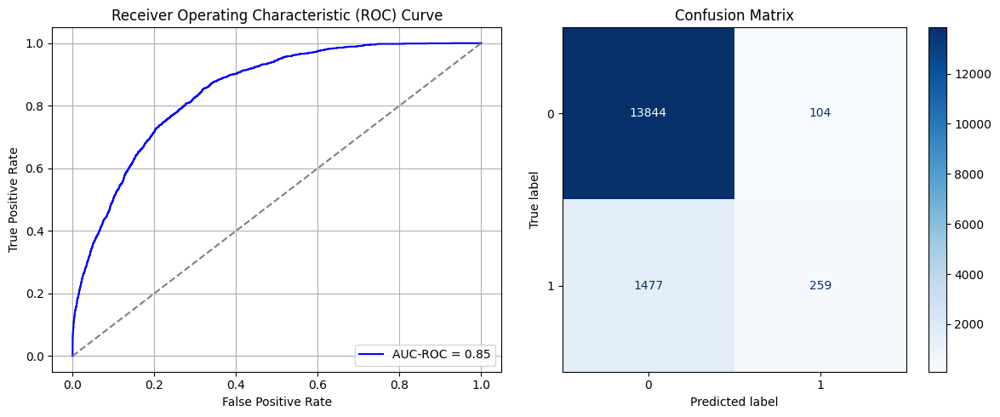

Best threshold based on F1-score: 0.11424707621335983
False Negative Rate: 0.8508064516129032
Time elapsed (performance): 1.2892873929995403
(np.float64(0.007456266131344996), np.float64(0.992543733868655))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7530 - loss: 0.6053 - val_AUC: 0.8464 - val_loss: 0.4842
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8642 - loss: 0.4604 - val_AUC: 0.8691 - val_loss: 0.4538
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8735 - loss: 0.4419 - val_AUC: 0.8707 - val_loss: 0.4429
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8697 - loss: 0.4458 - val_AUC: 0.8717 - val_loss: 0.4451
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8785 - loss: 0.4323 - val_AUC: 0.8709 - val_loss: 0.4464
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8751 - loss: 0.4370 - val_AUC: 0.8703 - val_loss: 0.4541
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8797 - loss: 0.4302 - val_AUC: 0.8736 - val_loss: 0.4375
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8810 - loss: 0.4269 - val_AUC: 0.8731 - val_loss: 0.4439
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8813 -

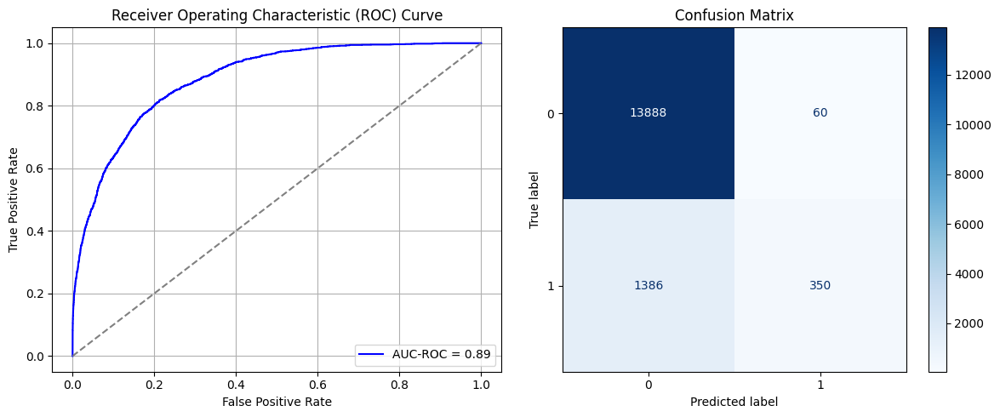

Best threshold based on F1-score: 0.12932923436164856
False Negative Rate: 0.7983870967741935
Time elapsed (performance): 1.698046000999966
(np.float64(0.004301691998852882), np.float64(0.9956983080011471))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7179 - loss: 0.6191 - val_AUC: 0.8354 - val_loss: 0.5081
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8540 - loss: 0.4762 - val_AUC: 0.8651 - val_loss: 0.4529
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8714 - loss: 0.4429 - val_AUC: 0.8676 - val_loss: 0.4560
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8778 - loss: 0.4329 - val_AUC: 0.8703 - val_loss: 0.4441
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8737 - loss: 0.4382 - val_AUC: 0.8696 - val_loss: 0.4456
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8784 - loss: 0.4318 - val_AUC: 0.8716 - val_loss: 0.4435
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8839 - loss: 0.4217 - val_AUC: 0.8721 - val_loss: 0.4439
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8760 - loss: 0.4344 - val_AUC: 0.8731 - val_loss: 0.4422
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8795 -

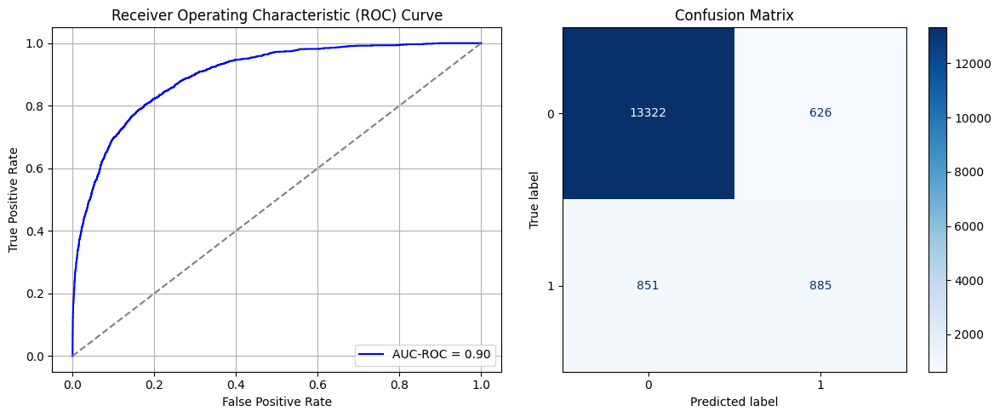

Best threshold based on F1-score: 0.43026071786880493
False Negative Rate: 0.4902073732718894
Time elapsed (performance): 1.3116272779998326
(np.float64(0.04488098652136507), np.float64(0.9551190134786349))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7404 - loss: 0.6072 - val_AUC: 0.8650 - val_loss: 0.4761
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8619 - loss: 0.4637 - val_AUC: 0.8753 - val_loss: 0.4437
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8668 - loss: 0.4485 - val_AUC: 0.8782 - val_loss: 0.4344
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8708 - loss: 0.4452 - val_AUC: 0.8768 - val_loss: 0.4337
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8747 - loss: 0.4369 - val_AUC: 0.8785 - val_loss: 0.4321
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8732 - loss: 0.4381 - val_AUC: 0.8781 - val_loss: 0.4353
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8758 - loss: 0.4350 - val_AUC: 0.8775 - val_loss: 0.4344
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8747 - loss: 0.4378 - val_AUC: 0.8786 - val_loss: 0.4305
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8769 -

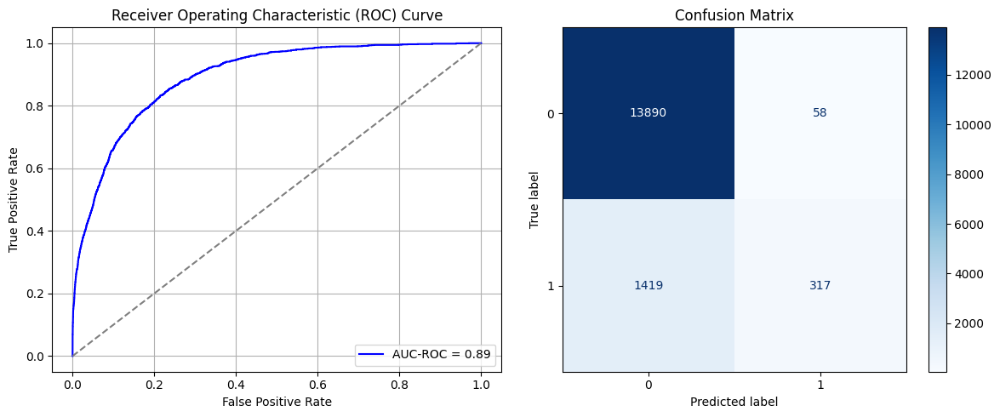

Best threshold based on F1-score: 0.09710699319839478
False Negative Rate: 0.8173963133640553
Time elapsed (performance): 1.710571128999618
(np.float64(0.004158302265557786), np.float64(0.9958416977344422))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7132 - loss: 0.6194 - val_AUC: 0.8514 - val_loss: 0.4829
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8640 - loss: 0.4586 - val_AUC: 0.8689 - val_loss: 0.4458
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8786 - loss: 0.4339 - val_AUC: 0.8695 - val_loss: 0.4444
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8719 - loss: 0.4432 - val_AUC: 0.8709 - val_loss: 0.4419
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8741 - loss: 0.4376 - val_AUC: 0.8717 - val_loss: 0.4433
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8810 - loss: 0.4281 - val_AUC: 0.8725 - val_loss: 0.4395
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8823 - loss: 0.4270 - val_AUC: 0.8715 - val_loss: 0.4451
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8781 - loss: 0.4320 - val_AUC: 0.8749 - val_loss: 0.4364
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8818 -

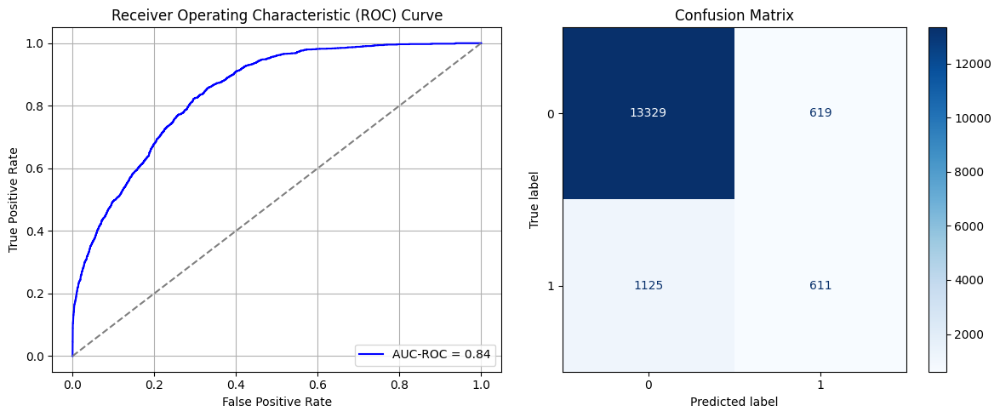

Best threshold based on F1-score: 0.36799535155296326
False Negative Rate: 0.6480414746543779
Time elapsed (performance): 1.319015964000755
(np.float64(0.044379122454832234), np.float64(0.9556208775451678))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.7353 - loss: 0.6125 - val_AUC: 0.8554 - val_loss: 0.4759
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8681 - loss: 0.4549 - val_AUC: 0.8682 - val_loss: 0.4600
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8762 - loss: 0.4359 - val_AUC: 0.8689 - val_loss: 0.4485
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8784 - loss: 0.4332 - val_AUC: 0.8695 - val_loss: 0.4558
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8722 - loss: 0.4414 - val_AUC: 0.8701 - val_loss: 0.4451
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8741 - loss: 0.4398 - val_AUC: 0.8715 - val_loss: 0.4515
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8812 - loss: 0.4289 - val_AUC: 0.8726 - val_loss: 0.4548
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8790 - loss: 0.4300 - val_AUC: 0.8730 - val_loss: 0.4385
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8805 -

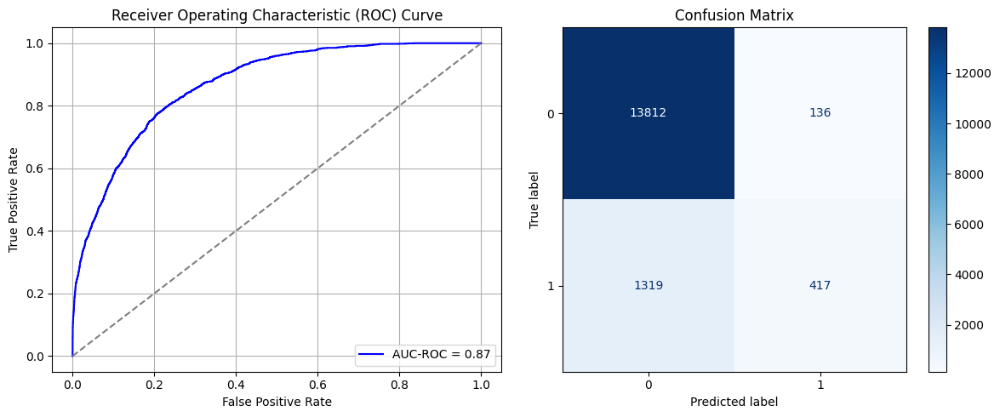

Best threshold based on F1-score: 0.14553965628147125
False Negative Rate: 0.7597926267281107
Time elapsed (performance): 1.4679024329998356
(np.float64(0.009750501864066534), np.float64(0.9902494981359334))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.7607 - loss: 0.6088 - val_AUC: 0.8477 - val_loss: 0.4843
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8615 - loss: 0.4650 - val_AUC: 0.8677 - val_loss: 0.4483
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8765 - loss: 0.4359 - val_AUC: 0.8693 - val_loss: 0.4458
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8775 - loss: 0.4339 - val_AUC: 0.8708 - val_loss: 0.4633
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8738 - loss: 0.4397 - val_AUC: 0.8716 - val_loss: 0.4551
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8809 - loss: 0.4277 - val_AUC: 0.8713 - val_loss: 0.4420
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8782 - loss: 0.4316 - val_AUC: 0.8698 - val_loss: 0.4486
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8801 - loss: 0.4281 - val_AUC: 0.8721 - val_loss: 0.4413
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8790 -

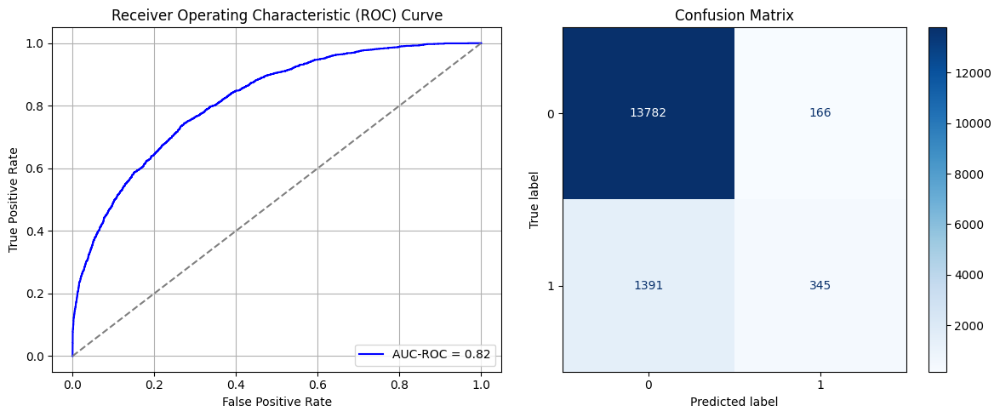

Best threshold based on F1-score: 0.14354707300662994
False Negative Rate: 0.8012672811059908
Time elapsed (performance): 1.7185921580003196
(np.float64(0.011901347863492975), np.float64(0.988098652136507))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - AUC: 0.7550 - loss: 0.6126 - val_AUC: 0.8500 - val_loss: 0.4840
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8537 - loss: 0.4733 - val_AUC: 0.8752 - val_loss: 0.4377
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8723 - loss: 0.4431 - val_AUC: 0.8771 - val_loss: 0.4339
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8729 - loss: 0.4387 - val_AUC: 0.8784 - val_loss: 0.4557
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8744 - loss: 0.4369 - val_AUC: 0.8789 - val_loss: 0.4302
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8725 - loss: 0.4410 - val_AUC: 0.8792 - val_loss: 0.4300
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8779 - loss: 0.4315 - val_AUC: 0.8797 - val_loss: 0.4295
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8761 - loss: 0.4351 - val_AUC: 0.8797 - val_loss: 0.4298
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8798 -

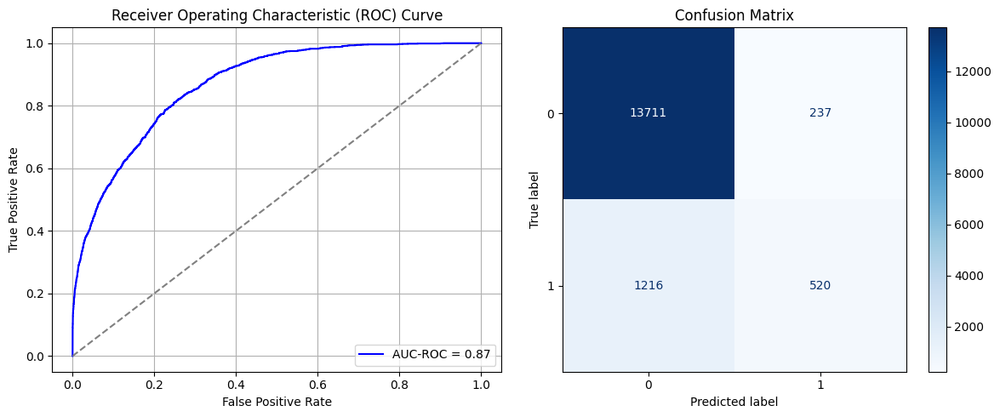

Best threshold based on F1-score: 0.2978127598762512
False Negative Rate: 0.7004608294930875
Time elapsed (performance): 1.7012680219995673
(np.float64(0.016991683395468884), np.float64(0.9830083166045311))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - AUC: 0.7280 - loss: 0.6176 - val_AUC: 0.8641 - val_loss: 0.4683
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8605 - loss: 0.4655 - val_AUC: 0.8774 - val_loss: 0.4386
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8733 - loss: 0.4422 - val_AUC: 0.8774 - val_loss: 0.4570
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8660 - loss: 0.4514 - val_AUC: 0.8783 - val_loss: 0.4338
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8762 - loss: 0.4352 - val_AUC: 0.8770 - val_loss: 0.4340
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8755 - loss: 0.4361 - val_AUC: 0.8785 - val_loss: 0.4317
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8755 - loss: 0.4341 - val_AUC: 0.8786 - val_loss: 0.4320
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8753 - loss: 0.4347 - val_AUC: 0.8790 - val_loss: 0.4306
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8749 -

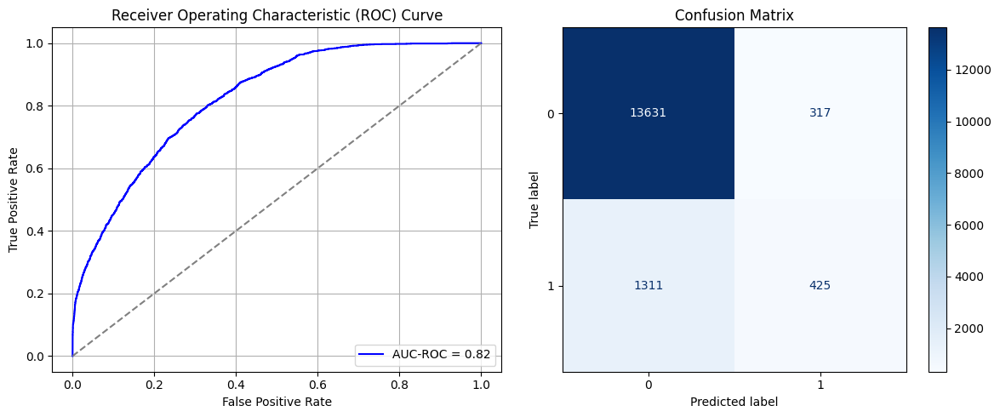

Best threshold based on F1-score: 0.1945601999759674
False Negative Rate: 0.755184331797235
Time elapsed (performance): 1.390179838000222
(np.float64(0.022727272727272728), np.float64(0.9772727272727273))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7080 - loss: 0.6251 - val_AUC: 0.8639 - val_loss: 0.4774
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8614 - loss: 0.4625 - val_AUC: 0.8752 - val_loss: 0.4382
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8703 - loss: 0.4453 - val_AUC: 0.8782 - val_loss: 0.4323
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8702 - loss: 0.4452 - val_AUC: 0.8793 - val_loss: 0.4306
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8721 - loss: 0.4401 - val_AUC: 0.8791 - val_loss: 0.4356
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8696 - loss: 0.4443 - val_AUC: 0.8798 - val_loss: 0.4302
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8799 - loss: 0.4283 - val_AUC: 0.8789 - val_loss: 0.4360
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8765 - loss: 0.4340 - val_AUC: 0.8779 - val_loss: 0.4314
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8712 -

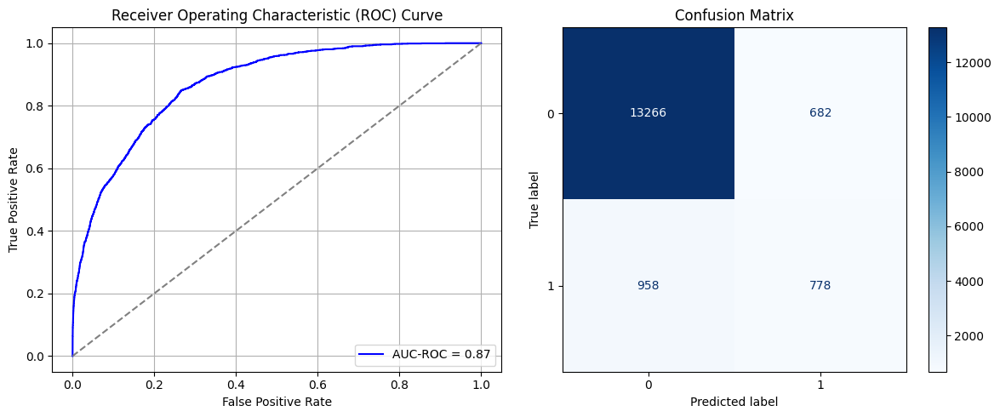

Best threshold based on F1-score: 0.43294650316238403
False Negative Rate: 0.5518433179723502
Time elapsed (performance): 1.7303870050000114
(np.float64(0.04889589905362776), np.float64(0.9511041009463722))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7410 - loss: 0.6220 - val_AUC: 0.8564 - val_loss: 0.4785
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8530 - loss: 0.4753 - val_AUC: 0.8753 - val_loss: 0.4666
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8690 - loss: 0.4471 - val_AUC: 0.8783 - val_loss: 0.4352
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8736 - loss: 0.4390 - val_AUC: 0.8775 - val_loss: 0.4321
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8811 - loss: 0.4264 - val_AUC: 0.8794 - val_loss: 0.4324
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8771 - loss: 0.4326 - val_AUC: 0.8796 - val_loss: 0.4292
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8749 - loss: 0.4379 - val_AUC: 0.8798 - val_loss: 0.4287
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8778 - loss: 0.4324 - val_AUC: 0.8795 - val_loss: 0.4328
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8760 -

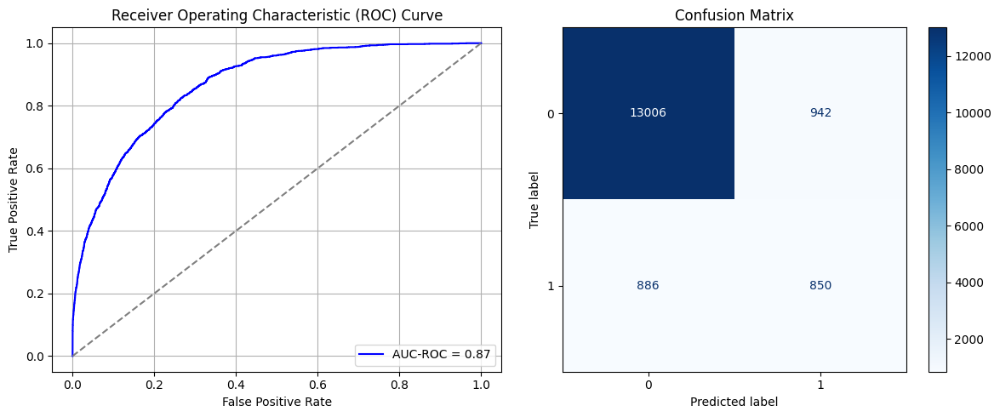

Best threshold based on F1-score: 0.4474022388458252
False Negative Rate: 0.5103686635944701
Time elapsed (performance): 1.3572280620001038
(np.float64(0.06753656438199025), np.float64(0.9324634356180097))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7500 - loss: 0.6113 - val_AUC: 0.8513 - val_loss: 0.4750
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8602 - loss: 0.4660 - val_AUC: 0.8691 - val_loss: 0.4576
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8740 - loss: 0.4384 - val_AUC: 0.8690 - val_loss: 0.4463
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8753 - loss: 0.4350 - val_AUC: 0.8693 - val_loss: 0.4516
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8817 - loss: 0.4277 - val_AUC: 0.8713 - val_loss: 0.4418
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8754 - loss: 0.4366 - val_AUC: 0.8712 - val_loss: 0.4494
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8816 - loss: 0.4267 - val_AUC: 0.8712 - val_loss: 0.4474
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8749 - loss: 0.4374 - val_AUC: 0.8708 - val_loss: 0.4423
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8794 -

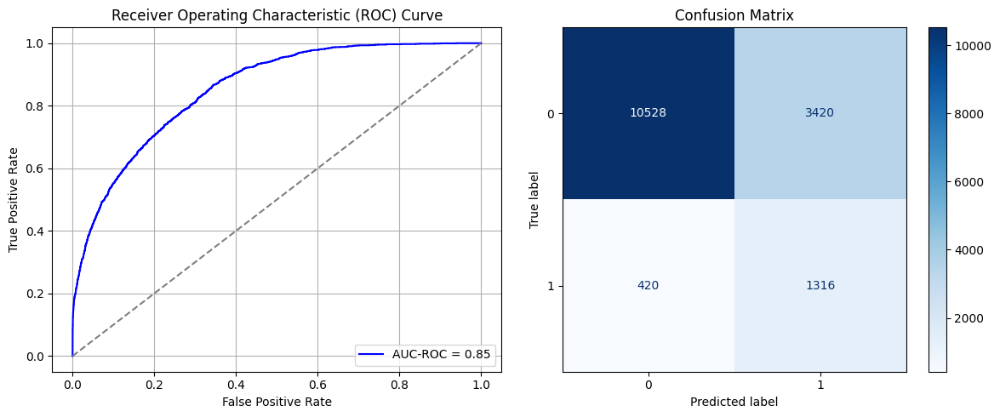

Best threshold based on F1-score: 0.7103829979896545
False Negative Rate: 0.24193548387096775
Time elapsed (performance): 1.7273271840003872
(np.float64(0.2451964439346143), np.float64(0.7548035560653857))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7288 - loss: 0.6189 - val_AUC: 0.8606 - val_loss: 0.4780
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8569 - loss: 0.4710 - val_AUC: 0.8773 - val_loss: 0.4366
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8759 - loss: 0.4392 - val_AUC: 0.8794 - val_loss: 0.4325
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8729 - loss: 0.4438 - val_AUC: 0.8809 - val_loss: 0.4300
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8733 - loss: 0.4388 - val_AUC: 0.8801 - val_loss: 0.4316
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8786 - loss: 0.4330 - val_AUC: 0.8788 - val_loss: 0.4385
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8750 - loss: 0.4364 - val_AUC: 0.8793 - val_loss: 0.4308
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8821 - loss: 0.4251 - val_AUC: 0.8780 - val_loss: 0.4404
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8743 -

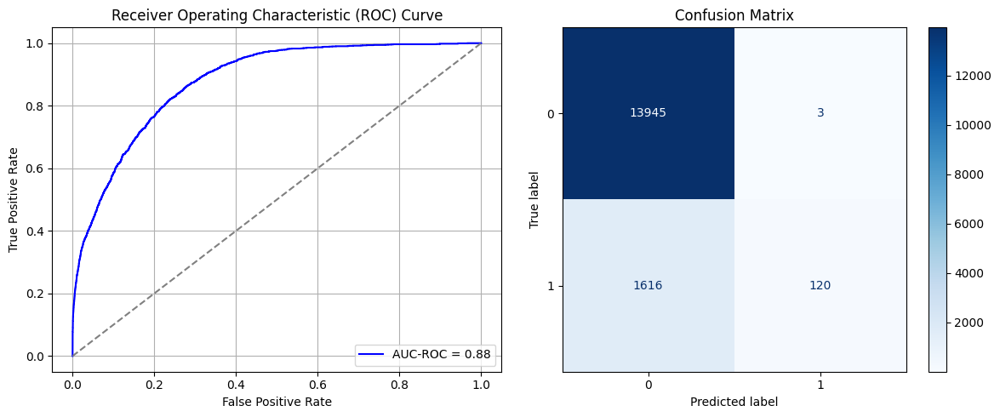

Best threshold based on F1-score: 0.01476864330470562
False Negative Rate: 0.9308755760368663
Time elapsed (performance): 1.371517011000833
(np.float64(0.0002150845999426441), np.float64(0.9997849154000573))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7588 - loss: 0.5966 - val_AUC: 0.8659 - val_loss: 0.4638
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8591 - loss: 0.4634 - val_AUC: 0.8757 - val_loss: 0.4375
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8683 - loss: 0.4467 - val_AUC: 0.8732 - val_loss: 0.4449
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8720 - loss: 0.4420 - val_AUC: 0.8778 - val_loss: 0.4336
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8784 - loss: 0.4305 - val_AUC: 0.8779 - val_loss: 0.4319
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8716 - loss: 0.4421 - val_AUC: 0.8760 - val_loss: 0.4353
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8691 - loss: 0.4454 - val_AUC: 0.8789 - val_loss: 0.4355
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8778 - loss: 0.4306 - val_AUC: 0.8782 - val_loss: 0.4368
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8782 -

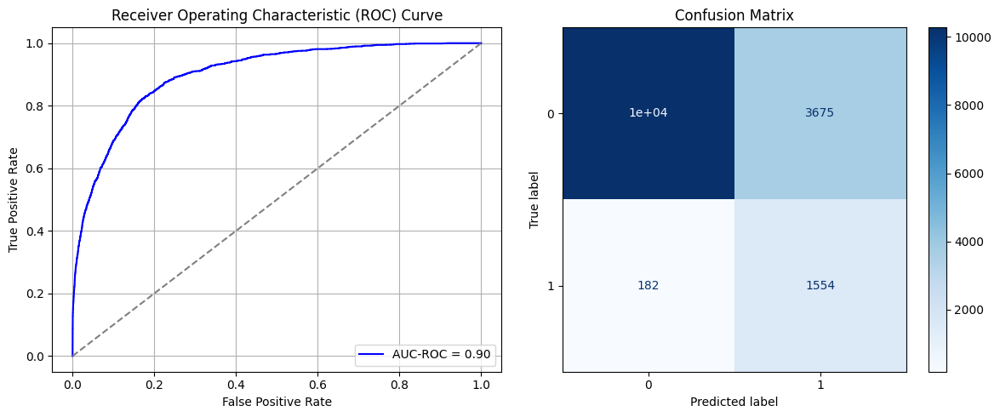

Best threshold based on F1-score: 0.7620601058006287
False Negative Rate: 0.10483870967741936
Time elapsed (performance): 1.3522936230001505
(np.float64(0.26347863492973905), np.float64(0.7365213650702609))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7450 - loss: 0.6167 - val_AUC: 0.8482 - val_loss: 0.4843
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8517 - loss: 0.4754 - val_AUC: 0.8658 - val_loss: 0.4503
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8705 - loss: 0.4452 - val_AUC: 0.8712 - val_loss: 0.4483
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8754 - loss: 0.4360 - val_AUC: 0.8688 - val_loss: 0.4494
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8743 - loss: 0.4375 - val_AUC: 0.8730 - val_loss: 0.4471
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8800 - loss: 0.4293 - val_AUC: 0.8728 - val_loss: 0.4413
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8734 - loss: 0.4401 - val_AUC: 0.8726 - val_loss: 0.4445
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8819 - loss: 0.4268 - val_AUC: 0.8733 - val_loss: 0.4385
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8835 -

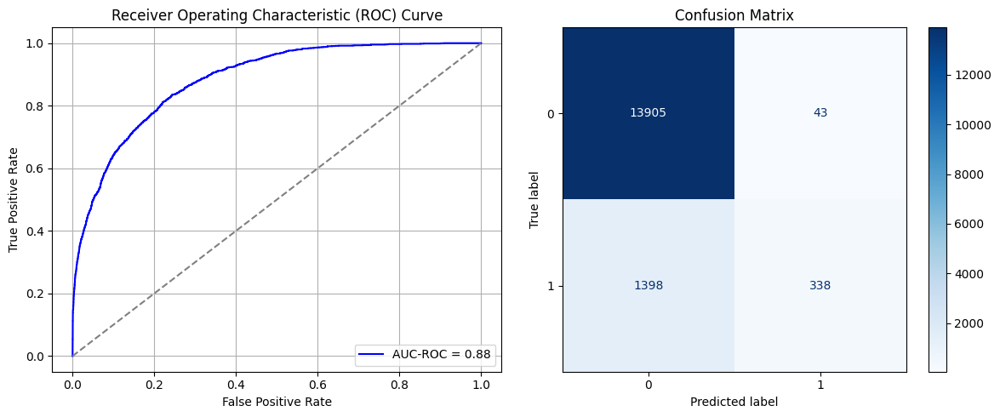

Best threshold based on F1-score: 0.09626906365156174
False Negative Rate: 0.8052995391705069
Time elapsed (performance): 1.7011990789997071
(np.float64(0.0030828792658445657), np.float64(0.9969171207341554))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7534 - loss: 0.6136 - val_AUC: 0.8540 - val_loss: 0.4720
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8652 - loss: 0.4589 - val_AUC: 0.8683 - val_loss: 0.4461
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8771 - loss: 0.4364 - val_AUC: 0.8701 - val_loss: 0.4460
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8746 - loss: 0.4394 - val_AUC: 0.8717 - val_loss: 0.4409
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8804 - loss: 0.4295 - val_AUC: 0.8709 - val_loss: 0.4421
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8755 - loss: 0.4366 - val_AUC: 0.8715 - val_loss: 0.4407
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8772 - loss: 0.4317 - val_AUC: 0.8697 - val_loss: 0.4448
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8830 - loss: 0.4243 - val_AUC: 0.8716 - val_loss: 0.4427
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8761 -

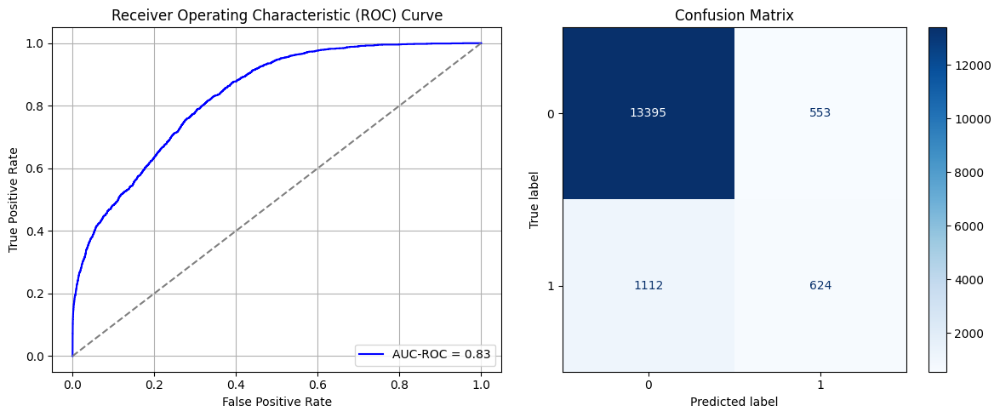

Best threshold based on F1-score: 0.4282066524028778
False Negative Rate: 0.6405529953917051
Time elapsed (performance): 1.3705513019995124
(np.float64(0.039647261256094066), np.float64(0.9603527387439059))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7291 - loss: 0.6166 - val_AUC: 0.8547 - val_loss: 0.4833
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8570 - loss: 0.4707 - val_AUC: 0.8774 - val_loss: 0.4395
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8670 - loss: 0.4515 - val_AUC: 0.8780 - val_loss: 0.4453
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8735 - loss: 0.4416 - val_AUC: 0.8789 - val_loss: 0.4320
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8712 - loss: 0.4442 - val_AUC: 0.8789 - val_loss: 0.4338
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8800 - loss: 0.4286 - val_AUC: 0.8793 - val_loss: 0.4303
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8765 - loss: 0.4331 - val_AUC: 0.8798 - val_loss: 0.4296
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8738 - loss: 0.4385 - val_AUC: 0.8802 - val_loss: 0.4294
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8754 -

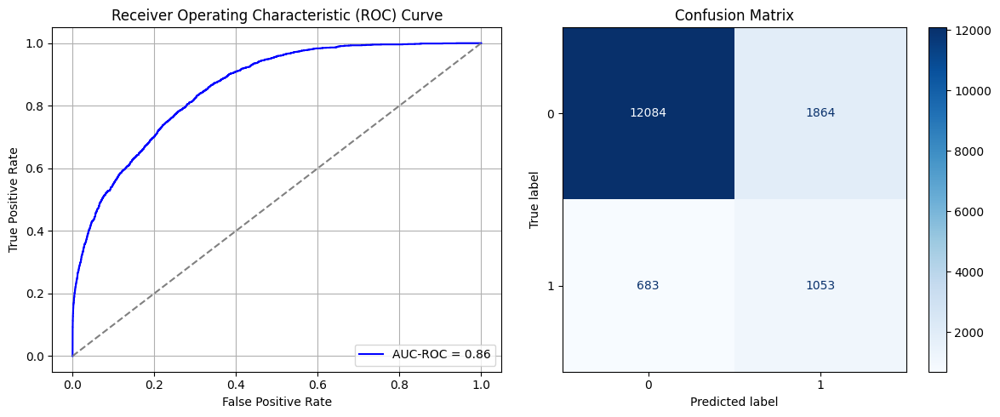

Best threshold based on F1-score: 0.5927284955978394
False Negative Rate: 0.3934331797235023
Time elapsed (performance): 1.7142624919997616
(np.float64(0.13363923143102954), np.float64(0.8663607685689705))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7437 - loss: 0.6110 - val_AUC: 0.8673 - val_loss: 0.4638
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8588 - loss: 0.4663 - val_AUC: 0.8775 - val_loss: 0.4341
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8697 - loss: 0.4449 - val_AUC: 0.8778 - val_loss: 0.4457
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8770 - loss: 0.4347 - val_AUC: 0.8787 - val_loss: 0.4304
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8794 - loss: 0.4289 - val_AUC: 0.8795 - val_loss: 0.4305
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8779 - loss: 0.4322 - val_AUC: 0.8801 - val_loss: 0.4318
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8822 - loss: 0.4249 - val_AUC: 0.8810 - val_loss: 0.4272
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8730 - loss: 0.4411 - val_AUC: 0.8795 - val_loss: 0.4300
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8775 -

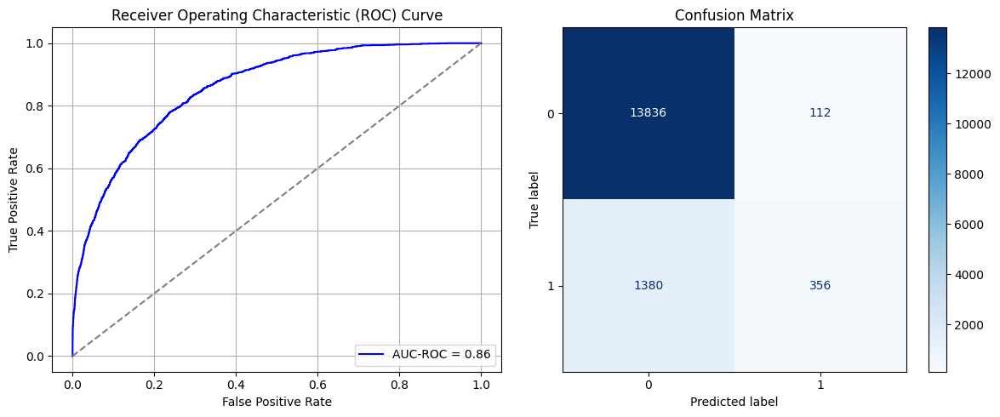

Best threshold based on F1-score: 0.15484069287776947
False Negative Rate: 0.7949308755760369
Time elapsed (performance): 1.3957273819996772
(np.float64(0.00802982506452538), np.float64(0.9919701749354746))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7283 - loss: 0.6171 - val_AUC: 0.8530 - val_loss: 0.4800
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8617 - loss: 0.4634 - val_AUC: 0.8654 - val_loss: 0.4549
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8663 - loss: 0.4497 - val_AUC: 0.8700 - val_loss: 0.4616
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8710 - loss: 0.4436 - val_AUC: 0.8705 - val_loss: 0.4424
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8756 - loss: 0.4356 - val_AUC: 0.8709 - val_loss: 0.4421
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8762 - loss: 0.4352 - val_AUC: 0.8709 - val_loss: 0.4417
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8802 - loss: 0.4285 - val_AUC: 0.8708 - val_loss: 0.4422
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - AUC: 0.8826 - loss: 0.4242 - val_AUC: 0.8727 - val_loss: 0.4390
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 6s 8ms/step - AUC: 0.8821 -

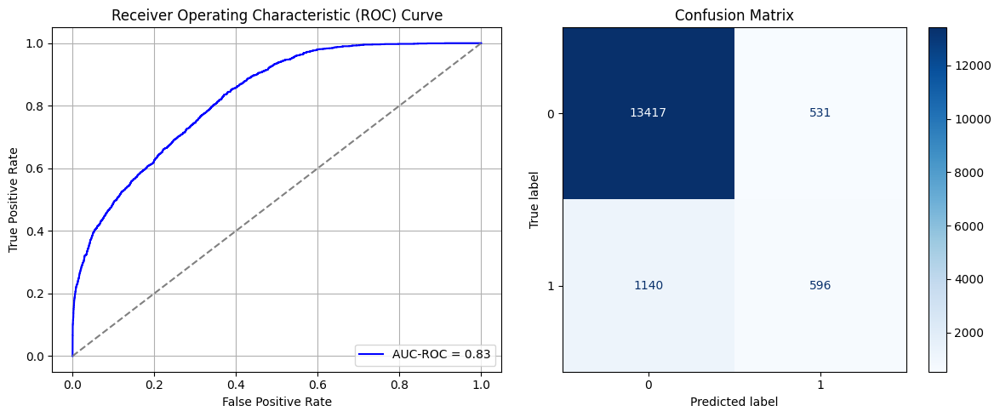

Best threshold based on F1-score: 0.43831920623779297
False Negative Rate: 0.6566820276497696
Time elapsed (performance): 1.3556119690001651
(np.float64(0.038069974189848005), np.float64(0.961930025810152))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7290 - loss: 0.6083 - val_AUC: 0.8569 - val_loss: 0.4750
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8630 - loss: 0.4615 - val_AUC: 0.8671 - val_loss: 0.4536
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8733 - loss: 0.4409 - val_AUC: 0.8697 - val_loss: 0.4593
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8736 - loss: 0.4380 - val_AUC: 0.8727 - val_loss: 0.4477
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8785 - loss: 0.4325 - val_AUC: 0.8707 - val_loss: 0.4428
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8771 - loss: 0.4325 - val_AUC: 0.8723 - val_loss: 0.4428
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8749 - loss: 0.4370 - val_AUC: 0.8727 - val_loss: 0.4395
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8779 - loss: 0.4301 - val_AUC: 0.8741 - val_loss: 0.4457
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8809 -

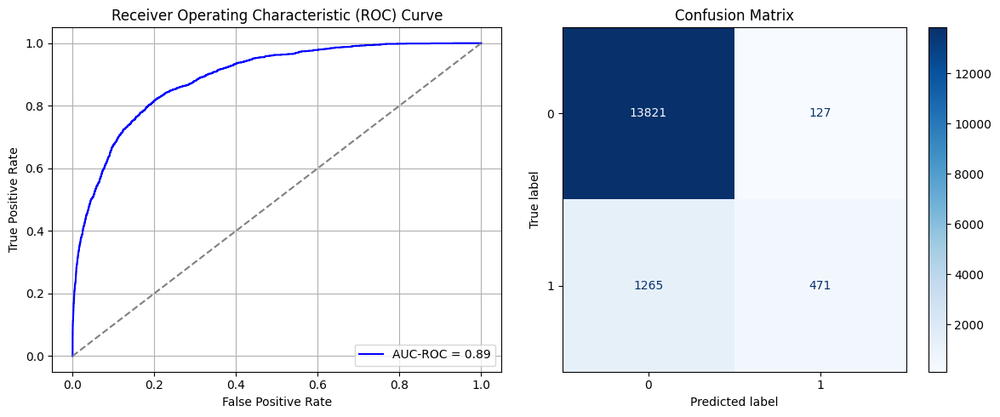

Best threshold based on F1-score: 0.14652973413467407
False Negative Rate: 0.7286866359447005
Time elapsed (performance): 1.7174498379999932
(np.float64(0.0091052480642386), np.float64(0.9908947519357614))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7469 - loss: 0.6145 - val_AUC: 0.8570 - val_loss: 0.4792
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8610 - loss: 0.4650 - val_AUC: 0.8677 - val_loss: 0.4470
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8746 - loss: 0.4387 - val_AUC: 0.8687 - val_loss: 0.4489
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8745 - loss: 0.4379 - val_AUC: 0.8710 - val_loss: 0.4483
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8720 - loss: 0.4412 - val_AUC: 0.8720 - val_loss: 0.4413
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8786 - loss: 0.4312 - val_AUC: 0.8709 - val_loss: 0.4420
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8811 - loss: 0.4268 - val_AUC: 0.8710 - val_loss: 0.4573
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8827 - loss: 0.4240 - val_AUC: 0.8725 - val_loss: 0.4393
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8812 -

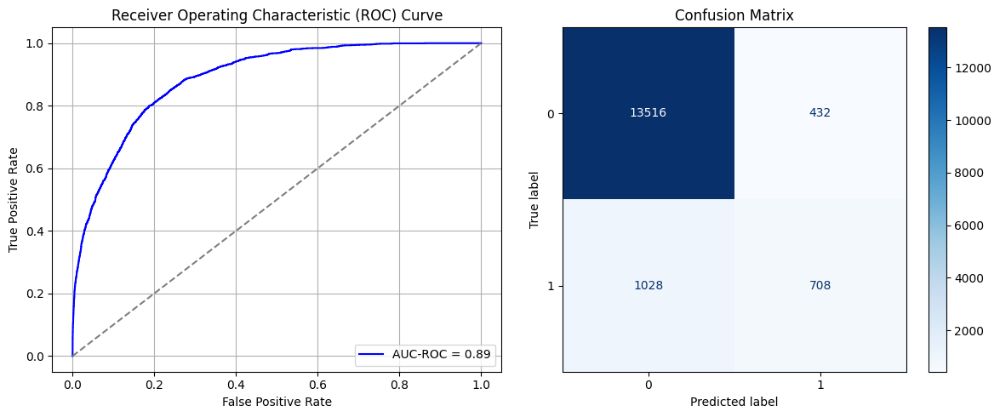

Best threshold based on F1-score: 0.37974053621292114
False Negative Rate: 0.5921658986175116
Time elapsed (performance): 1.4530806350003331
(np.float64(0.030972182391740752), np.float64(0.9690278176082593))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7101 - loss: 0.6207 - val_AUC: 0.8472 - val_loss: 0.4838
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8595 - loss: 0.4668 - val_AUC: 0.8681 - val_loss: 0.4547
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8711 - loss: 0.4430 - val_AUC: 0.8694 - val_loss: 0.4438
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8744 - loss: 0.4362 - val_AUC: 0.8700 - val_loss: 0.4434
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8712 - loss: 0.4409 - val_AUC: 0.8710 - val_loss: 0.4408
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8750 - loss: 0.4383 - val_AUC: 0.8724 - val_loss: 0.4396
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8768 - loss: 0.4340 - val_AUC: 0.8718 - val_loss: 0.4459
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8850 - loss: 0.4226 - val_AUC: 0.8730 - val_loss: 0.4433
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8737 -

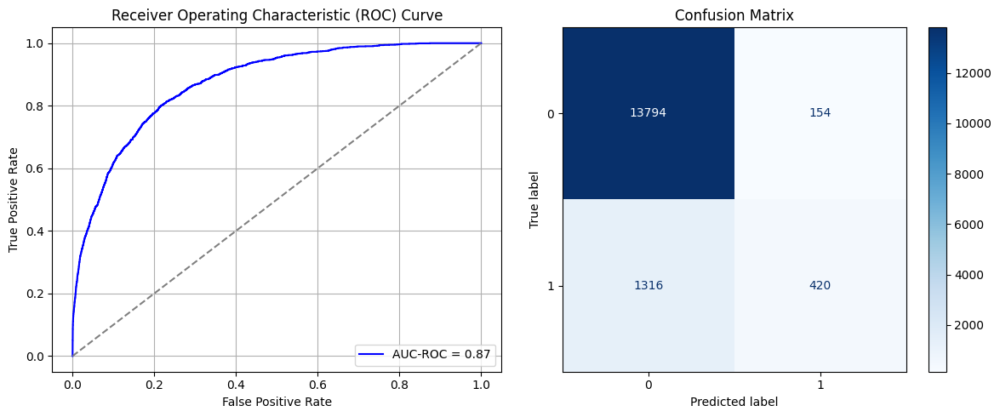

Best threshold based on F1-score: 0.16620346903800964
False Negative Rate: 0.7580645161290323
Time elapsed (performance): 1.7043063040000561
(np.float64(0.011041009463722398), np.float64(0.9889589905362776))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7468 - loss: 0.6151 - val_AUC: 0.8648 - val_loss: 0.4647
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8602 - loss: 0.4647 - val_AUC: 0.8754 - val_loss: 0.4428
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8640 - loss: 0.4541 - val_AUC: 0.8767 - val_loss: 0.4352
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8637 - loss: 0.4530 - val_AUC: 0.8781 - val_loss: 0.4316
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8747 - loss: 0.4375 - val_AUC: 0.8783 - val_loss: 0.4391
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8766 - loss: 0.4328 - val_AUC: 0.8789 - val_loss: 0.4417
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8733 - loss: 0.4396 - val_AUC: 0.8794 - val_loss: 0.4308
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8705 - loss: 0.4433 - val_AUC: 0.8782 - val_loss: 0.4331
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8779 -

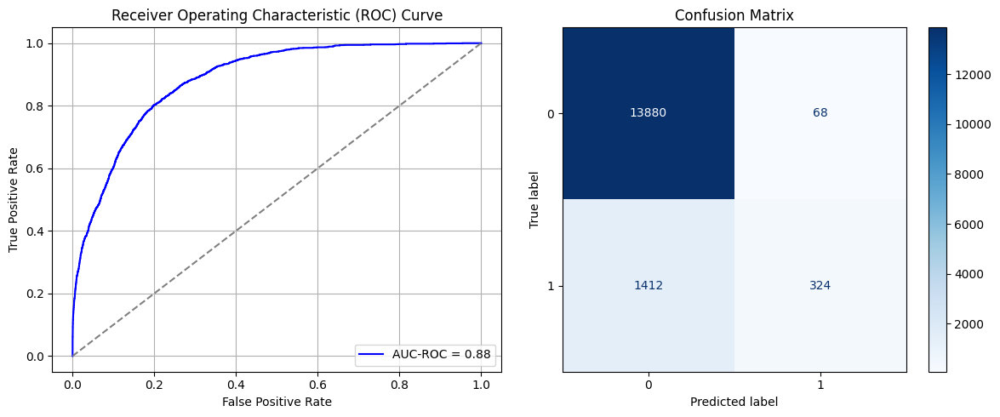

Best threshold based on F1-score: 0.12727324664592743
False Negative Rate: 0.8133640552995391
Time elapsed (performance): 1.4114169900003617
(np.float64(0.004875250932033267), np.float64(0.9951247490679668))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7283 - loss: 0.6179 - val_AUC: 0.8495 - val_loss: 0.4879
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8620 - loss: 0.4654 - val_AUC: 0.8685 - val_loss: 0.4461
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8703 - loss: 0.4450 - val_AUC: 0.8695 - val_loss: 0.4522
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8769 - loss: 0.4349 - val_AUC: 0.8701 - val_loss: 0.4433
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8766 - loss: 0.4374 - val_AUC: 0.8720 - val_loss: 0.4404
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8771 - loss: 0.4336 - val_AUC: 0.8713 - val_loss: 0.4433
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8763 - loss: 0.4354 - val_AUC: 0.8725 - val_loss: 0.4422
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8825 - loss: 0.4257 - val_AUC: 0.8732 - val_loss: 0.4476
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8783 -

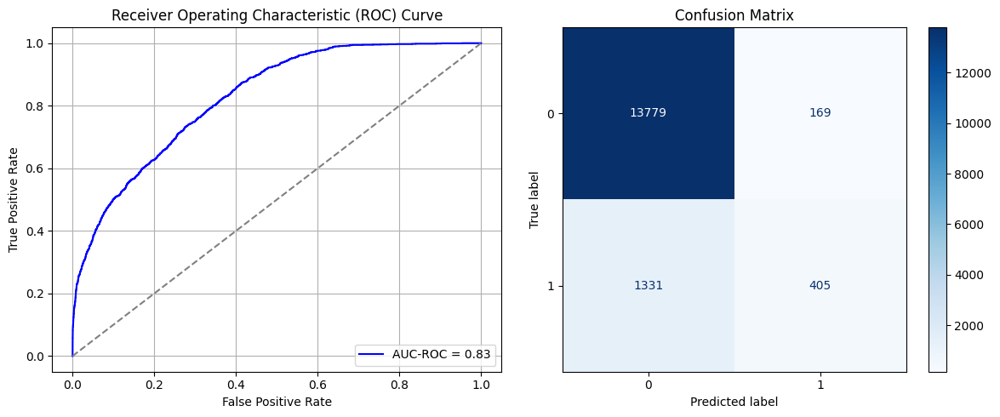

Best threshold based on F1-score: 0.201997309923172
False Negative Rate: 0.7667050691244239
Time elapsed (performance): 1.7158978500001467
(np.float64(0.012116432463435618), np.float64(0.9878835675365644))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7097 - loss: 0.6200 - val_AUC: 0.8574 - val_loss: 0.4729
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8639 - loss: 0.4593 - val_AUC: 0.8673 - val_loss: 0.4659
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8761 - loss: 0.4393 - val_AUC: 0.8674 - val_loss: 0.4476
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8743 - loss: 0.4380 - val_AUC: 0.8715 - val_loss: 0.4427
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8775 - loss: 0.4336 - val_AUC: 0.8718 - val_loss: 0.4419
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8759 - loss: 0.4344 - val_AUC: 0.8709 - val_loss: 0.4518
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8803 - loss: 0.4297 - val_AUC: 0.8732 - val_loss: 0.4396
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8790 - loss: 0.4284 - val_AUC: 0.8729 - val_loss: 0.4447
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8761 -

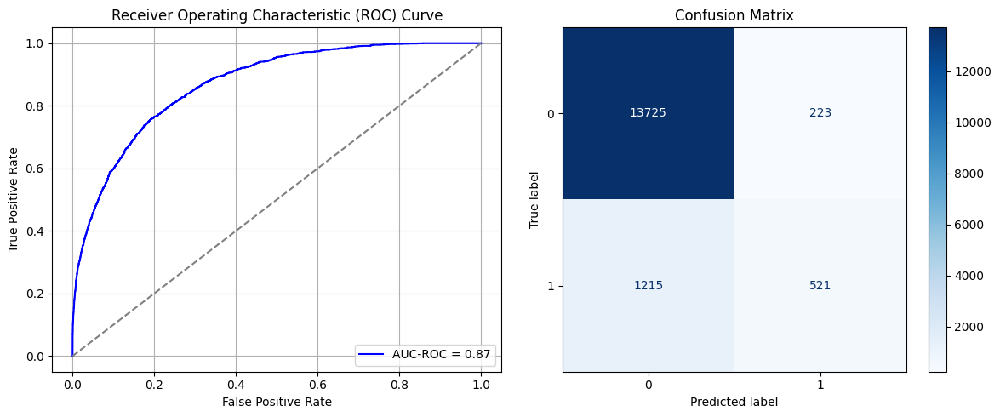

Best threshold based on F1-score: 0.18388080596923828
False Negative Rate: 0.6998847926267281
Time elapsed (performance): 1.7145203800000672
(np.float64(0.015987955262403212), np.float64(0.9840120447375967))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.6960 - loss: 0.6281 - val_AUC: 0.8490 - val_loss: 0.4855
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8598 - loss: 0.4676 - val_AUC: 0.8679 - val_loss: 0.4478
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8764 - loss: 0.4366 - val_AUC: 0.8712 - val_loss: 0.4489
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8791 - loss: 0.4316 - val_AUC: 0.8719 - val_loss: 0.4399
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8784 - loss: 0.4312 - val_AUC: 0.8726 - val_loss: 0.4396
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8782 - loss: 0.4330 - val_AUC: 0.8735 - val_loss: 0.4378
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8839 - loss: 0.4216 - val_AUC: 0.8734 - val_loss: 0.4380
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8814 - loss: 0.4267 - val_AUC: 0.8730 - val_loss: 0.4406
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8788 -

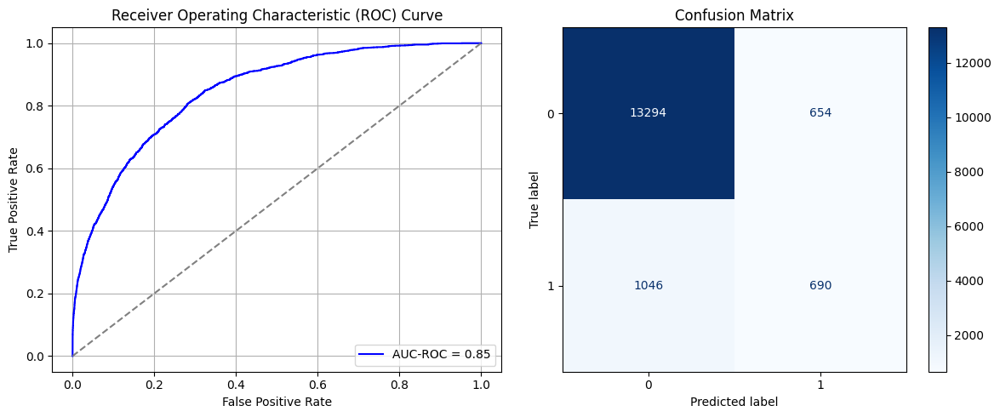

Best threshold based on F1-score: 0.32075825333595276
False Negative Rate: 0.6025345622119815
Time elapsed (performance): 2.2616862169998058
(np.float64(0.04688844278749642), np.float64(0.9531115572125036))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.7417 - loss: 0.6187 - val_AUC: 0.8610 - val_loss: 0.4716
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8540 - loss: 0.4714 - val_AUC: 0.8753 - val_loss: 0.4373
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8765 - loss: 0.4368 - val_AUC: 0.8785 - val_loss: 0.4385
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8698 - loss: 0.4437 - val_AUC: 0.8786 - val_loss: 0.4317
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8740 - loss: 0.4384 - val_AUC: 0.8803 - val_loss: 0.4279
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8778 - loss: 0.4337 - val_AUC: 0.8794 - val_loss: 0.4283
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8757 - loss: 0.4374 - val_AUC: 0.8787 - val_loss: 0.4336
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8780 - loss: 0.4311 - val_AUC: 0.8810 - val_loss: 0.4339
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8789 -

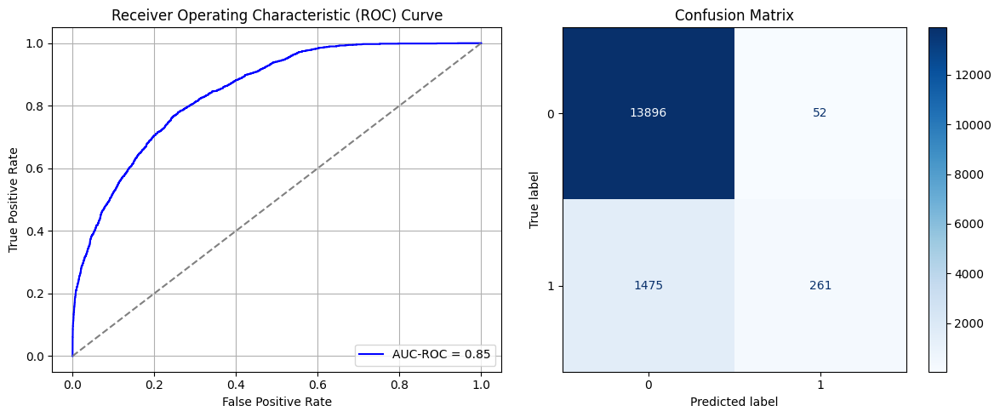

Best threshold based on F1-score: 0.139614075422287
False Negative Rate: 0.8496543778801844
Time elapsed (performance): 1.5654886749998695
(np.float64(0.003728133065672498), np.float64(0.9962718669343275))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7326 - loss: 0.6102 - val_AUC: 0.8624 - val_loss: 0.4814
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8580 - loss: 0.4669 - val_AUC: 0.8771 - val_loss: 0.4397
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8716 - loss: 0.4446 - val_AUC: 0.8787 - val_loss: 0.4496
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8738 - loss: 0.4396 - val_AUC: 0.8796 - val_loss: 0.4306
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8759 - loss: 0.4356 - val_AUC: 0.8800 - val_loss: 0.4301
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8797 - loss: 0.4304 - val_AUC: 0.8774 - val_loss: 0.4331
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8780 - loss: 0.4311 - val_AUC: 0.8801 - val_loss: 0.4289
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8767 - loss: 0.4329 - val_AUC: 0.8800 - val_loss: 0.4301
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8811 -

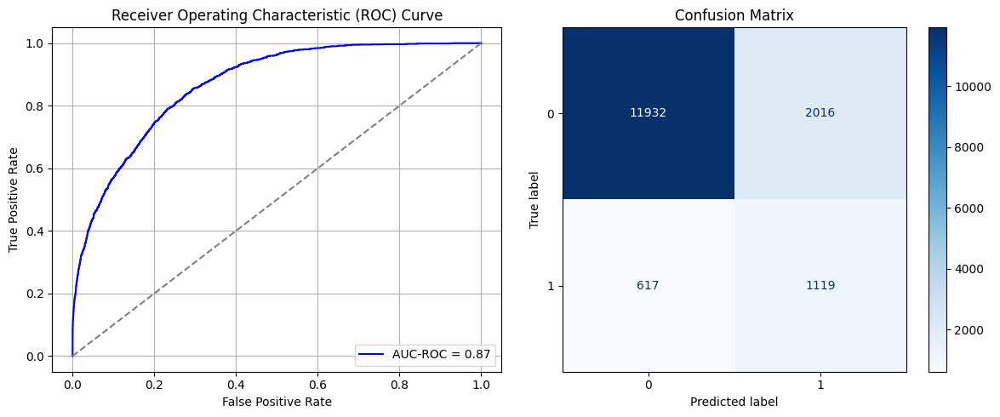

Best threshold based on F1-score: 0.6102211475372314
False Negative Rate: 0.3554147465437788
Time elapsed (performance): 1.7090445679996265
(np.float64(0.14453685116145684), np.float64(0.8554631488385431))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.7402 - loss: 0.6071 - val_AUC: 0.8559 - val_loss: 0.4752
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8610 - loss: 0.4654 - val_AUC: 0.8681 - val_loss: 0.4479
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8689 - loss: 0.4474 - val_AUC: 0.8676 - val_loss: 0.4851
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8784 - loss: 0.4321 - val_AUC: 0.8717 - val_loss: 0.4415
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8747 - loss: 0.4372 - val_AUC: 0.8717 - val_loss: 0.4413
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8757 - loss: 0.4353 - val_AUC: 0.8735 - val_loss: 0.4379
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8772 - loss: 0.4326 - val_AUC: 0.8747 - val_loss: 0.4399
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8789 - loss: 0.4313 - val_AUC: 0.8733 - val_loss: 0.4397
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8762 -

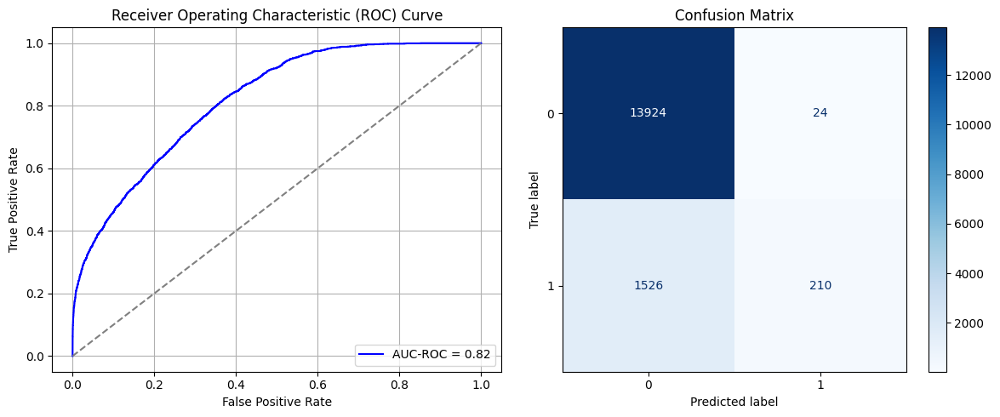

Best threshold based on F1-score: 0.06663531064987183
False Negative Rate: 0.8790322580645161
Time elapsed (performance): 1.7520087330003662
(np.float64(0.0017206767995411529), np.float64(0.9982793232004589))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.7373 - loss: 0.6132 - val_AUC: 0.8658 - val_loss: 0.4612
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8640 - loss: 0.4588 - val_AUC: 0.8792 - val_loss: 0.4424
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8672 - loss: 0.4501 - val_AUC: 0.8782 - val_loss: 0.4352
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8713 - loss: 0.4415 - val_AUC: 0.8811 - val_loss: 0.4294
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8761 - loss: 0.4349 - val_AUC: 0.8772 - val_loss: 0.4337
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8712 - loss: 0.4404 - val_AUC: 0.8801 - val_loss: 0.4364
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8707 - loss: 0.4424 - val_AUC: 0.8793 - val_loss: 0.4306
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8733 - loss: 0.4391 - val_AUC: 0.8800 - val_loss: 0.4290
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8763 -

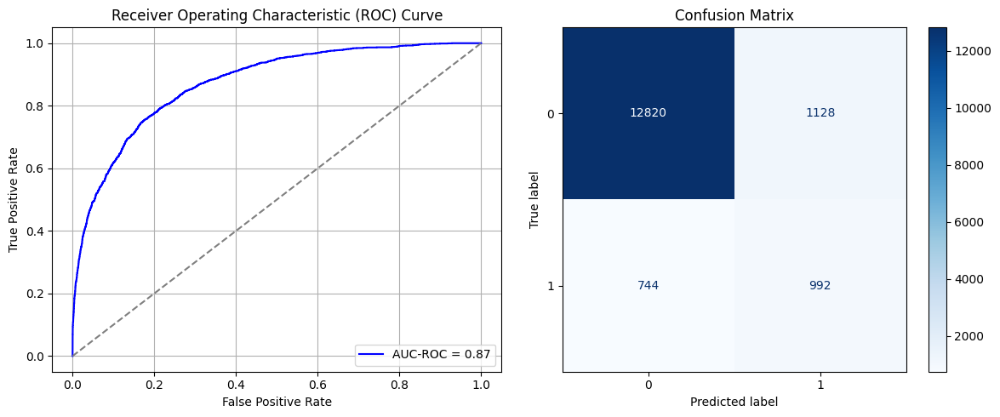

Best threshold based on F1-score: 0.5985592603683472
False Negative Rate: 0.42857142857142855
Time elapsed (performance): 1.7184237479996227
(np.float64(0.08087180957843418), np.float64(0.9191281904215658))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.6996 - loss: 0.6271 - val_AUC: 0.8651 - val_loss: 0.4724
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8599 - loss: 0.4652 - val_AUC: 0.8746 - val_loss: 0.4386
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8774 - loss: 0.4344 - val_AUC: 0.8781 - val_loss: 0.4330
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8718 - loss: 0.4419 - val_AUC: 0.8795 - val_loss: 0.4304
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8701 - loss: 0.4446 - val_AUC: 0.8808 - val_loss: 0.4275
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8763 - loss: 0.4350 - val_AUC: 0.8793 - val_loss: 0.4293
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8785 - loss: 0.4303 - val_AUC: 0.8804 - val_loss: 0.4310
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8764 - loss: 0.4340 - val_AUC: 0.8808 - val_loss: 0.4283
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8763 -

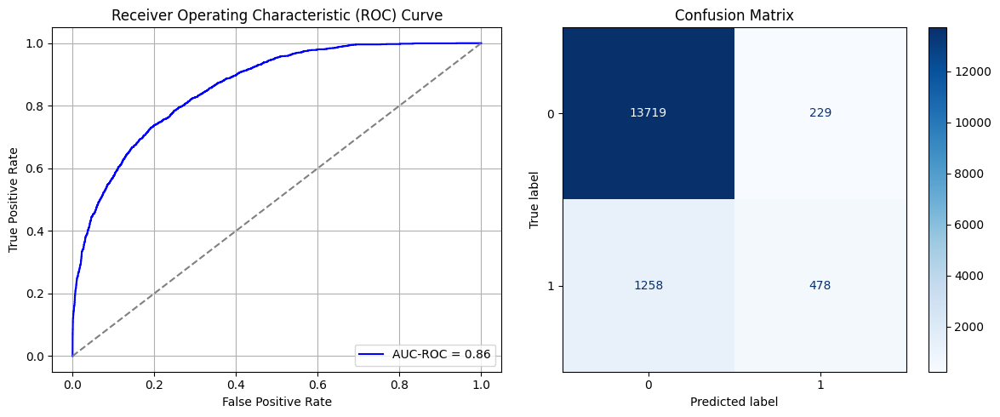

Best threshold based on F1-score: 0.2958486080169678
False Negative Rate: 0.7246543778801844
Time elapsed (performance): 1.7143466460001946
(np.float64(0.016418124462288502), np.float64(0.9835818755377115))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.7378 - loss: 0.6101 - val_AUC: 0.8500 - val_loss: 0.4785
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8673 - loss: 0.4544 - val_AUC: 0.8688 - val_loss: 0.4465
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8692 - loss: 0.4459 - val_AUC: 0.8704 - val_loss: 0.4615
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8729 - loss: 0.4416 - val_AUC: 0.8726 - val_loss: 0.4401
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8798 - loss: 0.4296 - val_AUC: 0.8722 - val_loss: 0.4397
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8776 - loss: 0.4340 - val_AUC: 0.8730 - val_loss: 0.4393
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8835 - loss: 0.4240 - val_AUC: 0.8737 - val_loss: 0.4406
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8788 - loss: 0.4306 - val_AUC: 0.8722 - val_loss: 0.4396
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8842 -

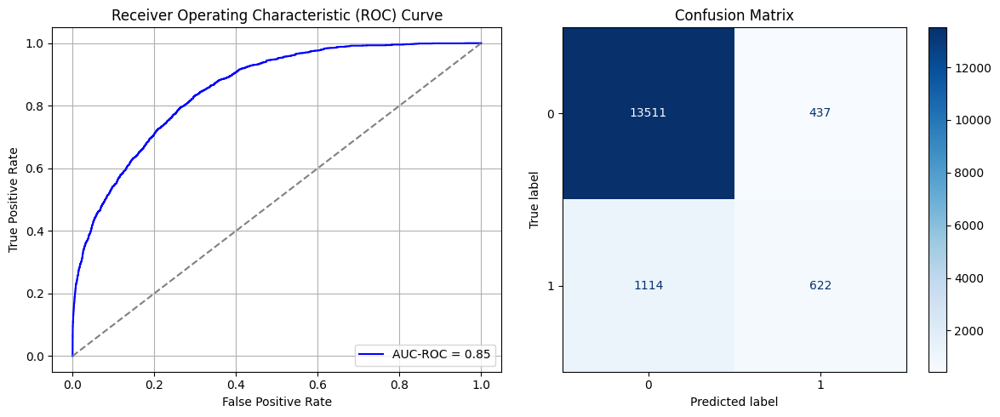

Best threshold based on F1-score: 0.3832845389842987
False Negative Rate: 0.6417050691244239
Time elapsed (performance): 1.7324918309996065
(np.float64(0.03133065672497849), np.float64(0.9686693432750215))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7284 - loss: 0.6155 - val_AUC: 0.8616 - val_loss: 0.4664
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8544 - loss: 0.4701 - val_AUC: 0.8757 - val_loss: 0.4365
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8691 - loss: 0.4461 - val_AUC: 0.8775 - val_loss: 0.4363
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8729 - loss: 0.4393 - val_AUC: 0.8791 - val_loss: 0.4318
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8754 - loss: 0.4369 - val_AUC: 0.8792 - val_loss: 0.4380
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8760 - loss: 0.4344 - val_AUC: 0.8780 - val_loss: 0.4310
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8715 - loss: 0.4407 - val_AUC: 0.8801 - val_loss: 0.4290
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8760 - loss: 0.4362 - val_AUC: 0.8780 - val_loss: 0.4314
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8785 -

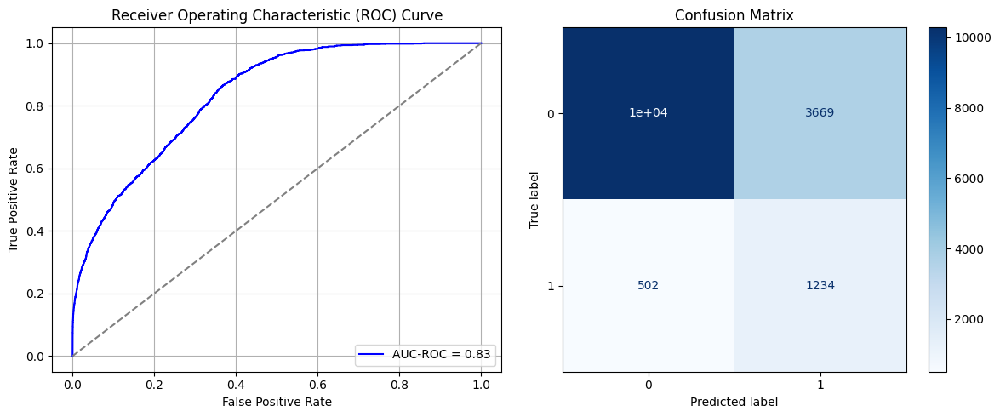

Best threshold based on F1-score: 0.747157096862793
False Negative Rate: 0.2891705069124424
Time elapsed (performance): 1.5356887560001269
(np.float64(0.26304846572985374), np.float64(0.7369515342701463))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7157 - loss: 0.6227 - val_AUC: 0.8436 - val_loss: 0.4871
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8610 - loss: 0.4645 - val_AUC: 0.8651 - val_loss: 0.4523
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8730 - loss: 0.4426 - val_AUC: 0.8692 - val_loss: 0.4575
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8755 - loss: 0.4378 - val_AUC: 0.8696 - val_loss: 0.4500
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8736 - loss: 0.4387 - val_AUC: 0.8710 - val_loss: 0.4424
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8705 - loss: 0.4442 - val_AUC: 0.8731 - val_loss: 0.4381
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8741 - loss: 0.4377 - val_AUC: 0.8718 - val_loss: 0.4503
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8787 - loss: 0.4306 - val_AUC: 0.8728 - val_loss: 0.4395
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8780 -

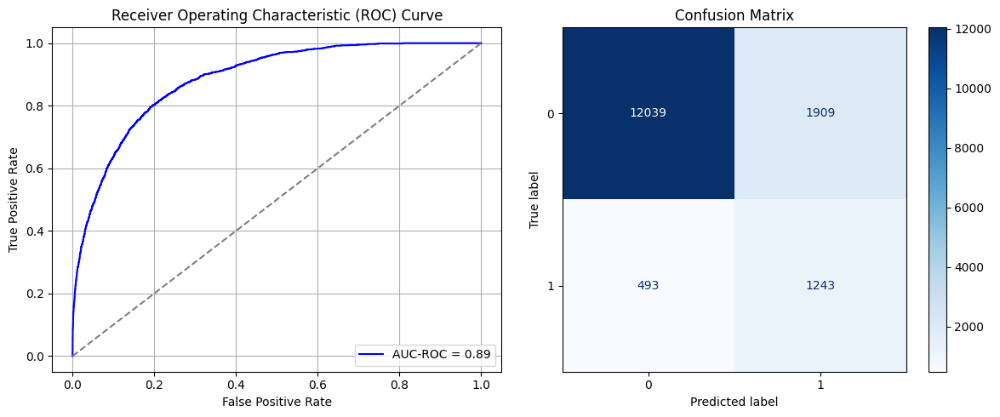

Best threshold based on F1-score: 0.5949735641479492
False Negative Rate: 0.28398617511520735
Time elapsed (performance): 1.706161295000129
(np.float64(0.1368655004301692), np.float64(0.8631344995698308))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - AUC: 0.7289 - loss: 0.6125 - val_AUC: 0.8363 - val_loss: 0.4961
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8504 - loss: 0.4807 - val_AUC: 0.8651 - val_loss: 0.4546
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8726 - loss: 0.4437 - val_AUC: 0.8713 - val_loss: 0.4578
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8771 - loss: 0.4324 - val_AUC: 0.8714 - val_loss: 0.4449
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8696 - loss: 0.4427 - val_AUC: 0.8716 - val_loss: 0.4417
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8813 - loss: 0.4280 - val_AUC: 0.8730 - val_loss: 0.4481
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8806 - loss: 0.4276 - val_AUC: 0.8712 - val_loss: 0.4450
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8772 - loss: 0.4328 - val_AUC: 0.8732 - val_loss: 0.4398
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8791 -

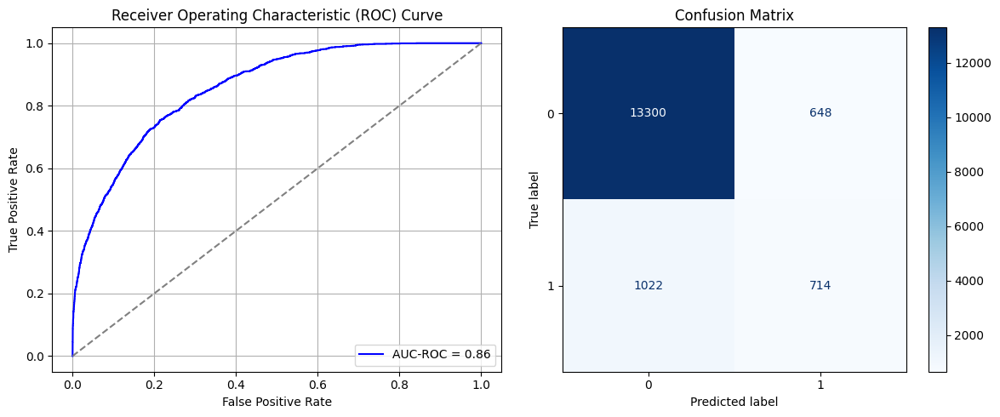

Best threshold based on F1-score: 0.39240729808807373
False Negative Rate: 0.5887096774193549
Time elapsed (performance): 1.6060791859999881
(np.float64(0.04645827358761113), np.float64(0.9535417264123889))
    Source time       FPR       TNR       FNR       TPR  Target time
0     24.859133  0.092128  0.907872  0.452765  0.547235     1.200682
1     17.378407  0.007169  0.992831  0.820276  0.179724     3.100859
2     24.079753  0.020792  0.979208  0.779954  0.220046     1.730450
3     21.433805  0.036206  0.963794  0.600230  0.399770     1.701204
4     21.860353  0.013622  0.986378  0.804724  0.195276     1.302336
5     20.362099  0.034700  0.965300  0.593318  0.406682     1.814125
6     20.631769  0.014411  0.985589  0.682604  0.317396     1.712644
7     21.371495  0.226484  0.773516  0.367512  0.632488     1.265866
8     23.465212  0.038357  0.961643  0.701613  0.298387     1.289382
9     23.069706  0.038572  0.961428  0.614631  0.385369     1.270153
10    22.754802  0.012045  0.98795

In [49]:
import random

times = 50

Training_time = []
FPR = []
TPR = []
FNR = []
TNR = []
TL_time = []

k = oversample_size/undersample_size
print(k)

# np.random.seed(123)

for i in range(times):
    start = random.randint(1, int(k))
    # print(start)

    Row = []

    for j in range(undersample_size):
      row = start+int(k*j)-1
      Row.append(row)

    # print(Row)

    data_S_maj_rus = pd.DataFrame()
    data_S_maj_rus = data_S_majority.iloc[Row]

    data_S_Sy_RUS = pd.concat([data_S_maj_rus, data_S_minority])
    X_S_Sy = data_S_Sy_RUS.iloc[:, :-1]
    y_S_Sy = data_S_Sy_RUS.iloc[:, -1]
    X_S_train, X_S_test, y_S_train, y_S_test = train_test_split(X_S_Sy, y_S_Sy, test_size=0.20, random_state=0)
    model_Sy = create_dnn_model(X_S_train.shape[1])
    result_Sy = train_and_evaluate(model_Sy, X_S_train, X_S_test, y_S_train, y_S_test, "Source")
    result_TL_Sy = Transductive_TL(model_Sy, X_T_full, y_T_full, "Target")
    print(result_TL_Sy[0:2])

    Training_time.append(result_Sy)
    FPR.append(result_TL_Sy[0])
    TNR.append(result_TL_Sy[1])
    FNR.append(result_TL_Sy[2])
    TPR.append(result_TL_Sy[3])
    TL_time.append(result_TL_Sy[4])

# return fpr, tnr, fnr, tpr, time_elapsed

# print(TNR)

ParamFit = pd.DataFrame([Training_time, FPR, TNR, FNR, TPR, TL_time]).T
ParamFit.columns=['Source time', 'FPR', 'TNR', 'FNR', 'TPR', 'Target time']
print(ParamFit)


In [50]:
print(ParamFit)
ParamFit.to_csv('Sy_RUS.csv')

    Source time       FPR       TNR       FNR       TPR  Target time
0     24.859133  0.092128  0.907872  0.452765  0.547235     1.200682
1     17.378407  0.007169  0.992831  0.820276  0.179724     3.100859
2     24.079753  0.020792  0.979208  0.779954  0.220046     1.730450
3     21.433805  0.036206  0.963794  0.600230  0.399770     1.701204
4     21.860353  0.013622  0.986378  0.804724  0.195276     1.302336
5     20.362099  0.034700  0.965300  0.593318  0.406682     1.814125
6     20.631769  0.014411  0.985589  0.682604  0.317396     1.712644
7     21.371495  0.226484  0.773516  0.367512  0.632488     1.265866
8     23.465212  0.038357  0.961643  0.701613  0.298387     1.289382
9     23.069706  0.038572  0.961428  0.614631  0.385369     1.270153
10    22.754802  0.012045  0.987955  0.670507  0.329493     1.288950
11    23.013718  0.007815  0.992185  0.777650  0.222350     1.276615
12    18.895247  0.001577  0.998423  0.876728  0.123272     1.534250
13    20.730128  0.025882  0.97411

In [51]:
ParamFit['FNR'].mean()

np.float64(0.6498387096774194)

In [52]:
ParamFit['Source time'].mean()

np.float64(23.97279763564)

## Systematic Sampling (multiple samples):

Now, we investigate the possibility of conducting $m$ systematic samples, each with a sampling interval of $k=m*\frac{N_0}{N_1}$, and obtaining the undersampled majority class data using all $m$ systematic samples combined. This may more closely approximate SRS sampling.

For convenience, we take $m=10$ in this case.

22.5721570627231
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - AUC: 0.7178 - loss: 0.6161 - val_AUC: 0.8609 - val_loss: 0.4763
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8591 - loss: 0.4662 - val_AUC: 0.8769 - val_loss: 0.4504
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8758 - loss: 0.4379 - val_AUC: 0.8787 - val_loss: 0.4394
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8711 - loss: 0.4452 - val_AUC: 0.8784 - val_loss: 0.4345
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8779 - loss: 0.4332 - val_AUC: 0.8803 - val_loss: 0.4317
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8732 - loss: 0.4399 - val_AUC: 0.8794 - val_loss: 0.4325
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8705 - loss: 0.4460 - val_AUC: 0.8808 - val_loss: 0.4303
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8810 - loss: 0.4282 - val_AUC: 0.8806 - val_loss: 0.4317
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8855 -

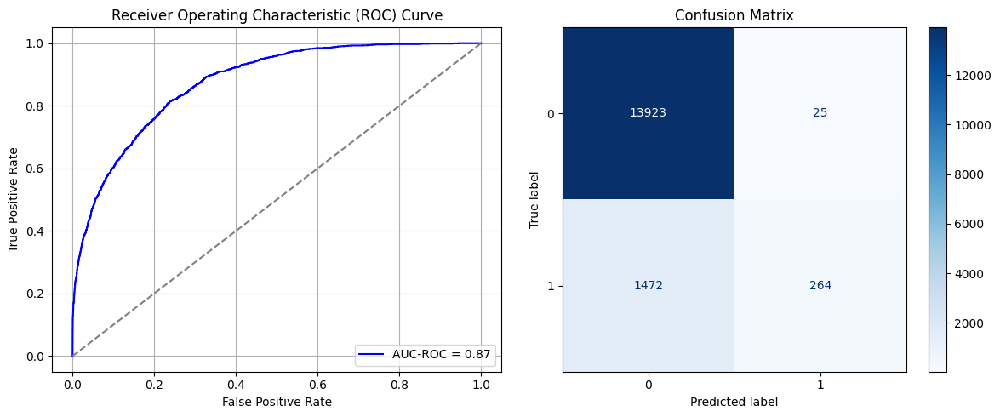

Best threshold based on F1-score: 0.08740422874689102
False Negative Rate: 0.847926267281106
Time elapsed (performance): 1.2187946989997727
(np.float64(0.0017923716661887008), np.float64(0.9982076283338113))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.6965 - loss: 0.6339 - val_AUC: 0.8492 - val_loss: 0.5038
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8517 - loss: 0.4803 - val_AUC: 0.8751 - val_loss: 0.4419
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8720 - loss: 0.4439 - val_AUC: 0.8757 - val_loss: 0.4427
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8724 - loss: 0.4396 - val_AUC: 0.8783 - val_loss: 0.4355
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8746 - loss: 0.4368 - val_AUC: 0.8789 - val_loss: 0.4407
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8769 - loss: 0.4330 - val_AUC: 0.8785 - val_loss: 0.4335
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8773 - loss: 0.4334 - val_AUC: 0.8793 - val_loss: 0.4321
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8755 - loss: 0.4351 - val_AUC: 0.8799 - val_loss: 0.4325
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8842 -

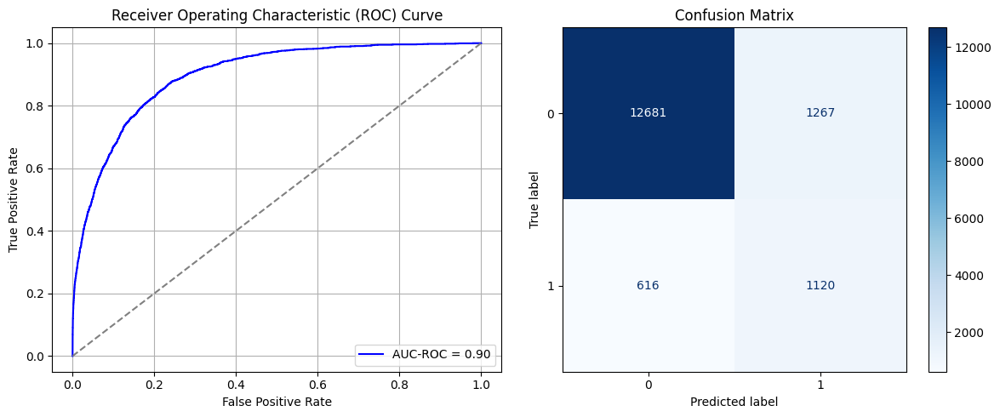

Best threshold based on F1-score: 0.5294814705848694
False Negative Rate: 0.3548387096774194
Time elapsed (performance): 1.2082181300002048
(np.float64(0.09083739604244336), np.float64(0.9091626039575567))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.7454 - loss: 0.6168 - val_AUC: 0.8546 - val_loss: 0.4928
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8569 - loss: 0.4672 - val_AUC: 0.8689 - val_loss: 0.4481
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8737 - loss: 0.4391 - val_AUC: 0.8695 - val_loss: 0.4469
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8748 - loss: 0.4382 - val_AUC: 0.8709 - val_loss: 0.4434
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8668 - loss: 0.4511 - val_AUC: 0.8717 - val_loss: 0.4662
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8719 - loss: 0.4412 - val_AUC: 0.8717 - val_loss: 0.4657
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8764 - loss: 0.4349 - val_AUC: 0.8724 - val_loss: 0.4414
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8700 - loss: 0.4433 - val_AUC: 0.8727 - val_loss: 0.4463
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8754 -

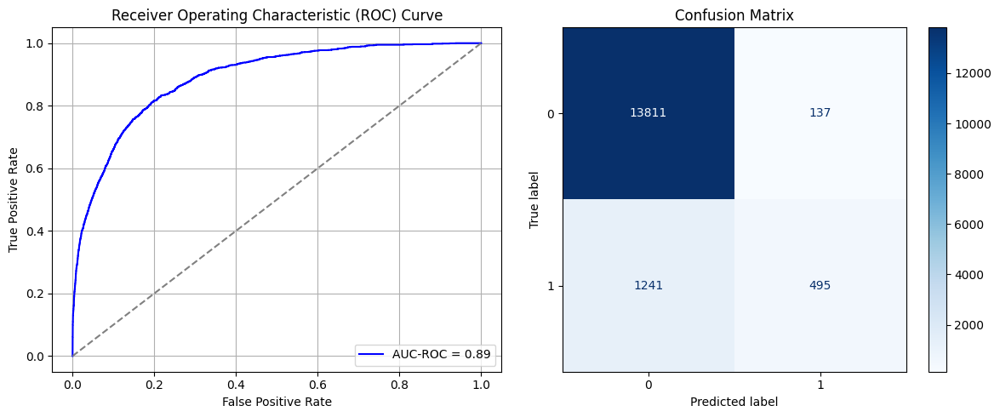

Best threshold based on F1-score: 0.18196330964565277
False Negative Rate: 0.7148617511520737
Time elapsed (performance): 1.7000178099997356
(np.float64(0.009822196730714081), np.float64(0.990177803269286))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7246 - loss: 0.6193 - val_AUC: 0.8578 - val_loss: 0.4679
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8580 - loss: 0.4666 - val_AUC: 0.8712 - val_loss: 0.4682
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8690 - loss: 0.4453 - val_AUC: 0.8740 - val_loss: 0.4392
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8708 - loss: 0.4420 - val_AUC: 0.8748 - val_loss: 0.4396
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8770 - loss: 0.4338 - val_AUC: 0.8752 - val_loss: 0.4410
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8716 - loss: 0.4398 - val_AUC: 0.8754 - val_loss: 0.4385
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8800 - loss: 0.4287 - val_AUC: 0.8753 - val_loss: 0.4375
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8736 - loss: 0.4391 - val_AUC: 0.8770 - val_loss: 0.4346
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8795 -

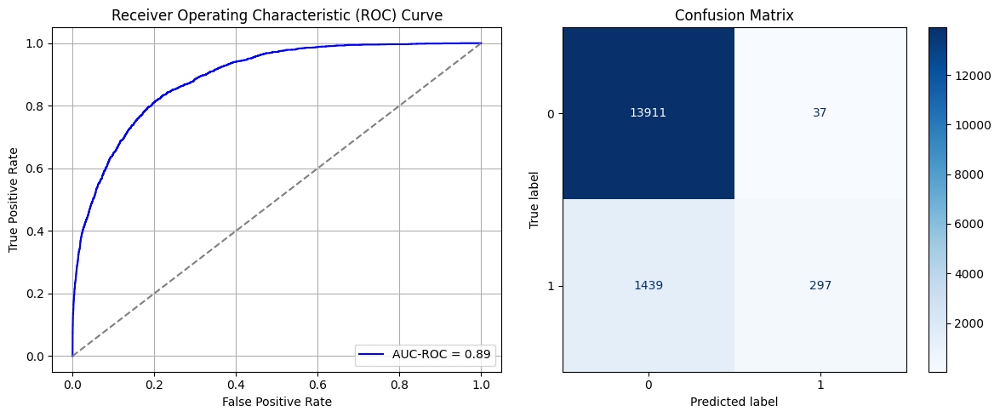

Best threshold based on F1-score: 0.09515544772148132
False Negative Rate: 0.8289170506912442
Time elapsed (performance): 1.701077085000179
(np.float64(0.0026527100659592775), np.float64(0.9973472899340408))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.6995 - loss: 0.6284 - val_AUC: 0.8704 - val_loss: 0.4649
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8538 - loss: 0.4739 - val_AUC: 0.8800 - val_loss: 0.4365
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8643 - loss: 0.4554 - val_AUC: 0.8819 - val_loss: 0.4342
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8729 - loss: 0.4424 - val_AUC: 0.8829 - val_loss: 0.4289
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8725 - loss: 0.4418 - val_AUC: 0.8850 - val_loss: 0.4237
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8742 - loss: 0.4385 - val_AUC: 0.8832 - val_loss: 0.4265
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8801 - loss: 0.4300 - val_AUC: 0.8832 - val_loss: 0.4342
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8718 - loss: 0.4414 - val_AUC: 0.8845 - val_loss: 0.4259
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8744 -

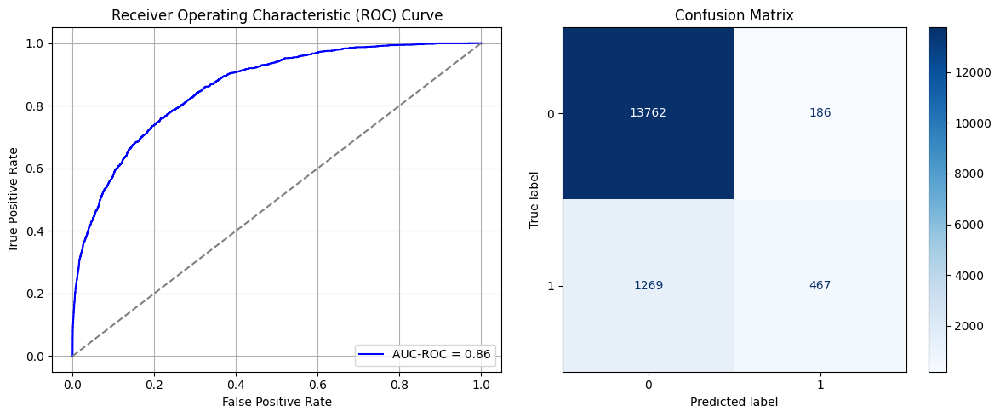

Best threshold based on F1-score: 0.2116679549217224
False Negative Rate: 0.7309907834101382
Time elapsed (performance): 1.6916837939998004
(np.float64(0.013335245196443935), np.float64(0.9866647548035561))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7023 - loss: 0.6236 - val_AUC: 0.8637 - val_loss: 0.4752
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8593 - loss: 0.4653 - val_AUC: 0.8748 - val_loss: 0.4473
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8644 - loss: 0.4531 - val_AUC: 0.8756 - val_loss: 0.4560
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8731 - loss: 0.4403 - val_AUC: 0.8772 - val_loss: 0.4361
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8745 - loss: 0.4368 - val_AUC: 0.8775 - val_loss: 0.4363
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8758 - loss: 0.4333 - val_AUC: 0.8770 - val_loss: 0.4381
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8739 - loss: 0.4379 - val_AUC: 0.8774 - val_loss: 0.4333
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8782 - loss: 0.4306 - val_AUC: 0.8768 - val_loss: 0.4359
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8776 -

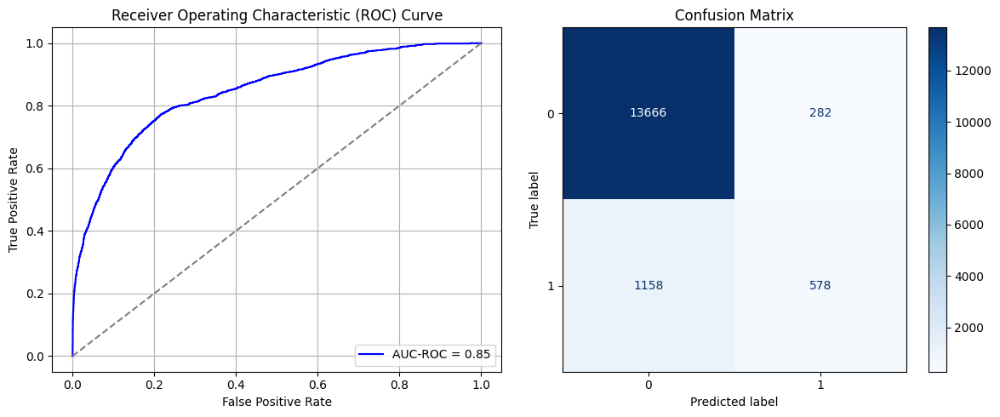

Best threshold based on F1-score: 0.3086547553539276
False Negative Rate: 0.6670506912442397
Time elapsed (performance): 1.2308970320000299
(np.float64(0.020217952394608545), np.float64(0.9797820476053914))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7135 - loss: 0.6270 - val_AUC: 0.8485 - val_loss: 0.4933
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8502 - loss: 0.4784 - val_AUC: 0.8686 - val_loss: 0.4726
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8555 - loss: 0.4650 - val_AUC: 0.8711 - val_loss: 0.4466
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8697 - loss: 0.4443 - val_AUC: 0.8707 - val_loss: 0.4690
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8718 - loss: 0.4422 - val_AUC: 0.8714 - val_loss: 0.4491
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8778 - loss: 0.4320 - val_AUC: 0.8726 - val_loss: 0.4449
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8743 - loss: 0.4355 - val_AUC: 0.8727 - val_loss: 0.4434
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8774 - loss: 0.4348 - val_AUC: 0.8737 - val_loss: 0.4423
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8733 -

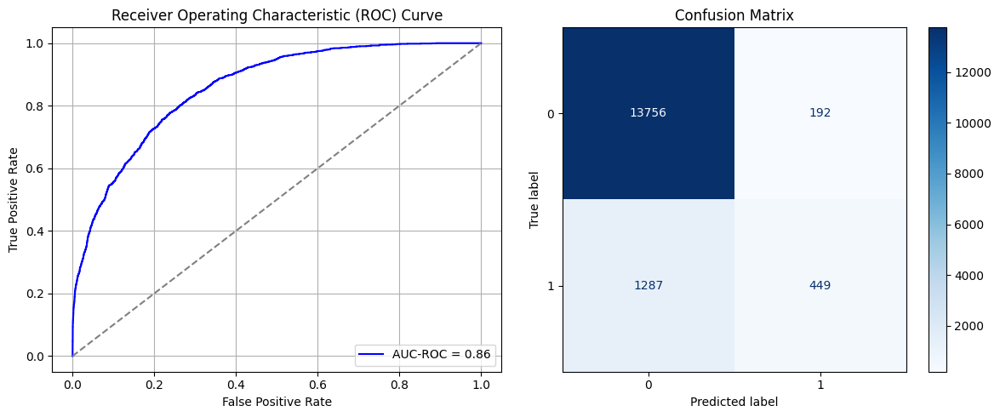

Best threshold based on F1-score: 0.21187737584114075
False Negative Rate: 0.7413594470046083
Time elapsed (performance): 1.8999388009997347
(np.float64(0.013765414396329223), np.float64(0.9862345856036707))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7204 - loss: 0.6324 - val_AUC: 0.8599 - val_loss: 0.4782
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8548 - loss: 0.4731 - val_AUC: 0.8805 - val_loss: 0.4340
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8741 - loss: 0.4380 - val_AUC: 0.8828 - val_loss: 0.4321
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8756 - loss: 0.4374 - val_AUC: 0.8825 - val_loss: 0.4296
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8769 - loss: 0.4330 - val_AUC: 0.8840 - val_loss: 0.4303
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8774 - loss: 0.4332 - val_AUC: 0.8841 - val_loss: 0.4308
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8798 - loss: 0.4286 - val_AUC: 0.8849 - val_loss: 0.4239
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8761 - loss: 0.4338 - val_AUC: 0.8849 - val_loss: 0.4426
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8841 -

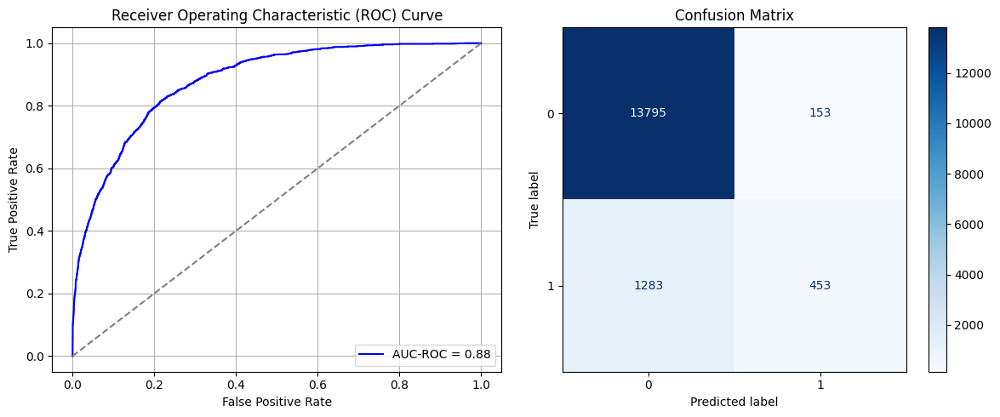

Best threshold based on F1-score: 0.21946358680725098
False Negative Rate: 0.7390552995391705
Time elapsed (performance): 1.6832072049992348
(np.float64(0.010969314597074849), np.float64(0.9890306854029252))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7435 - loss: 0.6120 - val_AUC: 0.8626 - val_loss: 0.4709
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8558 - loss: 0.4700 - val_AUC: 0.8797 - val_loss: 0.4375
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8752 - loss: 0.4372 - val_AUC: 0.8823 - val_loss: 0.4377
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8762 - loss: 0.4347 - val_AUC: 0.8828 - val_loss: 0.4327
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8789 - loss: 0.4289 - val_AUC: 0.8824 - val_loss: 0.4395
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8764 - loss: 0.4337 - val_AUC: 0.8830 - val_loss: 0.4299
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8798 - loss: 0.4282 - val_AUC: 0.8826 - val_loss: 0.4277
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8775 - loss: 0.4307 - val_AUC: 0.8814 - val_loss: 0.4351
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8807 -

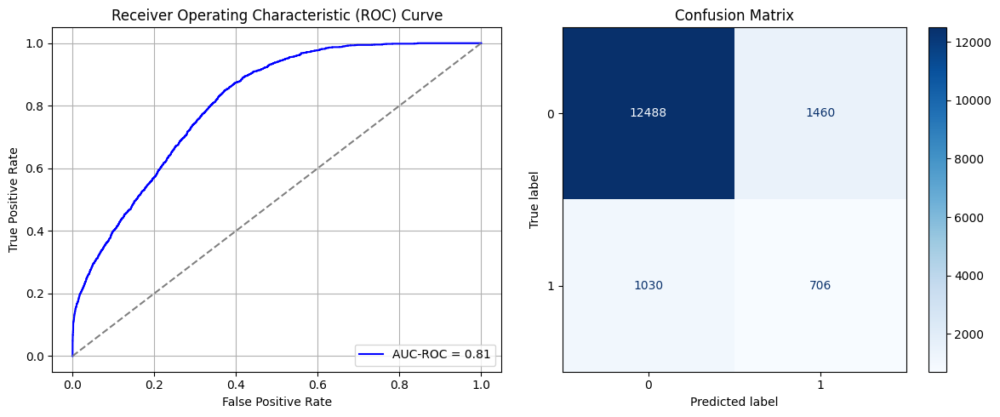

Best threshold based on F1-score: 0.39179396629333496
False Negative Rate: 0.5933179723502304
Time elapsed (performance): 1.6906197509997583
(np.float64(0.10467450530542013), np.float64(0.8953254946945799))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7613 - loss: 0.6048 - val_AUC: 0.8724 - val_loss: 0.4610
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8562 - loss: 0.4687 - val_AUC: 0.8809 - val_loss: 0.4356
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8624 - loss: 0.4553 - val_AUC: 0.8825 - val_loss: 0.4306
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8660 - loss: 0.4495 - val_AUC: 0.8836 - val_loss: 0.4277
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8684 - loss: 0.4463 - val_AUC: 0.8851 - val_loss: 0.4261
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8798 - loss: 0.4293 - val_AUC: 0.8852 - val_loss: 0.4265
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8752 - loss: 0.4367 - val_AUC: 0.8861 - val_loss: 0.4242
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8713 - loss: 0.4405 - val_AUC: 0.8859 - val_loss: 0.4290
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8755 -

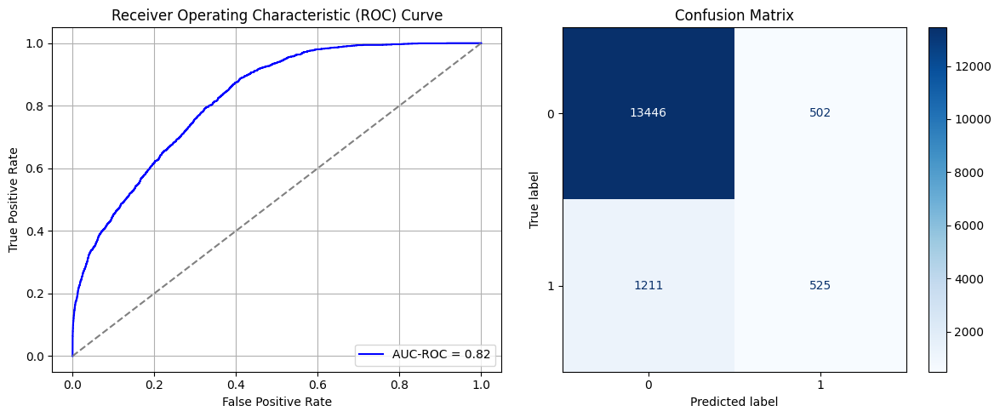

Best threshold based on F1-score: 0.3744264543056488
False Negative Rate: 0.6975806451612904
Time elapsed (performance): 1.2344117220000044
(np.float64(0.03599082305706911), np.float64(0.9640091769429309))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.7331 - loss: 0.6138 - val_AUC: 0.8638 - val_loss: 0.4669
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8426 - loss: 0.4840 - val_AUC: 0.8839 - val_loss: 0.4294
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8704 - loss: 0.4445 - val_AUC: 0.8845 - val_loss: 0.4328
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8662 - loss: 0.4480 - val_AUC: 0.8864 - val_loss: 0.4261
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8709 - loss: 0.4427 - val_AUC: 0.8862 - val_loss: 0.4216
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8763 - loss: 0.4323 - val_AUC: 0.8862 - val_loss: 0.4217
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8689 - loss: 0.4440 - val_AUC: 0.8871 - val_loss: 0.4211
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8725 - loss: 0.4415 - val_AUC: 0.8840 - val_loss: 0.4296
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8773 -

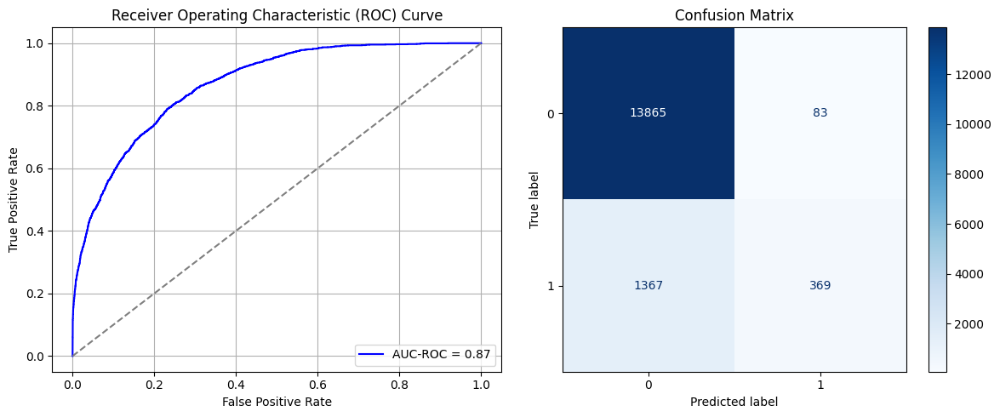

Best threshold based on F1-score: 0.14118345081806183
False Negative Rate: 0.7874423963133641
Time elapsed (performance): 1.8393232109992823
(np.float64(0.005950673931746487), np.float64(0.9940493260682535))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7444 - loss: 0.6148 - val_AUC: 0.8656 - val_loss: 0.4676
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8537 - loss: 0.4762 - val_AUC: 0.8795 - val_loss: 0.4441
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8684 - loss: 0.4481 - val_AUC: 0.8814 - val_loss: 0.4286
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8737 - loss: 0.4377 - val_AUC: 0.8833 - val_loss: 0.4272
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8775 - loss: 0.4323 - val_AUC: 0.8844 - val_loss: 0.4245
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8756 - loss: 0.4344 - val_AUC: 0.8839 - val_loss: 0.4242
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8737 - loss: 0.4368 - val_AUC: 0.8856 - val_loss: 0.4232
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8799 - loss: 0.4281 - val_AUC: 0.8854 - val_loss: 0.4218
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8747 -

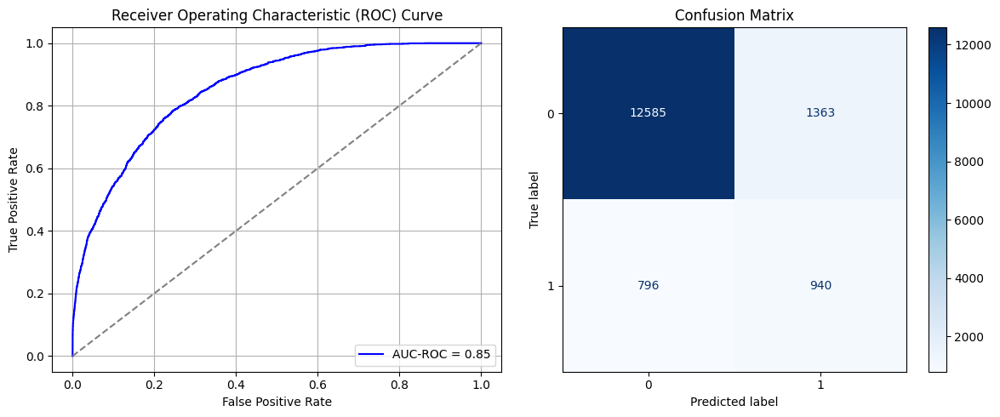

Best threshold based on F1-score: 0.5006883144378662
False Negative Rate: 0.45852534562211983
Time elapsed (performance): 1.290792429999783
(np.float64(0.09772010324060797), np.float64(0.902279896759392))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7418 - loss: 0.6095 - val_AUC: 0.8703 - val_loss: 0.4612
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8595 - loss: 0.4656 - val_AUC: 0.8831 - val_loss: 0.4294
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8674 - loss: 0.4466 - val_AUC: 0.8833 - val_loss: 0.4250
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8729 - loss: 0.4395 - val_AUC: 0.8843 - val_loss: 0.4236
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8728 - loss: 0.4387 - val_AUC: 0.8848 - val_loss: 0.4265
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8704 - loss: 0.4422 - val_AUC: 0.8853 - val_loss: 0.4234
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8765 - loss: 0.4348 - val_AUC: 0.8856 - val_loss: 0.4207
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8736 - loss: 0.4368 - val_AUC: 0.8856 - val_loss: 0.4199
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8738 -

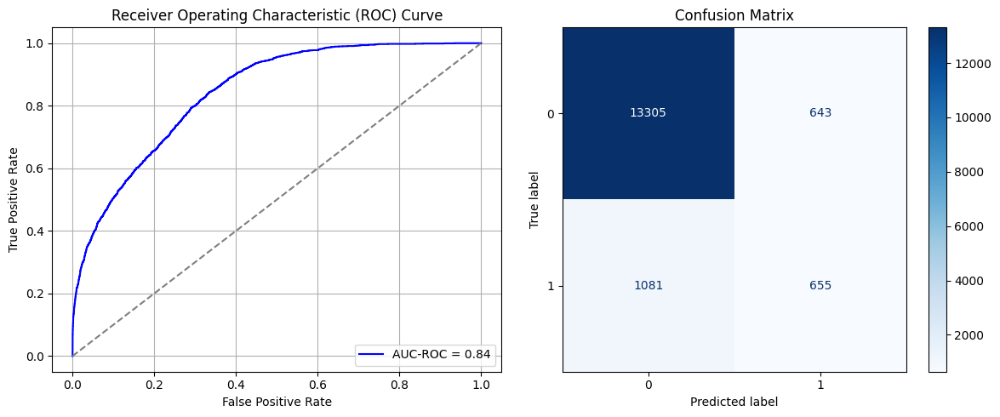

Best threshold based on F1-score: 0.443157821893692
False Negative Rate: 0.6226958525345622
Time elapsed (performance): 4.011155496000356
(np.float64(0.04609979925437339), np.float64(0.9539002007456266))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7386 - loss: 0.6129 - val_AUC: 0.8602 - val_loss: 0.4733
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8558 - loss: 0.4699 - val_AUC: 0.8748 - val_loss: 0.4425
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8696 - loss: 0.4462 - val_AUC: 0.8753 - val_loss: 0.4472
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8724 - loss: 0.4401 - val_AUC: 0.8763 - val_loss: 0.4405
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8765 - loss: 0.4329 - val_AUC: 0.8751 - val_loss: 0.4433
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8836 - loss: 0.4248 - val_AUC: 0.8764 - val_loss: 0.4425
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8744 - loss: 0.4373 - val_AUC: 0.8785 - val_loss: 0.4349
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8784 - loss: 0.4324 - val_AUC: 0.8784 - val_loss: 0.4496
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8809 -

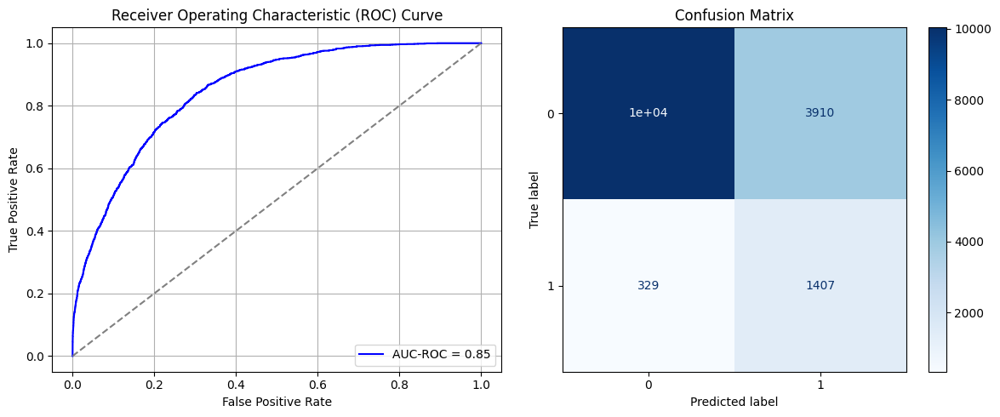

Best threshold based on F1-score: 0.7534924745559692
False Negative Rate: 0.18951612903225806
Time elapsed (performance): 1.331966106999971
(np.float64(0.2803269285919128), np.float64(0.7196730714080872))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.6996 - loss: 0.6377 - val_AUC: 0.8479 - val_loss: 0.4953
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8466 - loss: 0.4857 - val_AUC: 0.8724 - val_loss: 0.4443
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8616 - loss: 0.4552 - val_AUC: 0.8755 - val_loss: 0.4388
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8778 - loss: 0.4312 - val_AUC: 0.8740 - val_loss: 0.4421
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8771 - loss: 0.4343 - val_AUC: 0.8770 - val_loss: 0.4399
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - AUC: 0.8822 - loss: 0.4247 - val_AUC: 0.8785 - val_loss: 0.4392
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8752 - loss: 0.4362 - val_AUC: 0.8777 - val_loss: 0.4361
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8743 - loss: 0.4366 - val_AUC: 0.8778 - val_loss: 0.4413
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8805 -

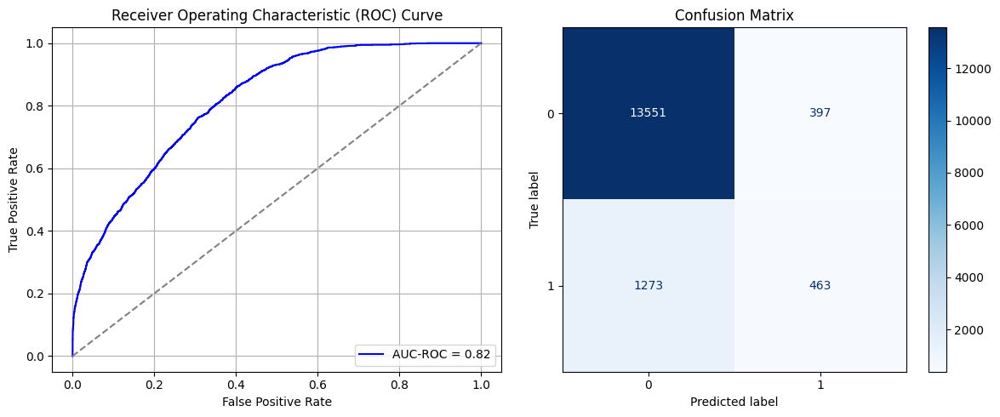

Best threshold based on F1-score: 0.28874731063842773
False Negative Rate: 0.7332949308755761
Time elapsed (performance): 1.7334294700003738
(np.float64(0.02846286205907657), np.float64(0.9715371379409234))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.7543 - loss: 0.5990 - val_AUC: 0.8701 - val_loss: 0.4568
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8633 - loss: 0.4587 - val_AUC: 0.8796 - val_loss: 0.4356
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8710 - loss: 0.4458 - val_AUC: 0.8819 - val_loss: 0.4335
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8713 - loss: 0.4430 - val_AUC: 0.8835 - val_loss: 0.4354
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8726 - loss: 0.4395 - val_AUC: 0.8845 - val_loss: 0.4365
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8702 - loss: 0.4461 - val_AUC: 0.8821 - val_loss: 0.4281
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8742 - loss: 0.4372 - val_AUC: 0.8851 - val_loss: 0.4300
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8781 - loss: 0.4313 - val_AUC: 0.8854 - val_loss: 0.4237
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - AUC: 0.8768 -

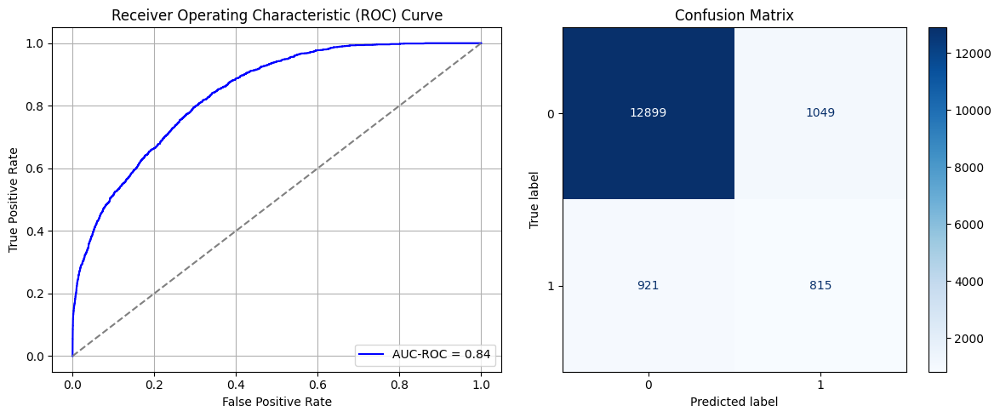

Best threshold based on F1-score: 0.49462389945983887
False Negative Rate: 0.5305299539170507
Time elapsed (performance): 1.7163145149997945
(np.float64(0.07520791511327789), np.float64(0.9247920848867222))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.6992 - loss: 0.6251 - val_AUC: 0.8477 - val_loss: 0.4824
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8584 - loss: 0.4670 - val_AUC: 0.8679 - val_loss: 0.4510
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8708 - loss: 0.4453 - val_AUC: 0.8691 - val_loss: 0.4488
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8707 - loss: 0.4442 - val_AUC: 0.8707 - val_loss: 0.4492
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8684 - loss: 0.4478 - val_AUC: 0.8717 - val_loss: 0.4623
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - AUC: 0.8737 - loss: 0.4386 - val_AUC: 0.8729 - val_loss: 0.4729
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8776 - loss: 0.4340 - val_AUC: 0.8716 - val_loss: 0.4469
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8783 - loss: 0.4298 - val_AUC: 0.8737 - val_loss: 0.4434
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8777 -

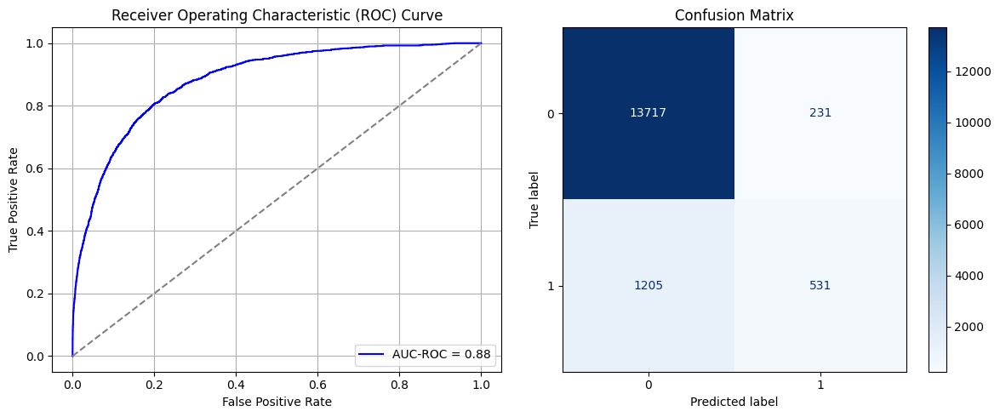

Best threshold based on F1-score: 0.24888473749160767
False Negative Rate: 0.6941244239631337
Time elapsed (performance): 1.371325159000662
(np.float64(0.016561514195583597), np.float64(0.9834384858044164))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7412 - loss: 0.6171 - val_AUC: 0.8660 - val_loss: 0.4818
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - AUC: 0.8508 - loss: 0.4783 - val_AUC: 0.8803 - val_loss: 0.4389
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8682 - loss: 0.4473 - val_AUC: 0.8837 - val_loss: 0.4279
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8702 - loss: 0.4452 - val_AUC: 0.8838 - val_loss: 0.4271
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8702 - loss: 0.4456 - val_AUC: 0.8842 - val_loss: 0.4323
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8698 - loss: 0.4445 - val_AUC: 0.8847 - val_loss: 0.4372
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8730 - loss: 0.4405 - val_AUC: 0.8843 - val_loss: 0.4258
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - AUC: 0.8685 - loss: 0.4451 - val_AUC: 0.8844 - val_loss: 0.4351
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8722 -

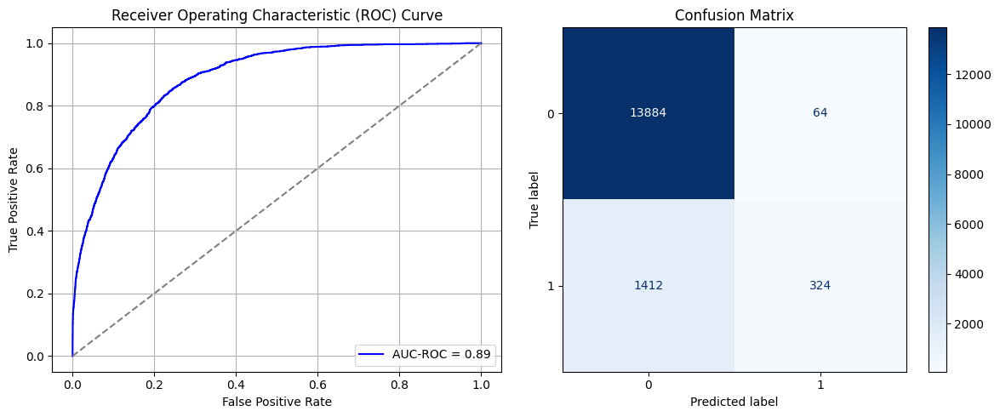

Best threshold based on F1-score: 0.12242480367422104
False Negative Rate: 0.8133640552995391
Time elapsed (performance): 1.7580433789999006
(np.float64(0.004588471465443074), np.float64(0.9954115285345569))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - AUC: 0.7458 - loss: 0.6094 - val_AUC: 0.8641 - val_loss: 0.4663
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - AUC: 0.8624 - loss: 0.4603 - val_AUC: 0.8773 - val_loss: 0.4428
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8624 - loss: 0.4553 - val_AUC: 0.8779 - val_loss: 0.4344
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8766 - loss: 0.4327 - val_AUC: 0.8785 - val_loss: 0.4415
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8692 - loss: 0.4458 - val_AUC: 0.8798 - val_loss: 0.4295
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8737 - loss: 0.4371 - val_AUC: 0.8801 - val_loss: 0.4310
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8800 - loss: 0.4271 - val_AUC: 0.8805 - val_loss: 0.4310
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8709 - loss: 0.4423 - val_AUC: 0.8807 - val_loss: 0.4479
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8800 -

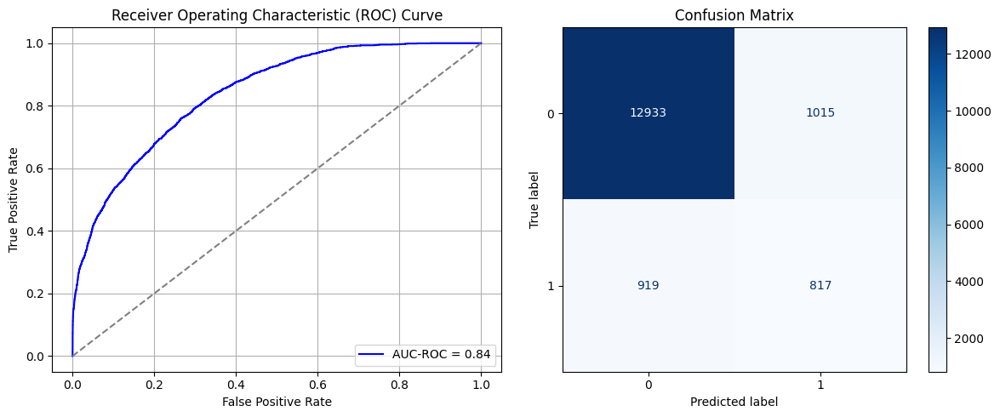

Best threshold based on F1-score: 0.537024199962616
False Negative Rate: 0.5293778801843319
Time elapsed (performance): 1.7601507549998132
(np.float64(0.07277028964726126), np.float64(0.9272297103527387))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - AUC: 0.7517 - loss: 0.6009 - val_AUC: 0.8529 - val_loss: 0.4887
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8556 - loss: 0.4725 - val_AUC: 0.8711 - val_loss: 0.4508
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8732 - loss: 0.4406 - val_AUC: 0.8727 - val_loss: 0.4433
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8752 - loss: 0.4371 - val_AUC: 0.8731 - val_loss: 0.4468
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8757 - loss: 0.4346 - val_AUC: 0.8744 - val_loss: 0.4398
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8784 - loss: 0.4311 - val_AUC: 0.8738 - val_loss: 0.4410
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8750 - loss: 0.4358 - val_AUC: 0.8749 - val_loss: 0.4391
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8766 - loss: 0.4325 - val_AUC: 0.8747 - val_loss: 0.4415
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8795 -

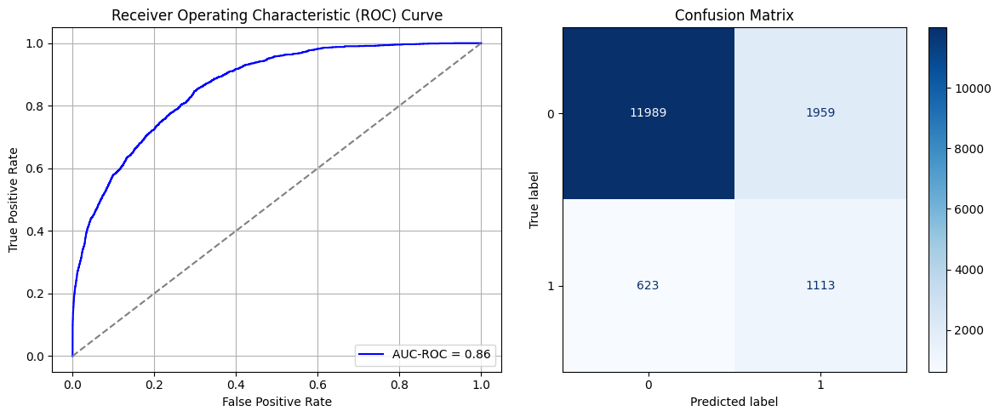

Best threshold based on F1-score: 0.6926171779632568
False Negative Rate: 0.3588709677419355
Time elapsed (performance): 1.803450776000318
(np.float64(0.1404502437625466), np.float64(0.8595497562374534))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.7375 - loss: 0.6179 - val_AUC: 0.8662 - val_loss: 0.4645
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8546 - loss: 0.4726 - val_AUC: 0.8812 - val_loss: 0.4356
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8745 - loss: 0.4402 - val_AUC: 0.8812 - val_loss: 0.4321
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8717 - loss: 0.4443 - val_AUC: 0.8831 - val_loss: 0.4414
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - AUC: 0.8674 - loss: 0.4501 - val_AUC: 0.8824 - val_loss: 0.4323
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8713 - loss: 0.4430 - val_AUC: 0.8849 - val_loss: 0.4230
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8713 - loss: 0.4422 - val_AUC: 0.8853 - val_loss: 0.4256
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8670 - loss: 0.4491 - val_AUC: 0.8847 - val_loss: 0.4230
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - AUC: 0.8770 -

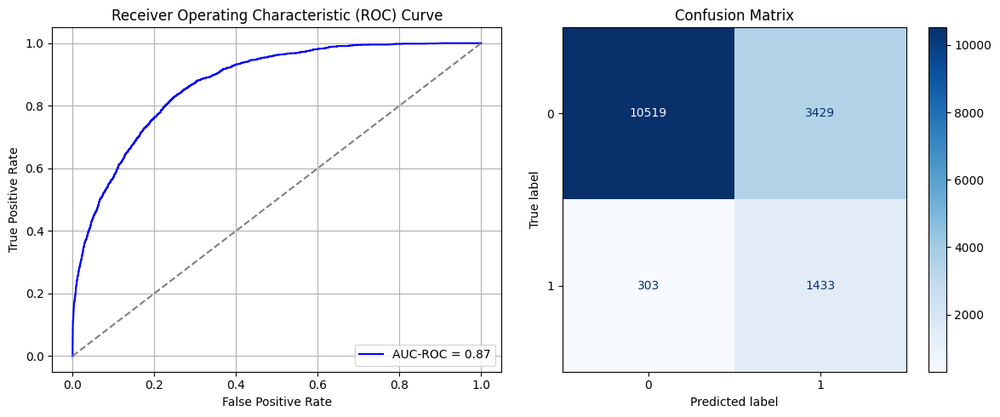

Best threshold based on F1-score: 0.7706548571586609
False Negative Rate: 0.17453917050691245
Time elapsed (performance): 1.7706642029997965
(np.float64(0.24584169773444223), np.float64(0.7541583022655578))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - AUC: 0.7366 - loss: 0.6154 - val_AUC: 0.8601 - val_loss: 0.4826
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8532 - loss: 0.4723 - val_AUC: 0.8740 - val_loss: 0.4437
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - AUC: 0.8742 - loss: 0.4390 - val_AUC: 0.8769 - val_loss: 0.4382
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8733 - loss: 0.4378 - val_AUC: 0.8774 - val_loss: 0.4377
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8723 - loss: 0.4384 - val_AUC: 0.8787 - val_loss: 0.4367
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8725 - loss: 0.4376 - val_AUC: 0.8789 - val_loss: 0.4408
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8739 - loss: 0.4365 - val_AUC: 0.8795 - val_loss: 0.4337
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8766 - loss: 0.4317 - val_AUC: 0.8792 - val_loss: 0.4334
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8770 -

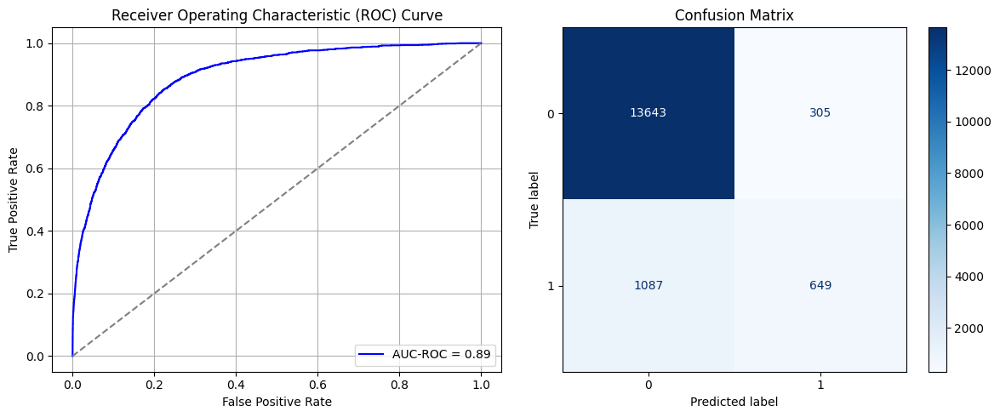

Best threshold based on F1-score: 0.31260669231414795
False Negative Rate: 0.6261520737327189
Time elapsed (performance): 1.49282313599997
(np.float64(0.02186693432750215), np.float64(0.9781330656724978))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.7680 - loss: 0.6159 - val_AUC: 0.8562 - val_loss: 0.4755
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8646 - loss: 0.4590 - val_AUC: 0.8686 - val_loss: 0.4526
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8704 - loss: 0.4439 - val_AUC: 0.8723 - val_loss: 0.4514
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8771 - loss: 0.4329 - val_AUC: 0.8732 - val_loss: 0.4455
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8782 - loss: 0.4317 - val_AUC: 0.8743 - val_loss: 0.4535
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8767 - loss: 0.4350 - val_AUC: 0.8753 - val_loss: 0.4487
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8810 - loss: 0.4268 - val_AUC: 0.8751 - val_loss: 0.4388
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8807 - loss: 0.4262 - val_AUC: 0.8753 - val_loss: 0.4409
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8779 -

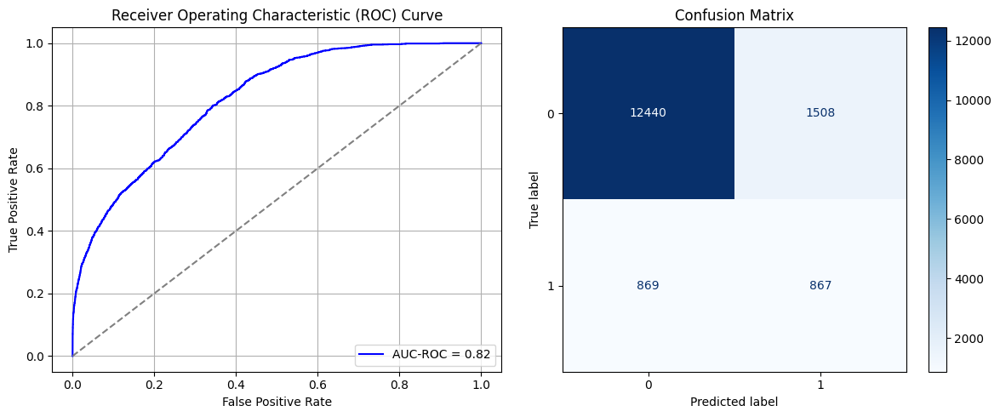

Best threshold based on F1-score: 0.5630707144737244
False Negative Rate: 0.5005760368663594
Time elapsed (performance): 1.6300283919999856
(np.float64(0.10811585890450244), np.float64(0.8918841410954975))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.7059 - loss: 0.6278 - val_AUC: 0.8604 - val_loss: 0.4798
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8567 - loss: 0.4706 - val_AUC: 0.8726 - val_loss: 0.4568
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - AUC: 0.8690 - loss: 0.4462 - val_AUC: 0.8731 - val_loss: 0.4410
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8736 - loss: 0.4402 - val_AUC: 0.8743 - val_loss: 0.4773
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8704 - loss: 0.4445 - val_AUC: 0.8750 - val_loss: 0.4382
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8674 - loss: 0.4486 - val_AUC: 0.8756 - val_loss: 0.4383
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - AUC: 0.8672 - loss: 0.4484 - val_AUC: 0.8741 - val_loss: 0.4402
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - AUC: 0.8738 - loss: 0.4366 - val_AUC: 0.8759 - val_loss: 0.4451
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8768 -

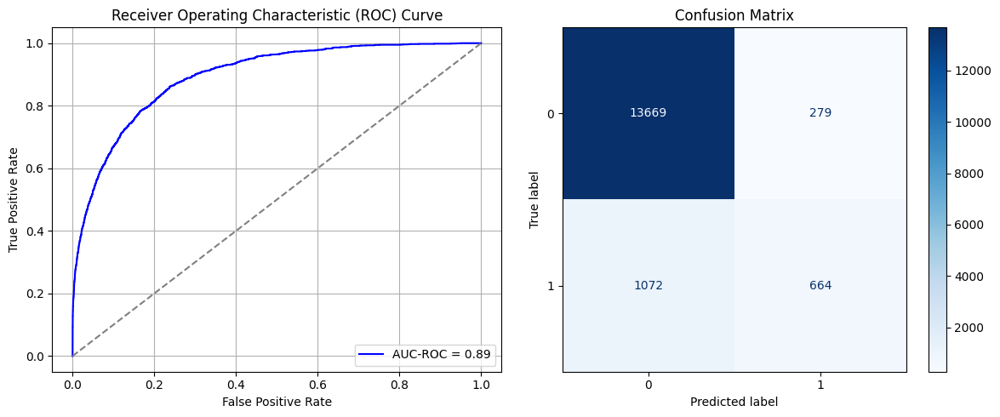

Best threshold based on F1-score: 0.3038368225097656
False Negative Rate: 0.6175115207373272
Time elapsed (performance): 1.6114561049998883
(np.float64(0.020002867794665903), np.float64(0.9799971322053341))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - AUC: 0.7430 - loss: 0.6088 - val_AUC: 0.8605 - val_loss: 0.4764
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - AUC: 0.8585 - loss: 0.4672 - val_AUC: 0.8755 - val_loss: 0.4451
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - AUC: 0.8730 - loss: 0.4428 - val_AUC: 0.8775 - val_loss: 0.4391
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8735 - loss: 0.4395 - val_AUC: 0.8803 - val_loss: 0.4311
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - AUC: 0.8766 - loss: 0.4341 - val_AUC: 0.8816 - val_loss: 0.4337
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 6s 9ms/step - AUC: 0.8757 - loss: 0.4338 - val_AUC: 0.8802 - val_loss: 0.4310
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - AUC: 0.8778 - loss: 0.4325 - val_AUC: 0.8809 - val_loss: 0.4287
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - AUC: 0.8763 - loss: 0.4337 - val_AUC: 0.8812 - val_loss: 0.4307
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 6s 9ms/step - AUC: 0.8757 -

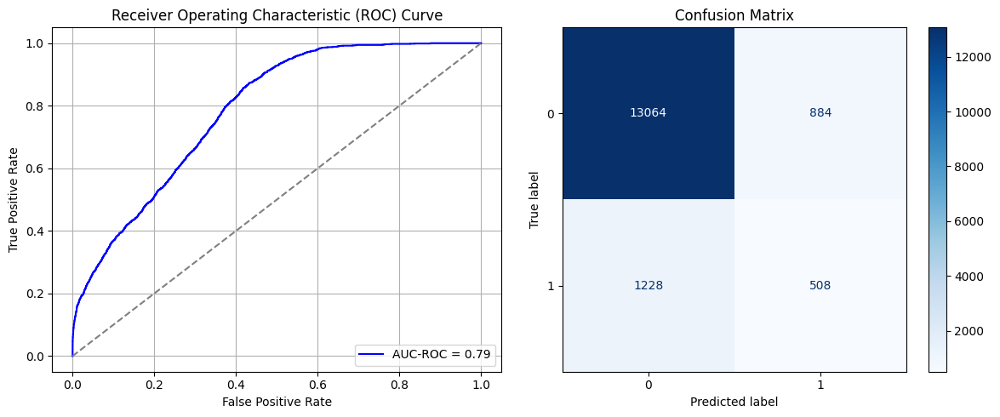

Best threshold based on F1-score: 0.3968912959098816
False Negative Rate: 0.7073732718894009
Time elapsed (performance): 1.7774195289994168
(np.float64(0.06337826211643247), np.float64(0.9366217378835675))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - AUC: 0.7424 - loss: 0.6140 - val_AUC: 0.8523 - val_loss: 0.4844
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8514 - loss: 0.4775 - val_AUC: 0.8693 - val_loss: 0.4564
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8679 - loss: 0.4477 - val_AUC: 0.8726 - val_loss: 0.4472
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8707 - loss: 0.4419 - val_AUC: 0.8750 - val_loss: 0.4403
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8726 - loss: 0.4400 - val_AUC: 0.8751 - val_loss: 0.4439
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8716 - loss: 0.4419 - val_AUC: 0.8755 - val_loss: 0.4481
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8788 - loss: 0.4326 - val_AUC: 0.8769 - val_loss: 0.4369
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - AUC: 0.8778 - loss: 0.4312 - val_AUC: 0.8767 - val_loss: 0.4372
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8767 -

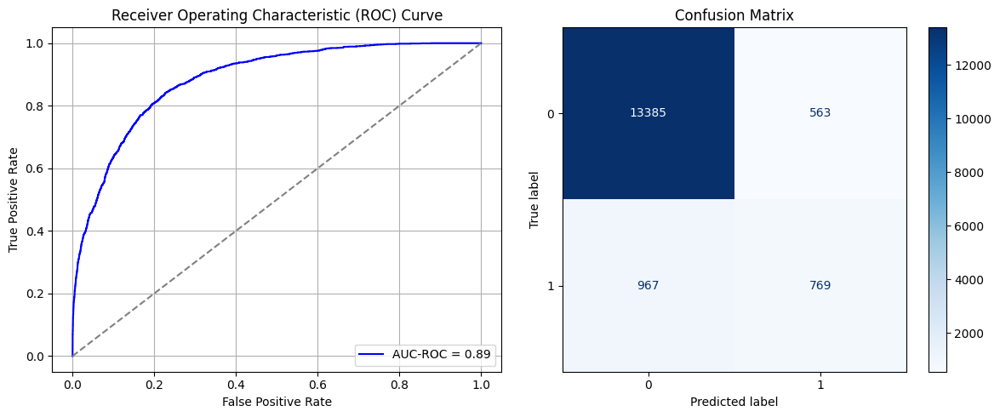

Best threshold based on F1-score: 0.3524124026298523
False Negative Rate: 0.5570276497695853
Time elapsed (performance): 3.0729043259998434
(np.float64(0.04036420992256955), np.float64(0.9596357900774305))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 5s 8ms/step - AUC: 0.7167 - loss: 0.6218 - val_AUC: 0.8615 - val_loss: 0.4750
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8556 - loss: 0.4741 - val_AUC: 0.8791 - val_loss: 0.4668
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8645 - loss: 0.4551 - val_AUC: 0.8803 - val_loss: 0.4352
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8700 - loss: 0.4444 - val_AUC: 0.8813 - val_loss: 0.4306
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8712 - loss: 0.4444 - val_AUC: 0.8806 - val_loss: 0.4338
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8757 - loss: 0.4364 - val_AUC: 0.8821 - val_loss: 0.4281
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - AUC: 0.8725 - loss: 0.4402 - val_AUC: 0.8822 - val_loss: 0.4257
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8703 - loss: 0.4444 - val_AUC: 0.8821 - val_loss: 0.4259
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8725 -

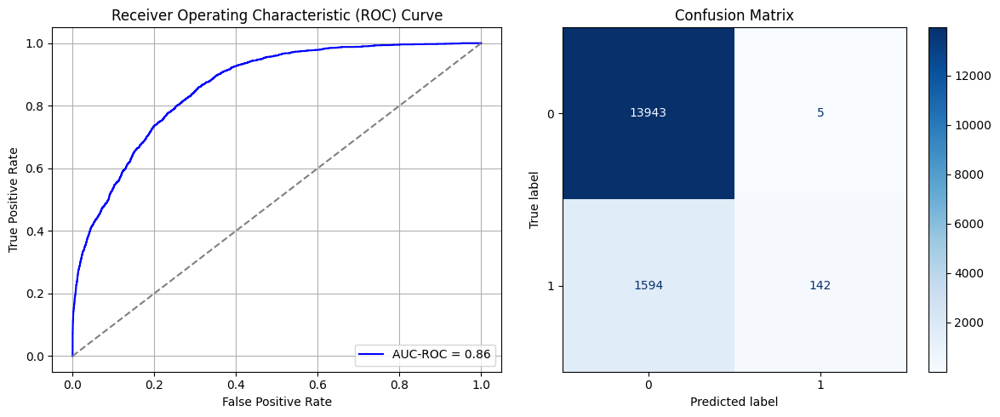

Best threshold based on F1-score: 0.04211229085922241
False Negative Rate: 0.9182027649769585
Time elapsed (performance): 3.1498046699998667
(np.float64(0.0003584743332377402), np.float64(0.9996415256667622))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.7412 - loss: 0.6126 - val_AUC: 0.8618 - val_loss: 0.4725
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8591 - loss: 0.4650 - val_AUC: 0.8755 - val_loss: 0.4405
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8641 - loss: 0.4546 - val_AUC: 0.8777 - val_loss: 0.4416
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - AUC: 0.8663 - loss: 0.4504 - val_AUC: 0.8795 - val_loss: 0.4355
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8734 - loss: 0.4386 - val_AUC: 0.8801 - val_loss: 0.4349
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8705 - loss: 0.4420 - val_AUC: 0.8809 - val_loss: 0.4319
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8775 - loss: 0.4338 - val_AUC: 0.8821 - val_loss: 0.4356
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8736 - loss: 0.4385 - val_AUC: 0.8828 - val_loss: 0.4291
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - AUC: 0.8760 -

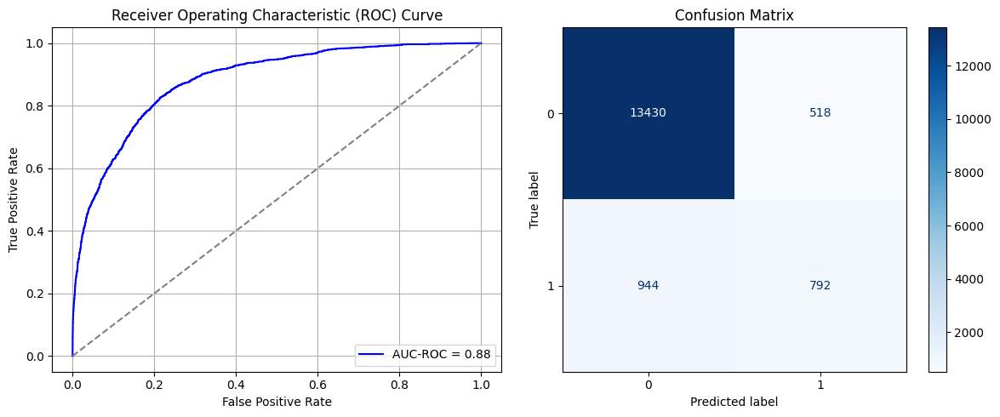

Best threshold based on F1-score: 0.3945227563381195
False Negative Rate: 0.543778801843318
Time elapsed (performance): 1.8127244520001113
(np.float64(0.03713794092342988), np.float64(0.9628620590765701))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.7301 - loss: 0.6167 - val_AUC: 0.8505 - val_loss: 0.4985
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8622 - loss: 0.4600 - val_AUC: 0.8695 - val_loss: 0.4476
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8719 - loss: 0.4430 - val_AUC: 0.8715 - val_loss: 0.4526
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8749 - loss: 0.4381 - val_AUC: 0.8720 - val_loss: 0.4434
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8760 - loss: 0.4339 - val_AUC: 0.8735 - val_loss: 0.4409
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8758 - loss: 0.4336 - val_AUC: 0.8758 - val_loss: 0.4384
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8780 - loss: 0.4316 - val_AUC: 0.8763 - val_loss: 0.4421
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8740 - loss: 0.4354 - val_AUC: 0.8767 - val_loss: 0.4410
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - AUC: 0.8770 -

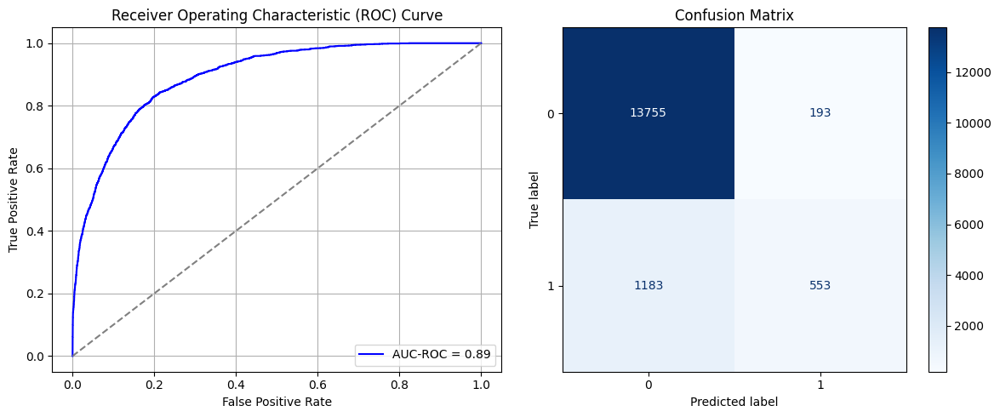

Best threshold based on F1-score: 0.22365117073059082
False Negative Rate: 0.6814516129032258
Time elapsed (performance): 1.7619790499993542
(np.float64(0.01383710926297677), np.float64(0.9861628907370232))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - AUC: 0.7499 - loss: 0.6089 - val_AUC: 0.8689 - val_loss: 0.4690
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8586 - loss: 0.4675 - val_AUC: 0.8755 - val_loss: 0.4402
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8722 - loss: 0.4405 - val_AUC: 0.8772 - val_loss: 0.4367
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8703 - loss: 0.4435 - val_AUC: 0.8787 - val_loss: 0.4338
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8760 - loss: 0.4345 - val_AUC: 0.8786 - val_loss: 0.4348
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8699 - loss: 0.4421 - val_AUC: 0.8791 - val_loss: 0.4325
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8770 - loss: 0.4322 - val_AUC: 0.8778 - val_loss: 0.4358
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8762 - loss: 0.4352 - val_AUC: 0.8809 - val_loss: 0.4350
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8787 -

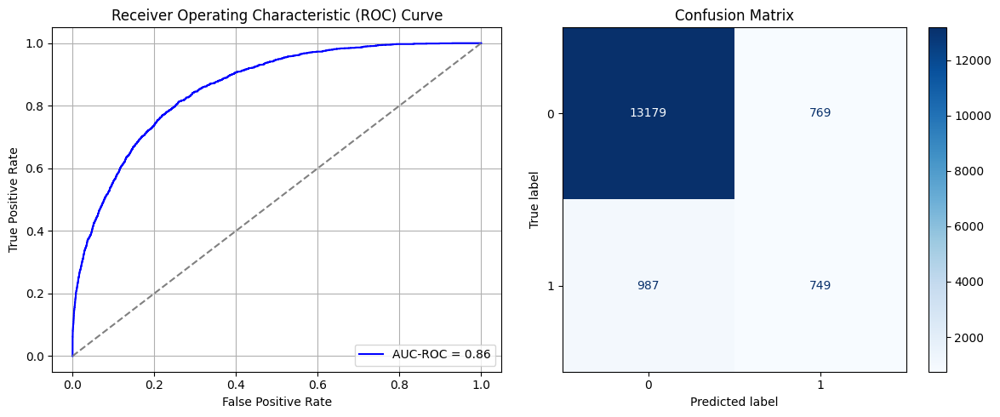

Best threshold based on F1-score: 0.33743929862976074
False Negative Rate: 0.5685483870967742
Time elapsed (performance): 1.7454468220003037
(np.float64(0.05513335245196444), np.float64(0.9448666475480355))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - AUC: 0.7382 - loss: 0.6142 - val_AUC: 0.8610 - val_loss: 0.4702
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8536 - loss: 0.4736 - val_AUC: 0.8795 - val_loss: 0.4419
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8660 - loss: 0.4512 - val_AUC: 0.8805 - val_loss: 0.4314
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8772 - loss: 0.4346 - val_AUC: 0.8821 - val_loss: 0.4338
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8748 - loss: 0.4383 - val_AUC: 0.8820 - val_loss: 0.4333
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8741 - loss: 0.4397 - val_AUC: 0.8822 - val_loss: 0.4283
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8783 - loss: 0.4320 - val_AUC: 0.8830 - val_loss: 0.4311
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8783 - loss: 0.4321 - val_AUC: 0.8836 - val_loss: 0.4259
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8767 -

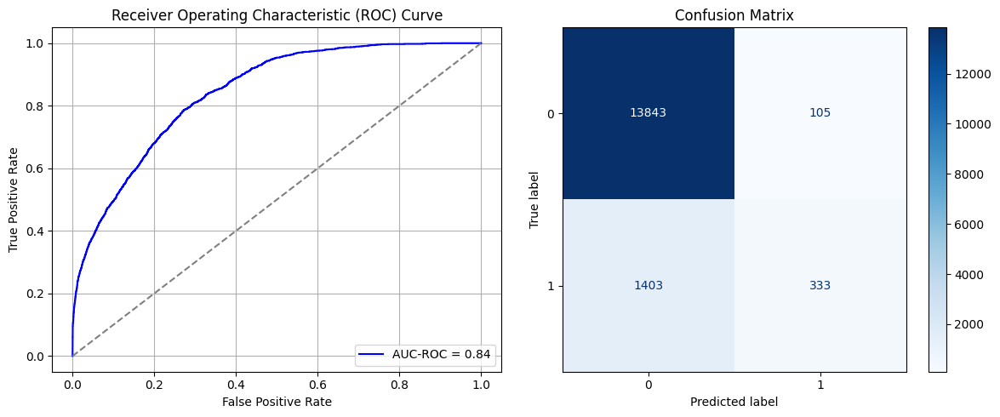

Best threshold based on F1-score: 0.17789839208126068
False Negative Rate: 0.8081797235023042
Time elapsed (performance): 1.8689135129998249
(np.float64(0.007527960997992544), np.float64(0.9924720390020074))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.7110 - loss: 0.6221 - val_AUC: 0.8483 - val_loss: 0.4845
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8536 - loss: 0.4729 - val_AUC: 0.8696 - val_loss: 0.4475
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8660 - loss: 0.4486 - val_AUC: 0.8712 - val_loss: 0.4442
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8743 - loss: 0.4368 - val_AUC: 0.8710 - val_loss: 0.4441
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8772 - loss: 0.4315 - val_AUC: 0.8717 - val_loss: 0.4587
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8753 - loss: 0.4356 - val_AUC: 0.8730 - val_loss: 0.4432
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8746 - loss: 0.4365 - val_AUC: 0.8724 - val_loss: 0.4467
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8786 - loss: 0.4320 - val_AUC: 0.8727 - val_loss: 0.4540
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8786 -

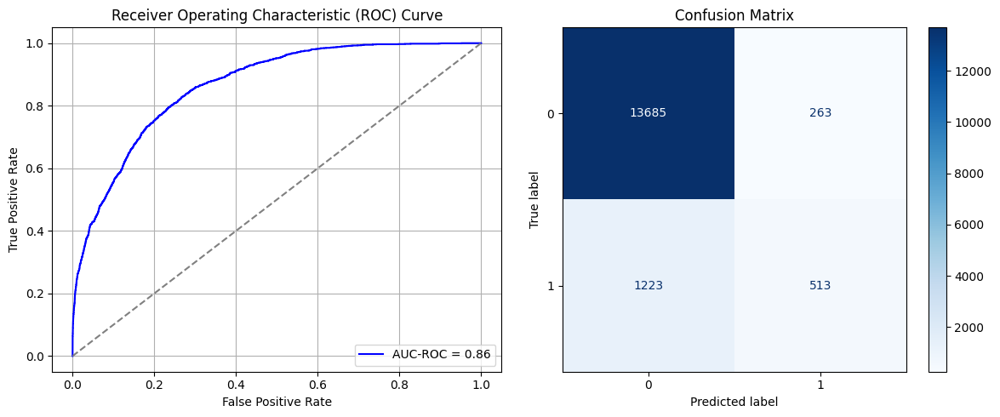

Best threshold based on F1-score: 0.2891342043876648
False Negative Rate: 0.7044930875576036
Time elapsed (performance): 1.9597643330007486
(np.float64(0.018855749928305132), np.float64(0.9811442500716949))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.7069 - loss: 0.6225 - val_AUC: 0.8693 - val_loss: 0.4636
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8595 - loss: 0.4651 - val_AUC: 0.8797 - val_loss: 0.4350
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8746 - loss: 0.4386 - val_AUC: 0.8831 - val_loss: 0.4273
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8765 - loss: 0.4342 - val_AUC: 0.8842 - val_loss: 0.4308
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8771 - loss: 0.4330 - val_AUC: 0.8843 - val_loss: 0.4287
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8680 - loss: 0.4469 - val_AUC: 0.8840 - val_loss: 0.4261
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8732 - loss: 0.4375 - val_AUC: 0.8848 - val_loss: 0.4222
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8755 - loss: 0.4361 - val_AUC: 0.8861 - val_loss: 0.4221
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8789 -

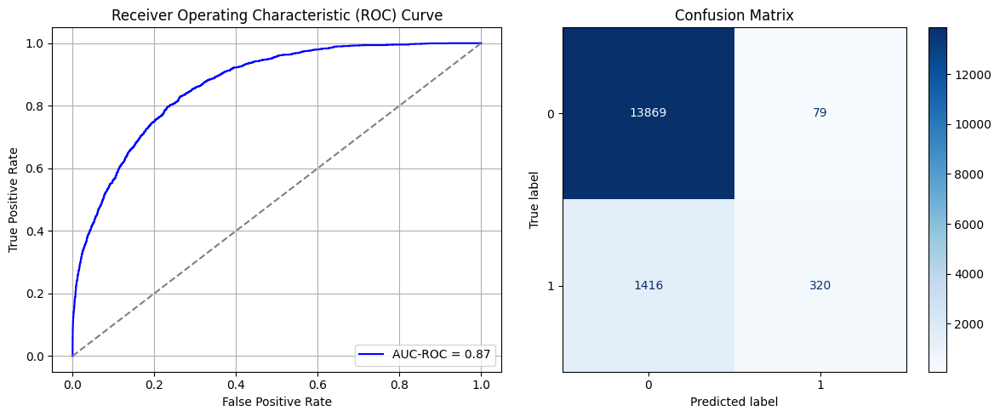

Best threshold based on F1-score: 0.11498546600341797
False Negative Rate: 0.815668202764977
Time elapsed (performance): 1.8851178489994709
(np.float64(0.005663894465156295), np.float64(0.9943361055348438))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.7227 - loss: 0.6206 - val_AUC: 0.8620 - val_loss: 0.4766
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8573 - loss: 0.4670 - val_AUC: 0.8757 - val_loss: 0.4407
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8645 - loss: 0.4520 - val_AUC: 0.8794 - val_loss: 0.4358
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8698 - loss: 0.4433 - val_AUC: 0.8813 - val_loss: 0.4417
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8712 - loss: 0.4421 - val_AUC: 0.8819 - val_loss: 0.4391
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8788 - loss: 0.4312 - val_AUC: 0.8816 - val_loss: 0.4345
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8697 - loss: 0.4441 - val_AUC: 0.8827 - val_loss: 0.4297
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8761 - loss: 0.4317 - val_AUC: 0.8828 - val_loss: 0.4276
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8786 -

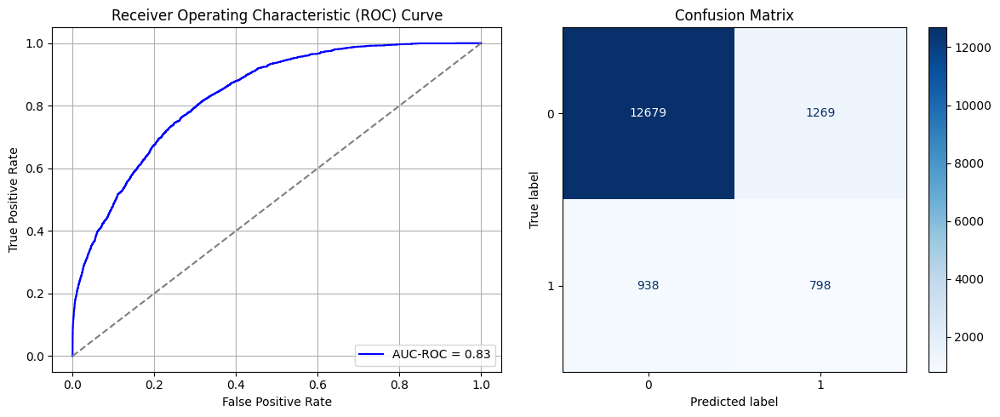

Best threshold based on F1-score: 0.457346111536026
False Negative Rate: 0.5403225806451613
Time elapsed (performance): 2.9999278040004356
(np.float64(0.09098078577573845), np.float64(0.9090192142242616))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.7092 - loss: 0.6174 - val_AUC: 0.8596 - val_loss: 0.4756
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8552 - loss: 0.4716 - val_AUC: 0.8749 - val_loss: 0.4490
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8633 - loss: 0.4550 - val_AUC: 0.8798 - val_loss: 0.4330
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8696 - loss: 0.4450 - val_AUC: 0.8811 - val_loss: 0.4317
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8688 - loss: 0.4467 - val_AUC: 0.8818 - val_loss: 0.4324
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8691 - loss: 0.4458 - val_AUC: 0.8823 - val_loss: 0.4279
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8733 - loss: 0.4392 - val_AUC: 0.8822 - val_loss: 0.4283
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8723 - loss: 0.4403 - val_AUC: 0.8818 - val_loss: 0.4318
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8752 -

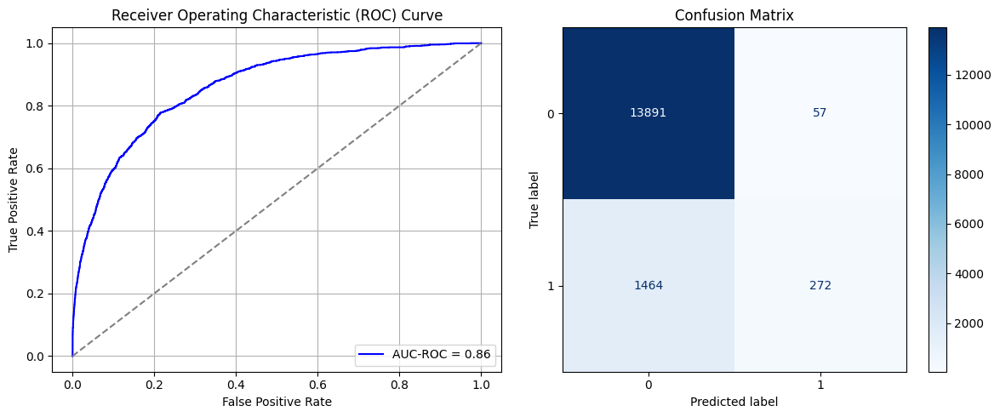

Best threshold based on F1-score: 0.10288892686367035
False Negative Rate: 0.8433179723502304
Time elapsed (performance): 2.0838407060000463
(np.float64(0.004086607398910238), np.float64(0.9959133926010898))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.7114 - loss: 0.6195 - val_AUC: 0.8601 - val_loss: 0.4851
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8604 - loss: 0.4659 - val_AUC: 0.8717 - val_loss: 0.4450
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8750 - loss: 0.4372 - val_AUC: 0.8737 - val_loss: 0.4440
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8721 - loss: 0.4415 - val_AUC: 0.8740 - val_loss: 0.4432
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8743 - loss: 0.4391 - val_AUC: 0.8745 - val_loss: 0.4434
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8742 - loss: 0.4362 - val_AUC: 0.8765 - val_loss: 0.4411
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8784 - loss: 0.4315 - val_AUC: 0.8764 - val_loss: 0.4652
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8777 - loss: 0.4326 - val_AUC: 0.8761 - val_loss: 0.4592
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8773 -

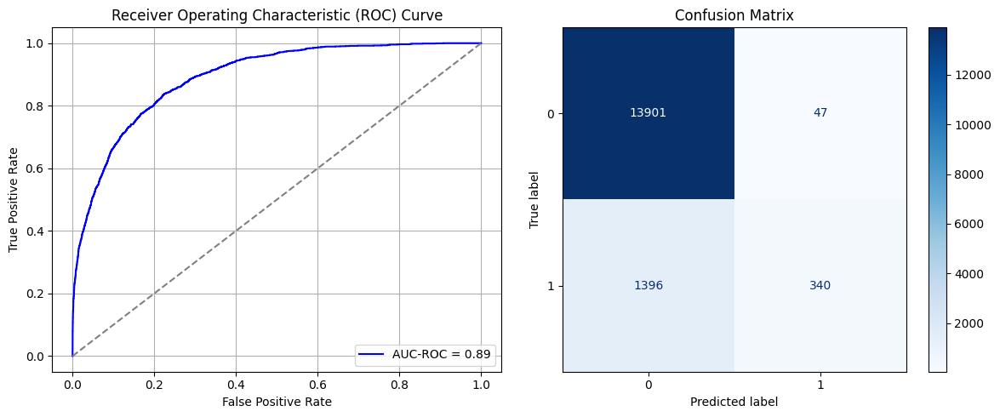

Best threshold based on F1-score: 0.09761953353881836
False Negative Rate: 0.804147465437788
Time elapsed (performance): 1.4745037560005585
(np.float64(0.0033696587324347576), np.float64(0.9966303412675652))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - AUC: 0.7516 - loss: 0.6150 - val_AUC: 0.8712 - val_loss: 0.4597
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8616 - loss: 0.4639 - val_AUC: 0.8830 - val_loss: 0.4289
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8696 - loss: 0.4448 - val_AUC: 0.8842 - val_loss: 0.4250
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8759 - loss: 0.4356 - val_AUC: 0.8845 - val_loss: 0.4251
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8685 - loss: 0.4477 - val_AUC: 0.8846 - val_loss: 0.4262
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8824 - loss: 0.4255 - val_AUC: 0.8840 - val_loss: 0.4245
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8758 - loss: 0.4354 - val_AUC: 0.8862 - val_loss: 0.4200
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8800 - loss: 0.4298 - val_AUC: 0.8858 - val_loss: 0.4203
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8702 -

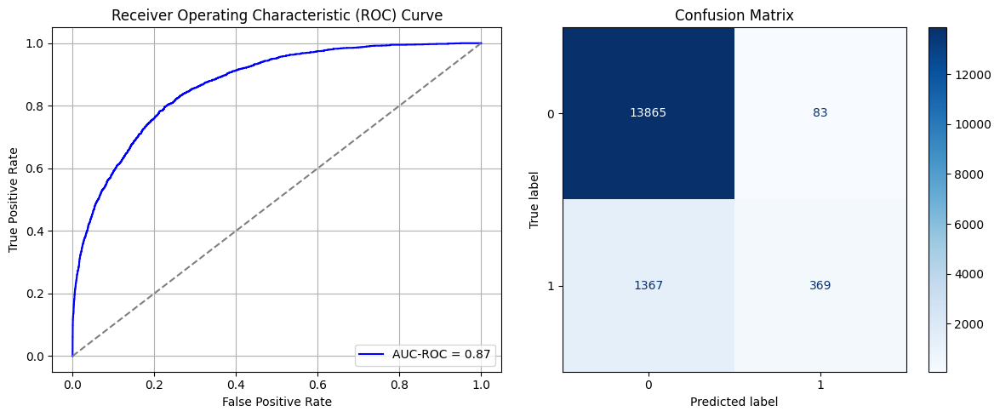

Best threshold based on F1-score: 0.1694372296333313
False Negative Rate: 0.7874423963133641
Time elapsed (performance): 1.7097932770002444
(np.float64(0.005950673931746487), np.float64(0.9940493260682535))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 7s 13ms/step - AUC: 0.7391 - loss: 0.6136 - val_AUC: 0.8640 - val_loss: 0.4771
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.8588 - loss: 0.4671 - val_AUC: 0.8794 - val_loss: 0.4428
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8747 - loss: 0.4377 - val_AUC: 0.8814 - val_loss: 0.4300
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8736 - loss: 0.4382 - val_AUC: 0.8828 - val_loss: 0.4278
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8731 - loss: 0.4394 - val_AUC: 0.8822 - val_loss: 0.4299
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8746 - loss: 0.4367 - val_AUC: 0.8836 - val_loss: 0.4258
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8743 - loss: 0.4386 - val_AUC: 0.8836 - val_loss: 0.4247
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8747 - loss: 0.4368 - val_AUC: 0.8838 - val_loss: 0.4295
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8743 

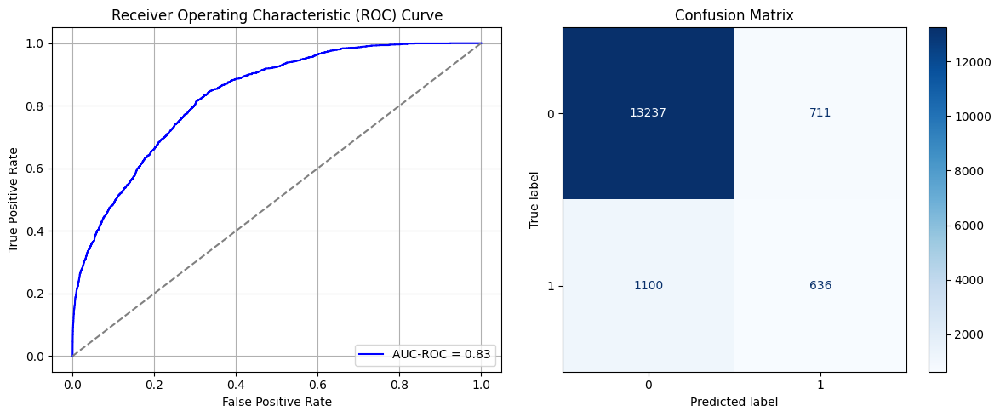

Best threshold based on F1-score: 0.4259853959083557
False Negative Rate: 0.6336405529953917
Time elapsed (performance): 1.4789017610000883
(np.float64(0.050975050186406655), np.float64(0.9490249498135933))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - AUC: 0.7394 - loss: 0.6084 - val_AUC: 0.8571 - val_loss: 0.4731
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8590 - loss: 0.4632 - val_AUC: 0.8714 - val_loss: 0.4449
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8608 - loss: 0.4582 - val_AUC: 0.8731 - val_loss: 0.4433
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - AUC: 0.8675 - loss: 0.4496 - val_AUC: 0.8726 - val_loss: 0.4556
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.8713 - loss: 0.4420 - val_AUC: 0.8727 - val_loss: 0.4514
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8739 - loss: 0.4379 - val_AUC: 0.8751 - val_loss: 0.4503
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8734 - loss: 0.4381 - val_AUC: 0.8739 - val_loss: 0.4461
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8778 - loss: 0.4324 - val_AUC: 0.8736 - val_loss: 0.4441
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.8745 -

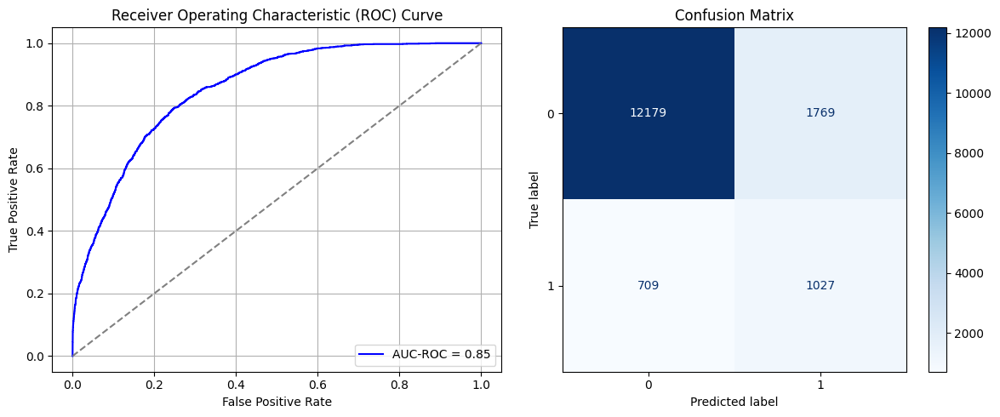

Best threshold based on F1-score: 0.4846102297306061
False Negative Rate: 0.4084101382488479
Time elapsed (performance): 1.737167625999973
(np.float64(0.12682821909951247), np.float64(0.8731717809004875))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 5s 7ms/step - AUC: 0.7420 - loss: 0.6136 - val_AUC: 0.8582 - val_loss: 0.4864
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8562 - loss: 0.4693 - val_AUC: 0.8704 - val_loss: 0.4505
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8715 - loss: 0.4408 - val_AUC: 0.8719 - val_loss: 0.4441
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8676 - loss: 0.4475 - val_AUC: 0.8732 - val_loss: 0.4487
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8673 - loss: 0.4473 - val_AUC: 0.8747 - val_loss: 0.4396
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.8794 - loss: 0.4295 - val_AUC: 0.8742 - val_loss: 0.4411
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8747 - loss: 0.4352 - val_AUC: 0.8743 - val_loss: 0.4558
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8774 - loss: 0.4309 - val_AUC: 0.8753 - val_loss: 0.4408
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8748 -

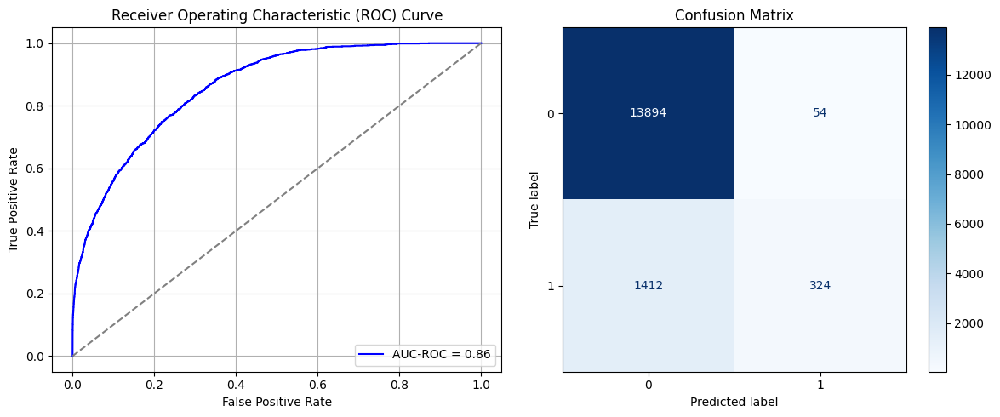

Best threshold based on F1-score: 0.11178998649120331
False Negative Rate: 0.8133640552995391
Time elapsed (performance): 1.8392654269991908
(np.float64(0.003871522798967594), np.float64(0.9961284772010324))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - AUC: 0.7276 - loss: 0.6088 - val_AUC: 0.8661 - val_loss: 0.4679
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8545 - loss: 0.4730 - val_AUC: 0.8784 - val_loss: 0.4463
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8646 - loss: 0.4548 - val_AUC: 0.8812 - val_loss: 0.4304
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8653 - loss: 0.4497 - val_AUC: 0.8825 - val_loss: 0.4275
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - AUC: 0.8748 - loss: 0.4372 - val_AUC: 0.8823 - val_loss: 0.4314
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8748 - loss: 0.4373 - val_AUC: 0.8824 - val_loss: 0.4275
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8804 - loss: 0.4267 - val_AUC: 0.8835 - val_loss: 0.4247
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8745 - loss: 0.4367 - val_AUC: 0.8847 - val_loss: 0.4255
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8799 -

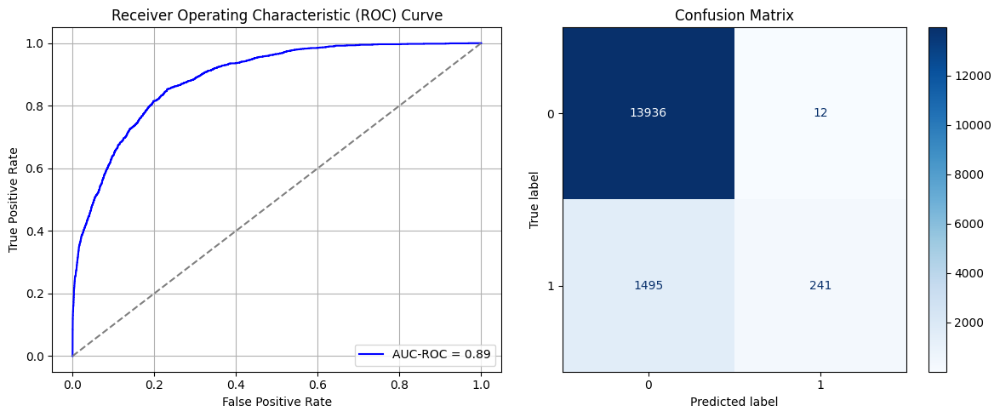

Best threshold based on F1-score: 0.03265286237001419
False Negative Rate: 0.8611751152073732
Time elapsed (performance): 1.614046380000218
(np.float64(0.0008603383997705764), np.float64(0.9991396616002294))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - AUC: 0.7229 - loss: 0.6207 - val_AUC: 0.8601 - val_loss: 0.4761
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8539 - loss: 0.4734 - val_AUC: 0.8722 - val_loss: 0.4464
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8672 - loss: 0.4490 - val_AUC: 0.8750 - val_loss: 0.4500
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8657 - loss: 0.4512 - val_AUC: 0.8746 - val_loss: 0.4415
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8705 - loss: 0.4437 - val_AUC: 0.8769 - val_loss: 0.4462
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8739 - loss: 0.4389 - val_AUC: 0.8775 - val_loss: 0.4406
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8717 - loss: 0.4413 - val_AUC: 0.8786 - val_loss: 0.4363
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8781 - loss: 0.4310 - val_AUC: 0.8773 - val_loss: 0.4359
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8724 -

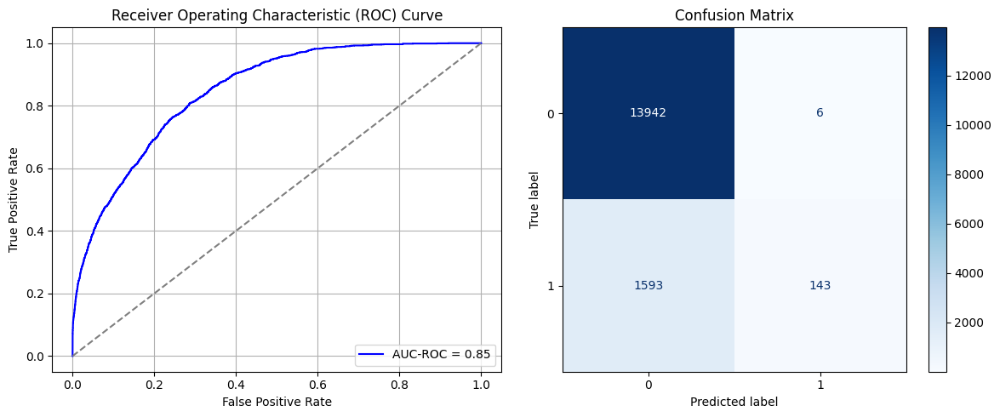

Best threshold based on F1-score: 0.02294173836708069
False Negative Rate: 0.9176267281105991
Time elapsed (performance): 1.8414334460003374
(np.float64(0.0004301691998852882), np.float64(0.9995698308001147))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.7400 - loss: 0.6204 - val_AUC: 0.8658 - val_loss: 0.4727
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8507 - loss: 0.4797 - val_AUC: 0.8793 - val_loss: 0.4359
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8655 - loss: 0.4510 - val_AUC: 0.8798 - val_loss: 0.4332
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8714 - loss: 0.4405 - val_AUC: 0.8818 - val_loss: 0.4286
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8663 - loss: 0.4488 - val_AUC: 0.8826 - val_loss: 0.4272
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8683 - loss: 0.4455 - val_AUC: 0.8830 - val_loss: 0.4260
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8632 - loss: 0.4518 - val_AUC: 0.8836 - val_loss: 0.4243
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8742 - loss: 0.4366 - val_AUC: 0.8833 - val_loss: 0.4252
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8755 -

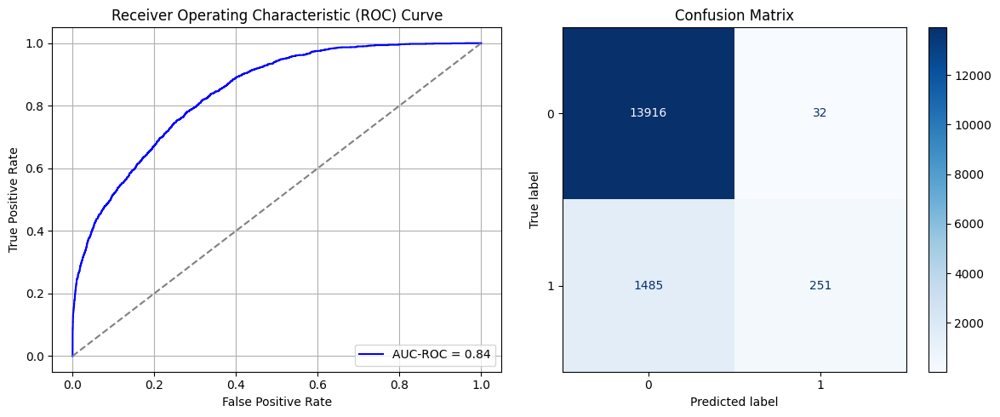

Best threshold based on F1-score: 0.08326639235019684
False Negative Rate: 0.8554147465437788
Time elapsed (performance): 1.718872632000057
(np.float64(0.002294235732721537), np.float64(0.9977057642672784))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.7254 - loss: 0.6106 - val_AUC: 0.8623 - val_loss: 0.4642
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8614 - loss: 0.4613 - val_AUC: 0.8765 - val_loss: 0.4453
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8719 - loss: 0.4432 - val_AUC: 0.8791 - val_loss: 0.4343
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8750 - loss: 0.4357 - val_AUC: 0.8802 - val_loss: 0.4319
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8770 - loss: 0.4342 - val_AUC: 0.8797 - val_loss: 0.4320
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8768 - loss: 0.4345 - val_AUC: 0.8820 - val_loss: 0.4291
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8741 - loss: 0.4380 - val_AUC: 0.8817 - val_loss: 0.4290
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8788 - loss: 0.4311 - val_AUC: 0.8830 - val_loss: 0.4310
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8793 -

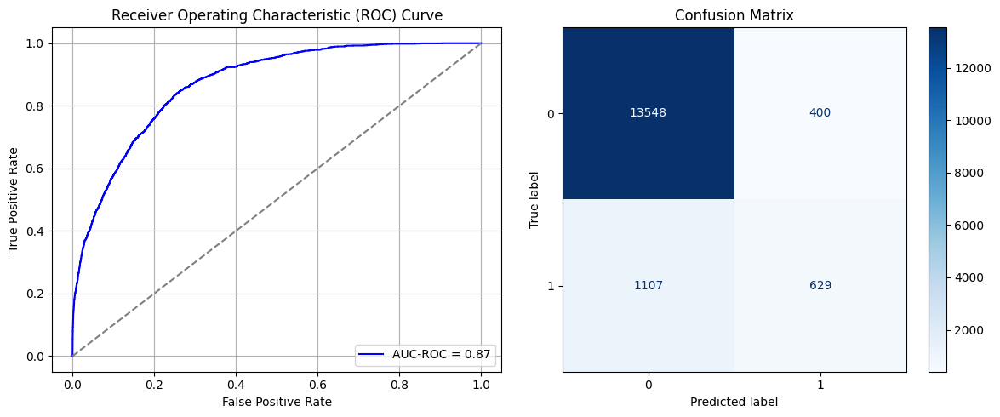

Best threshold based on F1-score: 0.30977287888526917
False Negative Rate: 0.6376728110599078
Time elapsed (performance): 1.5696614660000705
(np.float64(0.028677946659019213), np.float64(0.9713220533409808))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.7385 - loss: 0.6132 - val_AUC: 0.8695 - val_loss: 0.4603
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8611 - loss: 0.4623 - val_AUC: 0.8790 - val_loss: 0.4441
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8670 - loss: 0.4523 - val_AUC: 0.8819 - val_loss: 0.4412
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8735 - loss: 0.4404 - val_AUC: 0.8827 - val_loss: 0.4300
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8743 - loss: 0.4372 - val_AUC: 0.8812 - val_loss: 0.4364
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8715 - loss: 0.4439 - val_AUC: 0.8836 - val_loss: 0.4287
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8764 - loss: 0.4349 - val_AUC: 0.8854 - val_loss: 0.4227
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8778 - loss: 0.4323 - val_AUC: 0.8838 - val_loss: 0.4237
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8762 -

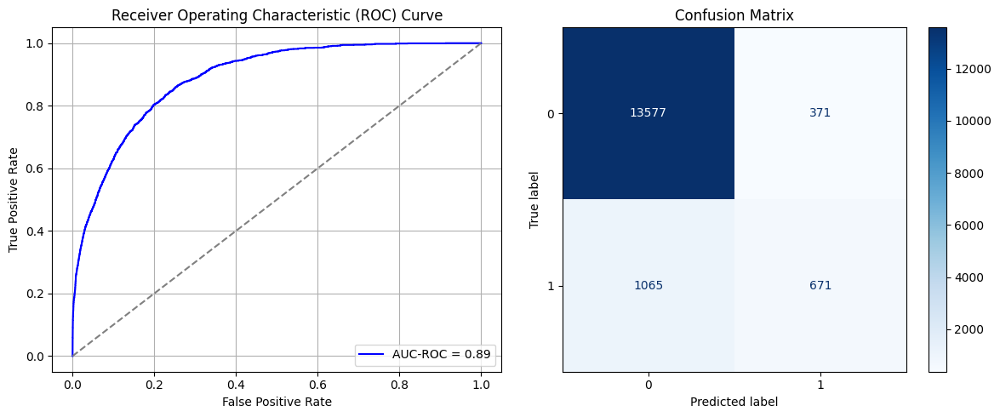

Best threshold based on F1-score: 0.27078795433044434
False Negative Rate: 0.613479262672811
Time elapsed (performance): 1.5704255709997597
(np.float64(0.02659879552624032), np.float64(0.9734012044737597))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.7365 - loss: 0.6204 - val_AUC: 0.8688 - val_loss: 0.4601
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8606 - loss: 0.4634 - val_AUC: 0.8780 - val_loss: 0.4354
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8693 - loss: 0.4455 - val_AUC: 0.8803 - val_loss: 0.4383
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8746 - loss: 0.4389 - val_AUC: 0.8809 - val_loss: 0.4296
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8750 - loss: 0.4375 - val_AUC: 0.8823 - val_loss: 0.4266
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8708 - loss: 0.4427 - val_AUC: 0.8818 - val_loss: 0.4281
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8759 - loss: 0.4344 - val_AUC: 0.8807 - val_loss: 0.4345
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8754 - loss: 0.4374 - val_AUC: 0.8826 - val_loss: 0.4261
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8778 -

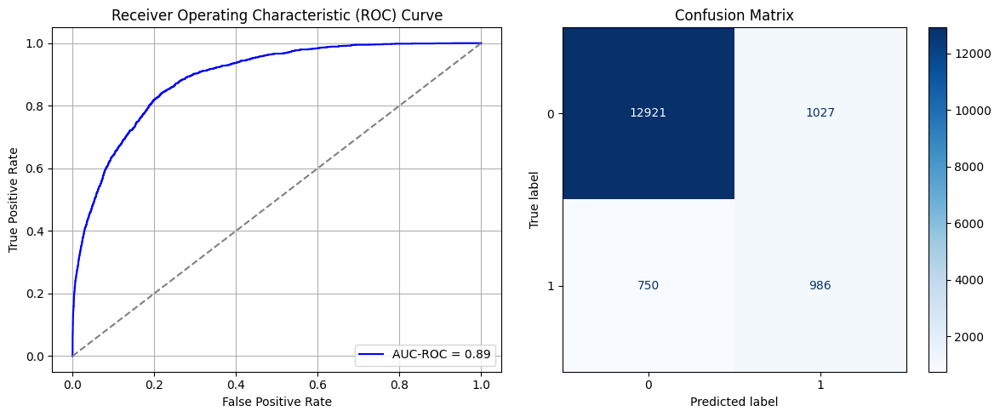

Best threshold based on F1-score: 0.480658620595932
False Negative Rate: 0.43202764976958524
Time elapsed (performance): 1.8945427200005724
(np.float64(0.07363062804703183), np.float64(0.9263693719529682))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - AUC: 0.7203 - loss: 0.6226 - val_AUC: 0.8560 - val_loss: 0.4831
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8579 - loss: 0.4719 - val_AUC: 0.8705 - val_loss: 0.4460
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8737 - loss: 0.4421 - val_AUC: 0.8729 - val_loss: 0.4414
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8717 - loss: 0.4417 - val_AUC: 0.8729 - val_loss: 0.4416
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8750 - loss: 0.4380 - val_AUC: 0.8748 - val_loss: 0.4385
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8735 - loss: 0.4386 - val_AUC: 0.8732 - val_loss: 0.4477
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8721 - loss: 0.4409 - val_AUC: 0.8735 - val_loss: 0.4404
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8749 - loss: 0.4394 - val_AUC: 0.8745 - val_loss: 0.4381
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - AUC: 0.8704 -

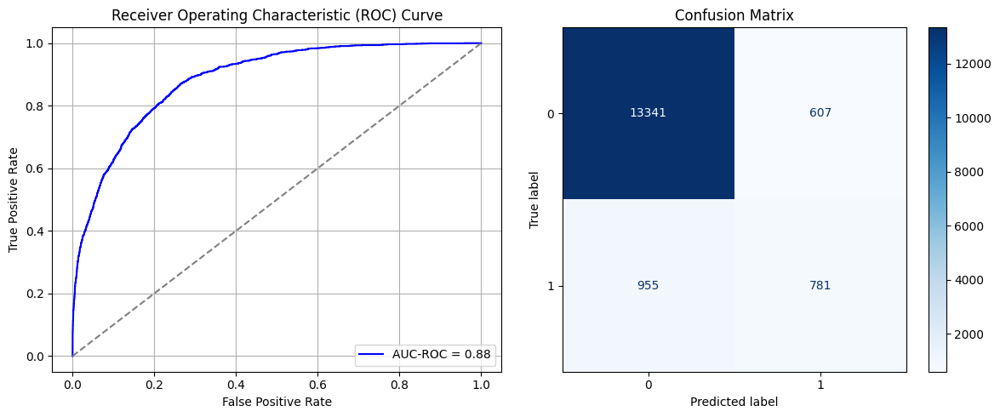

Best threshold based on F1-score: 0.3791918456554413
False Negative Rate: 0.5501152073732719
Time elapsed (performance): 1.7790749380001216
(np.float64(0.043518784055061654), np.float64(0.9564812159449383))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.7094 - loss: 0.6259 - val_AUC: 0.8525 - val_loss: 0.4818
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8567 - loss: 0.4691 - val_AUC: 0.8698 - val_loss: 0.4704
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8734 - loss: 0.4420 - val_AUC: 0.8701 - val_loss: 0.4468
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8755 - loss: 0.4384 - val_AUC: 0.8723 - val_loss: 0.4435
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8718 - loss: 0.4418 - val_AUC: 0.8726 - val_loss: 0.4444
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8739 - loss: 0.4385 - val_AUC: 0.8754 - val_loss: 0.4414
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8716 - loss: 0.4424 - val_AUC: 0.8750 - val_loss: 0.4415
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8727 - loss: 0.4409 - val_AUC: 0.8760 - val_loss: 0.4424
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8710 -

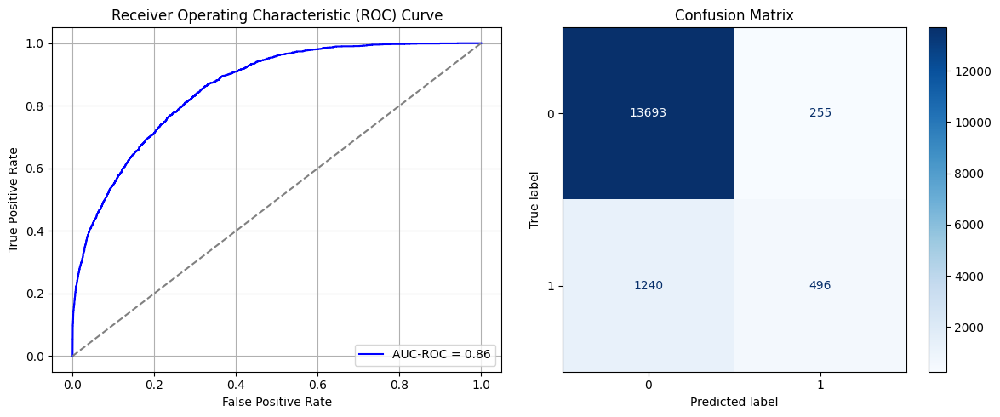

Best threshold based on F1-score: 0.29085975885391235
False Negative Rate: 0.7142857142857143
Time elapsed (performance): 1.5639235909993658
(np.float64(0.01828219099512475), np.float64(0.9817178090048753))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.6993 - loss: 0.6228 - val_AUC: 0.8638 - val_loss: 0.4741
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8483 - loss: 0.4810 - val_AUC: 0.8790 - val_loss: 0.4352
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8672 - loss: 0.4483 - val_AUC: 0.8797 - val_loss: 0.4340
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8691 - loss: 0.4442 - val_AUC: 0.8825 - val_loss: 0.4313
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8713 - loss: 0.4411 - val_AUC: 0.8830 - val_loss: 0.4262
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8719 - loss: 0.4391 - val_AUC: 0.8826 - val_loss: 0.4254
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8709 - loss: 0.4416 - val_AUC: 0.8831 - val_loss: 0.4307
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8703 - loss: 0.4450 - val_AUC: 0.8831 - val_loss: 0.4249
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8769 -

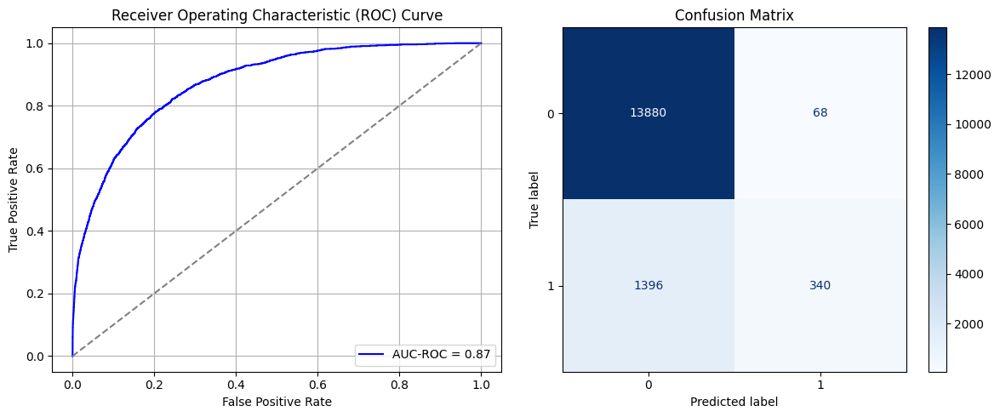

Best threshold based on F1-score: 0.0977078452706337
False Negative Rate: 0.804147465437788
Time elapsed (performance): 3.031811439000194
(np.float64(0.004875250932033267), np.float64(0.9951247490679668))
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


393/393 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.7538 - loss: 0.6100 - val_AUC: 0.8515 - val_loss: 0.4874
Epoch 2/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8611 - loss: 0.4611 - val_AUC: 0.8716 - val_loss: 0.4477
Epoch 3/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8725 - loss: 0.4416 - val_AUC: 0.8735 - val_loss: 0.4455
Epoch 4/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - AUC: 0.8736 - loss: 0.4379 - val_AUC: 0.8748 - val_loss: 0.4425
Epoch 5/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - AUC: 0.8778 - loss: 0.4306 - val_AUC: 0.8744 - val_loss: 0.4467
Epoch 6/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - AUC: 0.8750 - loss: 0.4364 - val_AUC: 0.8749 - val_loss: 0.4424
Epoch 7/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8800 - loss: 0.4280 - val_AUC: 0.8751 - val_loss: 0.4505
Epoch 8/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8771 - loss: 0.4354 - val_AUC: 0.8750 - val_loss: 0.4534
Epoch 9/10
393/393 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - AUC: 0.8777 -

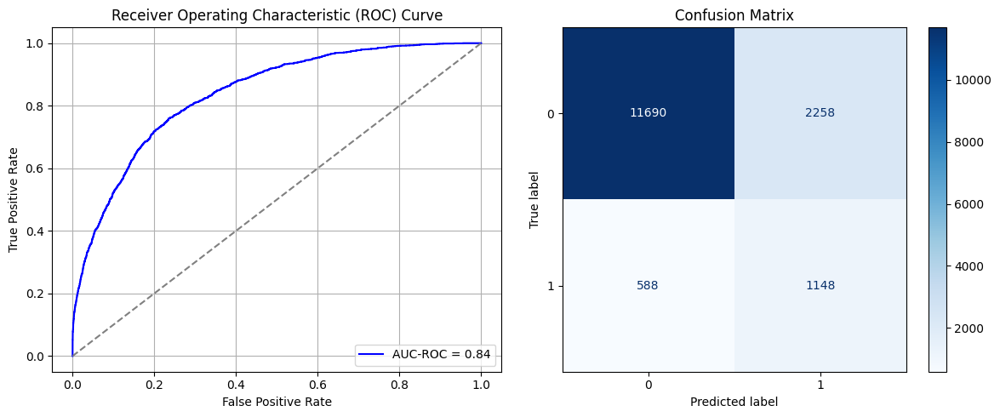

Best threshold based on F1-score: 0.6311057806015015
False Negative Rate: 0.3387096774193548
Time elapsed (performance): 1.6986691990005056
(np.float64(0.16188700889016347), np.float64(0.8381129911098365))
    Source time       FPR       TNR       FNR       TPR  Target time
0     19.560911  0.001792  0.998208  0.847926  0.152074     1.218795
1     15.590755  0.090837  0.909163  0.354839  0.645161     1.208218
2     17.027258  0.009822  0.990178  0.714862  0.285138     1.700018
3     14.909166  0.002653  0.997347  0.828917  0.171083     1.701077
4     16.113916  0.013335  0.986665  0.730991  0.269009     1.691684
5     15.778494  0.020218  0.979782  0.667051  0.332949     1.230897
6     17.314486  0.013765  0.986235  0.741359  0.258641     1.899939
7     18.598500  0.010969  0.989031  0.739055  0.260945     1.683207
8     18.865132  0.104675  0.895325  0.593318  0.406682     1.690620
9     17.080485  0.035991  0.964009  0.697581  0.302419     1.234412
10    25.194898  0.005951  0.994049

In [53]:
import random

times = 50

Training_time = []
FPR = []
TPR = []
FNR = []
TNR = []
TL_time = []

m = 10

k = oversample_size/undersample_size * m
print(k)

# np.random.seed(123)

for i in range(times):
    start = np.random.choice(int(k), 10)
    # print(start)

    Row = []

    Row = []

    for j in range(len(start)):
      for l in range(int(undersample_size/m)):
        row = start[j]+int(k*l)-1
        Row.append(row)

    # print(Row)

    data_S_maj_rus = pd.DataFrame()
    data_S_maj_rus = data_S_majority.iloc[Row]

    data_S_Sy_RUS = pd.concat([data_S_maj_rus, data_S_minority])
    X_S_Sy = data_S_Sy_RUS.iloc[:, :-1]
    y_S_Sy = data_S_Sy_RUS.iloc[:, -1]
    X_S_train, X_S_test, y_S_train, y_S_test = train_test_split(X_S_Sy, y_S_Sy, test_size=0.20, random_state=0)
    model_Sy = create_dnn_model(X_S_train.shape[1])
    result_Sy = train_and_evaluate(model_Sy, X_S_train, X_S_test, y_S_train, y_S_test, "Source")
    result_TL_Sy = Transductive_TL(model_Sy, X_T_full, y_T_full, "Target")
    print(result_TL_Sy[0:2])

    Training_time.append(result_Sy)
    FPR.append(result_TL_Sy[0])
    TNR.append(result_TL_Sy[1])
    FNR.append(result_TL_Sy[2])
    TPR.append(result_TL_Sy[3])
    TL_time.append(result_TL_Sy[4])

# return fpr, tnr, fnr, tpr, time_elapsed

# print(TNR)

ParamFit = pd.DataFrame([Training_time, FPR, TNR, FNR, TPR, TL_time]).T
ParamFit.columns=['Source time', 'FPR', 'TNR', 'FNR', 'TPR', 'Target time']
print(ParamFit)

In [54]:
print(ParamFit)
ParamFit.to_csv('Sy2_RUS.csv')

    Source time       FPR       TNR       FNR       TPR  Target time
0     19.560911  0.001792  0.998208  0.847926  0.152074     1.218795
1     15.590755  0.090837  0.909163  0.354839  0.645161     1.208218
2     17.027258  0.009822  0.990178  0.714862  0.285138     1.700018
3     14.909166  0.002653  0.997347  0.828917  0.171083     1.701077
4     16.113916  0.013335  0.986665  0.730991  0.269009     1.691684
5     15.778494  0.020218  0.979782  0.667051  0.332949     1.230897
6     17.314486  0.013765  0.986235  0.741359  0.258641     1.899939
7     18.598500  0.010969  0.989031  0.739055  0.260945     1.683207
8     18.865132  0.104675  0.895325  0.593318  0.406682     1.690620
9     17.080485  0.035991  0.964009  0.697581  0.302419     1.234412
10    25.194898  0.005951  0.994049  0.787442  0.212558     1.839323
11    20.369380  0.097720  0.902280  0.458525  0.541475     1.290792
12    20.963754  0.046100  0.953900  0.622696  0.377304     4.011155
13    23.413301  0.280327  0.71967

In [55]:
ParamFit['FNR'].mean()

np.float64(0.6482488479262674)

In [56]:
ParamFit['Source time'].mean()

np.float64(25.371344057339922)

# Random Oversampling (ROS):

## Simple Random Sampling with Replacement:

In this case, we investigate the effectiveness of Random Oversampling methods, beginning with Simple Random Sampling (SRS) with replacement. For this, we perform random resampling from the minority class of size $N_1$ to generate an additional sample of size $N_0-N_1$, such that the oversampled minority class will have the same size as the majority class.

In [57]:
data_S
data_S_majority = data_S[data_S['Y'].isin([0])]
data_S_minority = data_S[data_S['Y'].isin([1])]

undersample_size = data_S_minority['Y'].size
oversample_size = data_S_majority['Y'].size

print(undersample_size)
print(oversample_size)

9805
22132


Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.7804 - loss: 0.5719 - val_AUC: 0.8711 - val_loss: 0.4581
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8713 - loss: 0.4431 - val_AUC: 0.8735 - val_loss: 0.4380
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8771 - loss: 0.4332 - val_AUC: 0.8749 - val_loss: 0.4356
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8764 - loss: 0.4336 - val_AUC: 0.8762 - val_loss: 0.4353
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8743 - loss: 0.4385 - val_AUC: 0.8765 - val_loss: 0.4372
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8788 - loss: 0.4300 - val_AUC: 0.8774 - val_loss: 0.4461
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8765 - loss: 0.4331 - val_AUC: 0.8777 - val_loss: 0.4317
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8769 - loss: 0.4320 - val_AUC: 0.8774 - val_loss: 0.4387
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8773 -

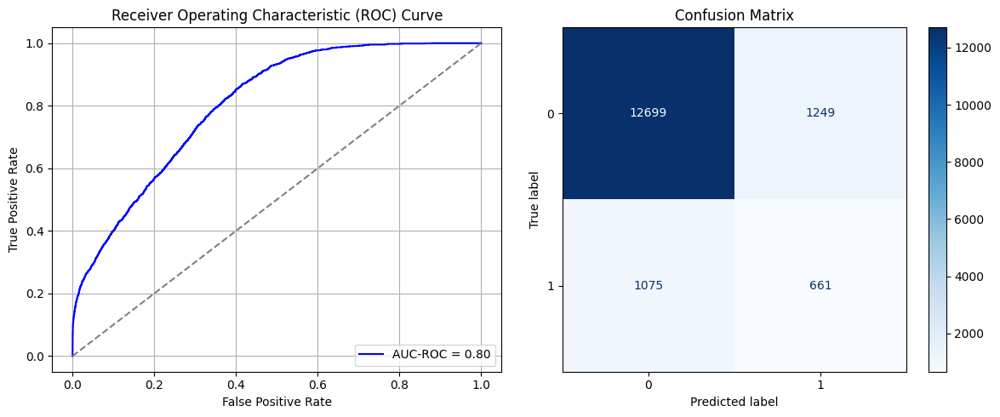

Best threshold based on F1-score: 0.4459579288959503
False Negative Rate: 0.6192396313364056
Time elapsed (performance): 1.8838612399995327
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.7900 - loss: 0.5602 - val_AUC: 0.8705 - val_loss: 0.4471
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8714 - loss: 0.4425 - val_AUC: 0.8738 - val_loss: 0.4447
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8765 - loss: 0.4334 - val_AUC: 0.8751 - val_loss: 0.4488
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8731 - loss: 0.4381 - val_AUC: 0.8758 - val_loss: 0.4355
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8809 - loss: 0.4257 - val_AUC: 0.8764 - val_loss: 0.4340
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8773 - loss: 0.4304 - val_AUC: 0.8770 - val_loss: 0.4324
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8782 - loss: 0.4296 - val_AUC: 0.8766 - val_loss: 0.4324
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8782 - loss: 0.4292 - val_AUC: 0.8769 - val_loss: 0.4395
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - AUC: 0.8809 -

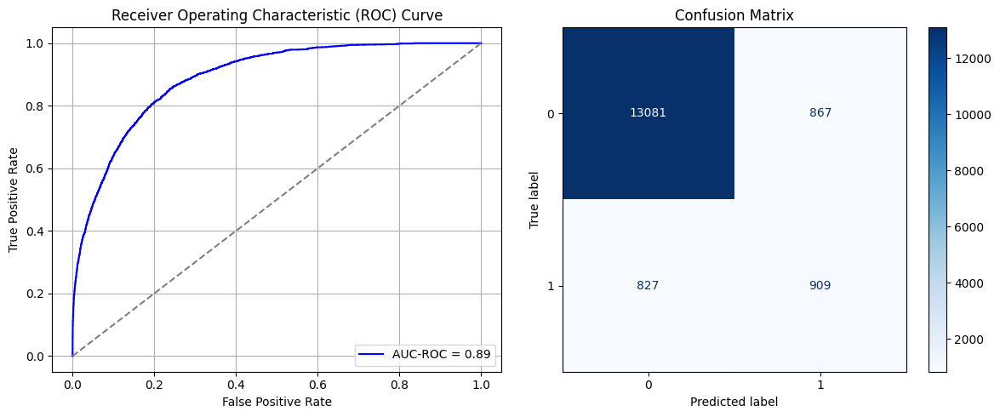

Best threshold based on F1-score: 0.42785418033599854
False Negative Rate: 0.4763824884792627
Time elapsed (performance): 1.2316516740002044
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.7792 - loss: 0.5639 - val_AUC: 0.8695 - val_loss: 0.4759
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8683 - loss: 0.4471 - val_AUC: 0.8724 - val_loss: 0.4390
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8756 - loss: 0.4347 - val_AUC: 0.8733 - val_loss: 0.4375
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8761 - loss: 0.4333 - val_AUC: 0.8748 - val_loss: 0.4412
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8799 - loss: 0.4275 - val_AUC: 0.8759 - val_loss: 0.4376
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8796 - loss: 0.4287 - val_AUC: 0.8759 - val_loss: 0.4347
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8772 - loss: 0.4321 - val_AUC: 0.8758 - val_loss: 0.4354
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8797 - loss: 0.4259 - val_AUC: 0.8769 - val_loss: 0.4360
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8809 -

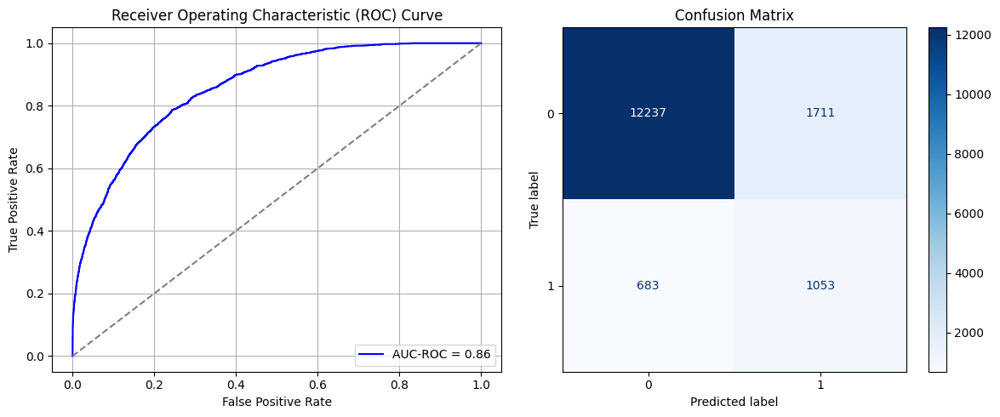

Best threshold based on F1-score: 0.5569233894348145
False Negative Rate: 0.3934331797235023
Time elapsed (performance): 1.5163931680008318
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.7743 - loss: 0.5644 - val_AUC: 0.8758 - val_loss: 0.4463
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8735 - loss: 0.4369 - val_AUC: 0.8771 - val_loss: 0.4371
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8729 - loss: 0.4390 - val_AUC: 0.8796 - val_loss: 0.4280
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8727 - loss: 0.4382 - val_AUC: 0.8803 - val_loss: 0.4316
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8770 - loss: 0.4322 - val_AUC: 0.8798 - val_loss: 0.4339
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8775 - loss: 0.4308 - val_AUC: 0.8808 - val_loss: 0.4276
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8820 - loss: 0.4238 - val_AUC: 0.8794 - val_loss: 0.4318
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8792 - loss: 0.4283 - val_AUC: 0.8815 - val_loss: 0.4272
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8772 -

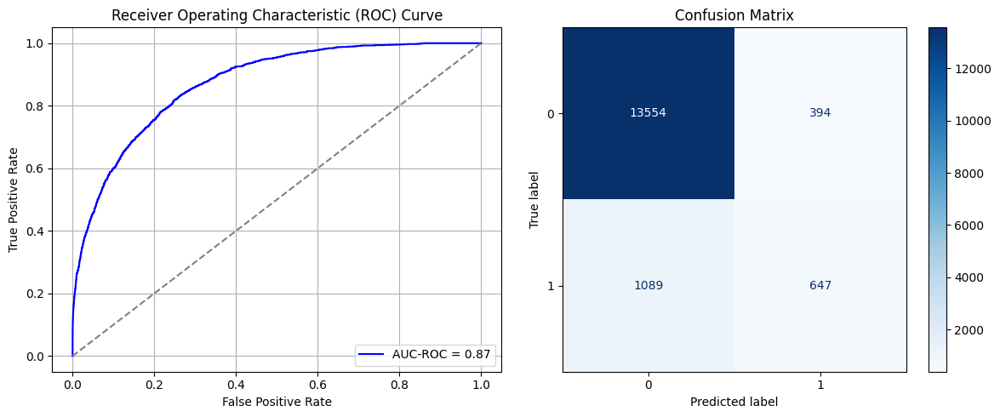

Best threshold based on F1-score: 0.3181411325931549
False Negative Rate: 0.6273041474654378
Time elapsed (performance): 1.2041909170002327
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.7532 - loss: 0.5730 - val_AUC: 0.8728 - val_loss: 0.4416
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8721 - loss: 0.4427 - val_AUC: 0.8744 - val_loss: 0.4386
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8708 - loss: 0.4432 - val_AUC: 0.8760 - val_loss: 0.4346
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8753 - loss: 0.4367 - val_AUC: 0.8758 - val_loss: 0.4380
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8775 - loss: 0.4311 - val_AUC: 0.8765 - val_loss: 0.4339
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8821 - loss: 0.4245 - val_AUC: 0.8775 - val_loss: 0.4316
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8797 - loss: 0.4275 - val_AUC: 0.8786 - val_loss: 0.4331
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8818 - loss: 0.4239 - val_AUC: 0.8791 - val_loss: 0.4306
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8804 -

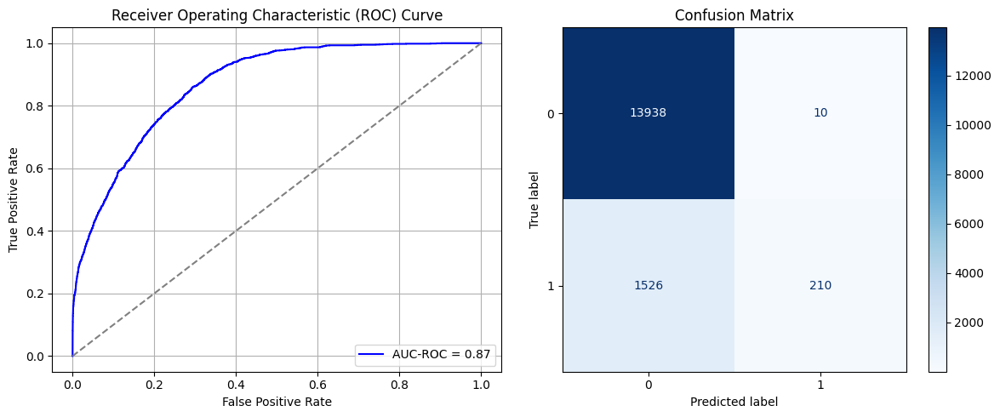

Best threshold based on F1-score: 0.02422872744500637
False Negative Rate: 0.8790322580645161
Time elapsed (performance): 1.2571039739996195
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.7741 - loss: 0.5634 - val_AUC: 0.8745 - val_loss: 0.4380
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8742 - loss: 0.4393 - val_AUC: 0.8767 - val_loss: 0.4340
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8757 - loss: 0.4349 - val_AUC: 0.8789 - val_loss: 0.4354
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8747 - loss: 0.4355 - val_AUC: 0.8782 - val_loss: 0.4321
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8790 - loss: 0.4306 - val_AUC: 0.8792 - val_loss: 0.4307
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8776 - loss: 0.4314 - val_AUC: 0.8799 - val_loss: 0.4308
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8805 - loss: 0.4261 - val_AUC: 0.8794 - val_loss: 0.4297
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8816 - loss: 0.4245 - val_AUC: 0.8800 - val_loss: 0.4278
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8834 -

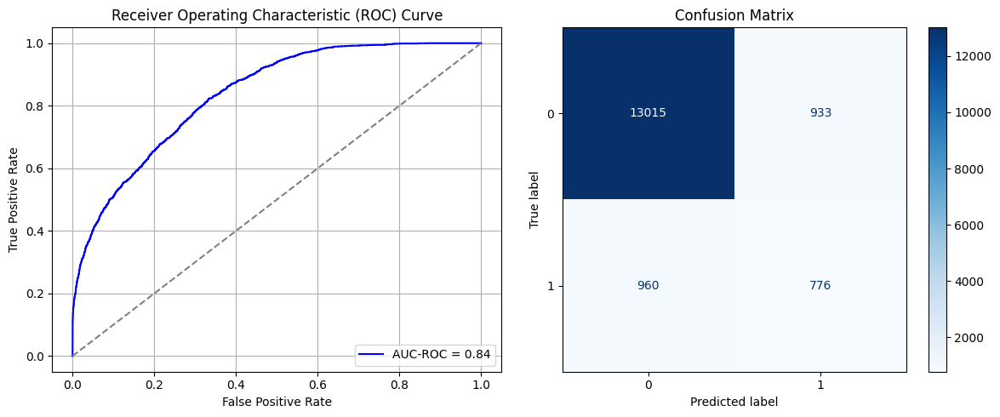

Best threshold based on F1-score: 0.4897158145904541
False Negative Rate: 0.5529953917050692
Time elapsed (performance): 1.8360336189998634
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.7823 - loss: 0.5586 - val_AUC: 0.8712 - val_loss: 0.4457
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8746 - loss: 0.4372 - val_AUC: 0.8734 - val_loss: 0.4391
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8754 - loss: 0.4348 - val_AUC: 0.8754 - val_loss: 0.4393
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8761 - loss: 0.4347 - val_AUC: 0.8756 - val_loss: 0.4373
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8770 - loss: 0.4326 - val_AUC: 0.8761 - val_loss: 0.4355
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8778 - loss: 0.4304 - val_AUC: 0.8774 - val_loss: 0.4321
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8798 - loss: 0.4267 - val_AUC: 0.8759 - val_loss: 0.4444
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8794 - loss: 0.4281 - val_AUC: 0.8782 - val_loss: 0.4306
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8820 -

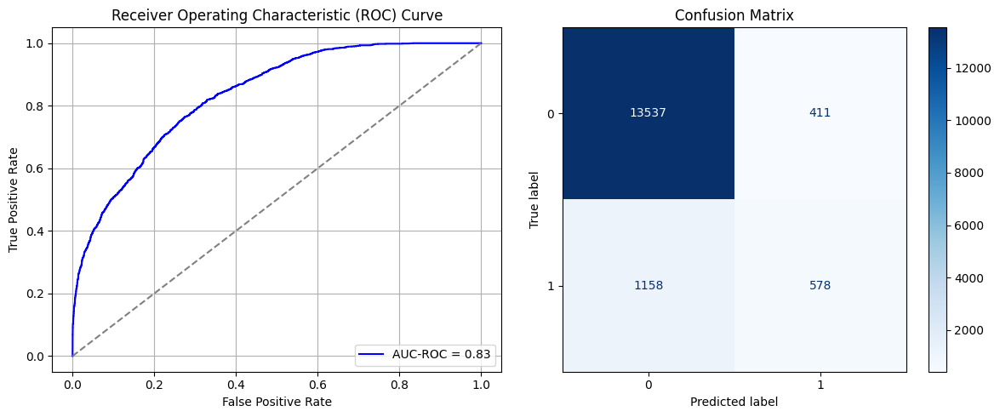

Best threshold based on F1-score: 0.32777974009513855
False Negative Rate: 0.6670506912442397
Time elapsed (performance): 1.747740609000175
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7820 - loss: 0.5616 - val_AUC: 0.8719 - val_loss: 0.4502
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8717 - loss: 0.4425 - val_AUC: 0.8763 - val_loss: 0.4411
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - AUC: 0.8756 - loss: 0.4368 - val_AUC: 0.8762 - val_loss: 0.4352
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8762 - loss: 0.4347 - val_AUC: 0.8764 - val_loss: 0.4374
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8788 - loss: 0.4313 - val_AUC: 0.8788 - val_loss: 0.4346
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8785 - loss: 0.4306 - val_AUC: 0.8785 - val_loss: 0.4328
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8782 - loss: 0.4305 - val_AUC: 0.8798 - val_loss: 0.4345
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8790 - loss: 0.4299 - val_AUC: 0.8793 - val_loss: 0.4294
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8834 -

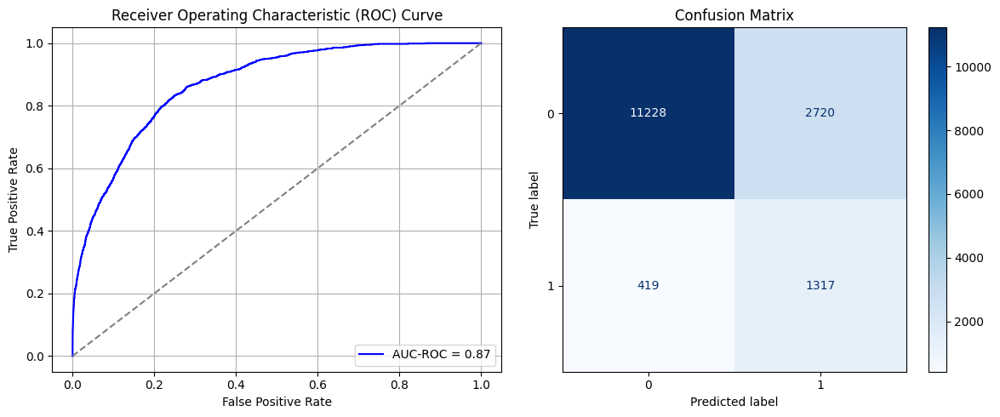

Best threshold based on F1-score: 0.7559037804603577
False Negative Rate: 0.2413594470046083
Time elapsed (performance): 1.7048430410004585
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7700 - loss: 0.5671 - val_AUC: 0.8712 - val_loss: 0.4520
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8701 - loss: 0.4439 - val_AUC: 0.8751 - val_loss: 0.4367
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8746 - loss: 0.4361 - val_AUC: 0.8756 - val_loss: 0.4414
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8702 - loss: 0.4434 - val_AUC: 0.8760 - val_loss: 0.4388
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8784 - loss: 0.4304 - val_AUC: 0.8771 - val_loss: 0.4347
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8752 - loss: 0.4345 - val_AUC: 0.8769 - val_loss: 0.4346
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8749 - loss: 0.4355 - val_AUC: 0.8773 - val_loss: 0.4358
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8795 - loss: 0.4283 - val_AUC: 0.8778 - val_loss: 0.4319
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8775 -

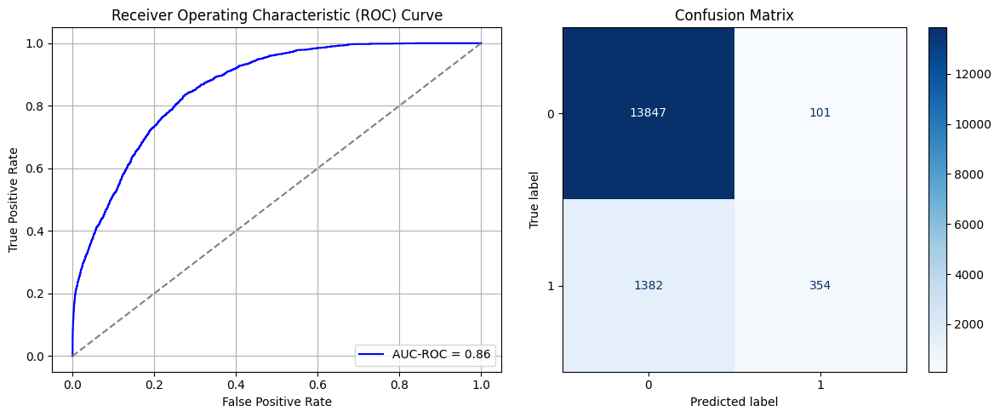

Best threshold based on F1-score: 0.09348168224096298
False Negative Rate: 0.7960829493087558
Time elapsed (performance): 1.7188593430000765
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.7782 - loss: 0.5670 - val_AUC: 0.8669 - val_loss: 0.4503
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8719 - loss: 0.4418 - val_AUC: 0.8696 - val_loss: 0.4493
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8776 - loss: 0.4316 - val_AUC: 0.8708 - val_loss: 0.4469
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8751 - loss: 0.4354 - val_AUC: 0.8712 - val_loss: 0.4428
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8790 - loss: 0.4303 - val_AUC: 0.8718 - val_loss: 0.4410
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8801 - loss: 0.4268 - val_AUC: 0.8728 - val_loss: 0.4407
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8804 - loss: 0.4265 - val_AUC: 0.8728 - val_loss: 0.4402
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8786 - loss: 0.4303 - val_AUC: 0.8730 - val_loss: 0.4388
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8803 -

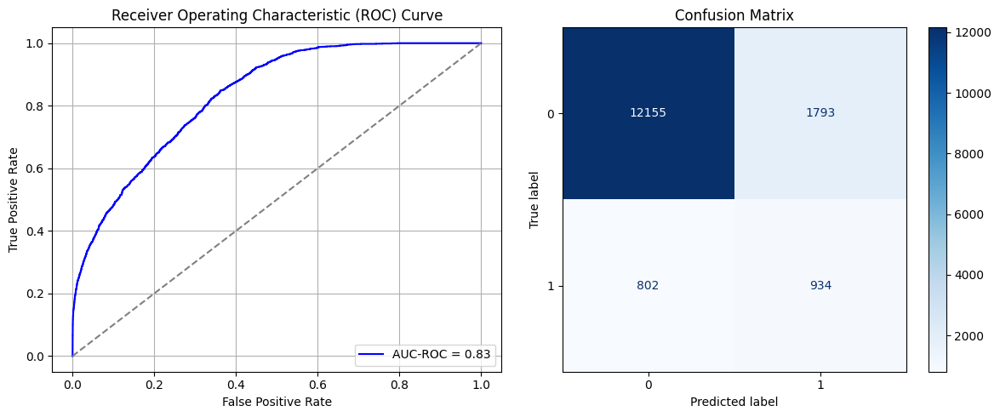

Best threshold based on F1-score: 0.6302700042724609
False Negative Rate: 0.4619815668202765
Time elapsed (performance): 1.2897522169996591
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7693 - loss: 0.5678 - val_AUC: 0.8719 - val_loss: 0.4550
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8756 - loss: 0.4362 - val_AUC: 0.8755 - val_loss: 0.4364
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8760 - loss: 0.4344 - val_AUC: 0.8755 - val_loss: 0.4427
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8770 - loss: 0.4314 - val_AUC: 0.8759 - val_loss: 0.4343
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8809 - loss: 0.4264 - val_AUC: 0.8771 - val_loss: 0.4336
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8831 - loss: 0.4221 - val_AUC: 0.8775 - val_loss: 0.4356
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8793 - loss: 0.4268 - val_AUC: 0.8778 - val_loss: 0.4335
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8835 - loss: 0.4218 - val_AUC: 0.8777 - val_loss: 0.4412
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8798 -

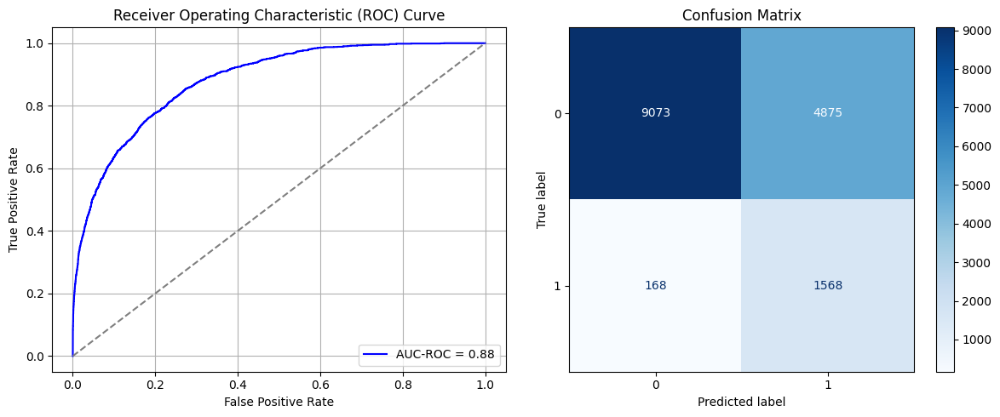

Best threshold based on F1-score: 0.811828076839447
False Negative Rate: 0.0967741935483871
Time elapsed (performance): 1.9323709990003408
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7913 - loss: 0.5643 - val_AUC: 0.8708 - val_loss: 0.4472
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8729 - loss: 0.4398 - val_AUC: 0.8740 - val_loss: 0.4382
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8709 - loss: 0.4412 - val_AUC: 0.8754 - val_loss: 0.4357
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8768 - loss: 0.4335 - val_AUC: 0.8751 - val_loss: 0.4421
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8757 - loss: 0.4335 - val_AUC: 0.8766 - val_loss: 0.4366
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8797 - loss: 0.4268 - val_AUC: 0.8767 - val_loss: 0.4341
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8792 - loss: 0.4281 - val_AUC: 0.8770 - val_loss: 0.4334
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8776 - loss: 0.4306 - val_AUC: 0.8763 - val_loss: 0.4351
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8788 -

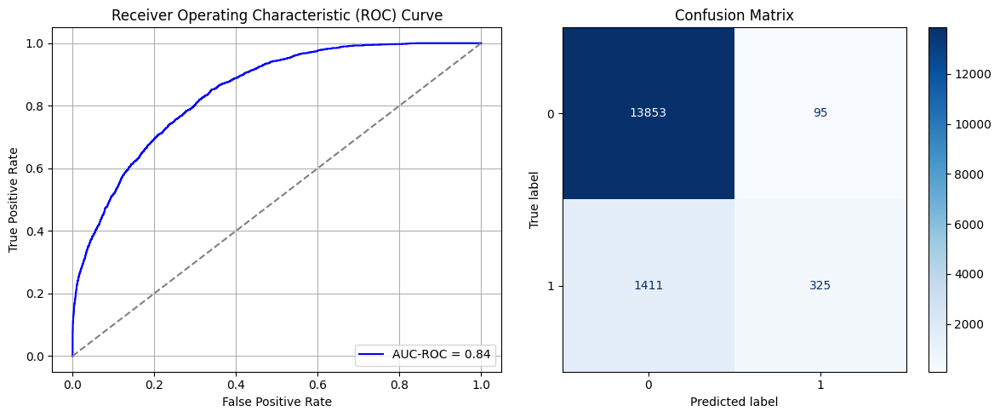

Best threshold based on F1-score: 0.09970284253358841
False Negative Rate: 0.8127880184331797
Time elapsed (performance): 1.715150824000375
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.7717 - loss: 0.5747 - val_AUC: 0.8685 - val_loss: 0.4476
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8717 - loss: 0.4430 - val_AUC: 0.8712 - val_loss: 0.4439
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8768 - loss: 0.4353 - val_AUC: 0.8723 - val_loss: 0.4413
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8782 - loss: 0.4318 - val_AUC: 0.8737 - val_loss: 0.4387
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8761 - loss: 0.4336 - val_AUC: 0.8725 - val_loss: 0.4431
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8800 - loss: 0.4268 - val_AUC: 0.8749 - val_loss: 0.4360
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8758 - loss: 0.4344 - val_AUC: 0.8752 - val_loss: 0.4370
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.8802 - loss: 0.4262 - val_AUC: 0.8753 - val_loss: 0.4388
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8780 -

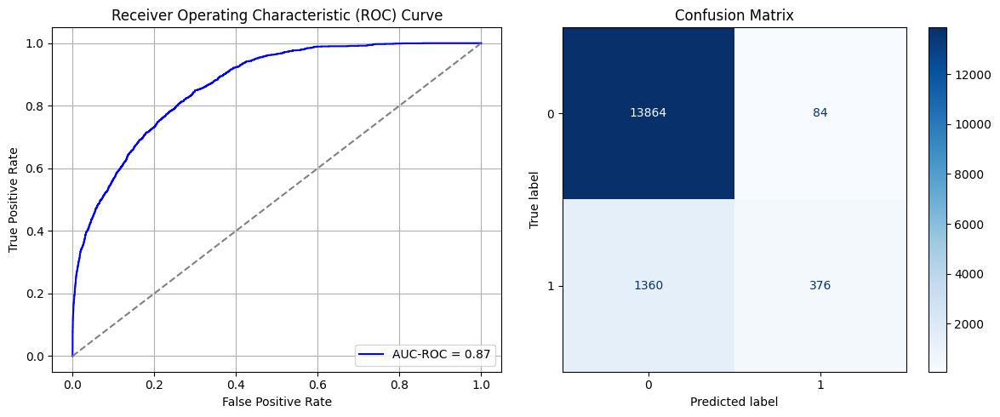

Best threshold based on F1-score: 0.16456986963748932
False Negative Rate: 0.783410138248848
Time elapsed (performance): 1.7353738539995902
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.7776 - loss: 0.5670 - val_AUC: 0.8696 - val_loss: 0.4451
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8722 - loss: 0.4419 - val_AUC: 0.8738 - val_loss: 0.4467
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8756 - loss: 0.4360 - val_AUC: 0.8741 - val_loss: 0.4411
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8734 - loss: 0.4385 - val_AUC: 0.8766 - val_loss: 0.4334
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8821 - loss: 0.4249 - val_AUC: 0.8752 - val_loss: 0.4334
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8790 - loss: 0.4297 - val_AUC: 0.8776 - val_loss: 0.4320
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8818 - loss: 0.4241 - val_AUC: 0.8765 - val_loss: 0.4312
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8792 - loss: 0.4275 - val_AUC: 0.8781 - val_loss: 0.4300
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8841 -

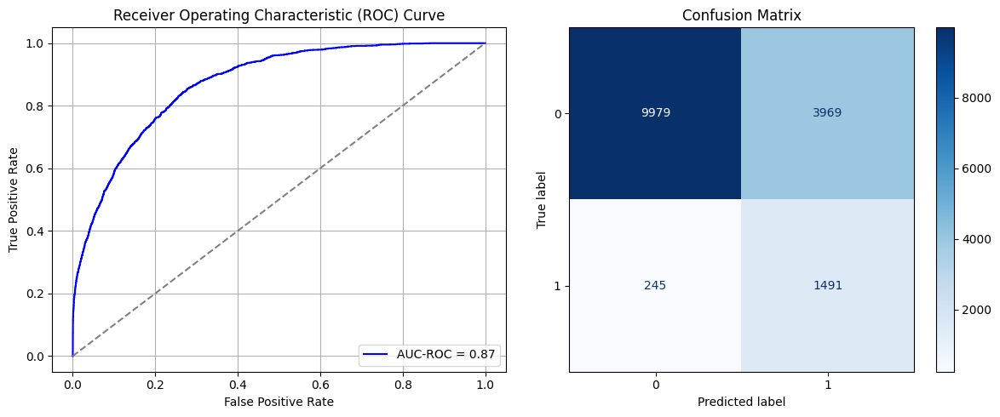

Best threshold based on F1-score: 0.7173454165458679
False Negative Rate: 0.14112903225806453
Time elapsed (performance): 1.572797509999873
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 11s 5ms/step - AUC: 0.7598 - loss: 0.5751 - val_AUC: 0.8690 - val_loss: 0.4486
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8704 - loss: 0.4437 - val_AUC: 0.8736 - val_loss: 0.4390
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - AUC: 0.8769 - loss: 0.4334 - val_AUC: 0.8749 - val_loss: 0.4361
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 8s 4ms/step - AUC: 0.8754 - loss: 0.4359 - val_AUC: 0.8763 - val_loss: 0.4340
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8761 - loss: 0.4344 - val_AUC: 0.8769 - val_loss: 0.4344
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8767 - loss: 0.4328 - val_AUC: 0.8774 - val_loss: 0.4374
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8782 - loss: 0.4308 - val_AUC: 0.8771 - val_loss: 0.4424
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8823 - loss: 0.4241 - val_AUC: 0.8784 - val_loss: 0.4311
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8801 

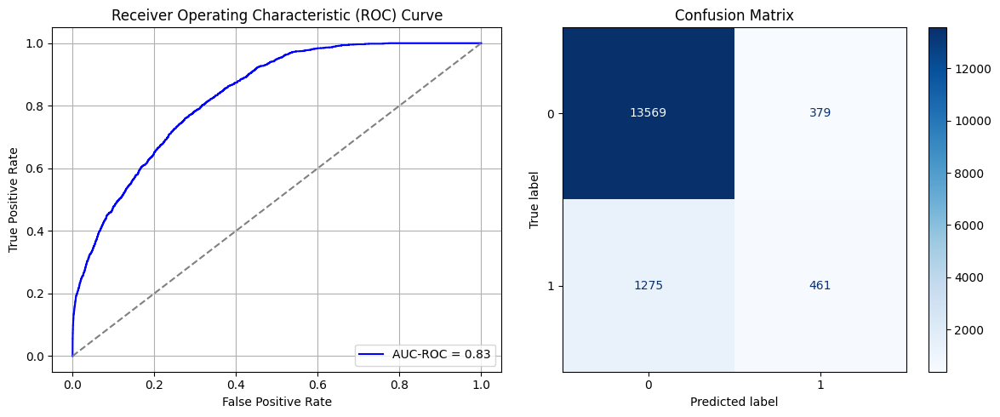

Best threshold based on F1-score: 0.29296475648880005
False Negative Rate: 0.7344470046082949
Time elapsed (performance): 1.9964777269997285
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7730 - loss: 0.5751 - val_AUC: 0.8733 - val_loss: 0.4425
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8714 - loss: 0.4434 - val_AUC: 0.8777 - val_loss: 0.4336
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8722 - loss: 0.4401 - val_AUC: 0.8777 - val_loss: 0.4340
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8757 - loss: 0.4336 - val_AUC: 0.8793 - val_loss: 0.4305
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8773 - loss: 0.4323 - val_AUC: 0.8787 - val_loss: 0.4305
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8768 - loss: 0.4319 - val_AUC: 0.8799 - val_loss: 0.4293
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8771 - loss: 0.4321 - val_AUC: 0.8807 - val_loss: 0.4370
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.8792 - loss: 0.4280 - val_AUC: 0.8811 - val_loss: 0.4303
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8823 -

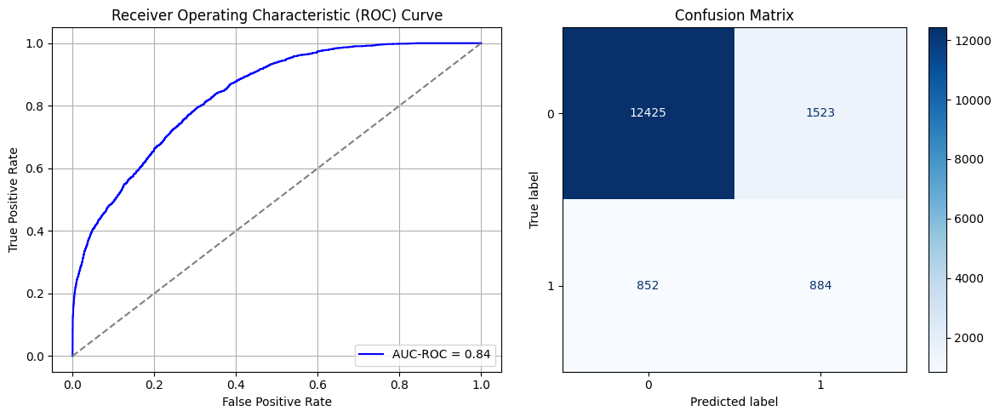

Best threshold based on F1-score: 0.632906973361969
False Negative Rate: 0.49078341013824883
Time elapsed (performance): 1.9302087010000832
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.7808 - loss: 0.5603 - val_AUC: 0.8742 - val_loss: 0.4453
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8702 - loss: 0.4442 - val_AUC: 0.8777 - val_loss: 0.4326
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8768 - loss: 0.4340 - val_AUC: 0.8783 - val_loss: 0.4303
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8756 - loss: 0.4358 - val_AUC: 0.8793 - val_loss: 0.4294
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8773 - loss: 0.4323 - val_AUC: 0.8797 - val_loss: 0.4272
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8766 - loss: 0.4330 - val_AUC: 0.8807 - val_loss: 0.4287
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8803 - loss: 0.4279 - val_AUC: 0.8802 - val_loss: 0.4270
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8820 - loss: 0.4235 - val_AUC: 0.8813 - val_loss: 0.4249
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8811 -

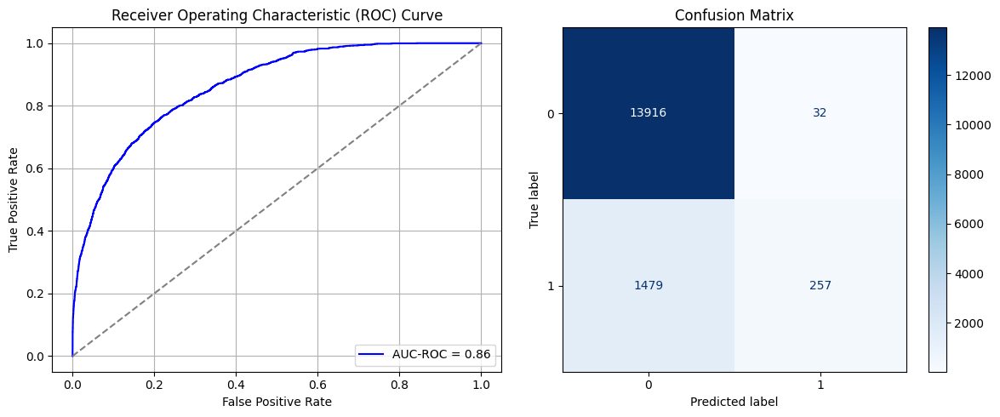

Best threshold based on F1-score: 0.09212468564510345
False Negative Rate: 0.8519585253456221
Time elapsed (performance): 1.5224199289987155
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7835 - loss: 0.5570 - val_AUC: 0.8697 - val_loss: 0.4466
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8684 - loss: 0.4468 - val_AUC: 0.8723 - val_loss: 0.4439
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8724 - loss: 0.4391 - val_AUC: 0.8730 - val_loss: 0.4400
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8757 - loss: 0.4363 - val_AUC: 0.8741 - val_loss: 0.4378
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8799 - loss: 0.4285 - val_AUC: 0.8747 - val_loss: 0.4388
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8738 - loss: 0.4366 - val_AUC: 0.8755 - val_loss: 0.4355
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8818 - loss: 0.4249 - val_AUC: 0.8759 - val_loss: 0.4345
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8780 - loss: 0.4310 - val_AUC: 0.8752 - val_loss: 0.4393
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8803 -

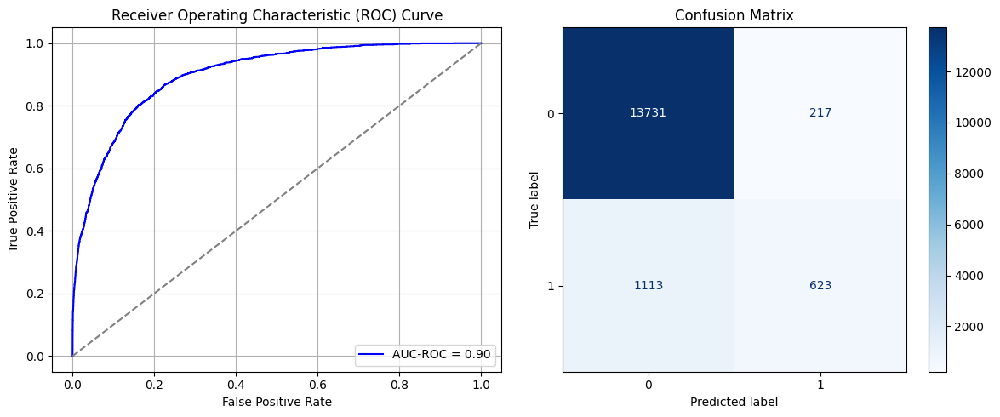

Best threshold based on F1-score: 0.2699778974056244
False Negative Rate: 0.6411290322580645
Time elapsed (performance): 1.9271837079995748
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.7868 - loss: 0.5565 - val_AUC: 0.8723 - val_loss: 0.4434
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8740 - loss: 0.4381 - val_AUC: 0.8748 - val_loss: 0.4421
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.8759 - loss: 0.4352 - val_AUC: 0.8761 - val_loss: 0.4360
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8797 - loss: 0.4287 - val_AUC: 0.8771 - val_loss: 0.4343
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8751 - loss: 0.4345 - val_AUC: 0.8758 - val_loss: 0.4366
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 6ms/step - AUC: 0.8787 - loss: 0.4307 - val_AUC: 0.8772 - val_loss: 0.4343
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8780 - loss: 0.4305 - val_AUC: 0.8769 - val_loss: 0.4332
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8847 - loss: 0.4203 - val_AUC: 0.8783 - val_loss: 0.4320
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 6ms/step - AUC: 0.8801 -

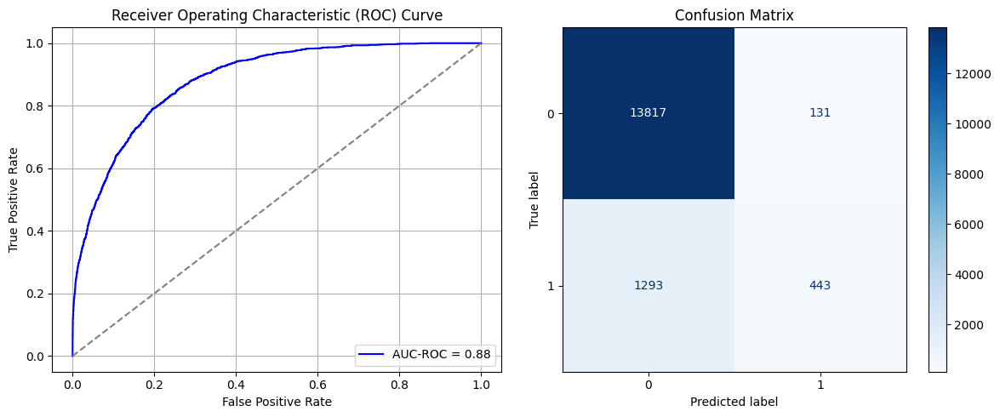

Best threshold based on F1-score: 0.1471395045518875
False Negative Rate: 0.744815668202765
Time elapsed (performance): 2.1227709100003267
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.7771 - loss: 0.5705 - val_AUC: 0.8741 - val_loss: 0.4400
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8719 - loss: 0.4422 - val_AUC: 0.8775 - val_loss: 0.4485
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8735 - loss: 0.4385 - val_AUC: 0.8783 - val_loss: 0.4313
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8778 - loss: 0.4325 - val_AUC: 0.8789 - val_loss: 0.4384
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8767 - loss: 0.4327 - val_AUC: 0.8810 - val_loss: 0.4261
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 7s 6ms/step - AUC: 0.8747 - loss: 0.4354 - val_AUC: 0.8813 - val_loss: 0.4326
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8784 - loss: 0.4308 - val_AUC: 0.8820 - val_loss: 0.4247
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8817 - loss: 0.4242 - val_AUC: 0.8822 - val_loss: 0.4253
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8794 -

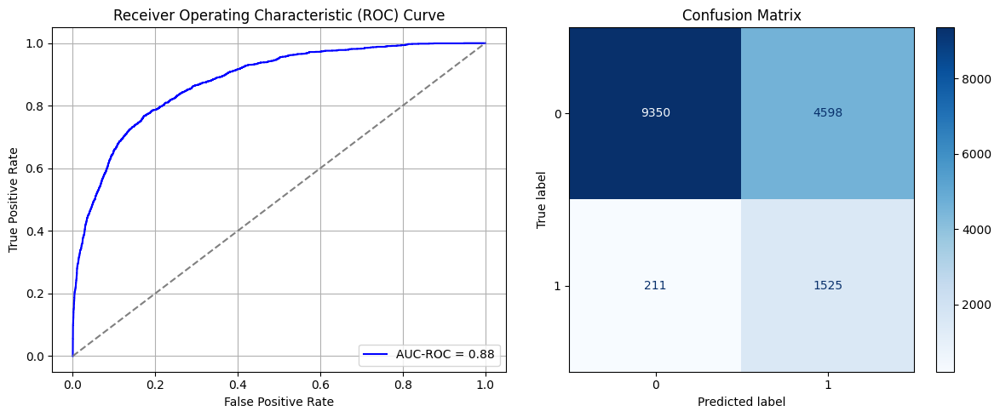

Best threshold based on F1-score: 0.7683045268058777
False Negative Rate: 0.12154377880184332
Time elapsed (performance): 1.7675475859996368
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.7776 - loss: 0.5678 - val_AUC: 0.8738 - val_loss: 0.4515
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8698 - loss: 0.4443 - val_AUC: 0.8760 - val_loss: 0.4363
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - AUC: 0.8766 - loss: 0.4334 - val_AUC: 0.8765 - val_loss: 0.4350
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8768 - loss: 0.4337 - val_AUC: 0.8772 - val_loss: 0.4373
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8759 - loss: 0.4346 - val_AUC: 0.8779 - val_loss: 0.4325
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8776 - loss: 0.4306 - val_AUC: 0.8793 - val_loss: 0.4311
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.8785 - loss: 0.4306 - val_AUC: 0.8793 - val_loss: 0.4340
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.8753 - loss: 0.4343 - val_AUC: 0.8797 - val_loss: 0.4293
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8795 -

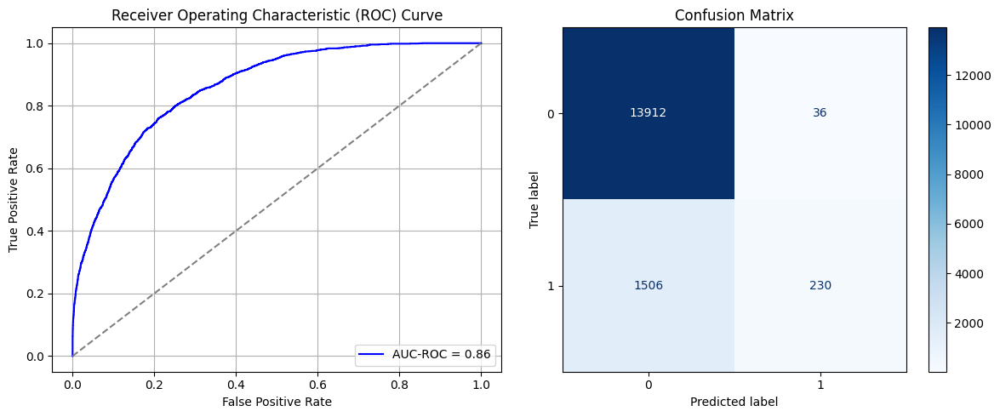

Best threshold based on F1-score: 0.08070596307516098
False Negative Rate: 0.8675115207373272
Time elapsed (performance): 1.578833798001142
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 7s 6ms/step - AUC: 0.7737 - loss: 0.5617 - val_AUC: 0.8707 - val_loss: 0.4467
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.8678 - loss: 0.4477 - val_AUC: 0.8737 - val_loss: 0.4451
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8728 - loss: 0.4389 - val_AUC: 0.8753 - val_loss: 0.4361
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8764 - loss: 0.4344 - val_AUC: 0.8756 - val_loss: 0.4343
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8736 - loss: 0.4369 - val_AUC: 0.8772 - val_loss: 0.4322
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.8779 - loss: 0.4315 - val_AUC: 0.8768 - val_loss: 0.4316
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8794 - loss: 0.4290 - val_AUC: 0.8777 - val_loss: 0.4346
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8796 - loss: 0.4291 - val_AUC: 0.8769 - val_loss: 0.4330
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8825 -

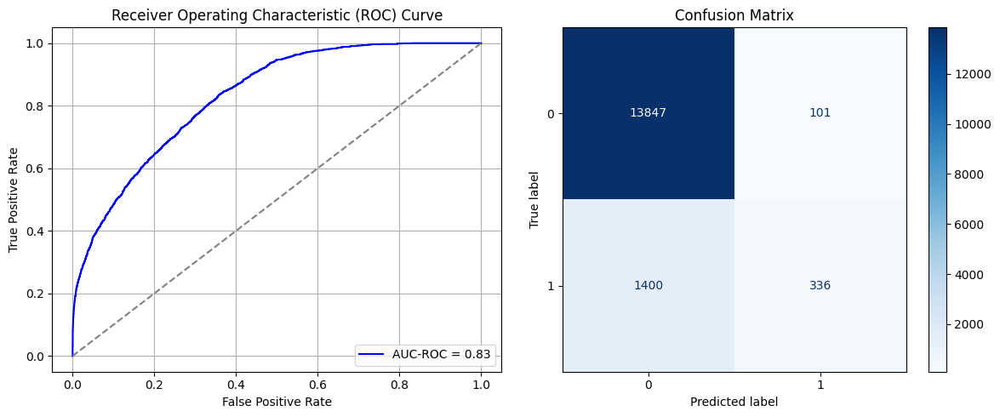

Best threshold based on F1-score: 0.18829867243766785
False Negative Rate: 0.8064516129032258
Time elapsed (performance): 1.7313312330006738
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.7661 - loss: 0.5739 - val_AUC: 0.8733 - val_loss: 0.4522
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8689 - loss: 0.4450 - val_AUC: 0.8759 - val_loss: 0.4553
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8743 - loss: 0.4376 - val_AUC: 0.8787 - val_loss: 0.4304
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.8769 - loss: 0.4318 - val_AUC: 0.8792 - val_loss: 0.4288
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8787 - loss: 0.4299 - val_AUC: 0.8800 - val_loss: 0.4334
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8774 - loss: 0.4322 - val_AUC: 0.8805 - val_loss: 0.4274
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 6ms/step - AUC: 0.8793 - loss: 0.4281 - val_AUC: 0.8800 - val_loss: 0.4282
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8800 - loss: 0.4258 - val_AUC: 0.8801 - val_loss: 0.4276
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8773 -

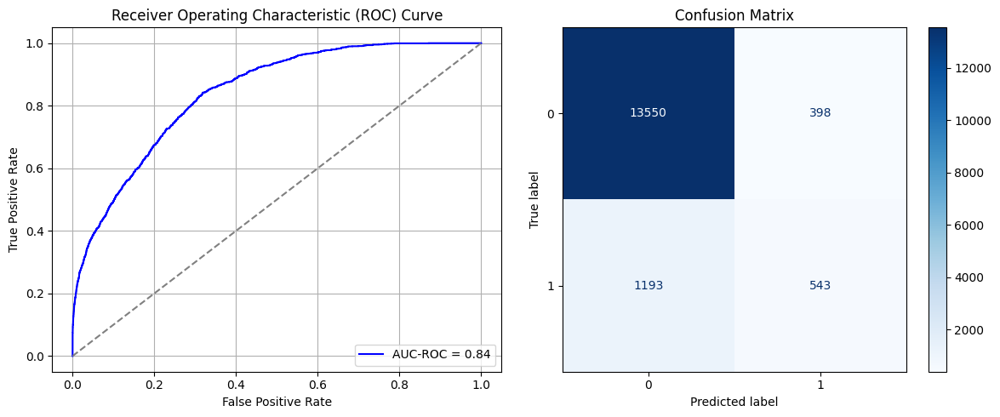

Best threshold based on F1-score: 0.2591249942779541
False Negative Rate: 0.6872119815668203
Time elapsed (performance): 1.409175796999989
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7852 - loss: 0.5622 - val_AUC: 0.8741 - val_loss: 0.4430
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8707 - loss: 0.4428 - val_AUC: 0.8754 - val_loss: 0.4397
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8763 - loss: 0.4328 - val_AUC: 0.8774 - val_loss: 0.4379
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8753 - loss: 0.4349 - val_AUC: 0.8779 - val_loss: 0.4391
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8749 - loss: 0.4353 - val_AUC: 0.8788 - val_loss: 0.4316
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8765 - loss: 0.4335 - val_AUC: 0.8787 - val_loss: 0.4336
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8803 - loss: 0.4268 - val_AUC: 0.8795 - val_loss: 0.4323
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8760 - loss: 0.4338 - val_AUC: 0.8796 - val_loss: 0.4302
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8772 -

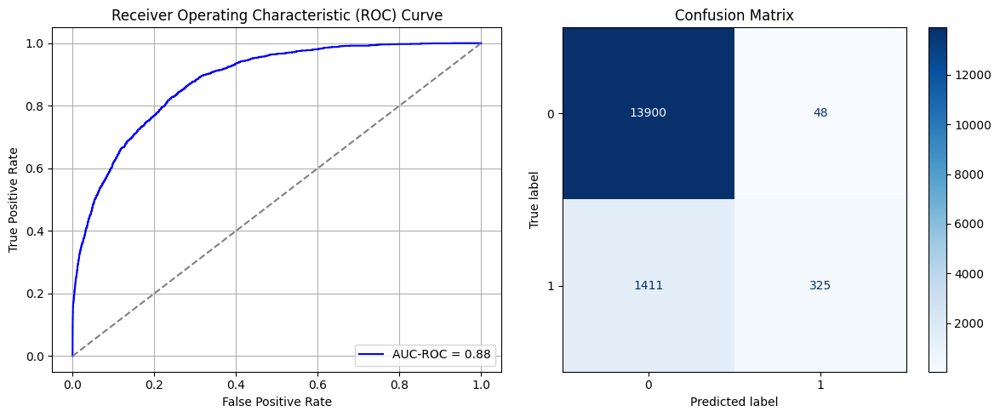

Best threshold based on F1-score: 0.1343790739774704
False Negative Rate: 0.8127880184331797
Time elapsed (performance): 1.732051136001246
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7744 - loss: 0.5680 - val_AUC: 0.8715 - val_loss: 0.4539
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8730 - loss: 0.4411 - val_AUC: 0.8737 - val_loss: 0.4521
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.8769 - loss: 0.4335 - val_AUC: 0.8754 - val_loss: 0.4362
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8790 - loss: 0.4278 - val_AUC: 0.8756 - val_loss: 0.4358
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8774 - loss: 0.4308 - val_AUC: 0.8773 - val_loss: 0.4345
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8772 - loss: 0.4327 - val_AUC: 0.8772 - val_loss: 0.4399
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8787 - loss: 0.4300 - val_AUC: 0.8771 - val_loss: 0.4321
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8821 - loss: 0.4251 - val_AUC: 0.8777 - val_loss: 0.4326
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8800 -

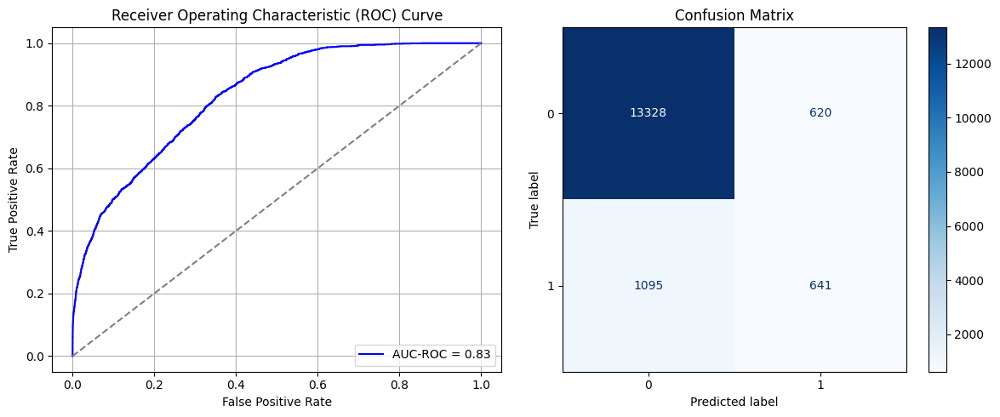

Best threshold based on F1-score: 0.4101122319698334
False Negative Rate: 0.6307603686635944
Time elapsed (performance): 1.4088089560009394
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7766 - loss: 0.5631 - val_AUC: 0.8745 - val_loss: 0.4588
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8716 - loss: 0.4423 - val_AUC: 0.8761 - val_loss: 0.4425
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8714 - loss: 0.4417 - val_AUC: 0.8786 - val_loss: 0.4327
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8767 - loss: 0.4332 - val_AUC: 0.8791 - val_loss: 0.4293
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8767 - loss: 0.4322 - val_AUC: 0.8789 - val_loss: 0.4293
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8775 - loss: 0.4311 - val_AUC: 0.8803 - val_loss: 0.4273
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8798 - loss: 0.4277 - val_AUC: 0.8794 - val_loss: 0.4308
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8803 - loss: 0.4277 - val_AUC: 0.8802 - val_loss: 0.4298
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8763 -

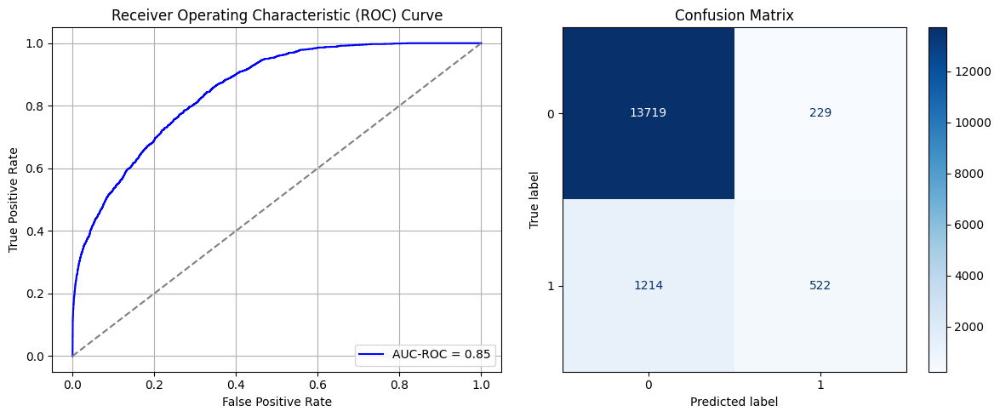

Best threshold based on F1-score: 0.23029394447803497
False Negative Rate: 0.6993087557603687
Time elapsed (performance): 1.3862686400007078
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 7s 6ms/step - AUC: 0.7807 - loss: 0.5663 - val_AUC: 0.8643 - val_loss: 0.4544
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8687 - loss: 0.4472 - val_AUC: 0.8682 - val_loss: 0.4455
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8732 - loss: 0.4385 - val_AUC: 0.8705 - val_loss: 0.4453
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8765 - loss: 0.4339 - val_AUC: 0.8715 - val_loss: 0.4467
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8775 - loss: 0.4327 - val_AUC: 0.8727 - val_loss: 0.4538
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8803 - loss: 0.4288 - val_AUC: 0.8730 - val_loss: 0.4420
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8788 - loss: 0.4294 - val_AUC: 0.8737 - val_loss: 0.4368
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8791 - loss: 0.4301 - val_AUC: 0.8744 - val_loss: 0.4383
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8825 -

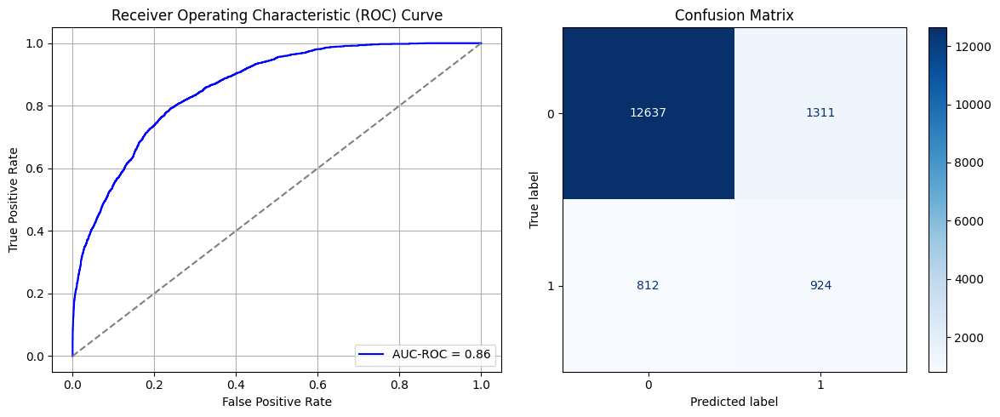

Best threshold based on F1-score: 0.5091099143028259
False Negative Rate: 0.46774193548387094
Time elapsed (performance): 1.7251146060007159
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7810 - loss: 0.5656 - val_AUC: 0.8722 - val_loss: 0.4469
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 6ms/step - AUC: 0.8737 - loss: 0.4398 - val_AUC: 0.8742 - val_loss: 0.4387
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 8s 4ms/step - AUC: 0.8746 - loss: 0.4376 - val_AUC: 0.8763 - val_loss: 0.4478
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8729 - loss: 0.4397 - val_AUC: 0.8753 - val_loss: 0.4406
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8732 - loss: 0.4389 - val_AUC: 0.8770 - val_loss: 0.4342
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8756 - loss: 0.4335 - val_AUC: 0.8782 - val_loss: 0.4327
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8799 - loss: 0.4290 - val_AUC: 0.8789 - val_loss: 0.4338
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8805 - loss: 0.4263 - val_AUC: 0.8793 - val_loss: 0.4312
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 7s 6ms/step - AUC: 0.8800 -

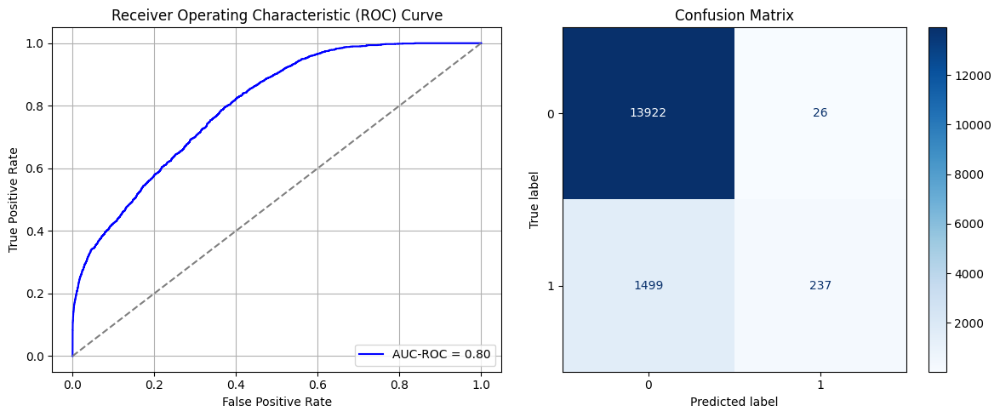

Best threshold based on F1-score: 0.10159259289503098
False Negative Rate: 0.863479262672811
Time elapsed (performance): 1.434779011999126
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.7532 - loss: 0.5733 - val_AUC: 0.8689 - val_loss: 0.4486
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8699 - loss: 0.4452 - val_AUC: 0.8743 - val_loss: 0.4383
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8750 - loss: 0.4363 - val_AUC: 0.8749 - val_loss: 0.4366
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8770 - loss: 0.4328 - val_AUC: 0.8750 - val_loss: 0.4386
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8808 - loss: 0.4272 - val_AUC: 0.8758 - val_loss: 0.4381
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8764 - loss: 0.4351 - val_AUC: 0.8767 - val_loss: 0.4355
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8788 - loss: 0.4290 - val_AUC: 0.8761 - val_loss: 0.4347
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8773 - loss: 0.4325 - val_AUC: 0.8766 - val_loss: 0.4395
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8789 -

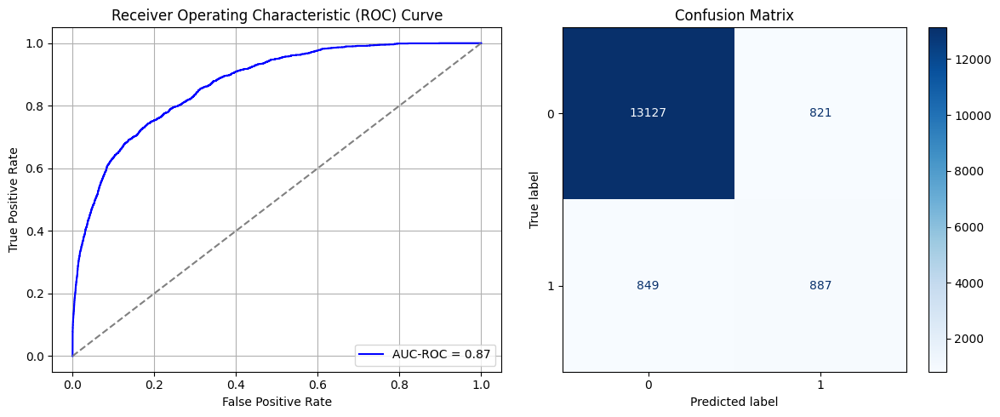

Best threshold based on F1-score: 0.4240311086177826
False Negative Rate: 0.4890552995391705
Time elapsed (performance): 1.7404658340001333
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7824 - loss: 0.5684 - val_AUC: 0.8731 - val_loss: 0.4447
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.8701 - loss: 0.4451 - val_AUC: 0.8755 - val_loss: 0.4416
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8780 - loss: 0.4324 - val_AUC: 0.8766 - val_loss: 0.4384
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8803 - loss: 0.4277 - val_AUC: 0.8773 - val_loss: 0.4340
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8765 - loss: 0.4347 - val_AUC: 0.8779 - val_loss: 0.4324
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8782 - loss: 0.4302 - val_AUC: 0.8790 - val_loss: 0.4303
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8783 - loss: 0.4288 - val_AUC: 0.8792 - val_loss: 0.4305
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8806 - loss: 0.4266 - val_AUC: 0.8800 - val_loss: 0.4429
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8800 -

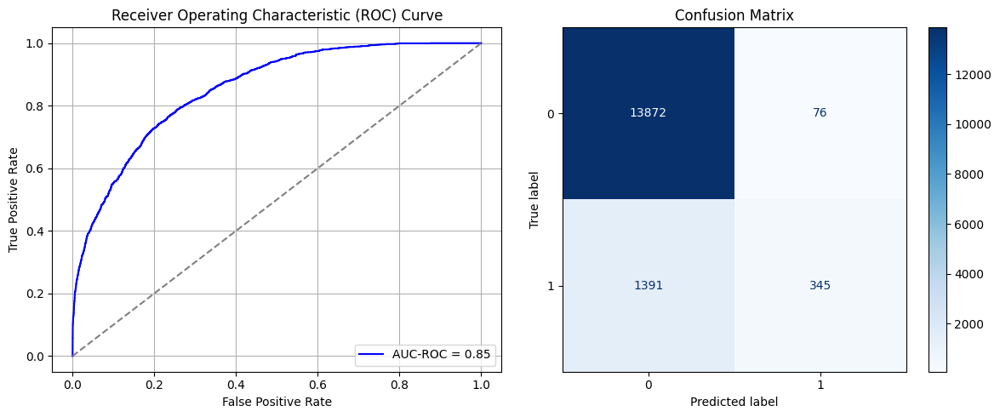

Best threshold based on F1-score: 0.1418004333972931
False Negative Rate: 0.8012672811059908
Time elapsed (performance): 3.0033009229991876
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7841 - loss: 0.5620 - val_AUC: 0.8737 - val_loss: 0.4411
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8719 - loss: 0.4412 - val_AUC: 0.8769 - val_loss: 0.4347
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 6ms/step - AUC: 0.8760 - loss: 0.4347 - val_AUC: 0.8776 - val_loss: 0.4339
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8798 - loss: 0.4287 - val_AUC: 0.8787 - val_loss: 0.4318
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8800 - loss: 0.4290 - val_AUC: 0.8790 - val_loss: 0.4407
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.8782 - loss: 0.4303 - val_AUC: 0.8798 - val_loss: 0.4296
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8792 - loss: 0.4274 - val_AUC: 0.8802 - val_loss: 0.4328
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8804 - loss: 0.4264 - val_AUC: 0.8807 - val_loss: 0.4285
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8803 -

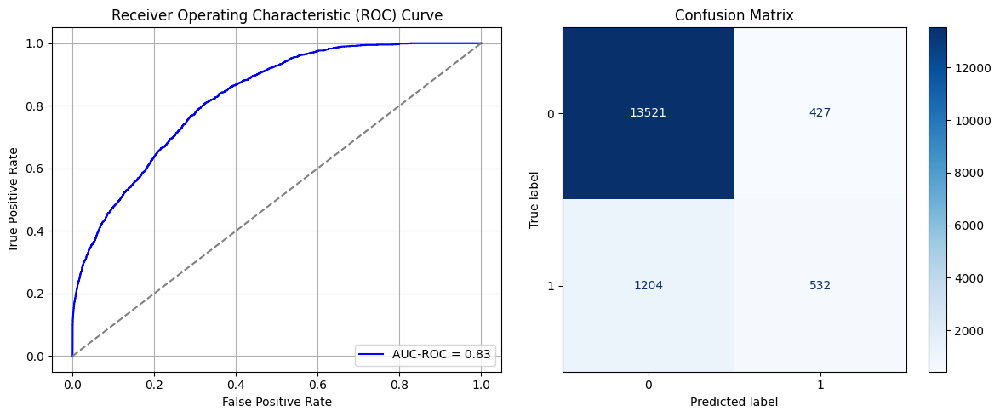

Best threshold based on F1-score: 0.30817726254463196
False Negative Rate: 0.6935483870967742
Time elapsed (performance): 1.4631130819998361
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 7s 6ms/step - AUC: 0.7748 - loss: 0.5693 - val_AUC: 0.8739 - val_loss: 0.4418
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8711 - loss: 0.4433 - val_AUC: 0.8754 - val_loss: 0.4462
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8764 - loss: 0.4339 - val_AUC: 0.8773 - val_loss: 0.4379
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8806 - loss: 0.4262 - val_AUC: 0.8777 - val_loss: 0.4321
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8787 - loss: 0.4303 - val_AUC: 0.8786 - val_loss: 0.4302
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8755 - loss: 0.4339 - val_AUC: 0.8788 - val_loss: 0.4295
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8791 - loss: 0.4281 - val_AUC: 0.8785 - val_loss: 0.4300
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8791 - loss: 0.4288 - val_AUC: 0.8791 - val_loss: 0.4290
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8783 -

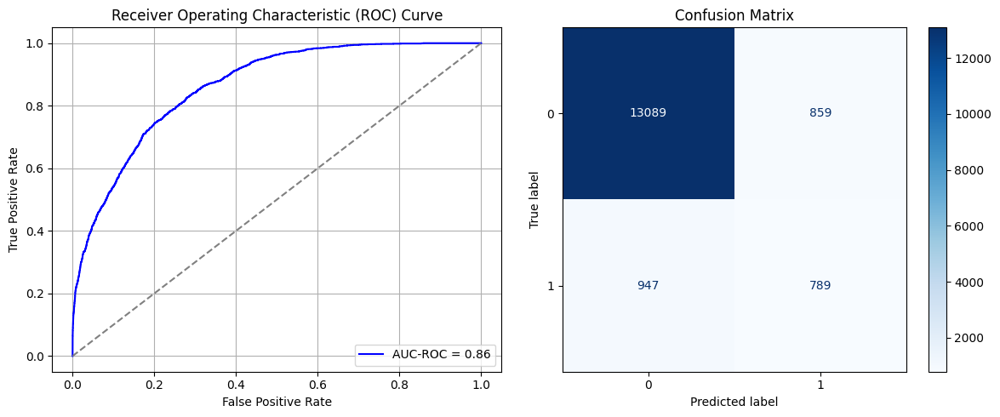

Best threshold based on F1-score: 0.49568164348602295
False Negative Rate: 0.5455069124423964
Time elapsed (performance): 1.7215374250008608
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7739 - loss: 0.5667 - val_AUC: 0.8753 - val_loss: 0.4409
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8697 - loss: 0.4439 - val_AUC: 0.8785 - val_loss: 0.4316
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8736 - loss: 0.4391 - val_AUC: 0.8808 - val_loss: 0.4281
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8753 - loss: 0.4350 - val_AUC: 0.8815 - val_loss: 0.4269
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8783 - loss: 0.4302 - val_AUC: 0.8818 - val_loss: 0.4281
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8788 - loss: 0.4300 - val_AUC: 0.8824 - val_loss: 0.4250
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8833 - loss: 0.4240 - val_AUC: 0.8825 - val_loss: 0.4250
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8813 - loss: 0.4263 - val_AUC: 0.8828 - val_loss: 0.4266
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8790 -

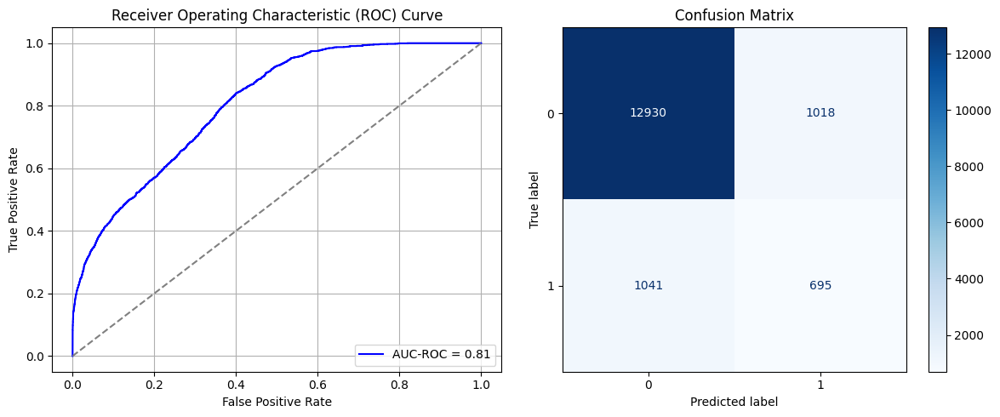

Best threshold based on F1-score: 0.4877984821796417
False Negative Rate: 0.5996543778801844
Time elapsed (performance): 1.8669677300003968
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.7741 - loss: 0.5641 - val_AUC: 0.8749 - val_loss: 0.4389
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8704 - loss: 0.4448 - val_AUC: 0.8774 - val_loss: 0.4317
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8746 - loss: 0.4368 - val_AUC: 0.8785 - val_loss: 0.4293
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8813 - loss: 0.4263 - val_AUC: 0.8797 - val_loss: 0.4276
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8728 - loss: 0.4390 - val_AUC: 0.8798 - val_loss: 0.4268
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8788 - loss: 0.4297 - val_AUC: 0.8802 - val_loss: 0.4271
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8807 - loss: 0.4276 - val_AUC: 0.8803 - val_loss: 0.4260
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8780 - loss: 0.4305 - val_AUC: 0.8796 - val_loss: 0.4408
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8797 -

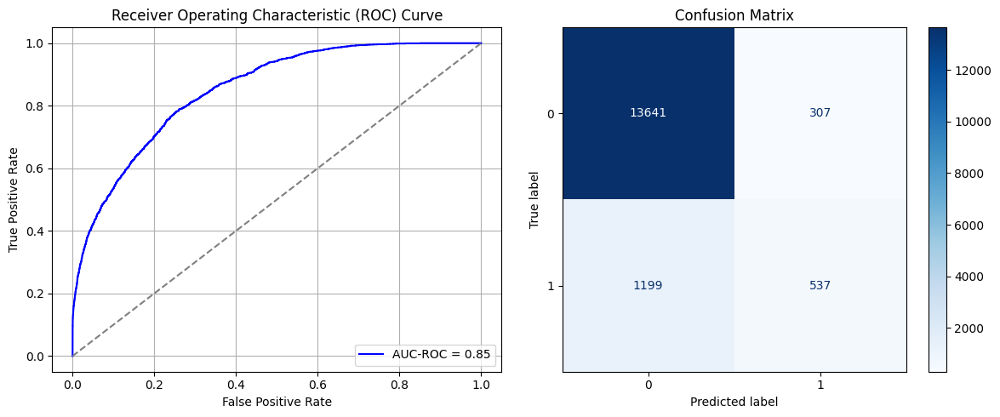

Best threshold based on F1-score: 0.3506366014480591
False Negative Rate: 0.690668202764977
Time elapsed (performance): 1.7085448460002226
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - AUC: 0.7735 - loss: 0.5668 - val_AUC: 0.8774 - val_loss: 0.4536
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8729 - loss: 0.4412 - val_AUC: 0.8795 - val_loss: 0.4416
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8733 - loss: 0.4386 - val_AUC: 0.8813 - val_loss: 0.4333
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.8772 - loss: 0.4324 - val_AUC: 0.8814 - val_loss: 0.4264
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8814 - loss: 0.4268 - val_AUC: 0.8830 - val_loss: 0.4245
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8817 - loss: 0.4234 - val_AUC: 0.8825 - val_loss: 0.4266
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8802 - loss: 0.4269 - val_AUC: 0.8827 - val_loss: 0.4244
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8809 - loss: 0.4265 - val_AUC: 0.8837 - val_loss: 0.4264
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8813 -

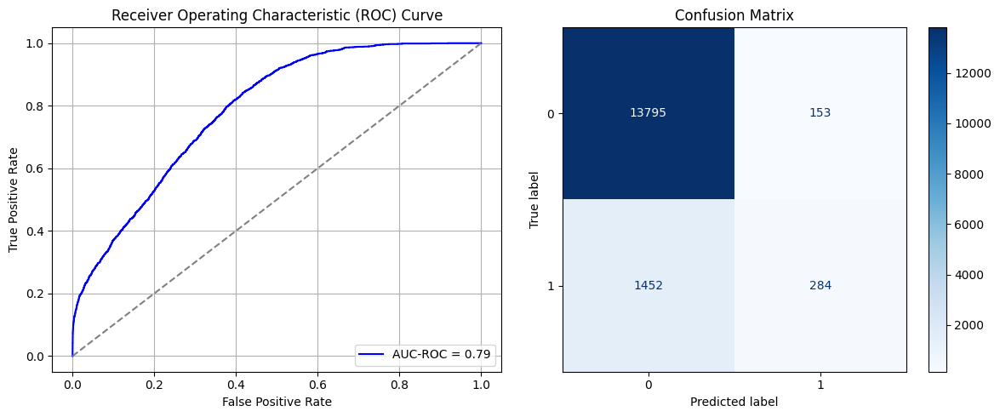

Best threshold based on F1-score: 0.17722469568252563
False Negative Rate: 0.836405529953917
Time elapsed (performance): 1.4343162429995573
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7848 - loss: 0.5620 - val_AUC: 0.8723 - val_loss: 0.4416
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8722 - loss: 0.4409 - val_AUC: 0.8751 - val_loss: 0.4388
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8746 - loss: 0.4370 - val_AUC: 0.8763 - val_loss: 0.4342
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8772 - loss: 0.4330 - val_AUC: 0.8773 - val_loss: 0.4337
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8777 - loss: 0.4326 - val_AUC: 0.8782 - val_loss: 0.4311
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8807 - loss: 0.4270 - val_AUC: 0.8772 - val_loss: 0.4338
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8815 - loss: 0.4249 - val_AUC: 0.8780 - val_loss: 0.4304
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8780 - loss: 0.4308 - val_AUC: 0.8787 - val_loss: 0.4300
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8817 -

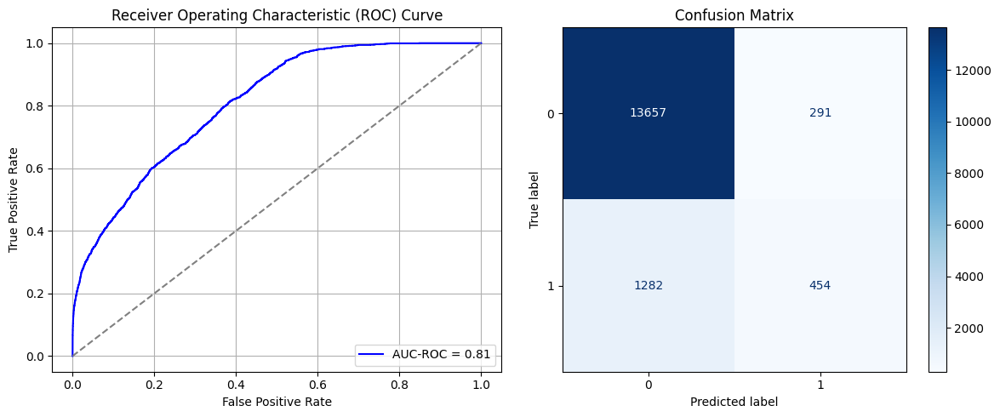

Best threshold based on F1-score: 0.2810230553150177
False Negative Rate: 0.738479262672811
Time elapsed (performance): 1.7284688130002905
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.7775 - loss: 0.5693 - val_AUC: 0.8744 - val_loss: 0.4394
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8738 - loss: 0.4383 - val_AUC: 0.8781 - val_loss: 0.4332
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8795 - loss: 0.4285 - val_AUC: 0.8792 - val_loss: 0.4338
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8808 - loss: 0.4267 - val_AUC: 0.8800 - val_loss: 0.4339
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8791 - loss: 0.4287 - val_AUC: 0.8808 - val_loss: 0.4438
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8806 - loss: 0.4271 - val_AUC: 0.8811 - val_loss: 0.4275
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.8785 - loss: 0.4290 - val_AUC: 0.8814 - val_loss: 0.4261
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8830 - loss: 0.4226 - val_AUC: 0.8819 - val_loss: 0.4250
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8832 -

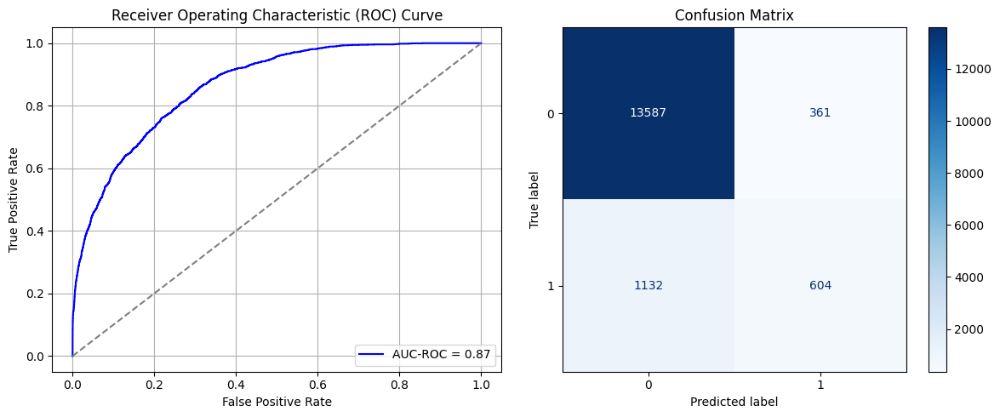

Best threshold based on F1-score: 0.2876865565776825
False Negative Rate: 0.652073732718894
Time elapsed (performance): 1.714401702000032
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7850 - loss: 0.5625 - val_AUC: 0.8722 - val_loss: 0.4412
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8694 - loss: 0.4443 - val_AUC: 0.8752 - val_loss: 0.4365
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8738 - loss: 0.4378 - val_AUC: 0.8775 - val_loss: 0.4401
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8766 - loss: 0.4328 - val_AUC: 0.8788 - val_loss: 0.4341
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8762 - loss: 0.4343 - val_AUC: 0.8781 - val_loss: 0.4303
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8783 - loss: 0.4307 - val_AUC: 0.8791 - val_loss: 0.4287
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8765 - loss: 0.4346 - val_AUC: 0.8795 - val_loss: 0.4278
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8792 - loss: 0.4291 - val_AUC: 0.8803 - val_loss: 0.4283
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8808 -

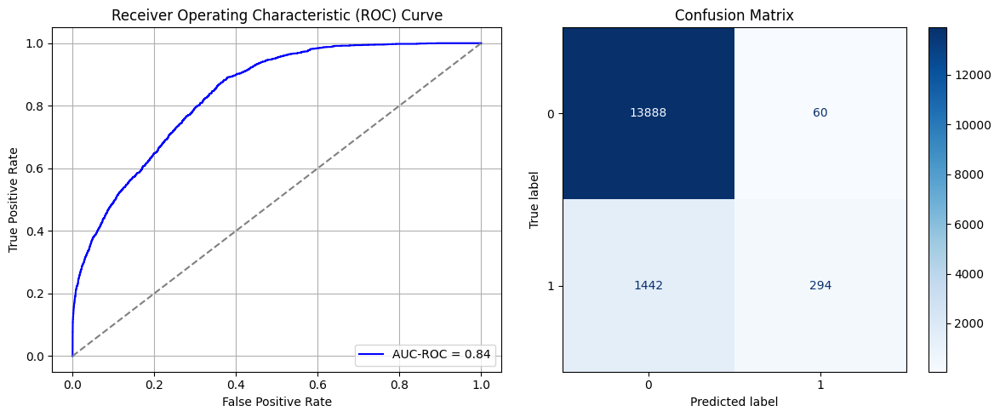

Best threshold based on F1-score: 0.11664379388093948
False Negative Rate: 0.8306451612903226
Time elapsed (performance): 1.9364568470009544
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.7780 - loss: 0.5669 - val_AUC: 0.8724 - val_loss: 0.4400
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8738 - loss: 0.4375 - val_AUC: 0.8769 - val_loss: 0.4381
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8723 - loss: 0.4401 - val_AUC: 0.8780 - val_loss: 0.4317
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8770 - loss: 0.4341 - val_AUC: 0.8792 - val_loss: 0.4305
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8788 - loss: 0.4302 - val_AUC: 0.8792 - val_loss: 0.4316
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8787 - loss: 0.4292 - val_AUC: 0.8801 - val_loss: 0.4284
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8825 - loss: 0.4223 - val_AUC: 0.8802 - val_loss: 0.4256
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8828 - loss: 0.4220 - val_AUC: 0.8793 - val_loss: 0.4373
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8822 -

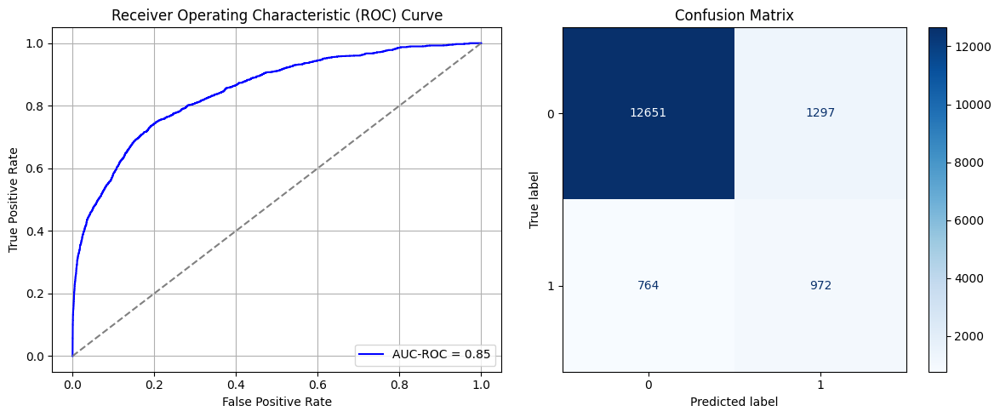

Best threshold based on F1-score: 0.6583728790283203
False Negative Rate: 0.4400921658986175
Time elapsed (performance): 1.703083518999847
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.7977 - loss: 0.5516 - val_AUC: 0.8727 - val_loss: 0.4485
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8705 - loss: 0.4436 - val_AUC: 0.8744 - val_loss: 0.4434
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8776 - loss: 0.4333 - val_AUC: 0.8757 - val_loss: 0.4368
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8766 - loss: 0.4335 - val_AUC: 0.8767 - val_loss: 0.4359
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.8753 - loss: 0.4362 - val_AUC: 0.8775 - val_loss: 0.4343
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8772 - loss: 0.4330 - val_AUC: 0.8778 - val_loss: 0.4331
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8781 - loss: 0.4305 - val_AUC: 0.8786 - val_loss: 0.4338
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8844 - loss: 0.4205 - val_AUC: 0.8785 - val_loss: 0.4316
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8797 -

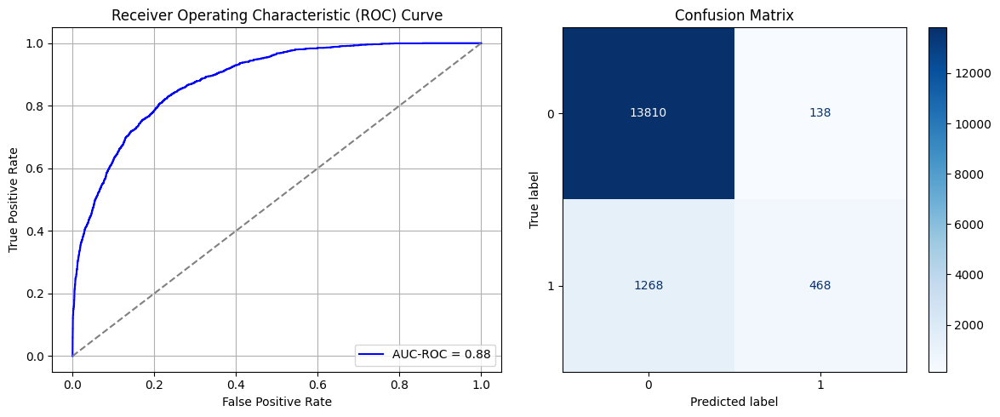

Best threshold based on F1-score: 0.15985849499702454
False Negative Rate: 0.7304147465437788
Time elapsed (performance): 1.7461251050008286
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7853 - loss: 0.5601 - val_AUC: 0.8705 - val_loss: 0.4490
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8724 - loss: 0.4412 - val_AUC: 0.8746 - val_loss: 0.4371
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8746 - loss: 0.4365 - val_AUC: 0.8764 - val_loss: 0.4391
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8761 - loss: 0.4351 - val_AUC: 0.8761 - val_loss: 0.4335
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8753 - loss: 0.4348 - val_AUC: 0.8771 - val_loss: 0.4395
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8773 - loss: 0.4313 - val_AUC: 0.8776 - val_loss: 0.4336
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8765 - loss: 0.4332 - val_AUC: 0.8778 - val_loss: 0.4302
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8813 - loss: 0.4247 - val_AUC: 0.8777 - val_loss: 0.4376
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8803 -

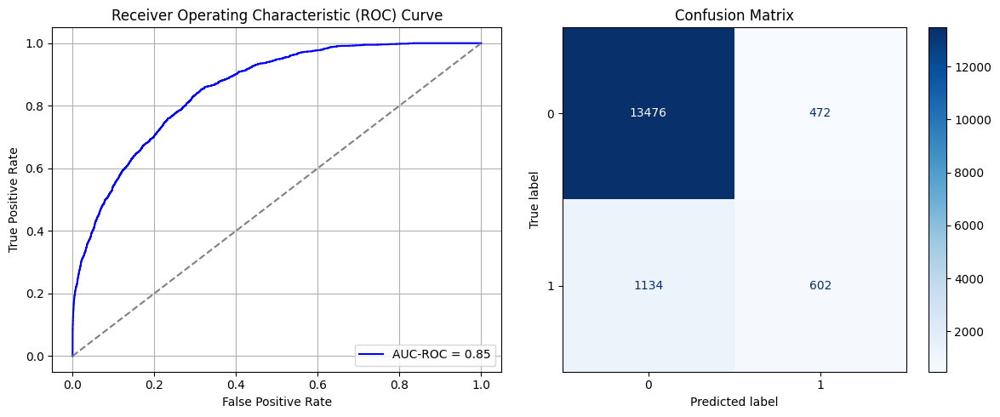

Best threshold based on F1-score: 0.34281378984451294
False Negative Rate: 0.6532258064516129
Time elapsed (performance): 1.8215624439999374
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.7822 - loss: 0.5589 - val_AUC: 0.8717 - val_loss: 0.4622
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8720 - loss: 0.4426 - val_AUC: 0.8756 - val_loss: 0.4445
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8799 - loss: 0.4295 - val_AUC: 0.8766 - val_loss: 0.4335
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8767 - loss: 0.4341 - val_AUC: 0.8779 - val_loss: 0.4314
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8823 - loss: 0.4253 - val_AUC: 0.8780 - val_loss: 0.4309
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8792 - loss: 0.4295 - val_AUC: 0.8790 - val_loss: 0.4318
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8836 - loss: 0.4231 - val_AUC: 0.8781 - val_loss: 0.4444
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8813 - loss: 0.4272 - val_AUC: 0.8799 - val_loss: 0.4278
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8801 -

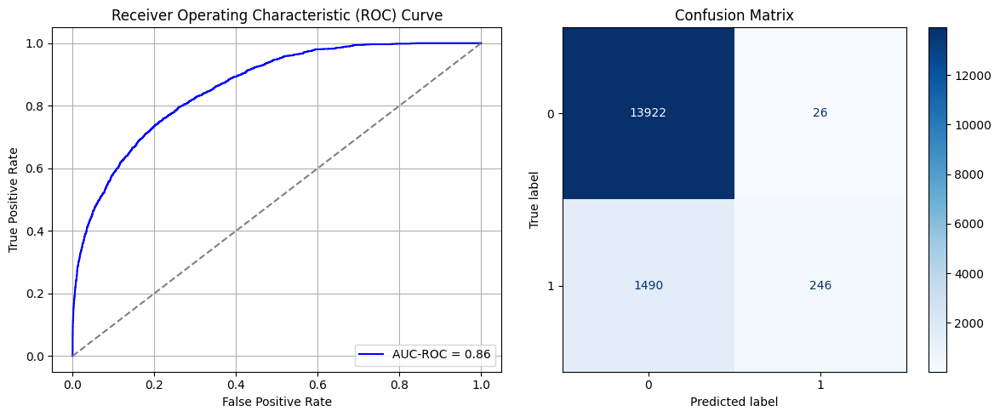

Best threshold based on F1-score: 0.07155944406986237
False Negative Rate: 0.8582949308755761
Time elapsed (performance): 1.4531656229992223
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.7798 - loss: 0.5572 - val_AUC: 0.8747 - val_loss: 0.4380
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8702 - loss: 0.4455 - val_AUC: 0.8773 - val_loss: 0.4459
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8766 - loss: 0.4345 - val_AUC: 0.8775 - val_loss: 0.4371
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.8749 - loss: 0.4376 - val_AUC: 0.8784 - val_loss: 0.4301
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8768 - loss: 0.4349 - val_AUC: 0.8792 - val_loss: 0.4311
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8753 - loss: 0.4361 - val_AUC: 0.8797 - val_loss: 0.4350
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8805 - loss: 0.4283 - val_AUC: 0.8795 - val_loss: 0.4312
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8757 - loss: 0.4337 - val_AUC: 0.8793 - val_loss: 0.4307
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8797 -

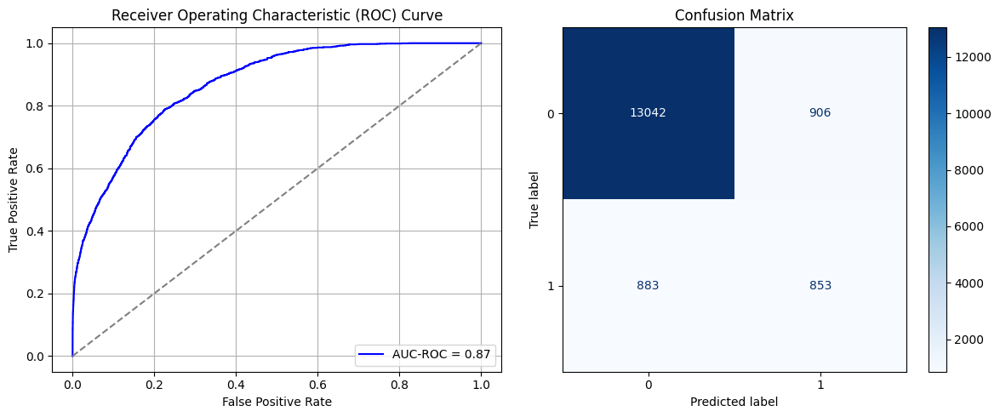

Best threshold based on F1-score: 0.4909140467643738
False Negative Rate: 0.5086405529953917
Time elapsed (performance): 1.4669802499993239
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7756 - loss: 0.5629 - val_AUC: 0.8708 - val_loss: 0.4467
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.8750 - loss: 0.4381 - val_AUC: 0.8724 - val_loss: 0.4429
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8733 - loss: 0.4397 - val_AUC: 0.8748 - val_loss: 0.4405
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8770 - loss: 0.4342 - val_AUC: 0.8740 - val_loss: 0.4428
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 7s 6ms/step - AUC: 0.8782 - loss: 0.4310 - val_AUC: 0.8762 - val_loss: 0.4364
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8772 - loss: 0.4347 - val_AUC: 0.8764 - val_loss: 0.4355
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8779 - loss: 0.4314 - val_AUC: 0.8756 - val_loss: 0.4371
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8776 - loss: 0.4321 - val_AUC: 0.8766 - val_loss: 0.4355
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8791 -

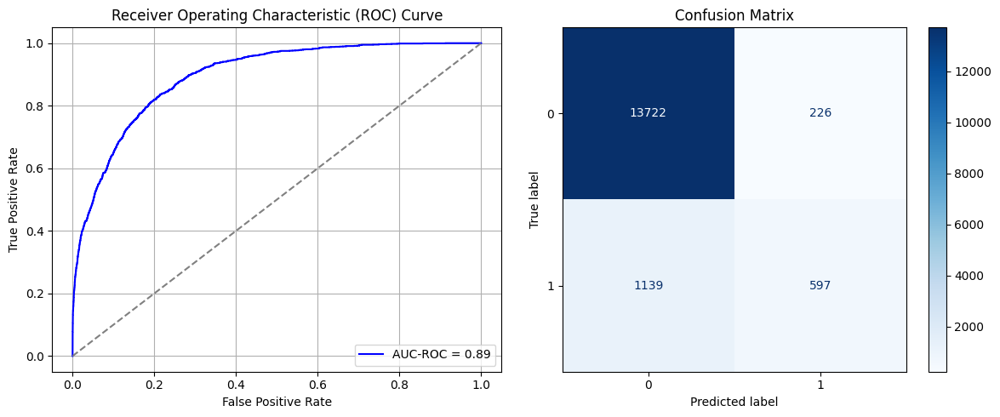

Best threshold based on F1-score: 0.260309100151062
False Negative Rate: 0.6561059907834101
Time elapsed (performance): 1.8825115010004083
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7721 - loss: 0.5698 - val_AUC: 0.8738 - val_loss: 0.4527
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8682 - loss: 0.4474 - val_AUC: 0.8754 - val_loss: 0.4403
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8745 - loss: 0.4377 - val_AUC: 0.8779 - val_loss: 0.4414
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8767 - loss: 0.4334 - val_AUC: 0.8786 - val_loss: 0.4329
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.8758 - loss: 0.4355 - val_AUC: 0.8780 - val_loss: 0.4303
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8780 - loss: 0.4303 - val_AUC: 0.8802 - val_loss: 0.4306
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8814 - loss: 0.4249 - val_AUC: 0.8794 - val_loss: 0.4287
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8833 - loss: 0.4228 - val_AUC: 0.8802 - val_loss: 0.4295
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8777 -

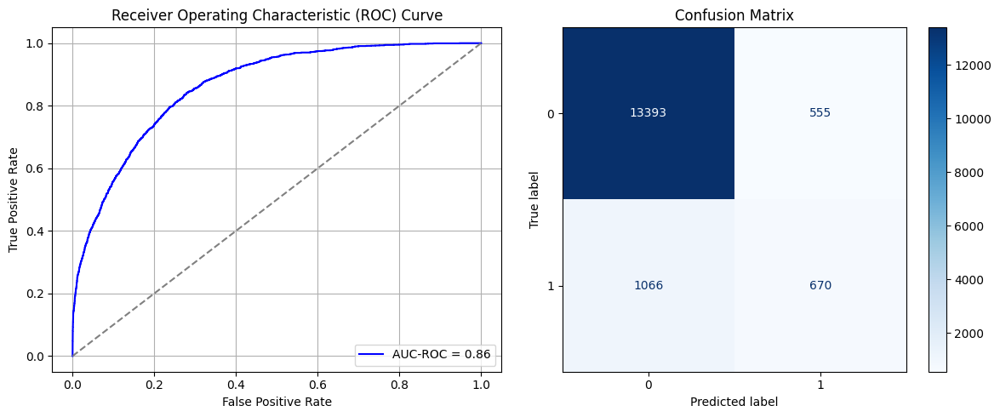

Best threshold based on F1-score: 0.350318968296051
False Negative Rate: 0.6140552995391705
Time elapsed (performance): 6.263316706001206
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.7869 - loss: 0.5576 - val_AUC: 0.8741 - val_loss: 0.4424
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - AUC: 0.8766 - loss: 0.4345 - val_AUC: 0.8766 - val_loss: 0.4405
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8739 - loss: 0.4379 - val_AUC: 0.8769 - val_loss: 0.4321
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.8793 - loss: 0.4293 - val_AUC: 0.8790 - val_loss: 0.4357
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - AUC: 0.8779 - loss: 0.4313 - val_AUC: 0.8787 - val_loss: 0.4295
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.8797 - loss: 0.4288 - val_AUC: 0.8793 - val_loss: 0.4293
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.8847 - loss: 0.4213 - val_AUC: 0.8798 - val_loss: 0.4270
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.8797 - loss: 0.4290 - val_AUC: 0.8792 - val_loss: 0.4393
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8811 -

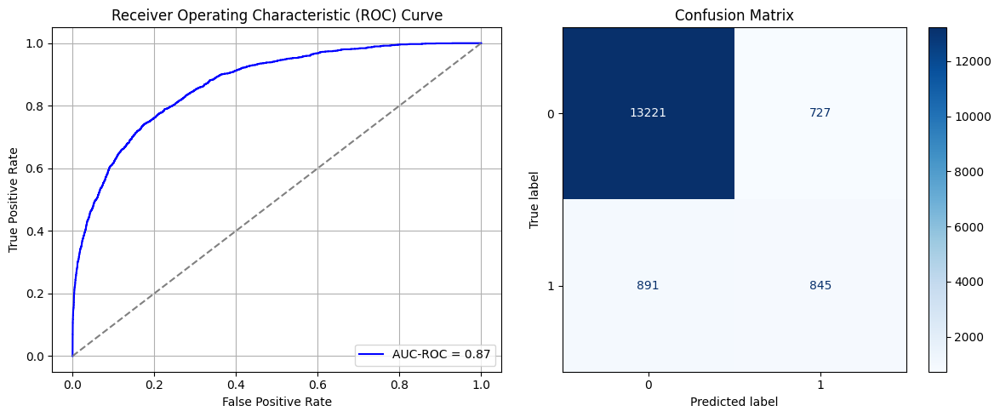

Best threshold based on F1-score: 0.38258665800094604
False Negative Rate: 0.5132488479262672
Time elapsed (performance): 1.7356904450007278
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.7774 - loss: 0.5673 - val_AUC: 0.8719 - val_loss: 0.4531
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - AUC: 0.8727 - loss: 0.4433 - val_AUC: 0.8759 - val_loss: 0.4433
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.8745 - loss: 0.4383 - val_AUC: 0.8767 - val_loss: 0.4326
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.8785 - loss: 0.4313 - val_AUC: 0.8770 - val_loss: 0.4318
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - AUC: 0.8779 - loss: 0.4318 - val_AUC: 0.8775 - val_loss: 0.4433
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 9s 5ms/step - AUC: 0.8747 - loss: 0.4371 - val_AUC: 0.8784 - val_loss: 0.4336
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 6ms/step - AUC: 0.8800 - loss: 0.4271 - val_AUC: 0.8789 - val_loss: 0.4292
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8802 - loss: 0.4285 - val_AUC: 0.8792 - val_loss: 0.4277
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.8796 -

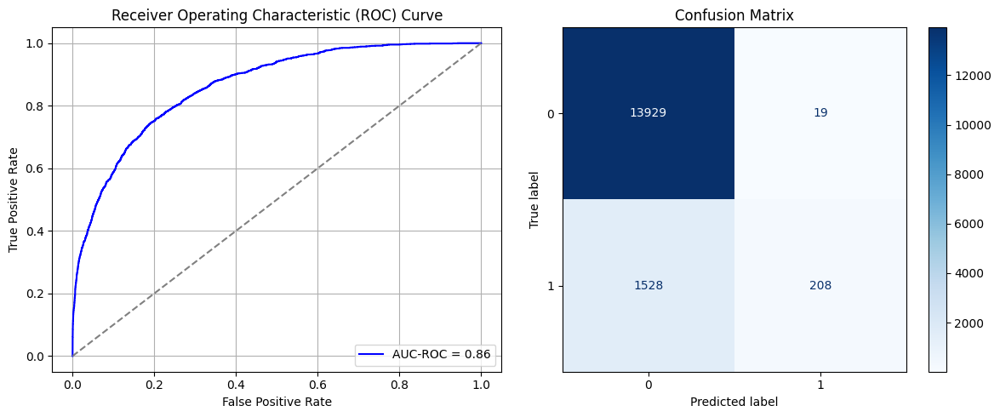

Best threshold based on F1-score: 0.04969894886016846
False Negative Rate: 0.880184331797235
Time elapsed (performance): 1.803673925000112
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.7744 - loss: 0.5698 - val_AUC: 0.8711 - val_loss: 0.4451
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - AUC: 0.8686 - loss: 0.4462 - val_AUC: 0.8738 - val_loss: 0.4408
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8771 - loss: 0.4318 - val_AUC: 0.8753 - val_loss: 0.4370
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8795 - loss: 0.4285 - val_AUC: 0.8759 - val_loss: 0.4398
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.8754 - loss: 0.4356 - val_AUC: 0.8769 - val_loss: 0.4326
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8744 - loss: 0.4367 - val_AUC: 0.8762 - val_loss: 0.4358
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8793 - loss: 0.4283 - val_AUC: 0.8769 - val_loss: 0.4327
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 6ms/step - AUC: 0.8792 - loss: 0.4293 - val_AUC: 0.8776 - val_loss: 0.4346
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8806 -

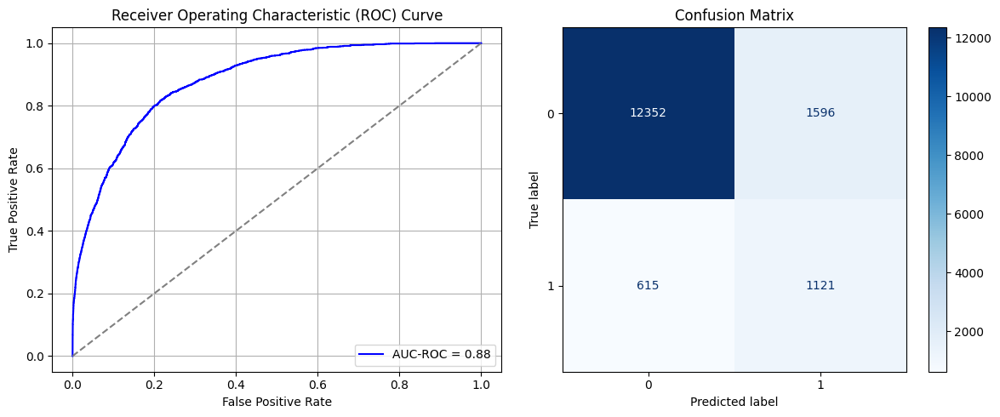

Best threshold based on F1-score: 0.5424259305000305
False Negative Rate: 0.3542626728110599
Time elapsed (performance): 1.8202886620001664
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.7763 - loss: 0.5659 - val_AUC: 0.8748 - val_loss: 0.4393
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.8702 - loss: 0.4436 - val_AUC: 0.8771 - val_loss: 0.4331
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - AUC: 0.8768 - loss: 0.4324 - val_AUC: 0.8780 - val_loss: 0.4302
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8788 - loss: 0.4292 - val_AUC: 0.8791 - val_loss: 0.4304
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8809 - loss: 0.4247 - val_AUC: 0.8799 - val_loss: 0.4270
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 6ms/step - AUC: 0.8820 - loss: 0.4238 - val_AUC: 0.8792 - val_loss: 0.4278
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 10s 6ms/step - AUC: 0.8823 - loss: 0.4242 - val_AUC: 0.8797 - val_loss: 0.4268
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.8823 - loss: 0.4223 - val_AUC: 0.8800 - val_loss: 0.4278
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 7s 6ms/step - AUC: 0.8868 

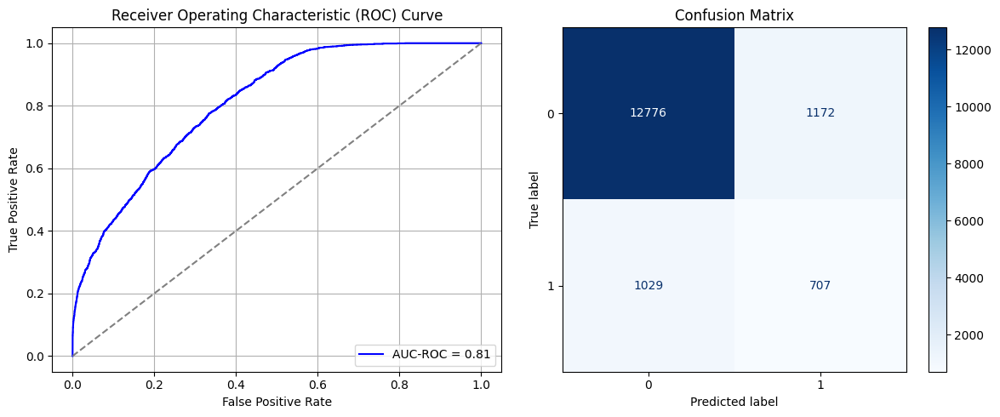

Best threshold based on F1-score: 0.5146521329879761
False Negative Rate: 0.592741935483871
Time elapsed (performance): 1.7570091180004965
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


886/886 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - AUC: 0.7664 - loss: 0.5739 - val_AUC: 0.8687 - val_loss: 0.4458
Epoch 2/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8720 - loss: 0.4421 - val_AUC: 0.8708 - val_loss: 0.4440
Epoch 3/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 6ms/step - AUC: 0.8776 - loss: 0.4318 - val_AUC: 0.8723 - val_loss: 0.4376
Epoch 4/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 6ms/step - AUC: 0.8755 - loss: 0.4356 - val_AUC: 0.8732 - val_loss: 0.4372
Epoch 5/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.8753 - loss: 0.4348 - val_AUC: 0.8745 - val_loss: 0.4348
Epoch 6/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 6ms/step - AUC: 0.8768 - loss: 0.4321 - val_AUC: 0.8737 - val_loss: 0.4358
Epoch 7/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8782 - loss: 0.4306 - val_AUC: 0.8749 - val_loss: 0.4437
Epoch 8/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8797 - loss: 0.4282 - val_AUC: 0.8749 - val_loss: 0.4344
Epoch 9/10
886/886 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.8789 -

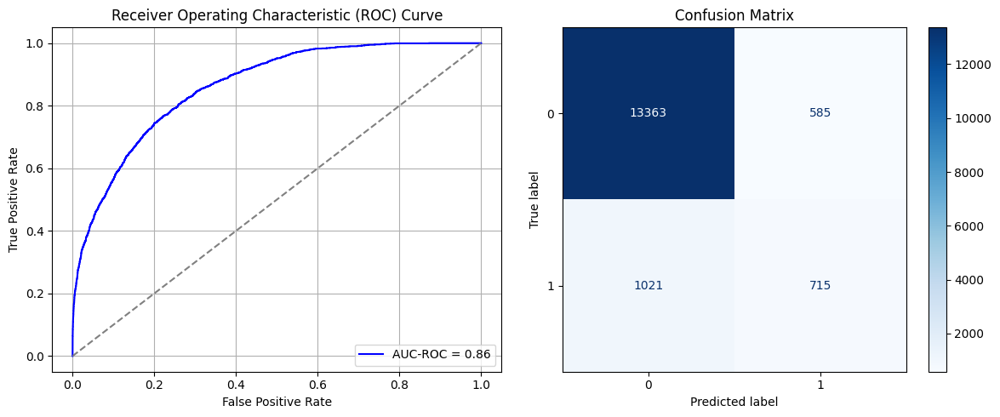

Best threshold based on F1-score: 0.4374711811542511
False Negative Rate: 0.5881336405529954
Time elapsed (performance): 1.7967943770017882


In [58]:
times = 50

Training_time = []
FPR = []
TPR = []
FNR = []
TNR = []
TL_time = []


for i in range(times):
    data_S_min_ros = data_S_minority.sample(n=oversample_size - undersample_size, replace=True)
    data_S_SRS_ROS = pd.concat([data_S_majority, data_S_min_ros, data_S_minority])
    X_S_SRS_ROS = data_S_SRS_ROS.iloc[:, :-1]
    y_S_SRS_ROS = data_S_SRS_ROS.iloc[:, -1]
    X_S_train, X_S_test, y_S_train, y_S_test = train_test_split(X_S_SRS_ROS, y_S_SRS_ROS, test_size=0.20, random_state=0)
    model_SRS_ROS = create_dnn_model(X_S_train.shape[1])
    result_SRS_ROS = train_and_evaluate(model_SRS_ROS, X_S_train, X_S_test, y_S_train, y_S_test, "Source")
    result_TL_SRS_ROS = Transductive_TL(model_SRS_ROS, X_T_full, y_T_full, "Target")

    Training_time.append(result_SRS_ROS)
    FPR.append(result_TL_SRS_ROS[0])
    TNR.append(result_TL_SRS_ROS[1])
    FNR.append(result_TL_SRS_ROS[2])
    TPR.append(result_TL_SRS_ROS[3])
    TL_time.append(result_TL_SRS_ROS[4])

ParamFit = pd.DataFrame([Training_time, FPR, TNR, FNR, TPR, TL_time]).T
ParamFit.columns=['Source time', 'FPR', 'TNR', 'FNR', 'TPR', 'Target time']
# print(ParamFit)

In [59]:
print(ParamFit)
ParamFit.to_csv('SRS_ROS2.csv')

    Source time       FPR       TNR       FNR       TPR  Target time
0     32.797500  0.089547  0.910453  0.619240  0.380760     1.883861
1     44.144195  0.062159  0.937841  0.476382  0.523618     1.231652
2     41.065484  0.122670  0.877330  0.393433  0.606567     1.516393
3     39.985008  0.028248  0.971752  0.627304  0.372696     1.204191
4     35.142400  0.000717  0.999283  0.879032  0.120968     1.257104
5     44.484255  0.066891  0.933109  0.552995  0.447005     1.836034
6     37.551893  0.029467  0.970533  0.667051  0.332949     1.747741
7     44.466743  0.195010  0.804990  0.241359  0.758641     1.704843
8     44.385775  0.007241  0.992759  0.796083  0.203917     1.718859
9     47.150788  0.128549  0.871451  0.461982  0.538018     1.289752
10    43.487737  0.349512  0.650488  0.096774  0.903226     1.932371
11    45.092620  0.006811  0.993189  0.812788  0.187212     1.715151
12    40.437002  0.006022  0.993978  0.783410  0.216590     1.735374
13    47.905312  0.284557  0.71544

In [60]:
ParamFit['FNR'].mean()

np.float64(0.6247119815668204)

In [61]:
ParamFit['Source time'].mean()

np.float64(48.19954667695995)

## Systematic Resampling:

In this case, we examine the possibility of performing Random Oversampling on the minority class using systematic sampling. For this purpose, taking a sampling interval of $k$, we would compile a total of $k*\frac{N_0-N_1}{N_1}$ systematic samples from the minority class in order to balance the dataset. We sample the starting point from 1 to $k$ *with replacement*, since a highly imbalanced dataset will require sampling with replacement in order to achieve a balanced dataset.

In particular, taking $k=10$ yields a number of samples of $k*\frac{N_0-N_1}{N_1}= 11.05 \approx 11$, so we take $k=10$.

In [62]:
data_S
data_S_majority = data_S[data_S['Y'].isin([0])]
data_S_minority = data_S[data_S['Y'].isin([1])]

undersample_size = data_S_minority['Y'].size
oversample_size = data_S_majority['Y'].size

print(undersample_size)
print(oversample_size)

9805
22132


Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 8s 6ms/step - AUC: 0.7809 - loss: 0.5631 - val_AUC: 0.8700 - val_loss: 0.4481
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8724 - loss: 0.4424 - val_AUC: 0.8728 - val_loss: 0.4440
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8760 - loss: 0.4348 - val_AUC: 0.8748 - val_loss: 0.4355
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8765 - loss: 0.4338 - val_AUC: 0.8754 - val_loss: 0.4440
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8788 - loss: 0.4306 - val_AUC: 0.8763 - val_loss: 0.4335
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8783 - loss: 0.4305 - val_AUC: 0.8764 - val_loss: 0.4344
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8768 - loss: 0.4334 - val_AUC: 0.8756 - val_loss: 0.4370
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8774 - loss: 0.4319 - val_AUC: 0.8774 - val_loss: 0.4311
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8800 -

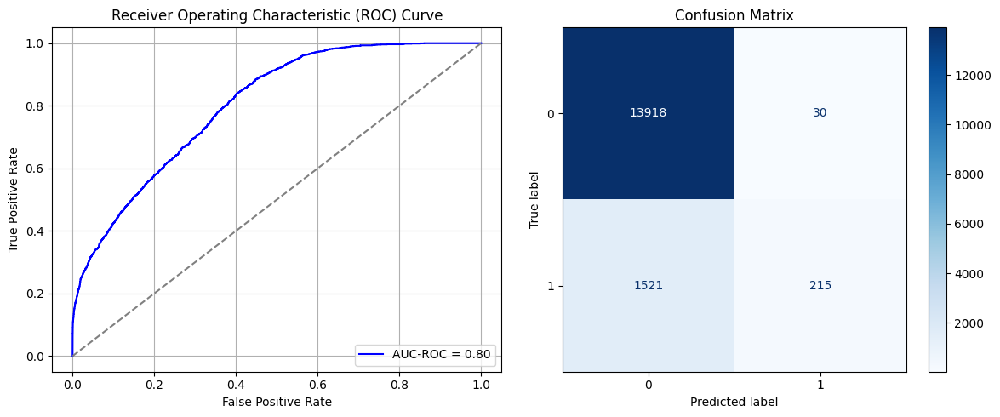

Best threshold based on F1-score: 0.11695808917284012
False Negative Rate: 0.8761520737327189
Time elapsed (performance): 1.9119264900000417
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7729 - loss: 0.5756 - val_AUC: 0.8691 - val_loss: 0.4467
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8757 - loss: 0.4360 - val_AUC: 0.8726 - val_loss: 0.4402
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8801 - loss: 0.4282 - val_AUC: 0.8744 - val_loss: 0.4390
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8788 - loss: 0.4299 - val_AUC: 0.8745 - val_loss: 0.4371
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8801 - loss: 0.4279 - val_AUC: 0.8746 - val_loss: 0.4433
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8796 - loss: 0.4289 - val_AUC: 0.8757 - val_loss: 0.4359
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8792 - loss: 0.4289 - val_AUC: 0.8753 - val_loss: 0.4457
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8815 - loss: 0.4258 - val_AUC: 0.8757 - val_loss: 0.4346
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8807 -

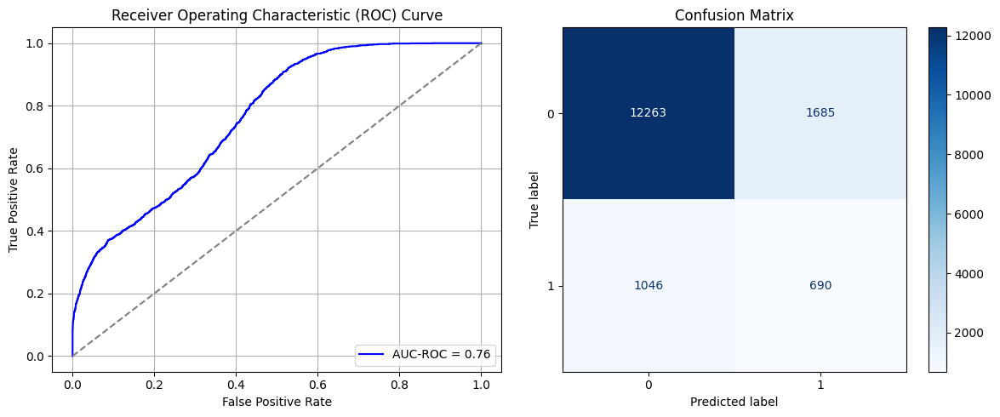

Best threshold based on F1-score: 0.6252298355102539
False Negative Rate: 0.6025345622119815
Time elapsed (performance): 1.2888695870005904
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7838 - loss: 0.5577 - val_AUC: 0.8665 - val_loss: 0.4503
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8729 - loss: 0.4412 - val_AUC: 0.8706 - val_loss: 0.4454
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8755 - loss: 0.4361 - val_AUC: 0.8712 - val_loss: 0.4462
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8816 - loss: 0.4251 - val_AUC: 0.8720 - val_loss: 0.4462
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8754 - loss: 0.4350 - val_AUC: 0.8742 - val_loss: 0.4388
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8791 - loss: 0.4300 - val_AUC: 0.8746 - val_loss: 0.4384
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8803 - loss: 0.4281 - val_AUC: 0.8746 - val_loss: 0.4397
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8793 - loss: 0.4278 - val_AUC: 0.8748 - val_loss: 0.4420
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8846 -

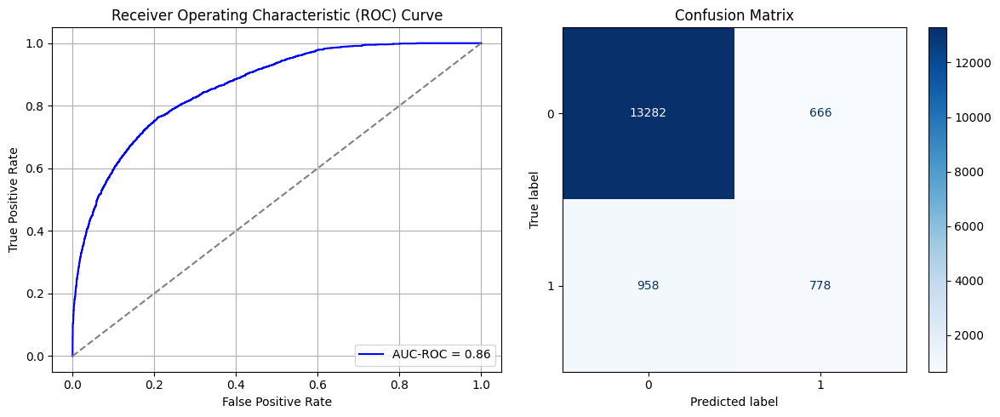

Best threshold based on F1-score: 0.4386877119541168
False Negative Rate: 0.5518433179723502
Time elapsed (performance): 1.2733896459994867
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7833 - loss: 0.5590 - val_AUC: 0.8698 - val_loss: 0.4509
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8762 - loss: 0.4369 - val_AUC: 0.8743 - val_loss: 0.4396
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8783 - loss: 0.4312 - val_AUC: 0.8749 - val_loss: 0.4385
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8787 - loss: 0.4308 - val_AUC: 0.8761 - val_loss: 0.4348
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8769 - loss: 0.4323 - val_AUC: 0.8769 - val_loss: 0.4340
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8813 - loss: 0.4259 - val_AUC: 0.8771 - val_loss: 0.4356
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8853 - loss: 0.4185 - val_AUC: 0.8780 - val_loss: 0.4328
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8844 - loss: 0.4215 - val_AUC: 0.8782 - val_loss: 0.4319
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8842 -

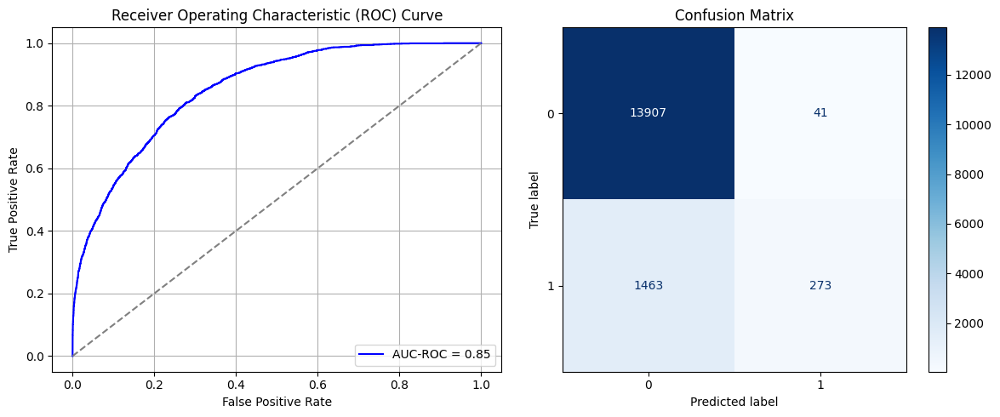

Best threshold based on F1-score: 0.12393384426832199
False Negative Rate: 0.842741935483871
Time elapsed (performance): 1.2901975189997756
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7839 - loss: 0.5626 - val_AUC: 0.8721 - val_loss: 0.4483
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8714 - loss: 0.4430 - val_AUC: 0.8756 - val_loss: 0.4359
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8741 - loss: 0.4376 - val_AUC: 0.8766 - val_loss: 0.4421
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8728 - loss: 0.4396 - val_AUC: 0.8779 - val_loss: 0.4319
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8772 - loss: 0.4324 - val_AUC: 0.8784 - val_loss: 0.4304
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8788 - loss: 0.4292 - val_AUC: 0.8789 - val_loss: 0.4294
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8795 - loss: 0.4275 - val_AUC: 0.8795 - val_loss: 0.4291
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8811 - loss: 0.4245 - val_AUC: 0.8802 - val_loss: 0.4330
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8810 -

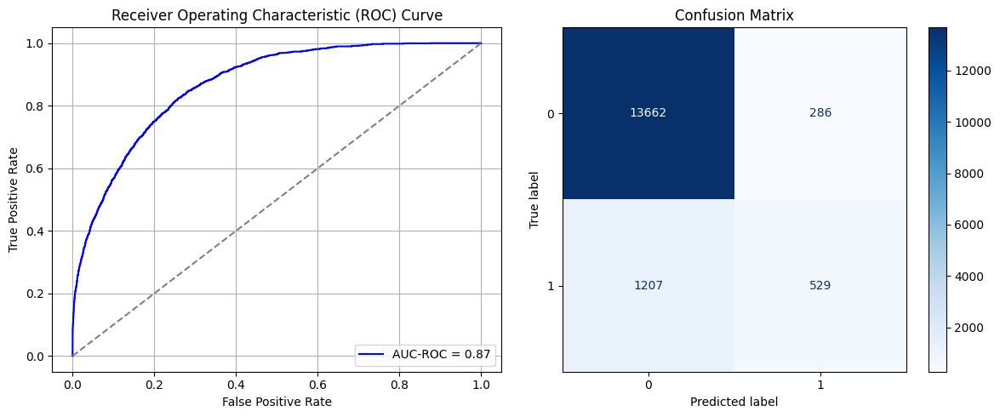

Best threshold based on F1-score: 0.23967866599559784
False Negative Rate: 0.6952764976958525
Time elapsed (performance): 1.293263579998893
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.7840 - loss: 0.5573 - val_AUC: 0.8686 - val_loss: 0.4545
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8715 - loss: 0.4419 - val_AUC: 0.8731 - val_loss: 0.4402
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8740 - loss: 0.4376 - val_AUC: 0.8728 - val_loss: 0.4433
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8754 - loss: 0.4361 - val_AUC: 0.8751 - val_loss: 0.4375
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8777 - loss: 0.4314 - val_AUC: 0.8752 - val_loss: 0.4388
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8769 - loss: 0.4335 - val_AUC: 0.8755 - val_loss: 0.4368
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8744 - loss: 0.4365 - val_AUC: 0.8749 - val_loss: 0.4381
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8762 - loss: 0.4339 - val_AUC: 0.8763 - val_loss: 0.4342
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8835 -

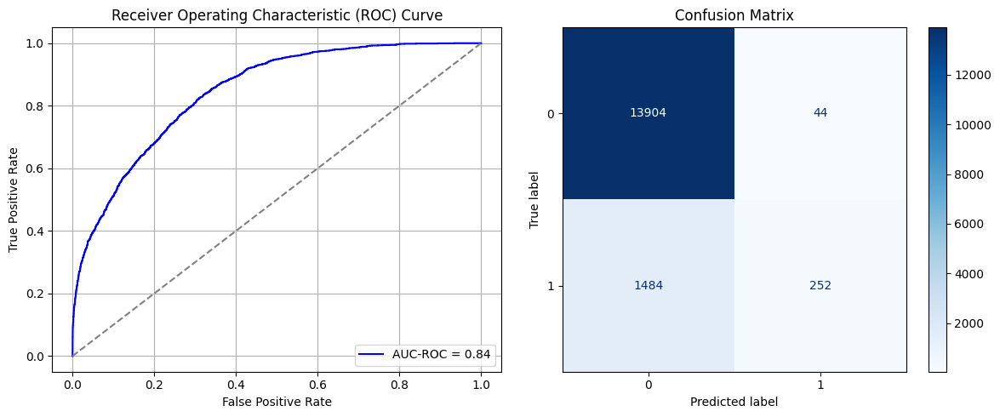

Best threshold based on F1-score: 0.06329986453056335
False Negative Rate: 0.8548387096774194
Time elapsed (performance): 1.7003568339987396
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7830 - loss: 0.5642 - val_AUC: 0.8707 - val_loss: 0.4446
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8716 - loss: 0.4435 - val_AUC: 0.8742 - val_loss: 0.4386
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8762 - loss: 0.4345 - val_AUC: 0.8760 - val_loss: 0.4368
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8732 - loss: 0.4408 - val_AUC: 0.8762 - val_loss: 0.4376
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8778 - loss: 0.4312 - val_AUC: 0.8765 - val_loss: 0.4349
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8766 - loss: 0.4337 - val_AUC: 0.8783 - val_loss: 0.4311
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8763 - loss: 0.4344 - val_AUC: 0.8783 - val_loss: 0.4313
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8816 - loss: 0.4251 - val_AUC: 0.8784 - val_loss: 0.4305
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8805 -

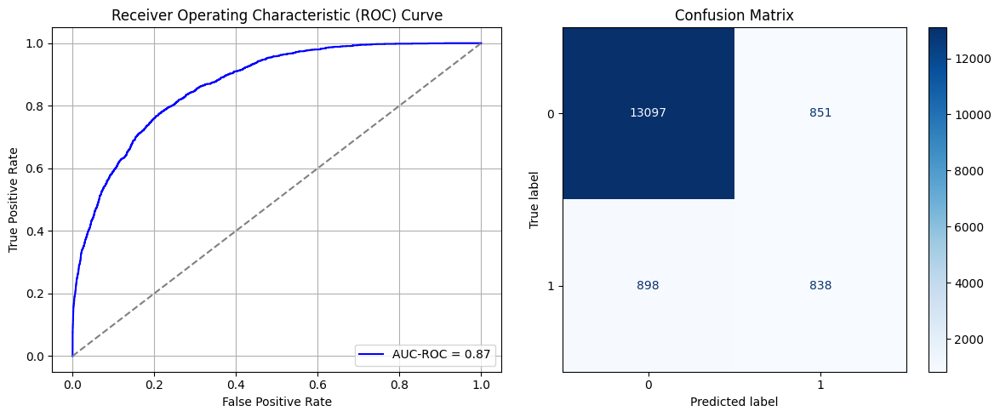

Best threshold based on F1-score: 0.4700740873813629
False Negative Rate: 0.5172811059907834
Time elapsed (performance): 1.2327518050005892
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.7752 - loss: 0.5650 - val_AUC: 0.8739 - val_loss: 0.4440
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8684 - loss: 0.4469 - val_AUC: 0.8760 - val_loss: 0.4372
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8736 - loss: 0.4393 - val_AUC: 0.8779 - val_loss: 0.4329
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8781 - loss: 0.4319 - val_AUC: 0.8795 - val_loss: 0.4302
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8712 - loss: 0.4412 - val_AUC: 0.8800 - val_loss: 0.4284
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8730 - loss: 0.4389 - val_AUC: 0.8785 - val_loss: 0.4619
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8752 - loss: 0.4359 - val_AUC: 0.8801 - val_loss: 0.4291
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8765 - loss: 0.4326 - val_AUC: 0.8802 - val_loss: 0.4275
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8755 -

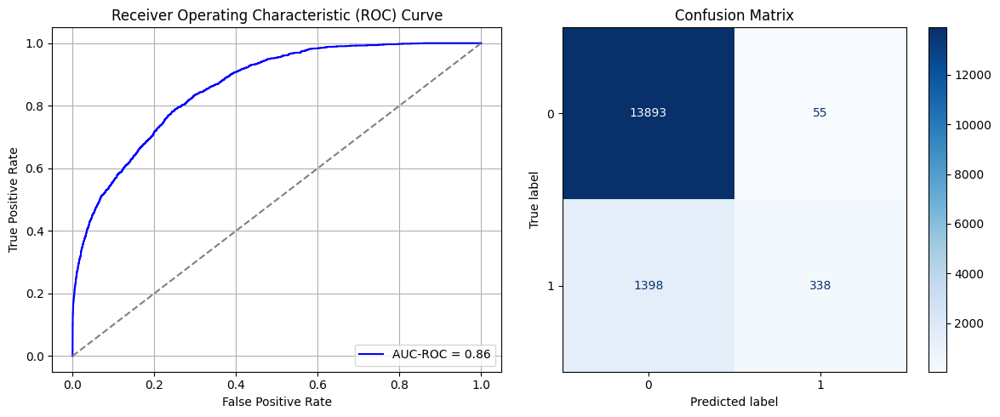

Best threshold based on F1-score: 0.1503598392009735
False Negative Rate: 0.8052995391705069
Time elapsed (performance): 1.920147798000471
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.7956 - loss: 0.5577 - val_AUC: 0.8704 - val_loss: 0.4487
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8741 - loss: 0.4397 - val_AUC: 0.8743 - val_loss: 0.4418
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8782 - loss: 0.4331 - val_AUC: 0.8758 - val_loss: 0.4471
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8780 - loss: 0.4314 - val_AUC: 0.8761 - val_loss: 0.4412
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8823 - loss: 0.4248 - val_AUC: 0.8770 - val_loss: 0.4442
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8795 - loss: 0.4304 - val_AUC: 0.8769 - val_loss: 0.4349
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8810 - loss: 0.4263 - val_AUC: 0.8774 - val_loss: 0.4329
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8816 - loss: 0.4249 - val_AUC: 0.8784 - val_loss: 0.4313
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8852 -

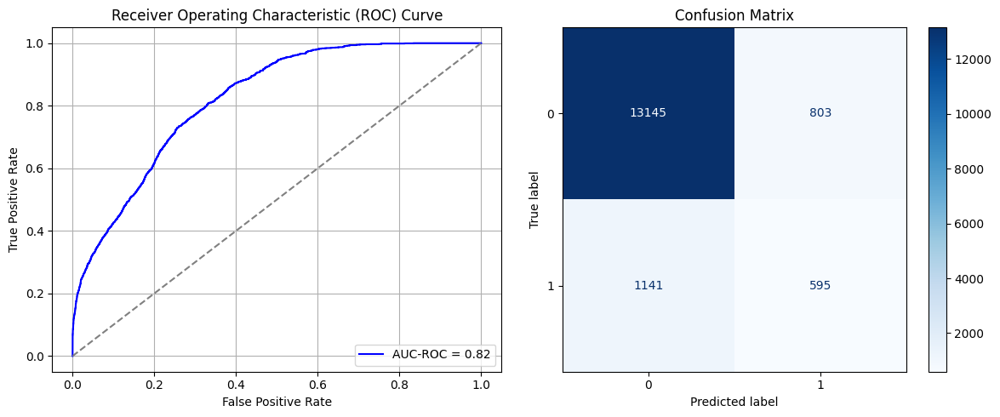

Best threshold based on F1-score: 0.16278310120105743
False Negative Rate: 0.657258064516129
Time elapsed (performance): 1.6916698879995238
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7713 - loss: 0.5689 - val_AUC: 0.8689 - val_loss: 0.4490
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8745 - loss: 0.4377 - val_AUC: 0.8714 - val_loss: 0.4450
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8758 - loss: 0.4351 - val_AUC: 0.8730 - val_loss: 0.4418
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8789 - loss: 0.4294 - val_AUC: 0.8726 - val_loss: 0.4413
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8784 - loss: 0.4306 - val_AUC: 0.8721 - val_loss: 0.4410
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8823 - loss: 0.4231 - val_AUC: 0.8742 - val_loss: 0.4396
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8794 - loss: 0.4270 - val_AUC: 0.8748 - val_loss: 0.4367
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8845 - loss: 0.4192 - val_AUC: 0.8739 - val_loss: 0.4398
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8816 -

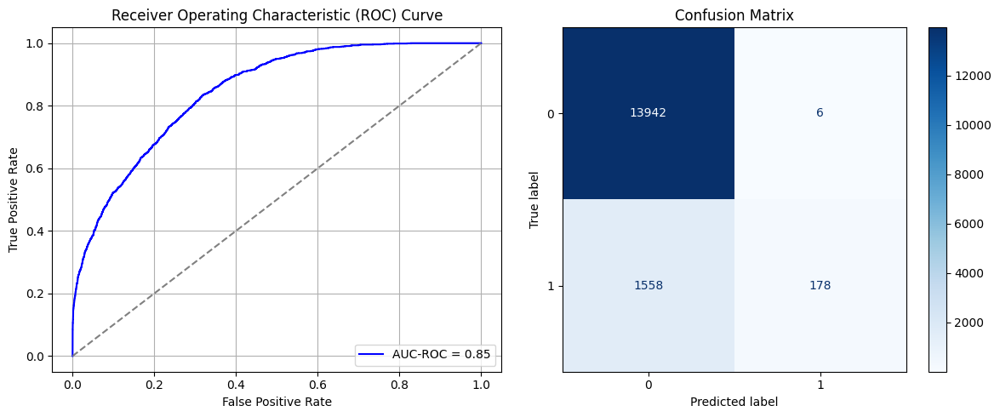

Best threshold based on F1-score: 0.03807556629180908
False Negative Rate: 0.8974654377880185
Time elapsed (performance): 1.3103183750008611
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7658 - loss: 0.5732 - val_AUC: 0.8672 - val_loss: 0.4524
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8741 - loss: 0.4398 - val_AUC: 0.8727 - val_loss: 0.4464
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8759 - loss: 0.4351 - val_AUC: 0.8740 - val_loss: 0.4384
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8776 - loss: 0.4323 - val_AUC: 0.8736 - val_loss: 0.4405
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8761 - loss: 0.4346 - val_AUC: 0.8747 - val_loss: 0.4385
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8814 - loss: 0.4258 - val_AUC: 0.8743 - val_loss: 0.4376
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8782 - loss: 0.4311 - val_AUC: 0.8753 - val_loss: 0.4379
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8787 - loss: 0.4292 - val_AUC: 0.8745 - val_loss: 0.4367
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8782 -

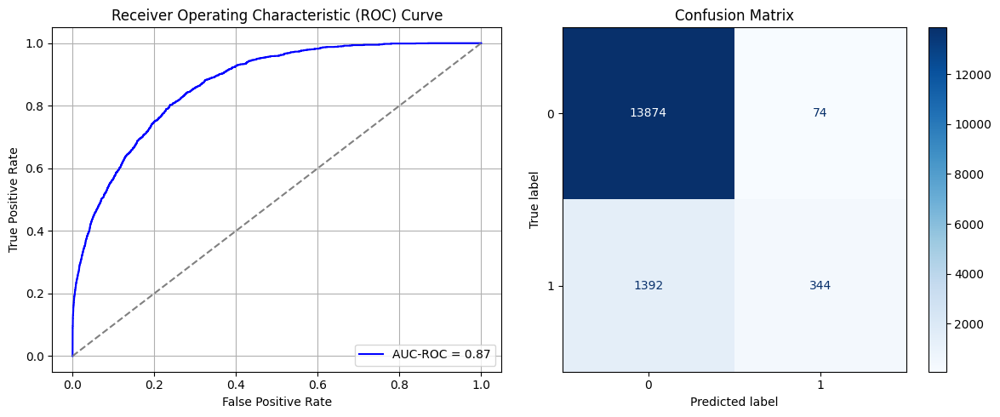

Best threshold based on F1-score: 0.1537143588066101
False Negative Rate: 0.8018433179723502
Time elapsed (performance): 1.2565283619987895
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7697 - loss: 0.5691 - val_AUC: 0.8717 - val_loss: 0.4447
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8694 - loss: 0.4458 - val_AUC: 0.8744 - val_loss: 0.4369
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8769 - loss: 0.4342 - val_AUC: 0.8758 - val_loss: 0.4354
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8755 - loss: 0.4353 - val_AUC: 0.8762 - val_loss: 0.4360
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8767 - loss: 0.4328 - val_AUC: 0.8771 - val_loss: 0.4328
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8750 - loss: 0.4363 - val_AUC: 0.8773 - val_loss: 0.4315
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8819 - loss: 0.4249 - val_AUC: 0.8784 - val_loss: 0.4370
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8783 - loss: 0.4308 - val_AUC: 0.8778 - val_loss: 0.4347
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8797 -

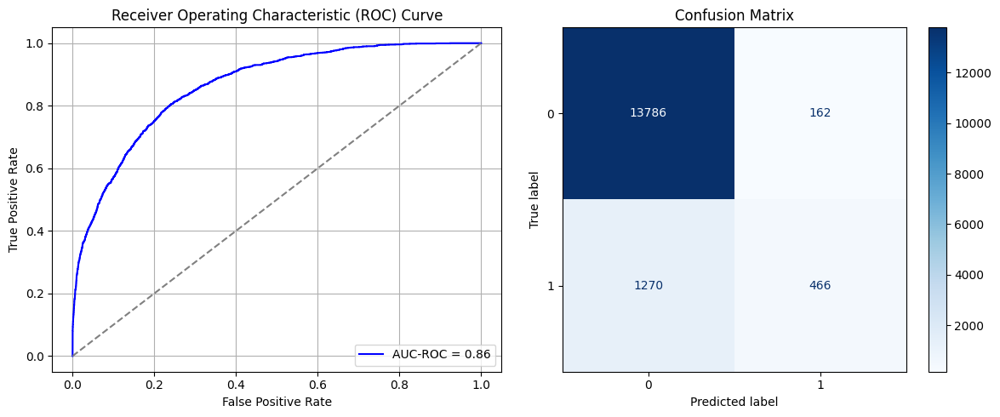

Best threshold based on F1-score: 0.22357375919818878
False Negative Rate: 0.7315668202764977
Time elapsed (performance): 1.6967650869992212
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7806 - loss: 0.5679 - val_AUC: 0.8730 - val_loss: 0.4417
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8737 - loss: 0.4390 - val_AUC: 0.8763 - val_loss: 0.4406
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8751 - loss: 0.4373 - val_AUC: 0.8777 - val_loss: 0.4318
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8796 - loss: 0.4291 - val_AUC: 0.8787 - val_loss: 0.4287
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8758 - loss: 0.4347 - val_AUC: 0.8760 - val_loss: 0.4333
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8764 - loss: 0.4341 - val_AUC: 0.8788 - val_loss: 0.4290
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - AUC: 0.8800 - loss: 0.4279 - val_AUC: 0.8788 - val_loss: 0.4284
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8778 - loss: 0.4309 - val_AUC: 0.8799 - val_loss: 0.4272
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8817 -

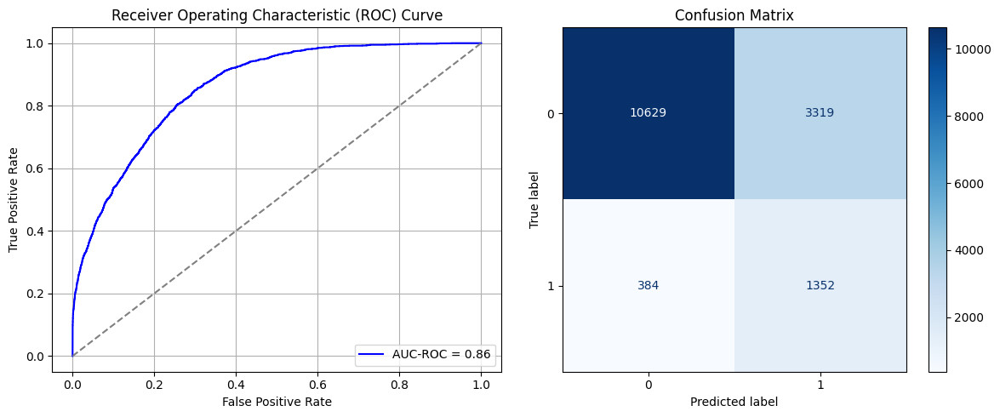

Best threshold based on F1-score: 0.7493723630905151
False Negative Rate: 0.22119815668202766
Time elapsed (performance): 1.6847176490009588
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.7920 - loss: 0.5581 - val_AUC: 0.8723 - val_loss: 0.4432
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8689 - loss: 0.4462 - val_AUC: 0.8761 - val_loss: 0.4431
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8767 - loss: 0.4341 - val_AUC: 0.8777 - val_loss: 0.4438
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8766 - loss: 0.4343 - val_AUC: 0.8790 - val_loss: 0.4323
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8812 - loss: 0.4268 - val_AUC: 0.8793 - val_loss: 0.4316
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8826 - loss: 0.4228 - val_AUC: 0.8794 - val_loss: 0.4363
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8757 - loss: 0.4346 - val_AUC: 0.8797 - val_loss: 0.4313
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8798 - loss: 0.4284 - val_AUC: 0.8799 - val_loss: 0.4276
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8789 -

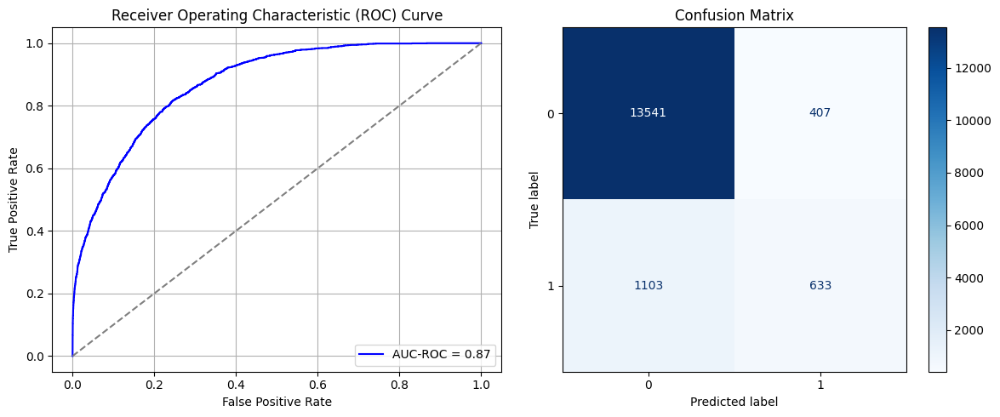

Best threshold based on F1-score: 0.35358184576034546
False Negative Rate: 0.6353686635944701
Time elapsed (performance): 1.6870394389989087
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7848 - loss: 0.5606 - val_AUC: 0.8687 - val_loss: 0.4501
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8726 - loss: 0.4412 - val_AUC: 0.8714 - val_loss: 0.4440
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8775 - loss: 0.4341 - val_AUC: 0.8724 - val_loss: 0.4430
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8743 - loss: 0.4370 - val_AUC: 0.8743 - val_loss: 0.4428
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8789 - loss: 0.4302 - val_AUC: 0.8752 - val_loss: 0.4393
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8774 - loss: 0.4322 - val_AUC: 0.8741 - val_loss: 0.4543
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8776 - loss: 0.4323 - val_AUC: 0.8751 - val_loss: 0.4374
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8800 - loss: 0.4288 - val_AUC: 0.8755 - val_loss: 0.4360
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8815 -

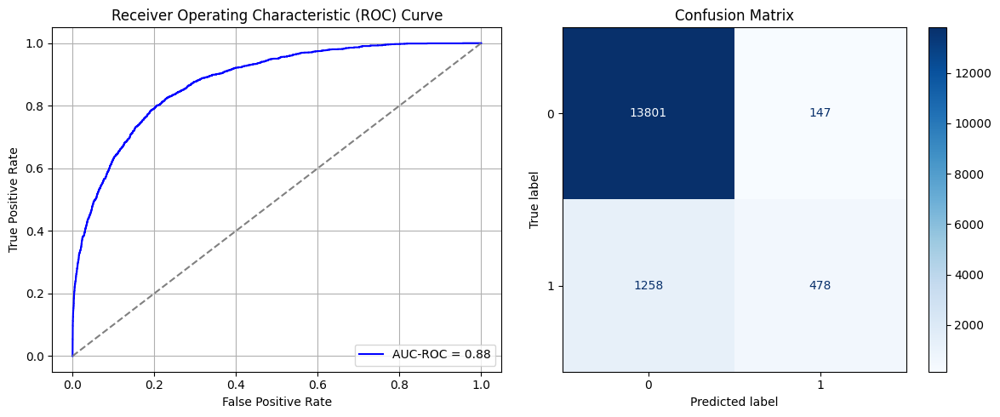

Best threshold based on F1-score: 0.20879003405570984
False Negative Rate: 0.7246543778801844
Time elapsed (performance): 1.6966952340007992
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7643 - loss: 0.5748 - val_AUC: 0.8677 - val_loss: 0.4602
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8732 - loss: 0.4416 - val_AUC: 0.8730 - val_loss: 0.4407
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8742 - loss: 0.4379 - val_AUC: 0.8741 - val_loss: 0.4381
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8749 - loss: 0.4373 - val_AUC: 0.8746 - val_loss: 0.4394
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8798 - loss: 0.4287 - val_AUC: 0.8752 - val_loss: 0.4355
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8791 - loss: 0.4292 - val_AUC: 0.8758 - val_loss: 0.4346
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - AUC: 0.8796 - loss: 0.4278 - val_AUC: 0.8767 - val_loss: 0.4337
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8803 - loss: 0.4272 - val_AUC: 0.8747 - val_loss: 0.4388
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8848 -

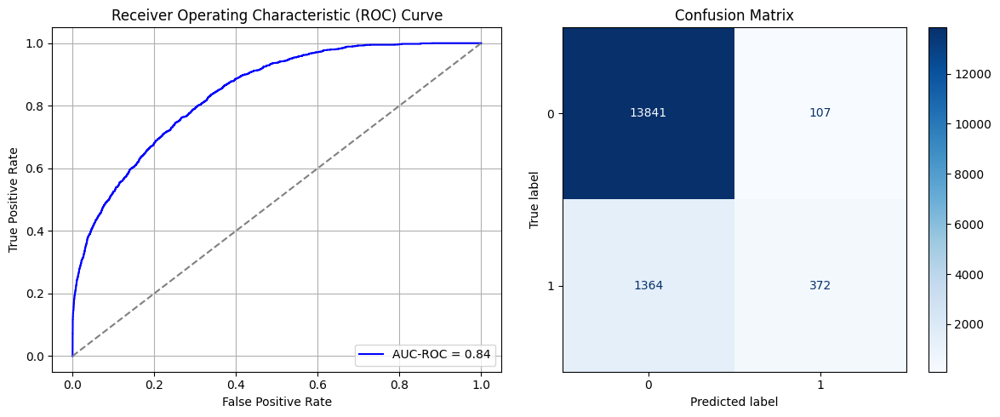

Best threshold based on F1-score: 0.2668302059173584
False Negative Rate: 0.7857142857142857
Time elapsed (performance): 1.8304541960005736
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8018 - loss: 0.5528 - val_AUC: 0.8670 - val_loss: 0.4501
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8747 - loss: 0.4367 - val_AUC: 0.8703 - val_loss: 0.4457
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8768 - loss: 0.4346 - val_AUC: 0.8721 - val_loss: 0.4409
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8785 - loss: 0.4309 - val_AUC: 0.8718 - val_loss: 0.4422
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8777 - loss: 0.4328 - val_AUC: 0.8714 - val_loss: 0.4456
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8776 - loss: 0.4307 - val_AUC: 0.8745 - val_loss: 0.4372
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8807 - loss: 0.4268 - val_AUC: 0.8747 - val_loss: 0.4364
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8827 - loss: 0.4235 - val_AUC: 0.8755 - val_loss: 0.4369
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8852 -

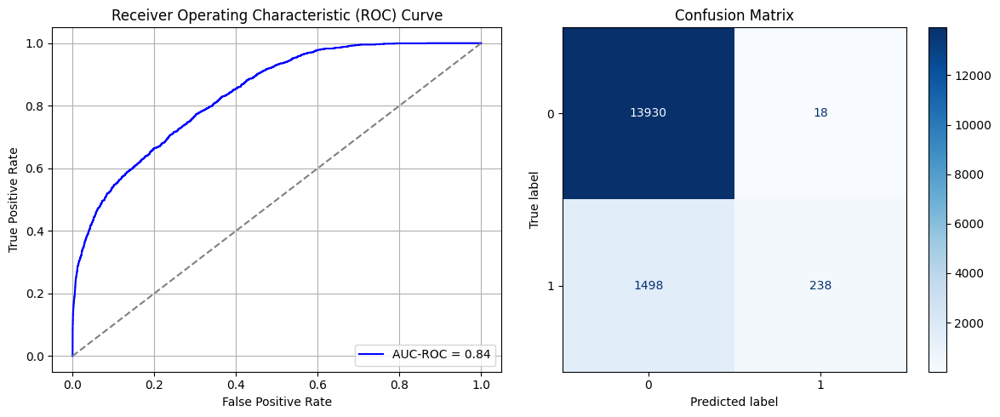

Best threshold based on F1-score: 0.07916612923145294
False Negative Rate: 0.8629032258064516
Time elapsed (performance): 1.5603459139983897
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 7s 6ms/step - AUC: 0.7887 - loss: 0.5542 - val_AUC: 0.8732 - val_loss: 0.4407
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8744 - loss: 0.4394 - val_AUC: 0.8756 - val_loss: 0.4361
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8781 - loss: 0.4321 - val_AUC: 0.8766 - val_loss: 0.4448
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8778 - loss: 0.4334 - val_AUC: 0.8757 - val_loss: 0.4357
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8785 - loss: 0.4308 - val_AUC: 0.8791 - val_loss: 0.4300
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8844 - loss: 0.4210 - val_AUC: 0.8795 - val_loss: 0.4290
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8793 - loss: 0.4299 - val_AUC: 0.8797 - val_loss: 0.4289
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8843 - loss: 0.4222 - val_AUC: 0.8796 - val_loss: 0.4285
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8808 -

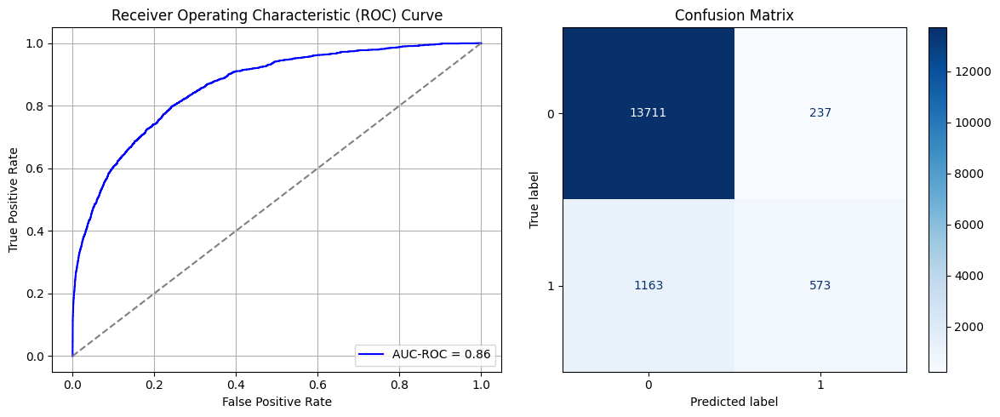

Best threshold based on F1-score: 0.3012438416481018
False Negative Rate: 0.6699308755760369
Time elapsed (performance): 1.7280962099994213
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7857 - loss: 0.5623 - val_AUC: 0.8703 - val_loss: 0.4502
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8731 - loss: 0.4413 - val_AUC: 0.8728 - val_loss: 0.4521
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8780 - loss: 0.4310 - val_AUC: 0.8739 - val_loss: 0.4416
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8787 - loss: 0.4302 - val_AUC: 0.8748 - val_loss: 0.4384
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8794 - loss: 0.4291 - val_AUC: 0.8759 - val_loss: 0.4362
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8818 - loss: 0.4249 - val_AUC: 0.8761 - val_loss: 0.4370
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8797 - loss: 0.4293 - val_AUC: 0.8769 - val_loss: 0.4364
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8835 - loss: 0.4221 - val_AUC: 0.8768 - val_loss: 0.4354
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8852 -

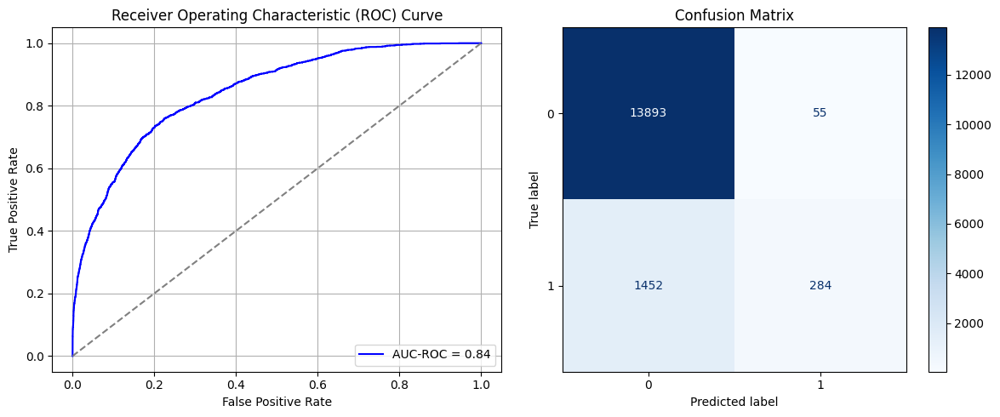

Best threshold based on F1-score: 0.1306961178779602
False Negative Rate: 0.836405529953917
Time elapsed (performance): 1.702154006001365
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7845 - loss: 0.5579 - val_AUC: 0.8710 - val_loss: 0.4462
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8740 - loss: 0.4394 - val_AUC: 0.8729 - val_loss: 0.4449
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8752 - loss: 0.4358 - val_AUC: 0.8739 - val_loss: 0.4416
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8774 - loss: 0.4327 - val_AUC: 0.8760 - val_loss: 0.4375
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8739 - loss: 0.4373 - val_AUC: 0.8755 - val_loss: 0.4360
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8779 - loss: 0.4333 - val_AUC: 0.8765 - val_loss: 0.4343
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8795 - loss: 0.4300 - val_AUC: 0.8770 - val_loss: 0.4373
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8843 - loss: 0.4218 - val_AUC: 0.8773 - val_loss: 0.4323
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8812 -

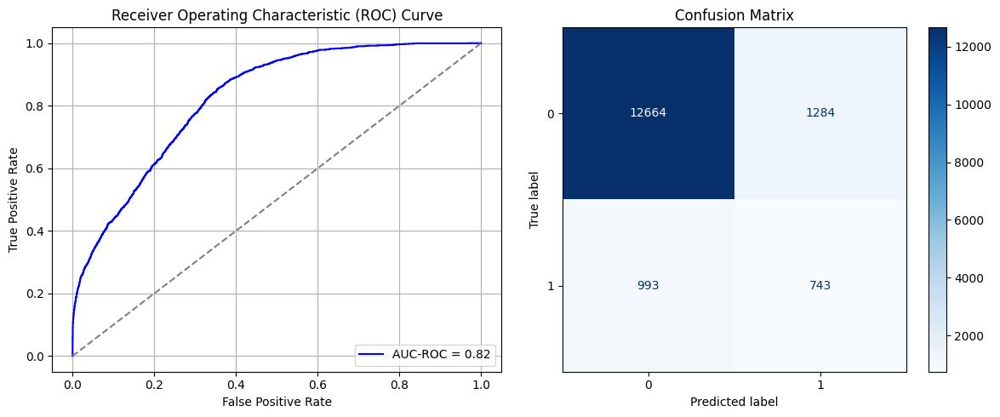

Best threshold based on F1-score: 0.5095908641815186
False Negative Rate: 0.5720046082949308
Time elapsed (performance): 1.3577523059993837
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7912 - loss: 0.5584 - val_AUC: 0.8681 - val_loss: 0.4496
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8726 - loss: 0.4400 - val_AUC: 0.8724 - val_loss: 0.4424
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8739 - loss: 0.4392 - val_AUC: 0.8735 - val_loss: 0.4435
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8785 - loss: 0.4313 - val_AUC: 0.8750 - val_loss: 0.4397
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8788 - loss: 0.4302 - val_AUC: 0.8764 - val_loss: 0.4367
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8833 - loss: 0.4222 - val_AUC: 0.8767 - val_loss: 0.4345
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8797 - loss: 0.4275 - val_AUC: 0.8767 - val_loss: 0.4341
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8852 - loss: 0.4195 - val_AUC: 0.8769 - val_loss: 0.4346
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8826 -

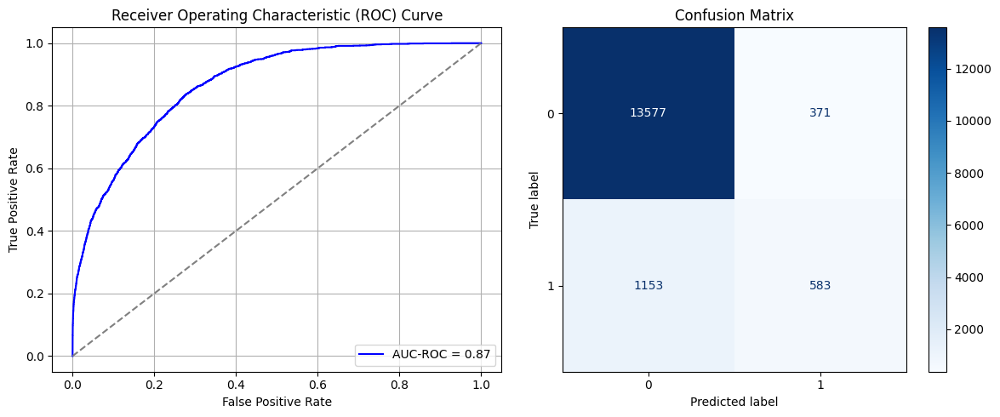

Best threshold based on F1-score: 0.36075490713119507
False Negative Rate: 0.6641705069124424
Time elapsed (performance): 1.8681451430002198
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7990 - loss: 0.5532 - val_AUC: 0.8700 - val_loss: 0.4476
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8720 - loss: 0.4428 - val_AUC: 0.8722 - val_loss: 0.4427
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8735 - loss: 0.4406 - val_AUC: 0.8737 - val_loss: 0.4425
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8749 - loss: 0.4367 - val_AUC: 0.8742 - val_loss: 0.4451
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8774 - loss: 0.4342 - val_AUC: 0.8747 - val_loss: 0.4421
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8786 - loss: 0.4307 - val_AUC: 0.8749 - val_loss: 0.4379
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8815 - loss: 0.4247 - val_AUC: 0.8750 - val_loss: 0.4376
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8811 - loss: 0.4256 - val_AUC: 0.8761 - val_loss: 0.4351
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8817 -

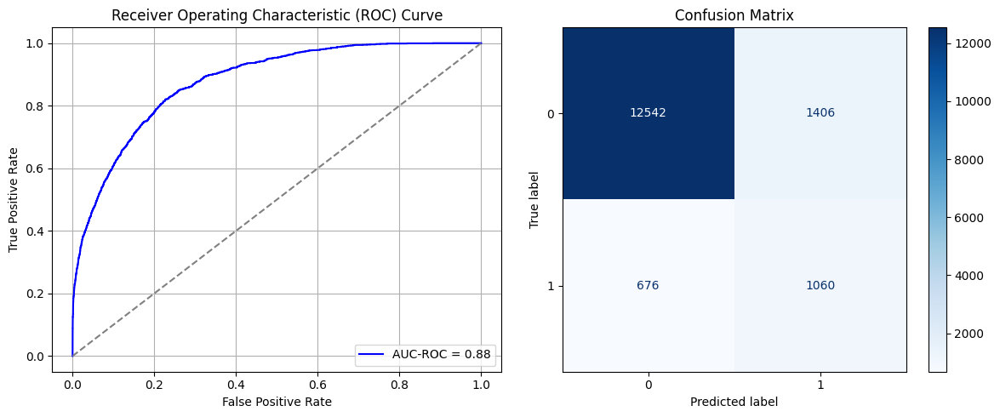

Best threshold based on F1-score: 0.547300398349762
False Negative Rate: 0.38940092165898615
Time elapsed (performance): 1.6934504410000955
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7631 - loss: 0.5709 - val_AUC: 0.8663 - val_loss: 0.4502
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8756 - loss: 0.4359 - val_AUC: 0.8695 - val_loss: 0.4467
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8757 - loss: 0.4350 - val_AUC: 0.8715 - val_loss: 0.4558
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 3ms/step - AUC: 0.8788 - loss: 0.4306 - val_AUC: 0.8720 - val_loss: 0.4428
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8776 - loss: 0.4331 - val_AUC: 0.8732 - val_loss: 0.4405
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8796 - loss: 0.4297 - val_AUC: 0.8741 - val_loss: 0.4430
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8814 - loss: 0.4259 - val_AUC: 0.8744 - val_loss: 0.4405
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8774 - loss: 0.4322 - val_AUC: 0.8749 - val_loss: 0.4386
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8808 -

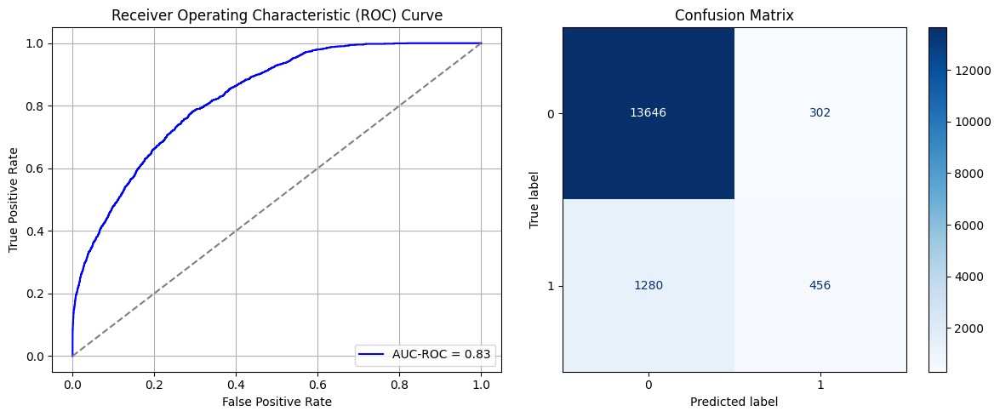

Best threshold based on F1-score: 0.24612511694431305
False Negative Rate: 0.7373271889400922
Time elapsed (performance): 1.8922251950007194
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7880 - loss: 0.5556 - val_AUC: 0.8713 - val_loss: 0.4560
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8707 - loss: 0.4447 - val_AUC: 0.8734 - val_loss: 0.4470
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8746 - loss: 0.4353 - val_AUC: 0.8755 - val_loss: 0.4382
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8758 - loss: 0.4352 - val_AUC: 0.8764 - val_loss: 0.4350
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8746 - loss: 0.4371 - val_AUC: 0.8762 - val_loss: 0.4360
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8751 - loss: 0.4351 - val_AUC: 0.8767 - val_loss: 0.4365
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8795 - loss: 0.4289 - val_AUC: 0.8772 - val_loss: 0.4330
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8796 - loss: 0.4283 - val_AUC: 0.8772 - val_loss: 0.4402
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8804 -

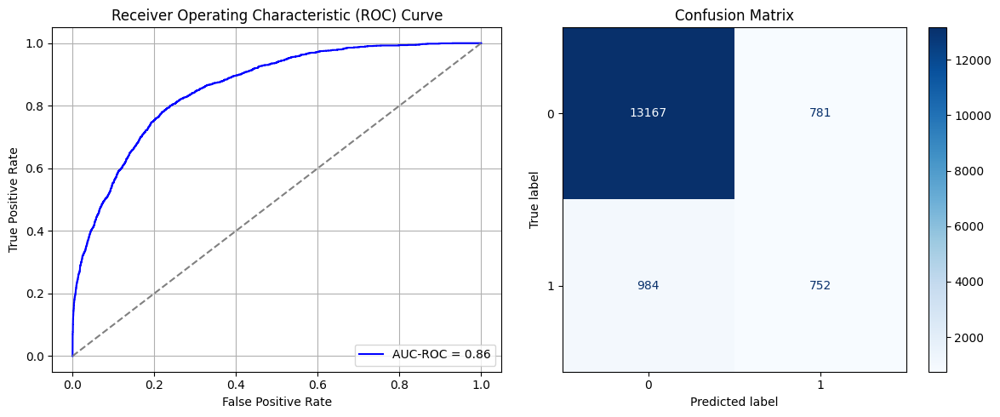

Best threshold based on F1-score: 0.36880210041999817
False Negative Rate: 0.5668202764976958
Time elapsed (performance): 1.3548461980008142
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.7813 - loss: 0.5654 - val_AUC: 0.8698 - val_loss: 0.4497
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8745 - loss: 0.4374 - val_AUC: 0.8747 - val_loss: 0.4399
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8784 - loss: 0.4301 - val_AUC: 0.8752 - val_loss: 0.4425
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8786 - loss: 0.4303 - val_AUC: 0.8764 - val_loss: 0.4349
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8802 - loss: 0.4263 - val_AUC: 0.8767 - val_loss: 0.4362
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8804 - loss: 0.4266 - val_AUC: 0.8772 - val_loss: 0.4335
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.8790 - loss: 0.4285 - val_AUC: 0.8785 - val_loss: 0.4304
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8815 - loss: 0.4240 - val_AUC: 0.8787 - val_loss: 0.4312
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8839 -

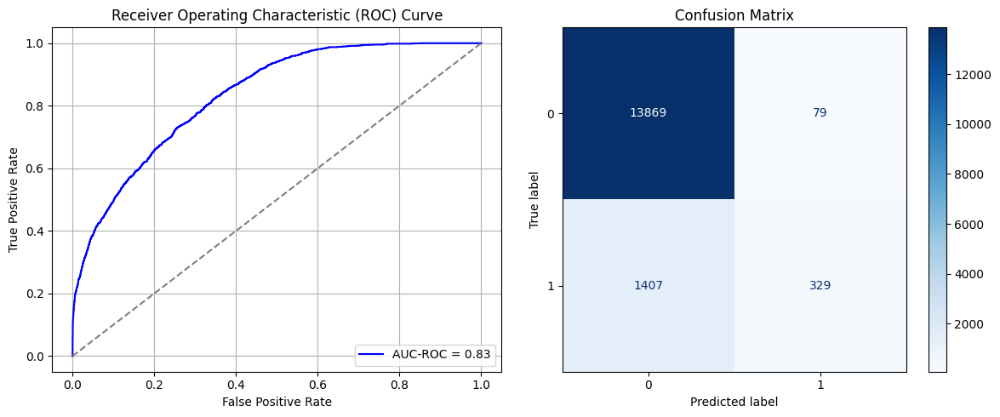

Best threshold based on F1-score: 0.1688806563615799
False Negative Rate: 0.8104838709677419
Time elapsed (performance): 1.365185679998831
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7778 - loss: 0.5696 - val_AUC: 0.8665 - val_loss: 0.4504
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8721 - loss: 0.4410 - val_AUC: 0.8712 - val_loss: 0.4430
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8743 - loss: 0.4373 - val_AUC: 0.8726 - val_loss: 0.4393
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8780 - loss: 0.4320 - val_AUC: 0.8744 - val_loss: 0.4428
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8778 - loss: 0.4308 - val_AUC: 0.8749 - val_loss: 0.4363
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8784 - loss: 0.4302 - val_AUC: 0.8747 - val_loss: 0.4373
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8816 - loss: 0.4246 - val_AUC: 0.8753 - val_loss: 0.4347
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8801 - loss: 0.4273 - val_AUC: 0.8758 - val_loss: 0.4337
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 6ms/step - AUC: 0.8798 -

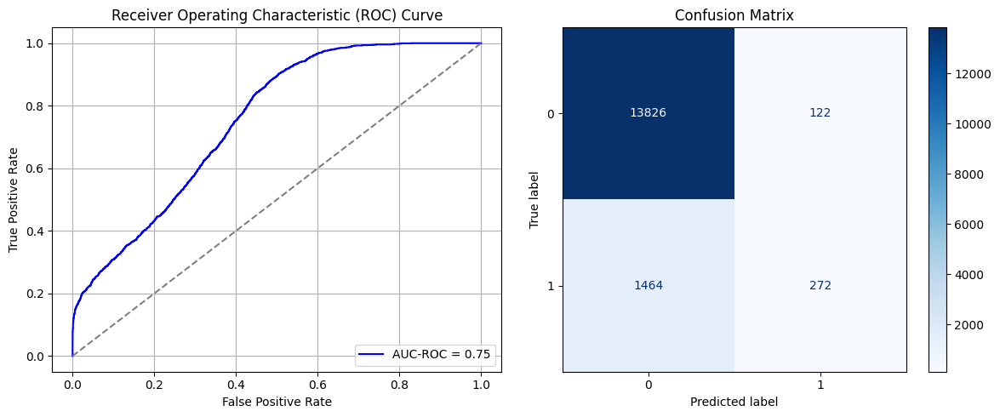

Best threshold based on F1-score: 0.022475922480225563
False Negative Rate: 0.8433179723502304
Time elapsed (performance): 1.728953564999756
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.7886 - loss: 0.5616 - val_AUC: 0.8699 - val_loss: 0.4525
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - AUC: 0.8709 - loss: 0.4424 - val_AUC: 0.8724 - val_loss: 0.4411
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8727 - loss: 0.4397 - val_AUC: 0.8744 - val_loss: 0.4385
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8742 - loss: 0.4377 - val_AUC: 0.8744 - val_loss: 0.4399
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8768 - loss: 0.4326 - val_AUC: 0.8763 - val_loss: 0.4336
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8789 - loss: 0.4291 - val_AUC: 0.8767 - val_loss: 0.4362
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8802 - loss: 0.4273 - val_AUC: 0.8768 - val_loss: 0.4327
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8792 - loss: 0.4268 - val_AUC: 0.8766 - val_loss: 0.4340
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8776 -

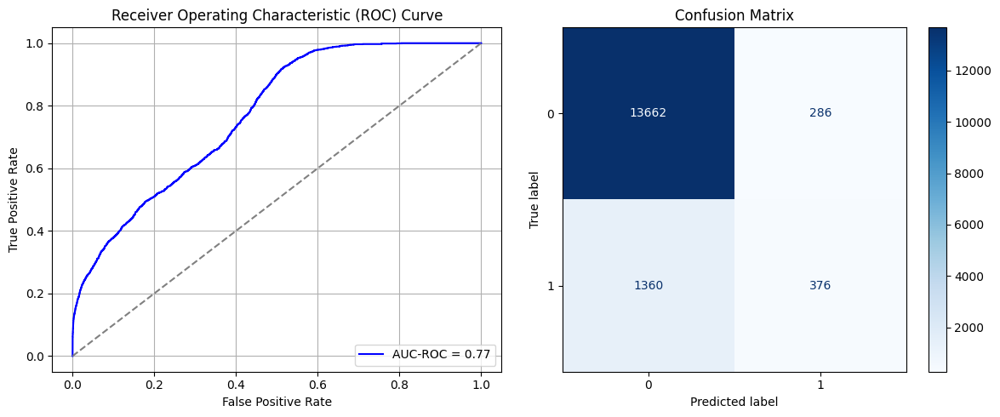

Best threshold based on F1-score: 0.26899436116218567
False Negative Rate: 0.783410138248848
Time elapsed (performance): 1.3903768890013453
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7915 - loss: 0.5554 - val_AUC: 0.8715 - val_loss: 0.4552
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8744 - loss: 0.4385 - val_AUC: 0.8744 - val_loss: 0.4473
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8741 - loss: 0.4388 - val_AUC: 0.8751 - val_loss: 0.4375
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8783 - loss: 0.4300 - val_AUC: 0.8756 - val_loss: 0.4431
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8802 - loss: 0.4272 - val_AUC: 0.8757 - val_loss: 0.4362
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8774 - loss: 0.4327 - val_AUC: 0.8762 - val_loss: 0.4351
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - AUC: 0.8798 - loss: 0.4276 - val_AUC: 0.8768 - val_loss: 0.4390
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8789 - loss: 0.4281 - val_AUC: 0.8774 - val_loss: 0.4338
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8804 -

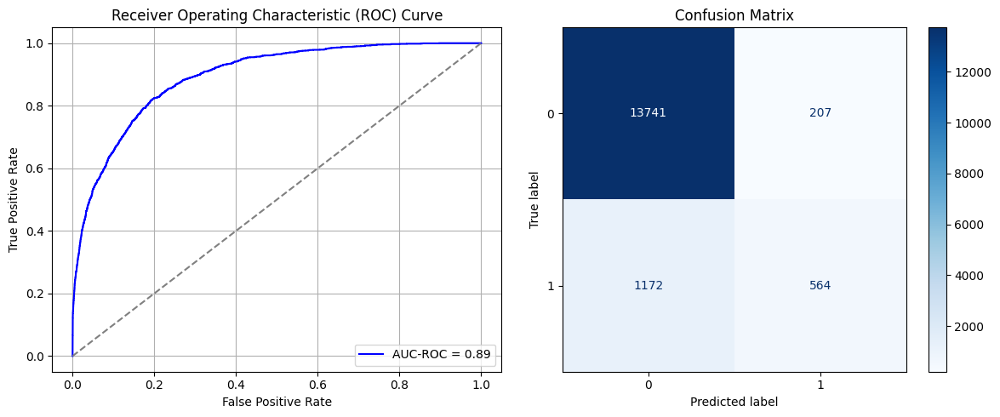

Best threshold based on F1-score: 0.3330344557762146
False Negative Rate: 0.6751152073732719
Time elapsed (performance): 3.016217582000536
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 14s 6ms/step - AUC: 0.7821 - loss: 0.5641 - val_AUC: 0.8694 - val_loss: 0.4522
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8704 - loss: 0.4432 - val_AUC: 0.8715 - val_loss: 0.4429
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8779 - loss: 0.4328 - val_AUC: 0.8741 - val_loss: 0.4378
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - AUC: 0.8748 - loss: 0.4362 - val_AUC: 0.8747 - val_loss: 0.4388
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8759 - loss: 0.4338 - val_AUC: 0.8751 - val_loss: 0.4435
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8794 - loss: 0.4292 - val_AUC: 0.8753 - val_loss: 0.4373
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - AUC: 0.8764 - loss: 0.4337 - val_AUC: 0.8760 - val_loss: 0.4341
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8811 - loss: 0.4261 - val_AUC: 0.8765 - val_loss: 0.4340
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8781 

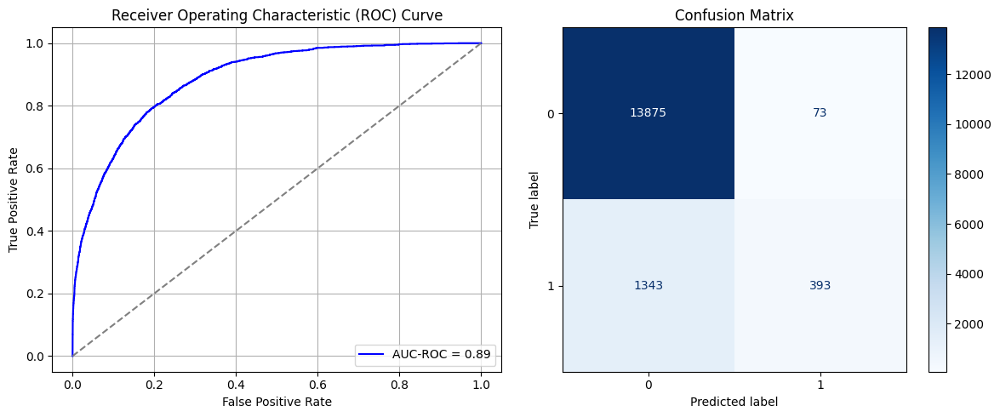

Best threshold based on F1-score: 0.1683417558670044
False Negative Rate: 0.7736175115207373
Time elapsed (performance): 1.4841523619998043
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.7841 - loss: 0.5645 - val_AUC: 0.8697 - val_loss: 0.4500
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8714 - loss: 0.4425 - val_AUC: 0.8726 - val_loss: 0.4414
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8779 - loss: 0.4319 - val_AUC: 0.8744 - val_loss: 0.4379
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8780 - loss: 0.4320 - val_AUC: 0.8750 - val_loss: 0.4364
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 6ms/step - AUC: 0.8789 - loss: 0.4309 - val_AUC: 0.8750 - val_loss: 0.4402
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8809 - loss: 0.4269 - val_AUC: 0.8767 - val_loss: 0.4336
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8777 - loss: 0.4322 - val_AUC: 0.8775 - val_loss: 0.4375
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8819 - loss: 0.4237 - val_AUC: 0.8775 - val_loss: 0.4318
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8792 -

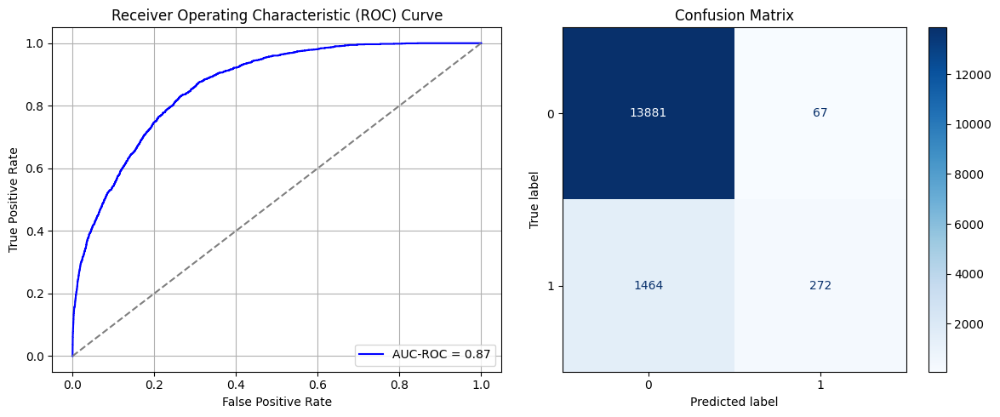

Best threshold based on F1-score: 0.09917056560516357
False Negative Rate: 0.8433179723502304
Time elapsed (performance): 2.1951899050000065
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.7741 - loss: 0.5690 - val_AUC: 0.8704 - val_loss: 0.4452
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8726 - loss: 0.4402 - val_AUC: 0.8722 - val_loss: 0.4421
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 6ms/step - AUC: 0.8750 - loss: 0.4371 - val_AUC: 0.8741 - val_loss: 0.4397
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.8800 - loss: 0.4288 - val_AUC: 0.8755 - val_loss: 0.4377
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8775 - loss: 0.4331 - val_AUC: 0.8750 - val_loss: 0.4432
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8794 - loss: 0.4295 - val_AUC: 0.8758 - val_loss: 0.4357
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8810 - loss: 0.4249 - val_AUC: 0.8762 - val_loss: 0.4507
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.8795 - loss: 0.4290 - val_AUC: 0.8752 - val_loss: 0.4442
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8824 -

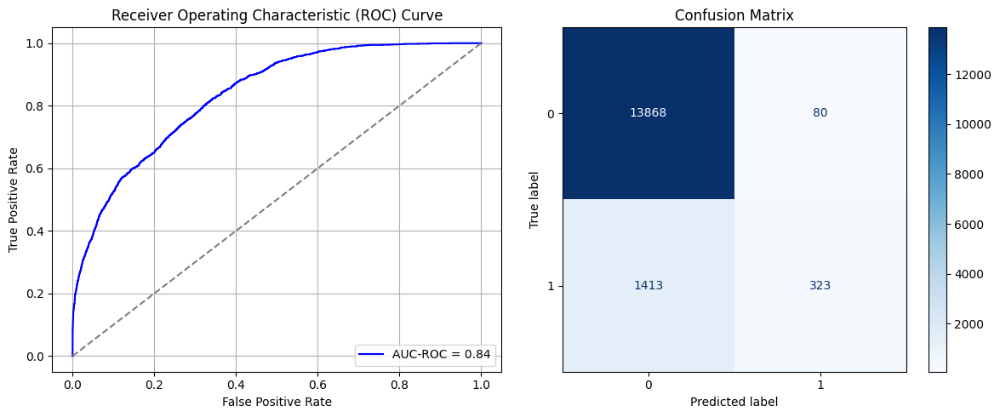

Best threshold based on F1-score: 0.16293665766716003
False Negative Rate: 0.8139400921658986
Time elapsed (performance): 1.898509718999776
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.7776 - loss: 0.5652 - val_AUC: 0.8718 - val_loss: 0.4465
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8734 - loss: 0.4402 - val_AUC: 0.8758 - val_loss: 0.4369
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.8728 - loss: 0.4411 - val_AUC: 0.8766 - val_loss: 0.4338
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8760 - loss: 0.4372 - val_AUC: 0.8773 - val_loss: 0.4333
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8779 - loss: 0.4323 - val_AUC: 0.8783 - val_loss: 0.4359
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 7s 6ms/step - AUC: 0.8776 - loss: 0.4331 - val_AUC: 0.8787 - val_loss: 0.4307
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8777 - loss: 0.4339 - val_AUC: 0.8792 - val_loss: 0.4296
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8776 - loss: 0.4331 - val_AUC: 0.8798 - val_loss: 0.4320
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 7s 6ms/step - AUC: 0.8825 -

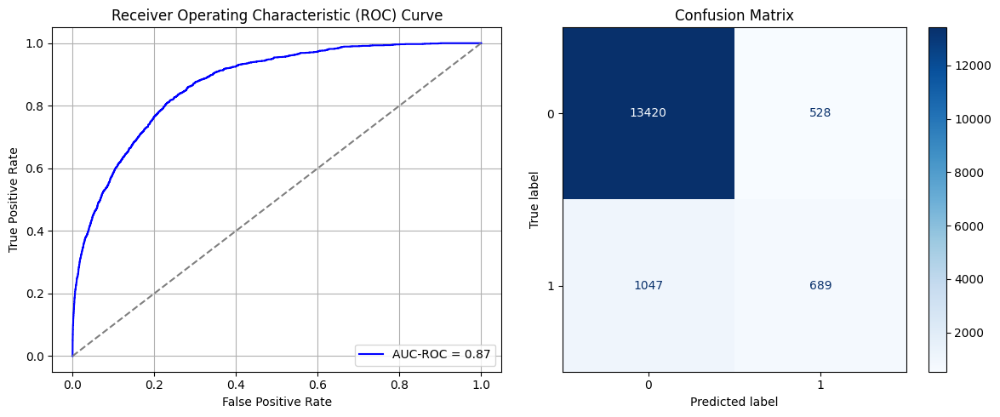

Best threshold based on F1-score: 0.35024359822273254
False Negative Rate: 0.603110599078341
Time elapsed (performance): 1.4813131729988527
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 7s 6ms/step - AUC: 0.7944 - loss: 0.5546 - val_AUC: 0.8717 - val_loss: 0.4768
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8728 - loss: 0.4404 - val_AUC: 0.8754 - val_loss: 0.4523
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8802 - loss: 0.4285 - val_AUC: 0.8763 - val_loss: 0.4349
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 6ms/step - AUC: 0.8786 - loss: 0.4302 - val_AUC: 0.8771 - val_loss: 0.4416
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8764 - loss: 0.4341 - val_AUC: 0.8776 - val_loss: 0.4373
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8771 - loss: 0.4337 - val_AUC: 0.8774 - val_loss: 0.4332
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 6ms/step - AUC: 0.8821 - loss: 0.4255 - val_AUC: 0.8777 - val_loss: 0.4352
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - AUC: 0.8818 - loss: 0.4254 - val_AUC: 0.8792 - val_loss: 0.4336
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 6ms/step - AUC: 0.8805 -

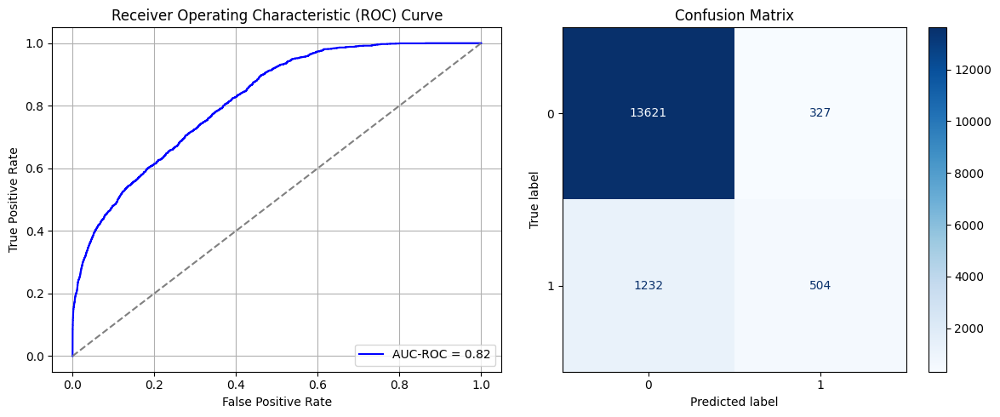

Best threshold based on F1-score: 0.3406180143356323
False Negative Rate: 0.7096774193548387
Time elapsed (performance): 1.5704470119999314
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 7s 6ms/step - AUC: 0.7806 - loss: 0.5626 - val_AUC: 0.8712 - val_loss: 0.4469
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 8s 4ms/step - AUC: 0.8748 - loss: 0.4389 - val_AUC: 0.8751 - val_loss: 0.4435
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 7s 6ms/step - AUC: 0.8749 - loss: 0.4375 - val_AUC: 0.8767 - val_loss: 0.4396
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 9s 5ms/step - AUC: 0.8750 - loss: 0.4363 - val_AUC: 0.8775 - val_loss: 0.4347
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - AUC: 0.8769 - loss: 0.4332 - val_AUC: 0.8776 - val_loss: 0.4691
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8748 - loss: 0.4367 - val_AUC: 0.8782 - val_loss: 0.4396
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - AUC: 0.8794 - loss: 0.4291 - val_AUC: 0.8788 - val_loss: 0.4312
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8811 - loss: 0.4254 - val_AUC: 0.8786 - val_loss: 0.4305
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8803 -

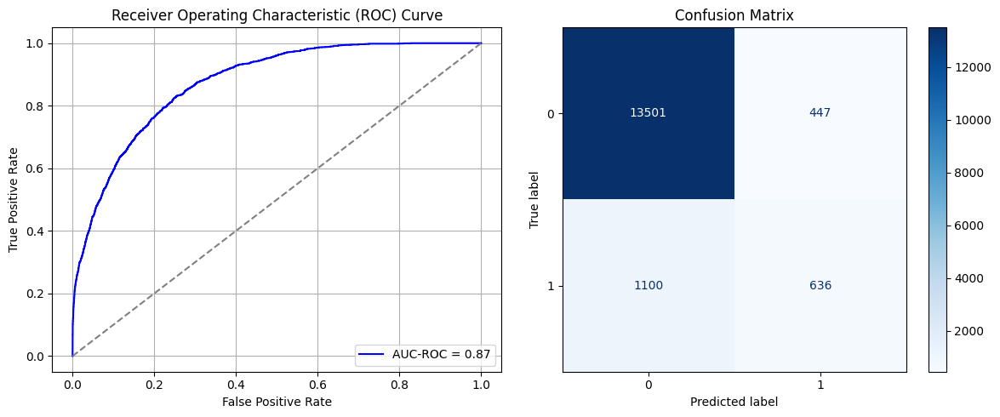

Best threshold based on F1-score: 0.35327470302581787
False Negative Rate: 0.6336405529953917
Time elapsed (performance): 1.4716844609993132
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.7848 - loss: 0.5604 - val_AUC: 0.8670 - val_loss: 0.4526
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - AUC: 0.8744 - loss: 0.4384 - val_AUC: 0.8715 - val_loss: 0.4422
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8776 - loss: 0.4318 - val_AUC: 0.8727 - val_loss: 0.4404
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8733 - loss: 0.4385 - val_AUC: 0.8734 - val_loss: 0.4406
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.8780 - loss: 0.4310 - val_AUC: 0.8739 - val_loss: 0.4391
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8723 - loss: 0.4406 - val_AUC: 0.8750 - val_loss: 0.4446
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.8793 - loss: 0.4305 - val_AUC: 0.8750 - val_loss: 0.4363
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - AUC: 0.8823 - loss: 0.4237 - val_AUC: 0.8753 - val_loss: 0.4359
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.8819 -

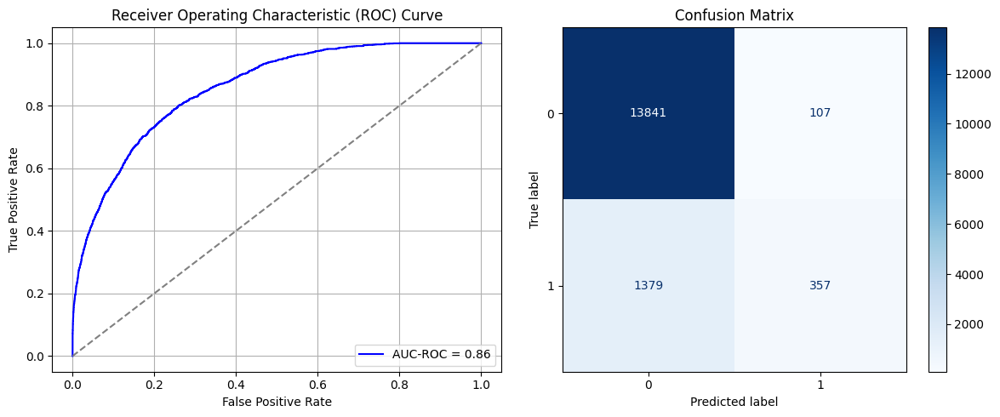

Best threshold based on F1-score: 0.2110820710659027
False Negative Rate: 0.7943548387096774
Time elapsed (performance): 1.9848441329995694
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8008 - loss: 0.5545 - val_AUC: 0.8710 - val_loss: 0.4435
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8739 - loss: 0.4395 - val_AUC: 0.8736 - val_loss: 0.4506
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 6ms/step - AUC: 0.8748 - loss: 0.4372 - val_AUC: 0.8751 - val_loss: 0.4378
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8754 - loss: 0.4370 - val_AUC: 0.8749 - val_loss: 0.4391
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8800 - loss: 0.4279 - val_AUC: 0.8755 - val_loss: 0.4380
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 7s 6ms/step - AUC: 0.8803 - loss: 0.4284 - val_AUC: 0.8755 - val_loss: 0.4397
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8795 - loss: 0.4285 - val_AUC: 0.8766 - val_loss: 0.4351
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8779 - loss: 0.4325 - val_AUC: 0.8767 - val_loss: 0.4371
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8796 -

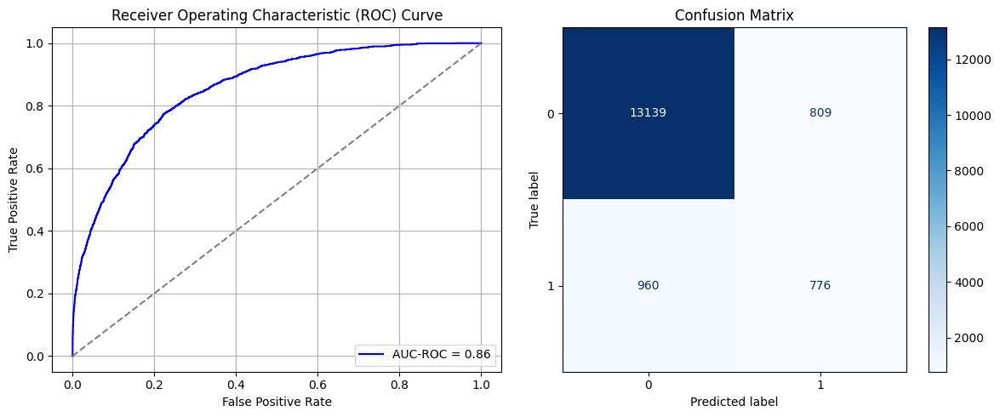

Best threshold based on F1-score: 0.3791814148426056
False Negative Rate: 0.5529953917050692
Time elapsed (performance): 1.936101958999643
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.7896 - loss: 0.5577 - val_AUC: 0.8715 - val_loss: 0.4443
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8707 - loss: 0.4430 - val_AUC: 0.8743 - val_loss: 0.4416
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 6ms/step - AUC: 0.8733 - loss: 0.4376 - val_AUC: 0.8750 - val_loss: 0.4447
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8776 - loss: 0.4319 - val_AUC: 0.8767 - val_loss: 0.4344
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8760 - loss: 0.4330 - val_AUC: 0.8784 - val_loss: 0.4310
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - AUC: 0.8798 - loss: 0.4264 - val_AUC: 0.8781 - val_loss: 0.4342
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 9s 5ms/step - AUC: 0.8792 - loss: 0.4273 - val_AUC: 0.8781 - val_loss: 0.4314
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 6ms/step - AUC: 0.8825 - loss: 0.4215 - val_AUC: 0.8782 - val_loss: 0.4303
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.8832 -

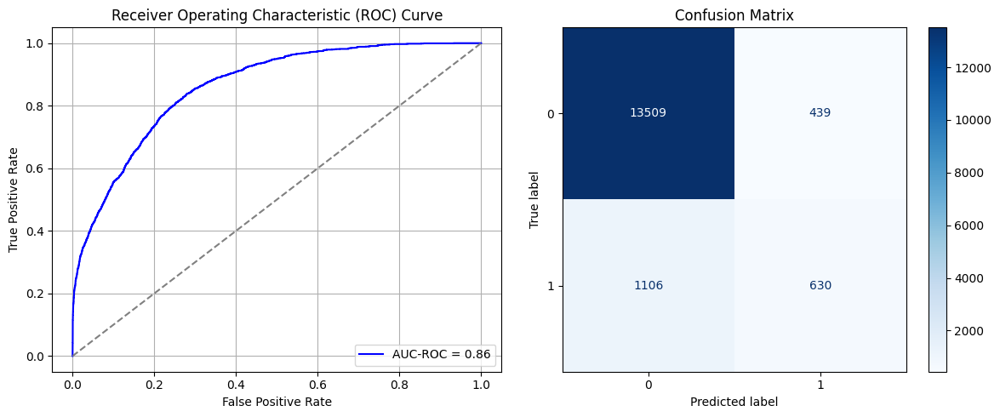

Best threshold based on F1-score: 0.2997667193412781
False Negative Rate: 0.6370967741935484
Time elapsed (performance): 2.417252365999957
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.7817 - loss: 0.5606 - val_AUC: 0.8740 - val_loss: 0.4605
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8724 - loss: 0.4414 - val_AUC: 0.8779 - val_loss: 0.4342
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.8803 - loss: 0.4283 - val_AUC: 0.8740 - val_loss: 0.4620
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8803 - loss: 0.4278 - val_AUC: 0.8789 - val_loss: 0.4318
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 6ms/step - AUC: 0.8743 - loss: 0.4368 - val_AUC: 0.8795 - val_loss: 0.4318
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 9s 5ms/step - AUC: 0.8777 - loss: 0.4317 - val_AUC: 0.8793 - val_loss: 0.4318
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 7s 7ms/step - AUC: 0.8794 - loss: 0.4291 - val_AUC: 0.8804 - val_loss: 0.4313
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8829 - loss: 0.4241 - val_AUC: 0.8804 - val_loss: 0.4290
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8773 -

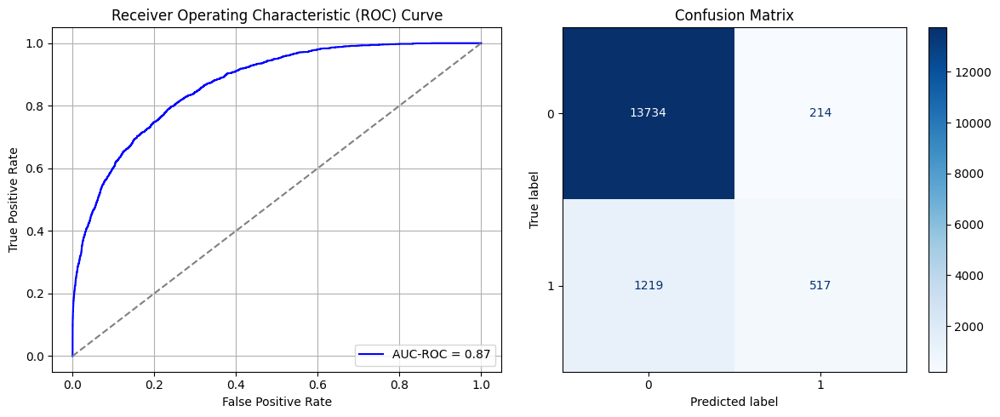

Best threshold based on F1-score: 0.2745169401168823
False Negative Rate: 0.7021889400921659
Time elapsed (performance): 1.6327880949993414
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 7s 6ms/step - AUC: 0.7804 - loss: 0.5686 - val_AUC: 0.8669 - val_loss: 0.4503
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 9s 5ms/step - AUC: 0.8717 - loss: 0.4418 - val_AUC: 0.8699 - val_loss: 0.4544
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 6ms/step - AUC: 0.8817 - loss: 0.4261 - val_AUC: 0.8719 - val_loss: 0.4442
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8809 - loss: 0.4260 - val_AUC: 0.8729 - val_loss: 0.4440
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8775 - loss: 0.4322 - val_AUC: 0.8716 - val_loss: 0.4446
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8803 - loss: 0.4262 - val_AUC: 0.8741 - val_loss: 0.4378
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 6ms/step - AUC: 0.8817 - loss: 0.4250 - val_AUC: 0.8745 - val_loss: 0.4391
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8812 - loss: 0.4264 - val_AUC: 0.8753 - val_loss: 0.4367
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - AUC: 0.8766 -

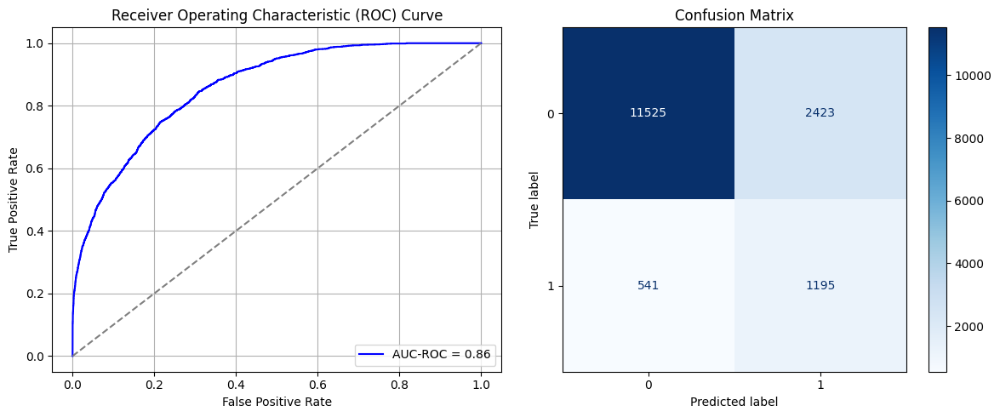

Best threshold based on F1-score: 0.7257241010665894
False Negative Rate: 0.31163594470046085
Time elapsed (performance): 1.6389414049990592
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.7765 - loss: 0.5676 - val_AUC: 0.8695 - val_loss: 0.4503
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8731 - loss: 0.4414 - val_AUC: 0.8742 - val_loss: 0.4422
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8744 - loss: 0.4364 - val_AUC: 0.8766 - val_loss: 0.4387
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8749 - loss: 0.4360 - val_AUC: 0.8772 - val_loss: 0.4338
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.8789 - loss: 0.4310 - val_AUC: 0.8778 - val_loss: 0.4334
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.8782 - loss: 0.4301 - val_AUC: 0.8783 - val_loss: 0.4376
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.8792 - loss: 0.4295 - val_AUC: 0.8785 - val_loss: 0.4334
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.8819 - loss: 0.4258 - val_AUC: 0.8783 - val_loss: 0.4635
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8813 -

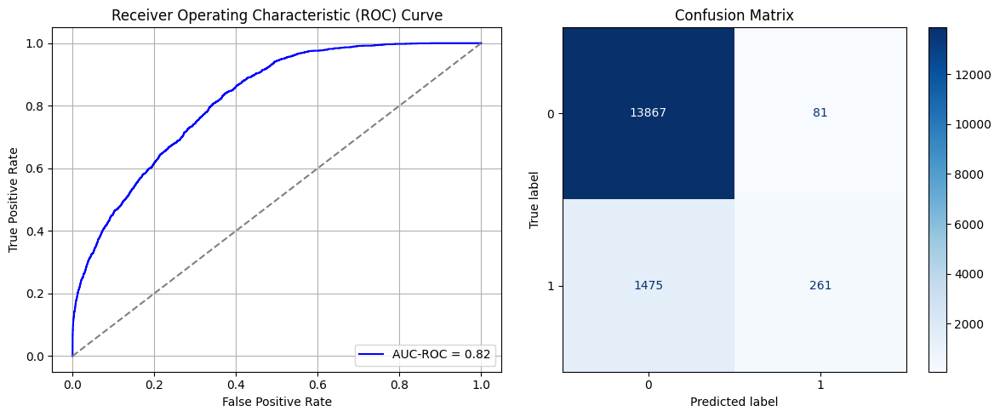

Best threshold based on F1-score: 0.11277025938034058
False Negative Rate: 0.8496543778801844
Time elapsed (performance): 1.6149997860011354
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.7778 - loss: 0.5653 - val_AUC: 0.8705 - val_loss: 0.4526
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 6ms/step - AUC: 0.8735 - loss: 0.4402 - val_AUC: 0.8723 - val_loss: 0.4573
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8744 - loss: 0.4386 - val_AUC: 0.8738 - val_loss: 0.4385
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8779 - loss: 0.4317 - val_AUC: 0.8747 - val_loss: 0.4487
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - AUC: 0.8780 - loss: 0.4310 - val_AUC: 0.8754 - val_loss: 0.4360
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 9s 5ms/step - AUC: 0.8794 - loss: 0.4296 - val_AUC: 0.8767 - val_loss: 0.4343
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.8749 - loss: 0.4377 - val_AUC: 0.8778 - val_loss: 0.4338
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.8806 - loss: 0.4278 - val_AUC: 0.8773 - val_loss: 0.4332
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - AUC: 0.8774 -

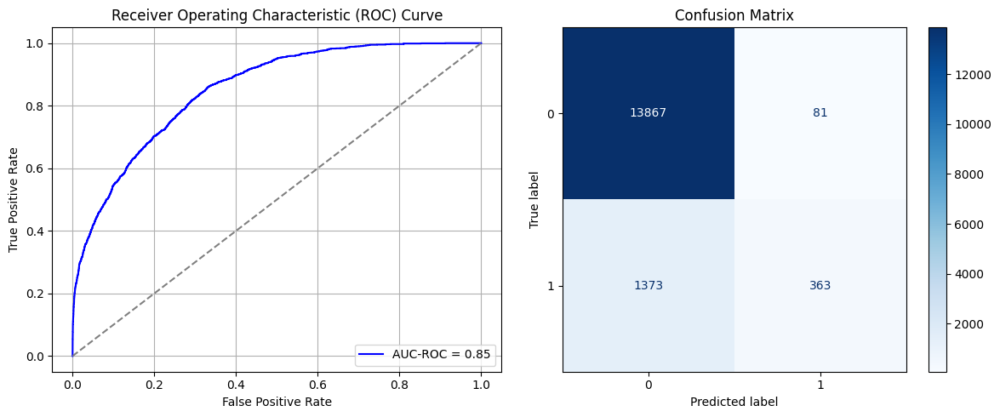

Best threshold based on F1-score: 0.1062726080417633
False Negative Rate: 0.7908986175115207
Time elapsed (performance): 3.061498928000219
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - AUC: 0.7762 - loss: 0.5779 - val_AUC: 0.8705 - val_loss: 0.4462
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8700 - loss: 0.4462 - val_AUC: 0.8730 - val_loss: 0.4421
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8706 - loss: 0.4438 - val_AUC: 0.8731 - val_loss: 0.4418
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8725 - loss: 0.4410 - val_AUC: 0.8754 - val_loss: 0.4469
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8782 - loss: 0.4303 - val_AUC: 0.8763 - val_loss: 0.4395
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8823 - loss: 0.4249 - val_AUC: 0.8767 - val_loss: 0.4366
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8773 - loss: 0.4309 - val_AUC: 0.8773 - val_loss: 0.4388
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8818 - loss: 0.4260 - val_AUC: 0.8766 - val_loss: 0.4360
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8790 -

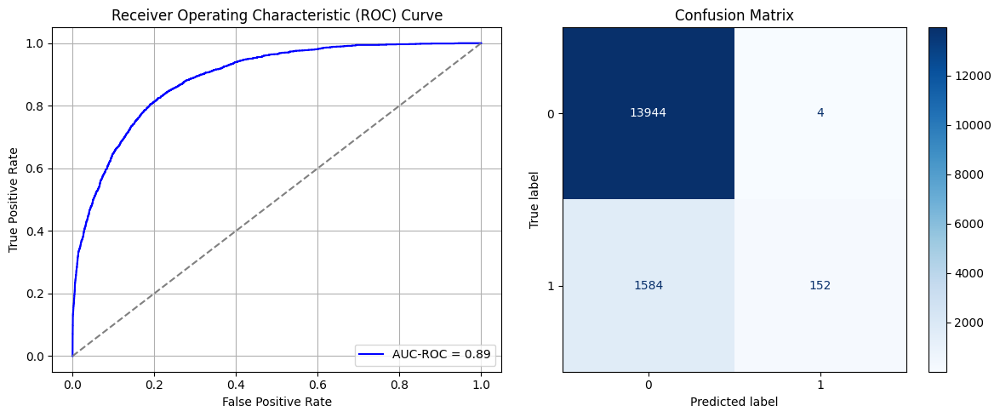

Best threshold based on F1-score: 0.03326579928398132
False Negative Rate: 0.9124423963133641
Time elapsed (performance): 1.7970605959999375
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.7738 - loss: 0.5689 - val_AUC: 0.8711 - val_loss: 0.4499
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8713 - loss: 0.4439 - val_AUC: 0.8733 - val_loss: 0.4410
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8752 - loss: 0.4373 - val_AUC: 0.8738 - val_loss: 0.4392
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8746 - loss: 0.4369 - val_AUC: 0.8757 - val_loss: 0.4448
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8754 - loss: 0.4355 - val_AUC: 0.8756 - val_loss: 0.4364
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8775 - loss: 0.4324 - val_AUC: 0.8762 - val_loss: 0.4346
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8785 - loss: 0.4295 - val_AUC: 0.8757 - val_loss: 0.4453
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8738 - loss: 0.4372 - val_AUC: 0.8773 - val_loss: 0.4337
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8758 -

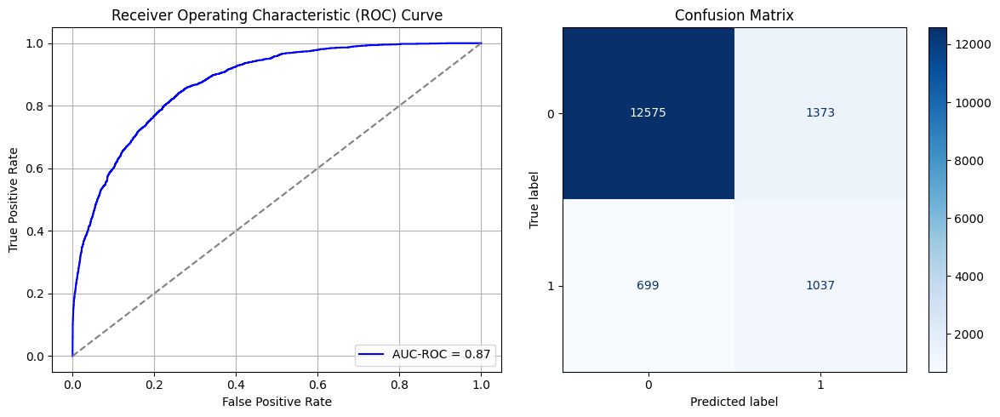

Best threshold based on F1-score: 0.574760913848877
False Negative Rate: 0.40264976958525345
Time elapsed (performance): 1.7199584600002709
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.7717 - loss: 0.5667 - val_AUC: 0.8695 - val_loss: 0.4700
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8712 - loss: 0.4425 - val_AUC: 0.8731 - val_loss: 0.4441
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8753 - loss: 0.4363 - val_AUC: 0.8739 - val_loss: 0.4403
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8785 - loss: 0.4313 - val_AUC: 0.8749 - val_loss: 0.4419
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8786 - loss: 0.4305 - val_AUC: 0.8763 - val_loss: 0.4361
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8817 - loss: 0.4240 - val_AUC: 0.8767 - val_loss: 0.4347
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8823 - loss: 0.4242 - val_AUC: 0.8760 - val_loss: 0.4386
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8773 - loss: 0.4306 - val_AUC: 0.8773 - val_loss: 0.4350
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.8772 -

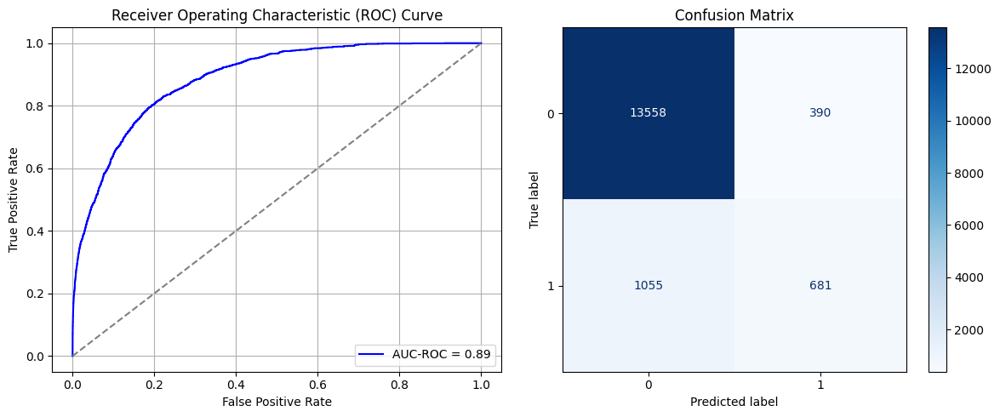

Best threshold based on F1-score: 0.3208860456943512
False Negative Rate: 0.6077188940092166
Time elapsed (performance): 1.5295200279997516
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 7s 6ms/step - AUC: 0.7822 - loss: 0.5709 - val_AUC: 0.8722 - val_loss: 0.4419
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8706 - loss: 0.4440 - val_AUC: 0.8753 - val_loss: 0.4450
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8788 - loss: 0.4302 - val_AUC: 0.8785 - val_loss: 0.4398
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 7s 6ms/step - AUC: 0.8774 - loss: 0.4323 - val_AUC: 0.8785 - val_loss: 0.4309
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8795 - loss: 0.4296 - val_AUC: 0.8799 - val_loss: 0.4282
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8796 - loss: 0.4282 - val_AUC: 0.8805 - val_loss: 0.4292
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8799 - loss: 0.4272 - val_AUC: 0.8800 - val_loss: 0.4454
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8799 - loss: 0.4277 - val_AUC: 0.8797 - val_loss: 0.4282
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8809 -

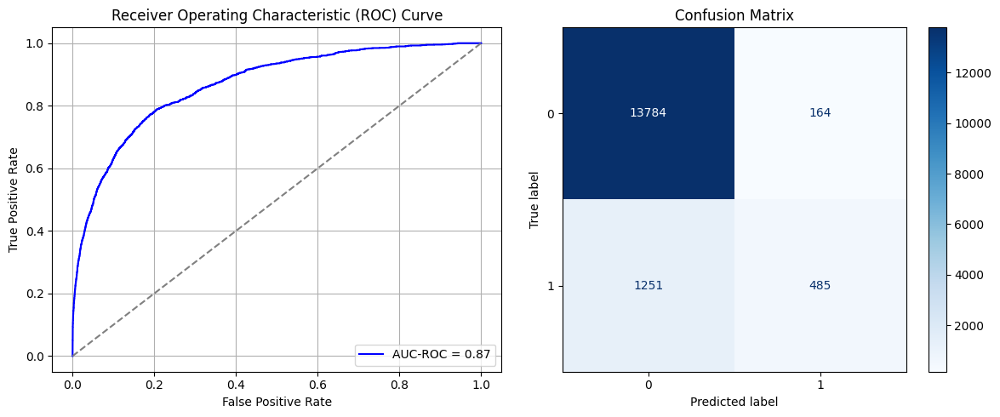

Best threshold based on F1-score: 0.19862598180770874
False Negative Rate: 0.7206221198156681
Time elapsed (performance): 1.5573234250005044
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.7614 - loss: 0.5756 - val_AUC: 0.8725 - val_loss: 0.4418
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.8753 - loss: 0.4369 - val_AUC: 0.8748 - val_loss: 0.4417
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8771 - loss: 0.4335 - val_AUC: 0.8752 - val_loss: 0.4378
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8810 - loss: 0.4268 - val_AUC: 0.8759 - val_loss: 0.4356
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - AUC: 0.8794 - loss: 0.4290 - val_AUC: 0.8768 - val_loss: 0.4347
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8830 - loss: 0.4221 - val_AUC: 0.8769 - val_loss: 0.4320
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8778 - loss: 0.4311 - val_AUC: 0.8780 - val_loss: 0.4314
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - AUC: 0.8807 - loss: 0.4270 - val_AUC: 0.8786 - val_loss: 0.4304
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8801 -

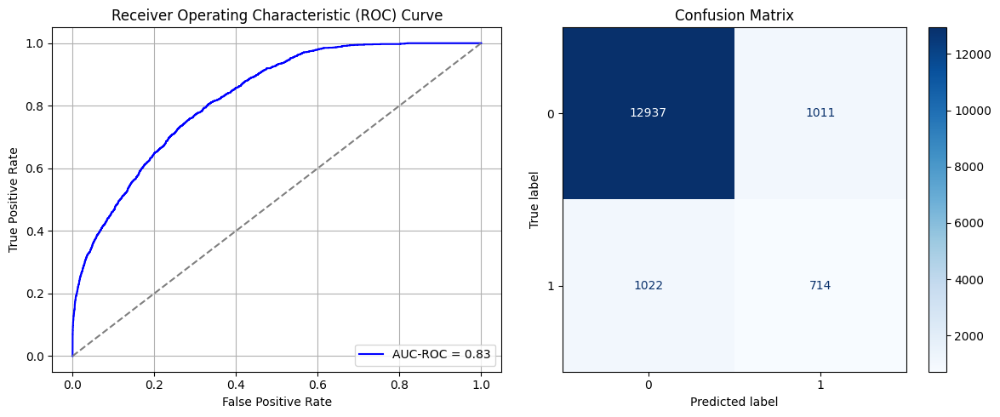

Best threshold based on F1-score: 0.5413290858268738
False Negative Rate: 0.5887096774193549
Time elapsed (performance): 3.055822211999839
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.7845 - loss: 0.5671 - val_AUC: 0.8683 - val_loss: 0.4470
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8734 - loss: 0.4408 - val_AUC: 0.8727 - val_loss: 0.4400
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8734 - loss: 0.4386 - val_AUC: 0.8741 - val_loss: 0.4402
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8760 - loss: 0.4349 - val_AUC: 0.8754 - val_loss: 0.4361
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8750 - loss: 0.4363 - val_AUC: 0.8749 - val_loss: 0.4363
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8780 - loss: 0.4311 - val_AUC: 0.8760 - val_loss: 0.4402
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8781 - loss: 0.4307 - val_AUC: 0.8769 - val_loss: 0.4338
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8790 - loss: 0.4303 - val_AUC: 0.8766 - val_loss: 0.4354
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8799 -

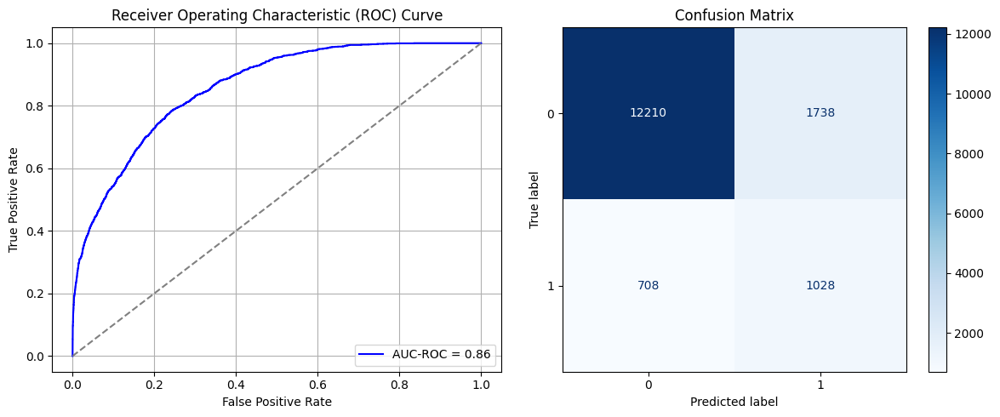

Best threshold based on F1-score: 0.5848279595375061
False Negative Rate: 0.4078341013824885
Time elapsed (performance): 1.8737471899985394
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.7787 - loss: 0.5597 - val_AUC: 0.8696 - val_loss: 0.4582
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8753 - loss: 0.4374 - val_AUC: 0.8721 - val_loss: 0.4421
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8758 - loss: 0.4352 - val_AUC: 0.8741 - val_loss: 0.4375
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8756 - loss: 0.4353 - val_AUC: 0.8732 - val_loss: 0.4394
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 14s 14ms/step - AUC: 0.8804 - loss: 0.4282 - val_AUC: 0.8756 - val_loss: 0.4359
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 12s 5ms/step - AUC: 0.8823 - loss: 0.4244 - val_AUC: 0.8748 - val_loss: 0.4372
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8772 - loss: 0.4332 - val_AUC: 0.8760 - val_loss: 0.4374
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8810 - loss: 0.4267 - val_AUC: 0.8761 - val_loss: 0.4335
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.879

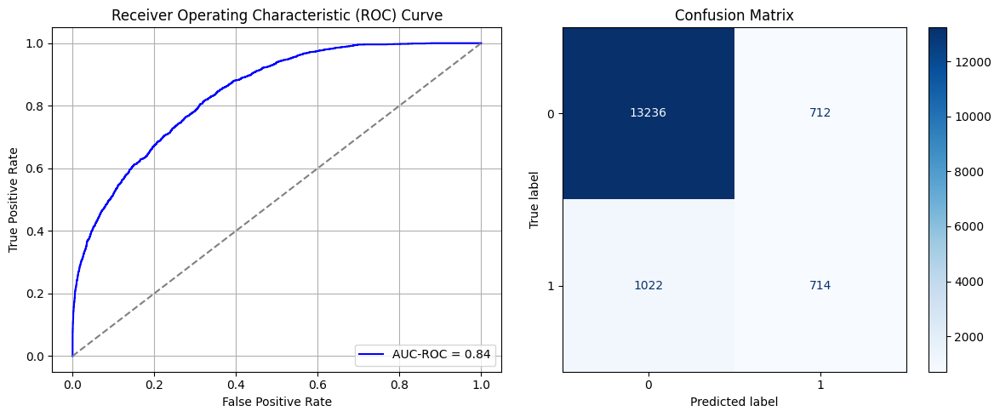

Best threshold based on F1-score: 0.4350945055484772
False Negative Rate: 0.5887096774193549
Time elapsed (performance): 1.8961208010005066
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.7840 - loss: 0.5641 - val_AUC: 0.8672 - val_loss: 0.4660
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8737 - loss: 0.4395 - val_AUC: 0.8714 - val_loss: 0.4439
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8761 - loss: 0.4351 - val_AUC: 0.8727 - val_loss: 0.4425
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - AUC: 0.8771 - loss: 0.4333 - val_AUC: 0.8734 - val_loss: 0.4404
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.8786 - loss: 0.4322 - val_AUC: 0.8737 - val_loss: 0.4396
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8788 - loss: 0.4304 - val_AUC: 0.8747 - val_loss: 0.4375
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8784 - loss: 0.4325 - val_AUC: 0.8744 - val_loss: 0.4389
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8804 - loss: 0.4261 - val_AUC: 0.8757 - val_loss: 0.4356
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - AUC: 0.8810 -

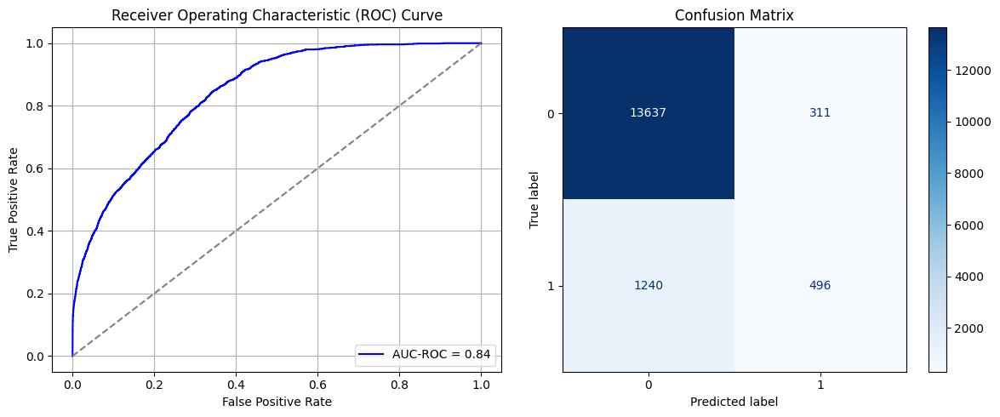

Best threshold based on F1-score: 0.27849462628364563
False Negative Rate: 0.7142857142857143
Time elapsed (performance): 1.5614524920001713
Epoch 1/10


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


874/874 ━━━━━━━━━━━━━━━━━━━━ 8s 7ms/step - AUC: 0.7782 - loss: 0.5633 - val_AUC: 0.8707 - val_loss: 0.4456
Epoch 2/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 8s 4ms/step - AUC: 0.8692 - loss: 0.4458 - val_AUC: 0.8728 - val_loss: 0.4414
Epoch 3/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.8743 - loss: 0.4383 - val_AUC: 0.8728 - val_loss: 0.4566
Epoch 4/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 4ms/step - AUC: 0.8712 - loss: 0.4430 - val_AUC: 0.8744 - val_loss: 0.4375
Epoch 5/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8766 - loss: 0.4324 - val_AUC: 0.8751 - val_loss: 0.4428
Epoch 6/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step - AUC: 0.8799 - loss: 0.4270 - val_AUC: 0.8757 - val_loss: 0.4385
Epoch 7/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8794 - loss: 0.4283 - val_AUC: 0.8756 - val_loss: 0.4386
Epoch 8/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - AUC: 0.8776 - loss: 0.4305 - val_AUC: 0.8770 - val_loss: 0.4334
Epoch 9/10
874/874 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - AUC: 0.8797 -

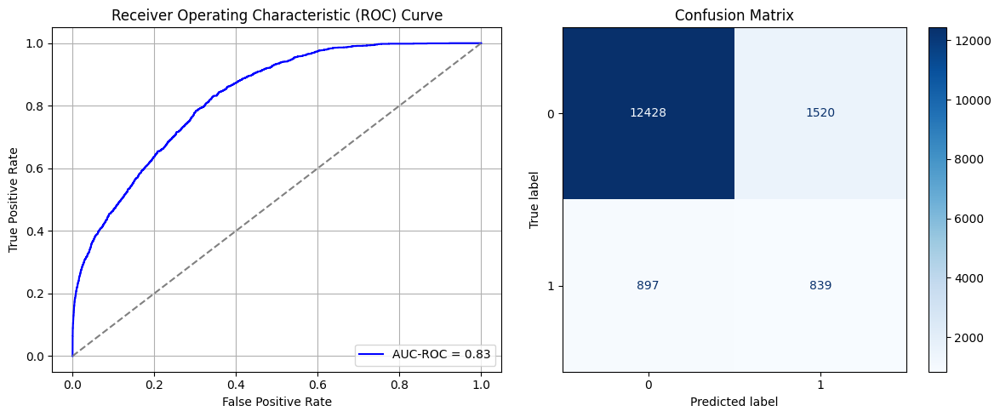

Best threshold based on F1-score: 0.6454203724861145
False Negative Rate: 0.5167050691244239
Time elapsed (performance): 1.9749353949991928


In [63]:
times = 50

Training_time = []
FPR = []
TPR = []
FNR = []
TNR = []
TL_time = []

k = 10
Nsamples = k*(oversample_size-undersample_size)/undersample_size



for i in range(times):
    start = np.random.choice(int(k), int(Nsamples), replace=True)
    Row = []
    for j in range(len(start)):
      for i in range(int(undersample_size/k)):
        row = start[j]+int(k*i)-1
        Row.append(row)
    data_S_min_ros = pd.DataFrame()
    data_S_min_ros = data_S_minority.iloc[Row]
    data_S_Sy_ROS = pd.concat([data_S_majority, data_S_min_ros, data_S_minority])
    X_S_Sy_ROS = data_S_Sy_ROS.iloc[:, :-1]
    y_S_Sy_ROS = data_S_Sy_ROS.iloc[:, -1]
    X_S_train, X_S_test, y_S_train, y_S_test = train_test_split(X_S_Sy_ROS, y_S_Sy_ROS, test_size=0.20, random_state=0)
    model_Sy_ROS = create_dnn_model(X_S_train.shape[1])
    result_Sy_ROS = train_and_evaluate(model_Sy_ROS, X_S_train, X_S_test, y_S_train, y_S_test, "Source")
    result_TL_Sy_ROS = Transductive_TL(model_Sy_ROS, X_T_full, y_T_full, "Target")

    Training_time.append(result_Sy_ROS)
    FPR.append(result_TL_Sy_ROS[0])
    TNR.append(result_TL_Sy_ROS[1])
    FNR.append(result_TL_Sy_ROS[2])
    TPR.append(result_TL_Sy_ROS[3])
    TL_time.append(result_TL_Sy_ROS[4])

ParamFit = pd.DataFrame([Training_time, FPR, TNR, FNR, TPR, TL_time]).T
ParamFit.columns=['Source time', 'FPR', 'TNR', 'FNR', 'TPR', 'Target time']
# print(ParamFit)

In [64]:
print(ParamFit)
ParamFit.to_csv('Sy_ROS2.csv')

    Source time       FPR       TNR       FNR       TPR  Target time
0     40.898314  0.002151  0.997849  0.876152  0.123848     1.911926
1     44.589243  0.120806  0.879194  0.602535  0.397465     1.288870
2     44.819872  0.047749  0.952251  0.551843  0.448157     1.273390
3     41.110867  0.002939  0.997061  0.842742  0.157258     1.290198
4     44.669674  0.020505  0.979495  0.695276  0.304724     1.293264
5     42.079973  0.003155  0.996845  0.854839  0.145161     1.700357
6     40.947750  0.061012  0.938988  0.517281  0.482719     1.232752
7     45.730025  0.003943  0.996057  0.805300  0.194700     1.920148
8     46.048369  0.057571  0.942429  0.657258  0.342742     1.691670
9     42.784696  0.000430  0.999570  0.897465  0.102535     1.310318
10    40.393629  0.005305  0.994695  0.801843  0.198157     1.256528
11    46.214807  0.011615  0.988385  0.731567  0.268433     1.696765
12    39.596283  0.237955  0.762045  0.221198  0.778802     1.684718
13    38.194657  0.029180  0.97082

In [65]:
ParamFit['FNR'].mean()

np.float64(0.68176267281106)

In [66]:
ParamFit['Source time'].mean()

np.float64(48.6837209696398)